In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import itertools
from ast import literal_eval
import re
from scipy import stats
from random import sample

In [2]:
def HLA_cd8_converter(x):
    #define format of datetime
    return x.replace("[","").replace("]","").replace(",", "").replace("'","").split(" ")

def cdr3_lst_converter(x):
    #define format of datetime
    return x.replace("[","").replace("]","").replace("'","").split(" ")

def epitope_converter(x):
    #define format of datetime
    return [y for y in x.replace("[","").replace("]","").replace("\n","").split("'") if (y != '') & (y != ' ')]

def peptide_hla_converter(x):
    return re.findall("\w+\s{1}\w{1}\d+", x.replace("[","").replace("]","").replace("\n","").replace("'",""))

def literal_converter(val):
    # replace NaN with '' and perform literal eval on the rest
    return [] if val == '' else literal_eval(val)

converters = {'peptide_HLA_lst': peptide_hla_converter,
              'umi_count_lst_mhc': literal_eval,
              'umi_count_lst_TRA': literal_converter,'umi_count_lst_TRB': literal_converter,
              'cdr3_lst_TRA': cdr3_lst_converter,
              'cdr3_lst_TRB': cdr3_lst_converter,
              'HLA_lst_mhc': cdr3_lst_converter,'HLA_cd8': HLA_cd8_converter} #

In [3]:
def get_likely_targets(row):
    from itertools import compress
    if (type(row.HLA_cd8) is list) & (type(row.HLA_lst_mhc) is list):
        chec = [item in row.HLA_cd8 for item in row.HLA_lst_mhc]
        idxs = list(compress(range(len(chec)), chec))
        #return [chec, row.HLA_lst_mhc, row.HLA_cd8, idxs]
        #return [row[var][i] for i in idxs]
        if idxs == []:
            return np.nan
        else:
            return [row.HLA_lst_mhc[i] for i in idxs]
    else:
        return np.nan

In [4]:
def sum_umi(row):
    # Sum UMIs for each peptide across GEMs (multiple peptides per GEM)
    if len(row.umi_count_lst_mhc) == len(row.peptide_HLA_lst):
        mat.loc[row.peptide_HLA_lst, row.gem] = row.umi_count_lst_mhc
    else:
        mat.loc[row.peptide_HLA_lst, row.gem] = [0] * len(row.peptide_HLA_lst)

In [5]:
def get_nonsinglet_idxs(duplicated_list):
    dups = collections.defaultdict(list)
    for i, e in enumerate(duplicated_list):
        dups[e].append(i)
    idxs = []
    for k, v in sorted(dups.items()):
        if len(v) > 1:
            idxs += v
    return idxs

In [6]:
def assign_clonotype(tcr_df, clonotype_variables = ['v_gene_TRA','j_gene_TRA','v_gene_TRB','j_gene_TRB','cdr3_comb']):
    
    tcr_df.loc[:, clonotype_variables] = tcr_df.loc[:, clonotype_variables].fillna('unknown')
    new_clonotype = tcr_df.groupby(clonotype_variables).gem.unique().to_frame()
    new_clonotype['n_gems'] = new_clonotype.gem.apply(len)
    new_clonotype.sort_values(by='n_gems', ascending=False, inplace=True)
    dct = new_clonotype.to_dict()['gem']
    for i, k in enumerate(dct.keys(), start=1): 
        dct[k] = i
    return tcr_df.set_index(clonotype_variables).index.map(dct)

#tcr_df['ct'] = assign_clonotype()

# Input

### OBS! exp

In [7]:
INPUT = '/Volumes/tuba/herpov/tcr-pmhc-sc-project/data/exp9.2_CAT_IONTORRENT_KMA_AKB/tables/tcr_barcode.cleaned.alive.csv'

In [8]:
#INPUT = '/Volumes/tuba/herpov/tcr-pmhc-sc-project/data/exp9_CAT_IONTORRENT_KMA_AKB/tables/tcr_barcode.cleaned.imputed.csv'

# Output

In [47]:
PLT = '/Volumes/tuba/herpov/tcr-pmhc-sc-project/plots/exp9_IONTORRENT_KMA_AKB/reports/mhc_umi_dist_per_ct/'

# Load

In [9]:
df = pd.read_csv(INPUT, converters=converters) #

In [10]:
df.HLA_match.dropna().sum() / len(df.HLA_match.dropna())

0.32167832167832167

In [11]:
df['likely_HLA_mhc'] = df.apply(lambda row: get_likely_targets(row), axis=1)

In [12]:
(len(df.HLA_match.dropna()) - df[~df.HLA_match.isna()].likely_HLA_mhc.isna().sum()) / len(df.HLA_match.dropna())

0.6538461538461539

In [13]:
mat = pd.DataFrame(index=df.peptide_HLA_lst.explode().unique(), columns=df.gem.unique())

In [14]:
def alt_test_dist():
    from scipy.stats import norm
    
    p1 = summary_df.index[0]
    p2 = summary_df.index[1]
    
    s1 = mat.T[p1].dropna().to_list()
    s2 = mat.T[p2].dropna().to_list()
    
    # Alternative to subsampling (not implemented)
    _, pp = stats.ttest_ind(s1, s2, equal_var=False, alternative='greater')
    
    if pp <= 0.05:
        print('*** Significant with no sampling')
        return True
    else:
        print('--- Insignificant even with no sampling')
        return False

In [15]:
def test_dist():
    from scipy.stats import norm
    
    p1 = summary_df.index[0]
    p2 = summary_df.index[1]
    
    s1 = mat.T[p1].dropna().to_list()
    s2 = mat.T[p2].dropna().to_list()
    
    n = min(len(s1), len(s2))
    m = max(len(s1), len(s2))
    
    # Alternative, when we only have a single GEM
    if (n == 1) & (m > 9):
        if len(s1) == 1:
            cdf = norm.cdf(s1, loc=np.mean(s2), scale=np.std(s2))
            if cdf < 0.05:
                print('*** Significant with cdf')
                return True
            else:
                print('--- Insignificant with cdf')
                return False
        elif len(s2) == 1:
            cdf = norm.cdf(s2, loc=np.mean(s1), scale=np.std(s1))
            if cdf < 0.05:
                print('*** Significant with cdf')
                return True
            else:
                print('--- Insignificant with cdf')
                return False
    elif n == 1:
        print('NaN p-value')
        return False
    
    ## Alternative to subsampling (not implemented)
    #_, pp = stats.ttest_ind(s1, s2, equal_var=False, alternative='greater')
    #
    #if pp <= 0.05:
    #    print('*** Significant with no sampling')
    #else:
    #    print('--- Insignificant even with no sampling')
        
    if n < 5:
        return False
    
    p_list = list()
    for _ in range(10):
        l1 = sample(s1, n)
        l2 = sample(s2, n)

        t, p = stats.ttest_ind(l1, l2, equal_var=False, alternative='greater')
        
        p_list.append(p)
    
    if np.median(p_list) <= 0.05:
        return True
    #print(sorted(p_list))
    return False

In [16]:
alt_sign = 0

Quantiles umi_count_mhc vs mat: 42.0 42


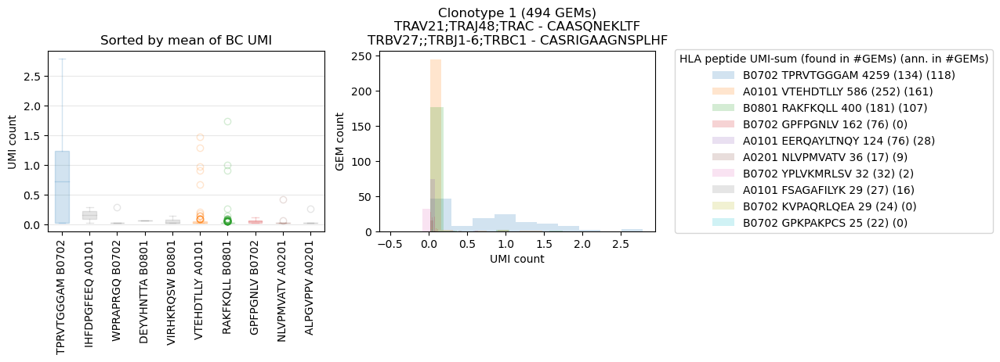

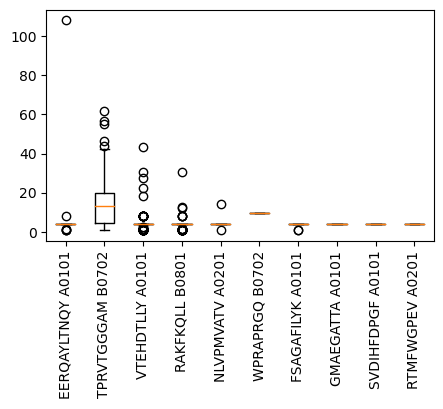

Quantiles umi_count_mhc vs mat: 90.0 90


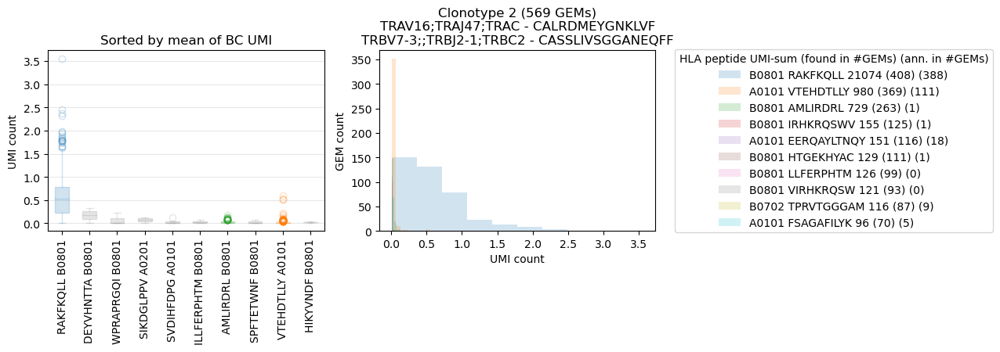

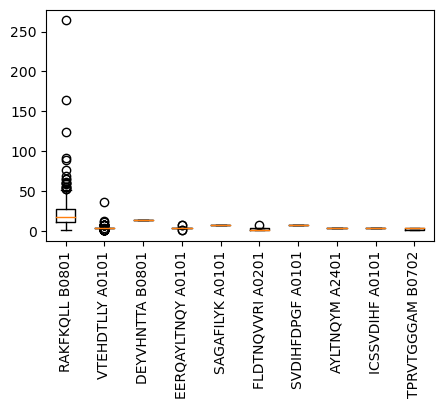

Quantiles umi_count_mhc vs mat: 22.0 22


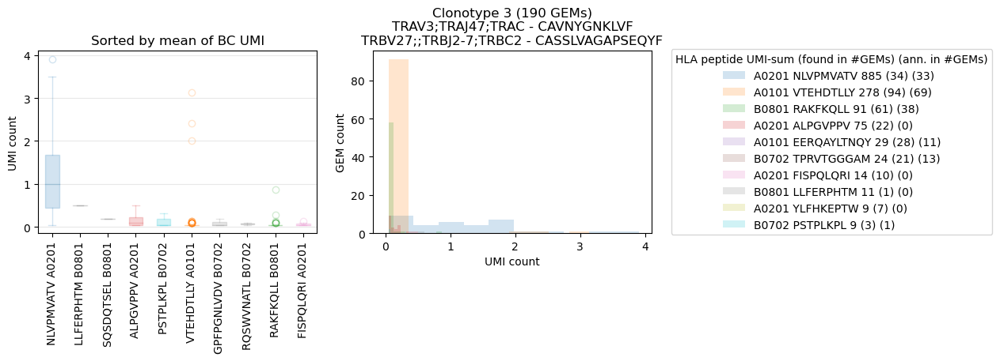

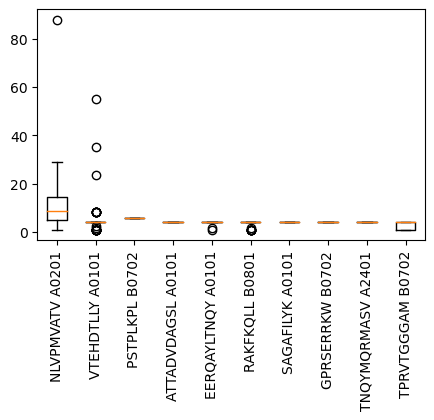

Quantiles umi_count_mhc vs mat: 116.0 116


KeyboardInterrupt: 

In [17]:
df['ct_pep'] = np.nan
trash_bin = set()
value_bin =set()
selected_clonotypes = df.groupby('ct').size().sort_values(ascending=False)#.head(10) #astype(int) ??
all_peptide_HLA = df.peptide_HLA_lst.explode()

for ct in df.ct.astype(int).sort_values().unique(): #selected_clonotypes.index:
    mat = pd.DataFrame(index=all_peptide_HLA.unique(), columns=df.gem.unique())
    df[df.ct == ct].apply(lambda row: sum_umi(row), axis=1)
    
    #summary df
    summary_df = mat.sum(axis=1).sort_values(ascending=False).to_frame().rename(columns={0:'s'})
    summary_df['avg'] = mat.mean(axis=1)
    summary_df['col'] = 'grey'
    summary_df['r'] = summary_df.s / summary_df.s.max() # Unnecessary
    
    # Getting the relative UMI counts per clonotype
    assert mat.max().max() == df[df.ct == ct].umi_count_mhc.max()
    print("Quantiles umi_count_mhc vs mat:", df[df.ct == ct].umi_count_mhc.quantile(0.9, interpolation='lower'), mat.max().quantile(0.9, interpolation='lower'))
    df.loc[df.ct == ct, 'umi_count_mhc_rel'] = df[df.ct == ct].umi_count_mhc / df[df.ct == ct].umi_count_mhc.quantile(0.9, interpolation='lower') #mat.max().quantile(0.9, interpolation='lower') #.max()
    mat = mat / df[df.ct == ct].umi_count_mhc.quantile(0.9, interpolation='lower') #mat.max().quantile(0.9, interpolation='lower') #.max()
    
    
    
    summed_umis = summary_df.s.head(10)
    summed_gems = (mat > 0).sum(axis=1)
    annotated_gems = df[df.ct == ct].groupby('peptide_HLA').size()
    all_gems_hla = pd.concat([annotated_gems,
                              pd.Series(0, index=all_peptide_HLA[~all_peptide_HLA.isin(annotated_gems.index)].unique())])
    
    # test if two annotations are significantly different distributed.
    if test_dist():
        # Maybe accumulate distributions for true imputations to compare with when in doubt?
        df.loc[df.ct == ct, 'ct_pep'] = summary_df.index[0]
        value_bin.update([ct])
        trash_bin.update(summary_df.index[1:10])
        figure_flag = 'significant'
        #if ct > 10:
        #    continue
    else:
        if alt_test_dist():
            alt_sign += 1
        if summary_df.index[0] not in trash_bin:
            if summary_df.index[1] not in trash_bin:
                print('HELP!')
                figure_flag = 'insignificant'
            else:
                df.loc[df.ct == ct, 'ct_pep'] = summary_df.index[0]
                trash_bin.update(summary_df.index[1:10])
                print(ct, 'resolved by trash bin')
                figure_flag = 'insignificant'
        else:
            # Highlight the clonotypes that are ambiguous
            if len(df[(df.ct == ct) & (df.tcr_category.isin(['multiple chains']))]) > 0:
                df.loc[df.ct == ct, 'ct_pep'] = 'unsolvable'
                print('unsolvable!')
                figure_flag = 'insignificant'
            else:
                # Check if distribution matches a previously accepted peptide distribution.
                df.loc[df.ct == ct, 'ct_pep'] = 'unresolved'
                print(ct, 'unresolved')
                figure_flag = 'insignificant'
            
        #print(df.loc[df.ct ==ct, ['peptide', 'peptide_lst','umi_count_lst_mhc',
        #                          'cdr3_lst_TRA','genes_lst_TRA','umi_count_lst_TRA',
        #                          'cdr3_lst_TRB','genes_lst_TRB','umi_count_lst_TRB']])
    # Highlight the clonotypes that are ambiguous
    if len(df[(df.ct == ct) & (df.tcr_category.isin(['multiple chains']))]) > 0:
        print('Multiple TCR chains - in theory unsolvable!')
    
    fig, (ax1, ax2) = plt.subplots(1,2,figsize=(10,3))
    # Histogram
    for peptide_HLA in summed_umis.index:
        ax2.hist(mat.T[peptide_HLA].dropna(), alpha=0.2, label='%s %s %d (%d) (%d)' %(peptide_HLA.split(' ')[1], peptide_HLA.split(' ')[0], summed_umis[peptide_HLA], summed_gems[peptide_HLA], all_gems_hla[peptide_HLA]))
    summary_df.iloc[0:10, summary_df.columns.to_list().index('col')] = plt.rcParams['axes.prop_cycle'].by_key()['color']
    # Boxplot
    boxes = list()
    meaned_umis = summary_df.sort_values(by='avg',ascending=False).head(10)
    for peptide_HLA in meaned_umis.index:
        boxes.append(mat.T[peptide_HLA].dropna().to_list())
    bp = ax1.boxplot(boxes, patch_artist=True) #, vert=False
    colors = meaned_umis.col #.to_list()
    
    # whiskers and caps have to be treated separately since there are two of each for each plot
    for item in ['whiskers', 'caps']:
        for sub_item, color in zip(zip(bp[item][::2], bp[item][1::2]), colors):
            plt.setp(sub_item, color=color, alpha=0.2)
    for item in ['fliers']:
        for sub_item, color in zip(bp[item], colors):
            plt.setp(sub_item, markeredgecolor=color, alpha=0.2)
    for item in ['boxes', 'medians']:
        for sub_item, color in zip(bp[item], colors):
            plt.setp(sub_item, color=color, alpha=0.2)
            
    ax1.set_title('Sorted by mean of BC UMI')
    ax1.set_xticklabels(meaned_umis.index, rotation=90)
    ax1.set_ylabel('UMI count')
    ax1.yaxis.grid(True, linestyle='-', which='major', color='lightgrey',alpha=0.5)
    ax1.set_axisbelow(True) # Hide these grid behind plot objects
    plt.legend(bbox_to_anchor=(1.05, 0.5), loc='center left', title='HLA peptide UMI-sum (found in #GEMs) (ann. in #GEMs)')
    ax2.set_xlabel('UMI count')
    ax2.set_ylabel('GEM count')
    ax2.set_title('Clonotype %d (%d GEMs)\n%s - %s\n%s - %s' %(ct, selected_clonotypes[ct],
                                               df[df.ct == ct].genes_TRA.unique()[0], df[df.ct == ct].cdr3_TRA.unique()[0],
                                               df[df.ct == ct].genes_TRB.unique()[0], df[df.ct == ct].cdr3_TRB.unique()[0]))
    #if ct == 222:
    #    plt.savefig('%s.pdf'%ct)
    #    print(summed_umis)
    #    print(summed_gems)
    #    print(all_gems_hla)
    #plt.show()
    
    #plt.savefig(PLT + figure_flag + '/%s.pdf' %ct, bbox_inches='tight')
    
    plt.figure(figsize=(5,3))
    delta = df.loc[df.ct == ct, ['delta_umi_mhc','peptide_HLA']].sort_values('delta_umi_mhc', ascending=False).groupby('peptide_HLA', sort=False).delta_umi_mhc.apply(list)
    plt.boxplot(delta.to_list()[:10])
    plt.xticks(np.arange(1, min(11, len(delta)+1)), delta.index[:10], rotation=90)
    plt.show()
    


In [36]:
sel_cts.index = sel_cts.index.astype(int)

In [43]:
df.loc[[1,2,3], 'lol'] = 'testing_peptide'

In [44]:
df.head()

,Unnamed: 0,gem,clonotype,num_clonotype,ct,genes_TRA,genes_TRB,genes_lst_TRA,genes_lst_TRB,length_TRA,...,peptide_HLA,peptide_HLA_lst,epitope,epitope_lst,gems_per_specificity,gems_per_clonotype,binding_concordance,ct_pep,umi_count_mhc_rel,lol
0,0,AAACCTGAGAGGTAGA-1,clonotype2,2.0,2.0,TRAV16;TRAJ47;TRAC,TRBV7-3;;TRBJ2-1;TRBC2,['TRAV16;TRAJ47;TRAC'],['TRBV7-3;;TRBJ2-1;TRBC2'],512.0,...,RAKFKQLL B0801,"[ALPGVPPV A0201, RQAYLTNQY A0101, VTEHDTLLY A0...",V17_B8 EBV BZLF1 (C9),['06_1_1' '45_1_49' 'V15_A1 CMV pp50 VTE' '...,391.0,577.0,0.677643,RAKFKQLL B0801,0.755556,NaN
1,1,AAACCTGAGCACCGTC-1,clonotype1,1.0,1.0,TRAV21;TRAJ48;TRAC,TRBV27;;TRBJ1-6;TRBC1,['TRAV21;TRAJ48;TRAC'],['TRBV27;;TRBJ1-6;TRBC1'],505.0,...,VTEHDTLLY A0101,"[GPFPGNLVD B0702, WAGGLGLNL B0702, VTEHDTLLY A...",V15_A1 CMV pp50 VTE,['47_1_38' '47_1_62' 'V15_A1 CMV pp50 VTE'],163.0,496.0,0.328629,TPRVTGGGAM B0702,0.047619,testing_peptide
2,2,AAACCTGAGGAGCGTT-1,clonotype1,1.0,1.0,TRAV21;TRAJ48;TRAC,TRBV27;;TRBJ1-6;TRBC1,['TRAV21;TRAJ48;TRAC'],['TRBV27;;TRBJ1-6;TRBC1'],519.0,...,RAKFKQLL B0801,[RAKFKQLL B0801],V17_B8 EBV BZLF1 (C9),['V17_B8 EBV BZLF1 (C9)'],106.0,496.0,0.213710,TPRVTGGGAM B0702,0.047619,testing_peptide
3,3,AAACCTGAGTCGAGTG-1,clonotype4,4.0,4.0,TRAV39;TRAJ28;TRAC,TRBV4-2;;TRBJ2-7;TRBC2,['TRAV39;TRAJ28;TRAC'],['TRBV4-2;;TRBJ2-7;TRBC2'],487.0,...,VTEHDTLLY A0101,[VTEHDTLLY A0101],V15_A1 CMV pp50 VTE,['V15_A1 CMV pp50 VTE'],151.0,176.0,0.857955,VTEHDTLLY A0101,0.008621,testing_peptide
4,4,AAACCTGCATACTACG-1,clonotype259,259.0,259.0,TRAV12-2;TRAJ20;TRAC,TRBV5-8;TRBD1;TRBJ1-4;TRBC1,['TRAV12-2;TRAJ20;TRAC'],['TRBV5-8;TRBD1;TRBJ1-4;TRBC1'],541.0,...,VTEHDTLLY A0101,[VTEHDTLLY A0101],V15_A1 CMV pp50 VTE,['V15_A1 CMV pp50 VTE'],1.0,1.0,1.000000,NaN,NaN,NaN


In [32]:
sel_cts = df.groupby('ct').size()#.head(10) #astype(int) ??

In [28]:
df.ct.astype(int).sort_values().unique()

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  40,
        41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,
        54,  55,  57,  58,  59,  60,  61,  62,  64,  68,  70,  71,  72,
        73,  74,  75,  76,  77,  78,  79,  81,  82,  83,  84,  85,  86,
        88,  89,  90,  91,  92,  93,  94,  95,  96,  97,  99, 100, 101,
       111, 113, 122, 123, 124, 125, 126, 129, 131, 136, 141, 143, 148,
       150, 154, 155, 156, 159, 162, 167, 170, 171, 173, 176, 177, 178,
       179, 180, 183, 184, 185, 189, 194, 195, 196, 205, 209, 211, 212,
       215, 216, 217, 219, 224, 225, 227, 228, 232, 233, 234, 235, 237,
       241, 242, 246, 247, 249, 253, 256, 258, 259, 262, 264, 265, 268,
       276, 277, 279, 280, 289, 291, 292, 293, 294, 296, 299, 301, 302,
       303, 305, 308, 309, 312, 317, 320, 322, 324, 326, 330, 33

In [23]:
pd.Series(0, index=all_peptide_HLA[~all_peptide_HLA.isin(annotated_gems.index)].unique())

ALPGVPPV A0201       0
RQAYLTNQY A0101      0
AMLIRDRL B0801       0
GPFPGNLVD B0702      0
WAGGLGLNL B0702      0
                    ..
LFSAGAFILYK A0101    0
VIRHKRQSWV B0801     0
TTADVDAGS A0101      0
FLVNTMCLA A0201      0
YADYSYAI B0801       0
Length: 91, dtype: int64

In [17]:
df.ct.isin(value_bin)

0        True
1        True
2        True
3        True
4       False
        ...  
2262     True
2263    False
2264    False
2265     True
2266     True
Name: ct, Length: 2267, dtype: bool

In [24]:
df.columns

Index(['gem', 'clonotype', 'num_clonotype', 'ct', 'genes_TRA', 'genes_TRB',
       'genes_lst_TRA', 'genes_lst_TRB', 'length_TRA', 'cdr1_TRA', 'cdr2_TRA',
       'cdr3_TRA', 'umi_count_TRA', 'umi_count_lst_TRA', 'delta_umi_TRA',
       'cdr3_lst_TRA', 'chain_count_TRA', 'single_TRA', 'length_TRB',
       'cdr1_TRB', 'cdr2_TRB', 'cdr3_TRB', 'umi_count_TRB',
       'umi_count_lst_TRB', 'delta_umi_TRB', 'cdr3_lst_TRB', 'chain_count_TRB',
       'single_TRB', 'single_chain_only', 'umi_count_tcr', 'cdr3_comb',
       'v_gene_TRA', 'j_gene_TRA', 'v_gene_TRB', 'j_gene_TRB', 'tcr_category',
       'no_filtration', 'exclude_single-chain_TCRs',
       'exclude_ambiguous_and_single-chain_TCRs', 'exclude_ambiguous_TCRs',
       'template_id_mhc', 'template_lst_mhc', 'single_barcode_mhc',
       'umi_count_mhc', 'umi_count_lst_mhc', 'read_count_mhc',
       'read_count_lst_mhc', 'multiplets_mhc', 'delta_umi_mhc',
       'template_id_cd8', 'template_lst_cd8', 'single_barcode_cd8',
       'umi_count_

In [27]:
df.loc[df.ct.isin(value_bin), ['pep_match','umi_count_mhc','umi_count_mhc_rel']].head(60)

,pep_match,umi_count_mhc,umi_count_mhc_rel
0,True,68.0,0.747253
1,False,2.0,0.047619
2,False,2.0,0.047619
3,True,1.0,0.008547
5,False,1.0,0.010989
6,False,1.0,0.006329
7,True,71.0,0.780220
8,True,21.0,0.179487
10,True,2.0,0.011561
11,False,1.0,0.023810


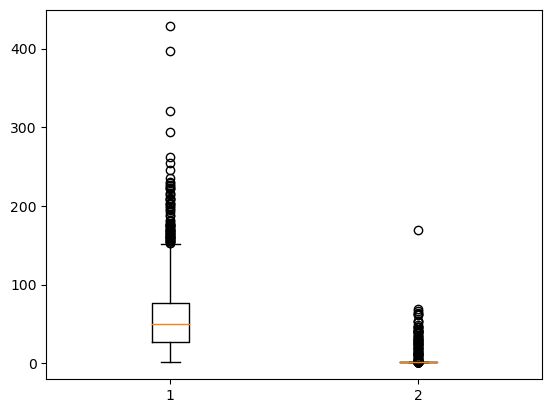

In [32]:
x = [df[(df.pep_match == True) & df.ct.isin(value_bin)].umi_count_mhc, df[(df.pep_match == False) & df.ct.isin(value_bin)].umi_count_mhc]
plt.boxplot(x)
plt.show()

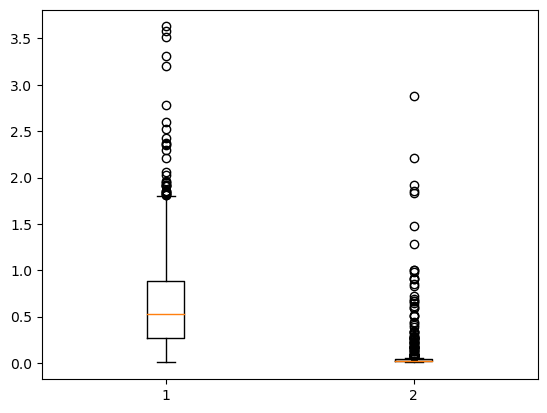

In [33]:
x = [df[(df.pep_match == True) & df.ct.isin(value_bin)].umi_count_mhc_rel, df[(df.pep_match == False) & df.ct.isin(value_bin)].umi_count_mhc_rel]
plt.boxplot(x)
plt.show()

In [58]:
df[df.ct == 50].umi_count_mhc

2314    1.0
Name: umi_count_mhc, dtype: float64

In [18]:
df['pep_match'] = df.ct_pep == df.peptide_HLA

In [19]:
value_bin

{1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 13, 17, 19, 22, 26}

In [35]:
value_bin

{1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 13, 17, 19, 26, 32, 33}

### foreward credible clonotypes to assess threshold effects

In [21]:
value_bin

{1,
 2,
 3,
 4,
 5,
 6,
 7,
 10,
 11,
 13,
 14,
 16,
 17,
 20,
 22,
 25,
 28,
 30,
 32,
 33,
 48,
 49,
 54}

In [58]:
value_bin

{1,
 2,
 3,
 4,
 5,
 6,
 7,
 10,
 11,
 13,
 14,
 16,
 17,
 20,
 22,
 25,
 28,
 30,
 32,
 33,
 48,
 49,
 54}

In [41]:
df[~df.ct.isin(value_bin)].ct.unique().shape

(365,)

In [53]:
df[['umi_count_TRA','delta_umi_TRA','umi_count_TRB','delta_umi_TRB','umi_count_mhc','delta_umi_mhc','umi_count_mhc_rel']].describe()

,umi_count_TRA,delta_umi_TRA,umi_count_TRB,delta_umi_TRB,umi_count_mhc,delta_umi_mhc,umi_count_mhc_rel
count,1987.000000,1987.000000,2211.000000,2211.000000,2267.000000,2267.000000,1438.000000
mean,4.116759,15.935892,8.403437,33.400256,32.124393,12.953295,0.352119
std,2.376550,9.870311,4.839512,19.463258,48.497145,17.602265,0.515874
min,1.000000,0.800000,1.000000,0.941176,1.000000,0.800000,0.008621
25%,2.000000,8.000000,5.000000,20.000000,1.000000,4.000000,0.023810
50%,4.000000,16.000000,7.000000,28.000000,2.000000,4.000000,0.045455
75%,6.000000,20.000000,11.000000,44.000000,51.000000,18.095238,0.566667
max,14.000000,56.000000,39.000000,156.000000,428.000000,264.000000,3.909091


In [76]:
df.umi_count_mhc.quantile(0.6, interpolation='higher')

26.0

In [75]:
import re
regex = re.search('grid_search\.(\d+)\.csv', 'grid_search.4.csv')
int(regex.group(1))

4

In [20]:
tmp = df[df.ct.isin(value_bin)].fillna(0)

In [37]:
tmp.shape

(1828, 79)

In [21]:
# OBS! Old
tmp.to_csv('/Volumes/tuba/herpov/tcr-pmhc-sc-project/data/exp9.2_CAT_IONTORRENT_KMA_AKB/reports/valid_ct.alive.csv')

In [10]:
#table = pd.read_csv('/Volumes/tuba/herpov/tcr-pmhc-sc-project/data/exp9_CAT_IONTORRENT_KMA_AKB/reports/concordance_gridsearch.csv')

In [42]:
np.linspace(0,1,30)

array([0.        , 0.03448276, 0.06896552, 0.10344828, 0.13793103,
       0.17241379, 0.20689655, 0.24137931, 0.27586207, 0.31034483,
       0.34482759, 0.37931034, 0.4137931 , 0.44827586, 0.48275862,
       0.51724138, 0.55172414, 0.5862069 , 0.62068966, 0.65517241,
       0.68965517, 0.72413793, 0.75862069, 0.79310345, 0.82758621,
       0.86206897, 0.89655172, 0.93103448, 0.96551724, 1.        ])

# View dataframe according to clonotype

In [69]:
df.loc[df.ct == 222, ['ct_pep','peptide_HLA','peptide_HLA_lst','umi_count_lst_mhc','delta_umi_mhc','gems_per_specificity', 'gems_per_clonotype','binding_concordance']]

,ct_pep,peptide_HLA,peptide_HLA_lst,umi_count_lst_mhc,delta_umi_mhc,gems_per_specificity,gems_per_clonotype,binding_concordance
491,unresolved,NLVPMVATV A0201,"[FSAGAFILYK A0101, TPRVTGGGAM B0702, FISPQLQRI...","[1, 1, 1, 1, 2, 4, 5, 60]",11.428571,1.0,1.0,1.0


# Get CDRs for GEMs associated with NLV

In [32]:
df_exp = df.peptide_HLA_lst.explode()

In [33]:
nlv_df = pd.concat([df.loc[df.ct_pep == 'NLVPMVATV A0201', ['cdr3_TRA','cdr3_TRB','ct','peptide_HLA_lst','peptide_HLA','ct_pep']],
                    df.loc[df_exp[df_exp == 'NLVPMVATV A0201'].index, ['cdr3_TRA','cdr3_TRB','ct','peptide_HLA_lst','peptide_HLA','ct_pep']]]).drop_duplicates(subset=['cdr3_TRA','cdr3_TRB'])

In [34]:
#nlv_df[['cdr3_TRA','cdr3_TRB']].dropna().to_csv('check_cdr3s.csv',index=False,header=False)

In [35]:
NETTCR_PRED = '/Volumes/tuba/herpov/tcr-pmhc-sc-project/data/netTCR-2.0/nettcr_predictions.csv'
nettcr = pd.read_csv(NETTCR_PRED)

In [36]:
nettcr

,peptide,CDR3a,CDR3b,prediction,percentile_rank
0,GILGFVFTL,CAVNYGNKLVF,CASSLVAGAPSEQYF,0.577492,0.006
1,NLVPMVATV,CAVNYGNKLVF,CASSLVAGAPSEQYF,0.480218,0.003
2,GLCTLVAML,CAVNYGNKLVF,CASSLVAGAPSEQYF,0.473742,0.003
3,GILGFVFTL,CALRDMEYGNKLVF,CASSLIVSGGANEQFF,0.736257,0.001
4,NLVPMVATV,CALRDMEYGNKLVF,CASSLIVSGGANEQFF,0.602393,0.003
...,...,...,...,...,...
115,NLVPMVATV,CASLLIIQGAQKLVF,CASSVGQGRSYEQYF,0.208433,0.055
116,GLCTLVAML,CASLLIIQGAQKLVF,CASSVGQGRSYEQYF,0.204579,0.055
117,GILGFVFTL,CATVSRMDSSYKLIF,CASSLIGQGLGDEQFF,0.175838,0.043
118,NLVPMVATV,CATVSRMDSSYKLIF,CASSLIGQGLGDEQFF,0.411940,0.005


In [37]:
nlv_pred = pd.merge(nlv_df, nettcr, left_on=['cdr3_TRA','cdr3_TRB'], right_on=['CDR3a','CDR3b']).sort_values(by=['ct','prediction'])

In [38]:
nlv_pred['peptide_pred'] = nlv_pred.set_index('ct').index.map(nlv_pred.groupby('ct').peptide.apply(list).to_dict())
nlv_pred['prediction_lst'] = nlv_pred.set_index('ct').index.map(nlv_pred.groupby('ct').prediction.apply(list).to_dict())
nlv_pred['rank_lst'] = nlv_pred.set_index('ct').index.map(nlv_pred.groupby('ct').percentile_rank.apply(list).to_dict())



In [39]:
nlv_pred.sort_values(by=['ct','peptide']).drop_duplicates('ct', keep='last').sort_values(by='prediction')

,cdr3_TRA,cdr3_TRB,ct,peptide_HLA_lst,peptide_HLA,ct_pep,peptide,CDR3a,CDR3b,prediction,percentile_rank,peptide_pred,prediction_lst,rank_lst
49,CAFMKHESALVSRPNKLIF,CASSFRRGQSSYEQYF,48.0,"[DEYVHNTTA B0801, ATTADVDAGSL A0101, FSAGAFILY...",VTEHDTLLY A0101,VTEHDTLLY A0101,NLVPMVATV,CAFMKHESALVSRPNKLIF,CASSFRRGQSSYEQYF,0.184580,0.074,"[GLCTLVAML, NLVPMVATV, GILGFVFTL]","[0.18104324, 0.18458036, 0.25319946]","[0.072, 0.074, 0.017]"
91,CAAFRAYNTDKLIF,CSARGLGQAKEYGYTF,11.0,"[SVDIHFDPG A0101, GMAEGATTA A0101, NLVPMVATV A...",VTEHDTLLY A0101,VTEHDTLLY A0101,NLVPMVATV,CAAFRAYNTDKLIF,CSARGLGQAKEYGYTF,0.187998,0.074,"[GILGFVFTL, GLCTLVAML, NLVPMVATV]","[0.021359865, 0.18075691, 0.18799816]","[0.462, 0.072, 0.074]"
115,CASLLIIQGAQKLVF,CASSVGQGRSYEQYF,684.0,[NLVPMVATV A0201],NLVPMVATV A0201,unresolved,NLVPMVATV,CASLLIIQGAQKLVF,CASSVGQGRSYEQYF,0.208433,0.055,"[GILGFVFTL, GLCTLVAML, NLVPMVATV]","[0.13012764, 0.20457864, 0.20843303]","[0.06, 0.055, 0.055]"
16,CALIGMYSGGGADGLTF,CASSPTYEQYF,190.0,[NLVPMVATV A0201],NLVPMVATV A0201,unresolved,NLVPMVATV,CALIGMYSGGGADGLTF,CASSPTYEQYF,0.228355,0.047,"[GLCTLVAML, NLVPMVATV, GILGFVFTL]","[0.22659998, 0.22835478, 0.25416985]","[0.045, 0.047, 0.017]"
52,CAARPGAQKLVF,CASSLEAGQKPYEQYF,13.0,"[TTADVDAG A0101, IHFDPGFEEQ A0101, NLVPMVATV A...",VTEHDTLLY A0101,VTEHDTLLY A0101,NLVPMVATV,CAARPGAQKLVF,CASSLEAGQKPYEQYF,0.234186,0.040,"[GLCTLVAML, NLVPMVATV, GILGFVFTL]","[0.22702625, 0.23418584, 0.28657156]","[0.043, 0.04, 0.015]"
55,CAAENQGGKLIF,CASSERGQGAYEQYF,24.0,"[FSAGAFILYK A0101, NLVPMVATV A0201, QAYLTNQY A...",VTEHDTLLY A0101,unresolved,NLVPMVATV,CAAENQGGKLIF,CASSERGQGAYEQYF,0.251434,0.035,"[GLCTLVAML, NLVPMVATV, GILGFVFTL]","[0.2462986, 0.2514338, 0.30266798]","[0.034, 0.035, 0.014]"
31,CAASRYAGNNRKLIW,CASSERGQGAYEQYF,33.0,"[AALPGVPPV A0201, NLVPMVATV A0201, TPRVTGGGAM ...",VTEHDTLLY A0101,VTEHDTLLY A0101,NLVPMVATV,CAASRYAGNNRKLIW,CASSERGQGAYEQYF,0.253074,0.035,"[GILGFVFTL, GLCTLVAML, NLVPMVATV]","[0.18963759, 0.2457109, 0.2530735]","[0.036, 0.034, 0.035]"
100,CAARPGADKLIF,CASSLEASGHPYEQYF,114.0,"[NLVPMVATV A0201, FSAGAFILYN A0101, VTEHDTLLY ...",VTEHDTLLY A0101,unresolved,NLVPMVATV,CAARPGADKLIF,CASSLEASGHPYEQYF,0.271955,0.019,"[GILGFVFTL, GLCTLVAML, NLVPMVATV]","[0.25051305, 0.2657155, 0.27195495]","[0.019, 0.02, 0.019]"
103,CIVRVGGDSWGKLQF,CASSDLNSPLHF,28.0,"[EERQAYLTNQY A0101, TPRVTGGGAM B0702, HTGEKHYA...",RAKFKQLL B0801,RAKFKQLL B0801,NLVPMVATV,CIVRVGGDSWGKLQF,CASSDLNSPLHF,0.296768,0.012,"[GLCTLVAML, GILGFVFTL, NLVPMVATV]","[0.287862, 0.28787035, 0.2967682]","[0.012, 0.015, 0.012]"
112,CATQTGTASKLTF,CASSWDVRNTDTQYF,569.0,"[YPLVKMRLS B0702, LFSAGAFI A2401, EERQAYLTNQY ...",IGLFSAGAFI A2401,IGLFSAGAFI A2401,NLVPMVATV,CATQTGTASKLTF,CASSWDVRNTDTQYF,0.296807,0.012,"[GLCTLVAML, NLVPMVATV, GILGFVFTL]","[0.28690284, 0.29680684, 0.35305315]","[0.012, 0.012, 0.008]"


# Plot accuracy of imputations against UMI and delta thresholds

In [50]:
df['pep_match'] = df.ct_pep == df.peptide_HLA

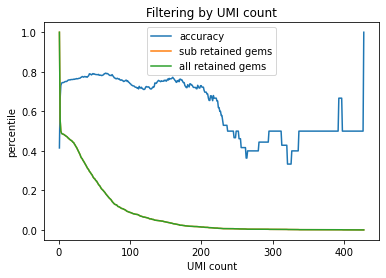

In [54]:
sub_df = df[df.ct_pep != 'unknown'].copy()
umi_thresholds = list(range(1, int(sub_df.umi_count_mhc.max()+1)))
acc = list()
ngm = list()
agm = list()
for umi in umi_thresholds:
    acc.append(sub_df[sub_df.umi_count_mhc >= umi].pep_match.sum() / sum(sub_df.umi_count_mhc >= umi))
    ngm.append(sum(sub_df.umi_count_mhc >= umi)/ len(sub_df))
    agm.append(sum(df.umi_count_mhc >= umi)/ len(df))
    
plt.plot(umi_thresholds, acc, label='accuracy')
plt.plot(umi_thresholds, ngm, label='sub retained gems')
plt.plot(umi_thresholds, agm, label='all retained gems')
plt.legend()
plt.xlabel('UMI count')
plt.ylabel('percentile')
plt.title('Filtering by UMI count')
plt.show()

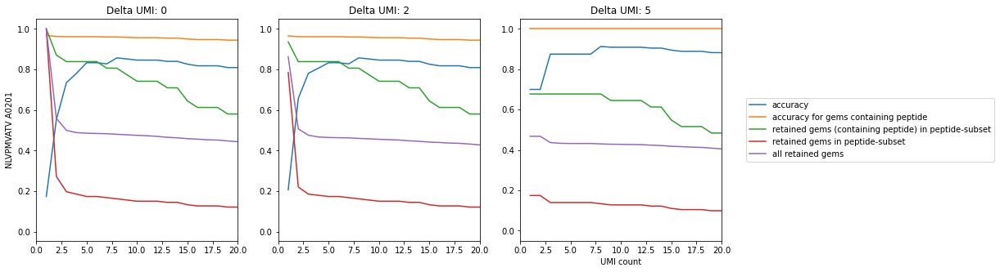

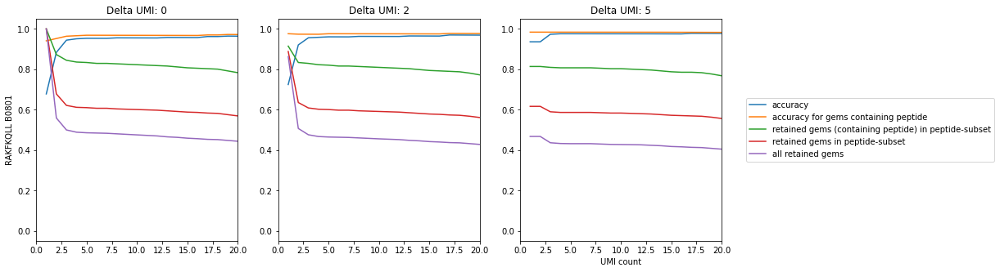

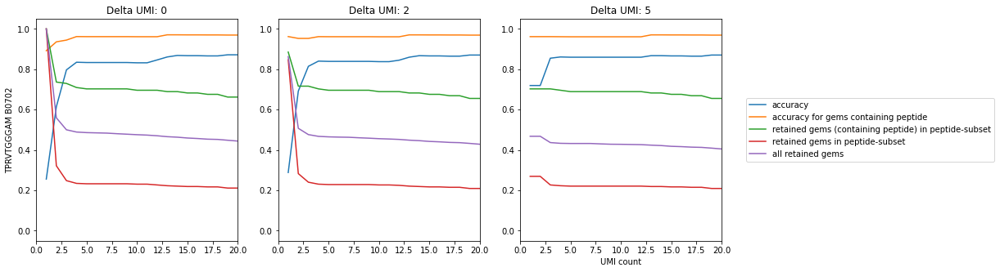

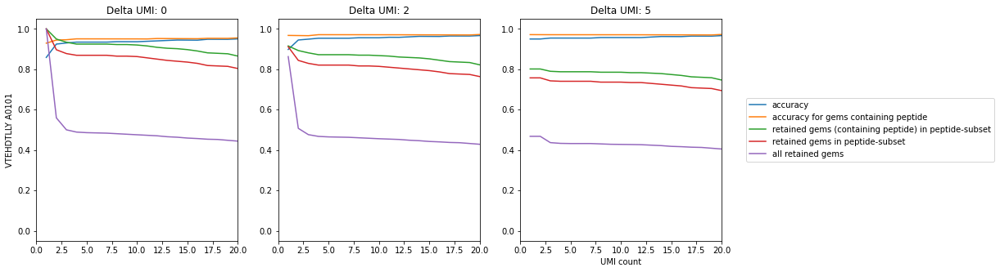

In [65]:
for peptide in ['NLVPMVATV A0201','RAKFKQLL B0801','TPRVTGGGAM B0702','VTEHDTLLY A0101']:
    sub_df = df[df.ct_pep == peptide].copy()
    sex_df = sub_df.peptide_HLA_lst.explode()
    sss_id = sex_df[sex_df == peptide].index
    sss_df = sub_df.loc[sss_id].copy()
    
    umi_thresholds = list(range(1, int(sub_df.umi_count_mhc.max()+1)))
    
    fig, axes = plt.subplots(1,3, figsize=(15,5))
    for delta, ax in zip([0, 2, 5], axes):
        acc = list()
        sac = list()
        sgm = list()
        ngm = list()
        agm = list()
        for umi in umi_thresholds:
            acc_df = sub_df[(sub_df.umi_count_mhc >= umi) & (sub_df.delta_umi_mhc >= delta)].copy()
            sac_df = sss_df[(sss_df.umi_count_mhc >= umi) & (sss_df.delta_umi_mhc >= delta)].copy()
            acc.append(acc_df.pep_match.sum() / len(acc_df) if len(acc_df) > 0 else 0)
            sac.append(sac_df.pep_match.sum() / len(sac_df) if len(sac_df) > 0 else 0)
            sgm.append(sum((sss_df.umi_count_mhc >= umi) & (sss_df.delta_umi_mhc >= delta))/ len(sss_df))
            ngm.append(sum((sub_df.umi_count_mhc >= umi) & (sub_df.delta_umi_mhc >= delta))/ len(sub_df))
            agm.append(sum((df.umi_count_mhc >= umi) & (df.delta_umi_mhc >= delta))/ len(df))

        ax.plot(umi_thresholds, acc, label='accuracy')
        ax.plot(umi_thresholds, sac, label='accuracy for gems containing peptide')
        ax.plot(umi_thresholds, sgm, label='retained gems (containing peptide) in peptide-subset')
        ax.plot(umi_thresholds, ngm, label='retained gems in peptide-subset')
        ax.plot(umi_thresholds, agm, label='all retained gems')
        ax.set_xlim(0,20)
        
        if ax.is_first_row():
            ax.set_title('Delta UMI: %d'%delta)
        if ax.is_first_col():
            ax.set_ylabel(peptide)

    plt.legend(loc='center left', bbox_to_anchor=(1.1,0.5))
    plt.xlabel('UMI count')
    #plt.ylabel('percentile')
    #plt.title(peptide)
    #plt.xlim(0,20)
    plt.show()
    
print('min d2: [1], [1,3], [2, 5]')
print('min d3: [1], [1,4], [2, 7]')
print('min d4: [1], [1,5], [2, 9]')
print('min d5: [2], [1,7], [2,12]')


# What we see:
Blue is the general accuracy for the subset of GEMs which clonotypes are assumed to truely bind eg NLV. However, even though a peptide is highly abundant in these clonotypes, not all GEMs with that clonotype are necessarily annotated (say contain) the 'true' peptide. Therefore, I also show the accuracy for GEMs where the peptide has been detected. This accuracy is generally high, but not always at 1. This is because some GEMs may contain the peptide along with others to a higher number (but still low). These GEMs are typically filtered away with increasing UMI and increasing delta. For this subset of data I show with the green line, how the number of GEMs decrease. The red line shows how the number of GEMs decrease across all the GEMs where we believe the peptide to be 'true'. Finally, we also want to know how many GEMs are generally filtered away with this strategy.


For NLV and TPR I conclude that we have many GEMs that do not contain the 'true' peptide, but is annotated with other peptides in very small numbers. Therefore, these are cleared when increasing the UMI. The red line showing beneath the purpol line as we increase umi threshold tells me that most of the GEMs associated with clonotypes that are believed to bind the 'true' peptide contains lower umi counts than in the general dataset. Since the green line does not take a dive with the red, the removed GEMs in red group do not contain the 'true' peptide at all.


When the orange and blue line is close together then most of the associated clonotypes actually do contain the 'true' peptide.

### more...

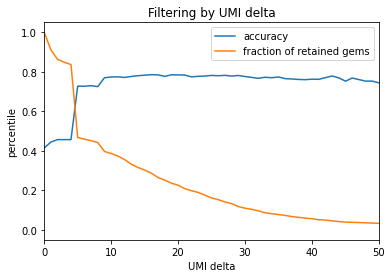

In [60]:
sub_df = df[df.ct_pep != 'unknown'].copy()
umi_thresholds = list(range(0, int(sub_df.delta_umi_mhc.max()+1)))
acc = list()
ngm = list()
for umi in umi_thresholds:
    acc.append(sub_df[sub_df.delta_umi_mhc >= umi].pep_match.sum() / sum(sub_df.delta_umi_mhc >= umi))
    ngm.append(sum(sub_df.delta_umi_mhc >= umi)/ len(sub_df))
    
plt.plot(umi_thresholds, acc, label='accuracy')
plt.plot(umi_thresholds, ngm, label='fraction of retained gems')
plt.legend()
plt.xlabel('UMI delta')
plt.ylabel('percentile')
plt.title('Filtering by UMI delta')
plt.xlim(0,50)
plt.show()

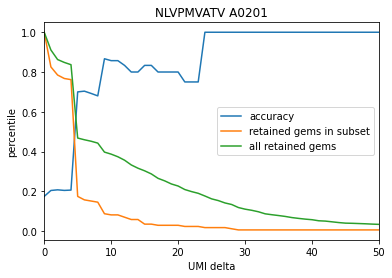

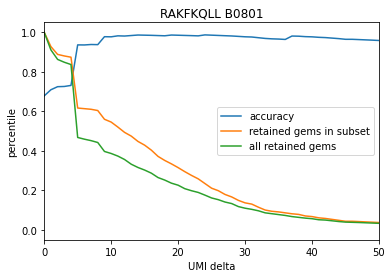

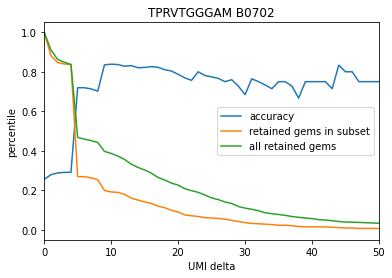

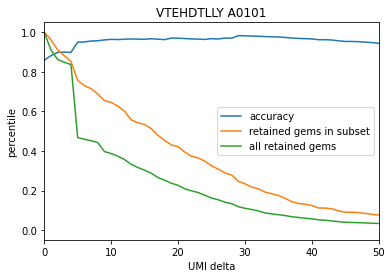

In [61]:
for peptide in ['NLVPMVATV A0201','RAKFKQLL B0801','TPRVTGGGAM B0702','VTEHDTLLY A0101']:
    sub_df = df[df.ct_pep == peptide]
    umi_thresholds = list(range(0, int(sub_df.delta_umi_mhc.max()+1)))
    acc = list()
    ngm = list()
    agm = list()
    for umi in umi_thresholds:
        acc.append(sub_df[sub_df.delta_umi_mhc >= umi].pep_match.sum() / sum(sub_df.delta_umi_mhc >= umi))
        ngm.append(sum(sub_df.delta_umi_mhc >= umi)/ len(sub_df))
        agm.append(sum(df.delta_umi_mhc >= umi)/ len(df))

    plt.plot(umi_thresholds, acc, label='accuracy')
    plt.plot(umi_thresholds, ngm, label='retained gems in subset')
    plt.plot(umi_thresholds, agm, label='all retained gems')
    plt.legend()
    plt.xlabel('UMI delta')
    plt.ylabel('percentile')
    plt.title(peptide)
    plt.xlim(0,50)
    plt.show()

# How does ct_pep match the listed peptides?

In [72]:
df.groupby(['ct_pep','pep_match','cdr3_TRB','genes_TRB','ct']).peptide_HLA_lst.apply(list).to_frame().head(60)

peptide_HLA_lst
ct_pep           pep_match cdr3_TRB         genes_TRB                    ct                                                      
AYLTNQYM A2401   True      CASSLNEQYF       TRBV7-9;;TRBJ2-7;TRBC2       538.0                                 [[AYLTNQYM A2401]]
FLDTNQVVRI A0201 True      CASSEQGDTGELFF   TRBV6-1;TRBD1;TRBJ2-2;TRBC2  494.0                               [[FLDTNQVVRI A0201]]
GPFPGNLVDV B0702 False     CASSLGIHYEQYF    TRBV28;;TRBJ2-7;TRBC2        50.0                                 [[VTEHDTLLY A0101]]
                 True      CASSLGIHYEQYF    TRBV28;;TRBJ2-7;TRBC2        50.0   [[GPKPAKPCS B0702, VTEHDTLLY A0101, PSTPLKPL B...
                           CASSPRADNNEQFF   TRBV28;;TRBJ2-1;TRBC2        435.0                               [[GPFPGNLVDV B0702]]
IGLFSAGAFI A2401 True      CASSWDVRNTDTQYF  TRBV2;;TRBJ2-3;TRBC2         569.0  [[YPLVKMRLS B0702, LFSAGAFI A2401, EERQAYLTNQY...
IHFDPGFEEQ A0101 True      CASSLGTSGNTGELFF TRBV5-6;TRBD2;TRBJ2-2;TRBC2  198.0                               [[IHFDPGFEEQ A0101]]
NLVPMVATV A0201  False     CASSLVAGAPSEQYF  TRBV27;;TRBJ2-7;TRBC2        3.0    [[WPRAPRGQ B0702, KSPFTETWNF B0702, PSTPLKPL B...
                 True      CASSLVAGAPSEQYF  TRBV27;;TRBJ2-7;TRBC2        3.0    [[EERQAYLTNQY A0101, ALPGVPPV A0201, YLFHKEPTW...
RAKFKQLL B0801   False     CAMAGTGSTDTQYF   TRBV10-3;TRBD1;TRBJ2-3;TRBC2 17.0   [[RQAYLTNQY A0101], [TPRVTGGGAM B0702], [VTEHD...
                           CASSDLNSPLHF     TRBV27;;TRBJ1-6;TRBC1        28.0   [[RAKFKQLL B0801, VTEHDTLLY A0101], [VTEHDTLLY...
                           CASSLIVSGGANEQFF TRBV7-3;;TRBJ2-1;TRBC2       2.0    [[VTEHDTLLY A0101], [EERQAYLTNQY A0101, VTEHDT...
                                                                         4.0    [[VTEHDTLLY A0101], [ATTADVDAGSL A0101], [FSAG...
                           CASSYTVGEYNEQFF  TRBV7-2;;TRBJ2-1;TRBC2       49.0                                 [[VTEHDTLLY A0101]]
                 True      CAMAGTGSTDTQYF   TRBV10-3;TRBD1;TRBJ2-3;TRBC2 17.0   [[RAKFKQLL B0801], [VIRHKRQSW B0801, SQKVLRHM ...
                           CASSDLNSPLHF     TRBV27;;TRBJ1-6;TRBC1        28.0   [[SQKVLRHM B0801, EERQAYLTNQY A0101, VTEHDTLLY...
                           CASSLIVSGGANEQFF TRBV7-3;;TRBJ2-1;TRBC2       2.0    [[ALPGVPPV A0201, RQAYLTNQY A0101, VTEHDTLLY A...
                                                                         4.0    [[VTEHDTLLY A0101, TPRVTGGGAM B0702, TADVDAGSL...
                           CASSYTVGEYNEQFF  TRBV7-2;;TRBJ2-1;TRBC2       49.0   [[FSAGAFILYK A0101, TPRVTGGGAM B0702, EERQAYLT...
RTMFWGPEV A0201  True      CASSFVEDTIYF     TRBV28;;TRBJ1-3;TRBC1        535.0                                [[RTMFWGPEV A0201]]
SAGAFILYK A0101  True      CASSLSGGGRGAEAFF TRBV7-9;TRBD1;TRBJ1-1;TRBC1  537.0                                [[SAGAFILYK A0101]]
TPRVTGGGAM B0702 False     CASRIGAAGNSPLHF  TRBV27;;TRBJ1-6;             1.0                                   [[RAKFKQLL B0801]]
                                            TRBV27;;TRBJ1-6;TRBC1        1.0    [[GPFPGNLVD B0702, WAGGLGLNL B0702, VTEHDTLLY ...
                           CASSPSDALVSEQYF  TRBV7-9;;TRBJ2-7;TRBC2       20.0   [[SVDIHFDPGF A0101], [EERQAYLTNQY A0101, VTEHD...
                 True      CASRIGAAGNSPLHF  TRBV27;;TRBJ1-6;TRBC1        1.0    [[KVPAQRLQEA B0702, AMLIRDRL B0801, VTEHDTLLY ...
                           CASSPSDALVSEQYF  TRBV7-9;;TRBJ2-7;TRBC2       20.0   [[VTEHDTLLY A0101, EERQAYLTNQY A0101, GPKPAKPC...
VPAQRLQEA B0801  True      CASRRNLGGNQPQHF  TRBV28;;TRBJ1-5;TRBC1        272.0                                [[VPAQRLQEA B0801]]
VTEHDTLLY A0101  False     CASRVQFGVNTGELFF TRBV19;;TRBJ2-2;TRBC2        10.0   [[NLVPMVATV A0201, RAKFKQLL B0801, RQAYLTNQY A...
                                                                         32.0   [[TPRVTGGGAM B0702, LFSAGAFILYK A0101, LFSAGAF...
                           CASSERGQGAYEQYF  TRBV5-4;TRBD1;TRBJ2-7;TRBC2  33.0       

In [15]:
df.groupby(['ct_pep','cdr3_TRB','genes_TRB','ct']).peptide_lst.unique().to_frame().head(60)

peptide_lst
ct_pep           cdr3_TRB           genes_TRB                    ct                                                      
AYLTNQYM A2401   CASSLNEQYF         TRBV7-9;;TRBJ2-7;TRBC2       538.0                                     [['AYLTNQYM']]
FLDTNQVVRI A0201 CASSEQGDTGELFF     TRBV6-1;TRBD1;TRBJ2-2;TRBC2  494.0                                   [['FLDTNQVVRI']]
GPFPGNLVDV B0702 CASSLGIHYEQYF      TRBV28;;TRBJ2-7;TRBC2        50.0   [['VTEHDTLLY'], ['GPKPAKPCS' 'VTEHDTLLY' 'PSTP...
                 CASSPRADNNEQFF     TRBV28;;TRBJ2-1;TRBC2        435.0                                   [['GPFPGNLVDV']]
IGLFSAGAFI A2401 CASSWDVRNTDTQYF    TRBV2;;TRBJ2-3;TRBC2         569.0  [['YPLVKMRLS' 'LFSAGAFI' 'EERQAYLTNQY' 'NLVPMV...
IHFDPGFEEQ A0101 CASSLGTSGNTGELFF   TRBV5-6;TRBD2;TRBJ2-2;TRBC2  198.0                                   [['IHFDPGFEEQ']]
NLVPMVATV A0201  CASSLVAGAPSEQYF    TRBV27;;TRBJ2-7;TRBC2        3.0    [['WPRAPRGQ' 'KSPFTETWNF' 'PSTPLKPL'], ['EERQA...
RAKFKQLL B0801   CAMAGTGSTDTQYF     TRBV10-3;TRBD1;TRBJ2-3;TRBC2 17.0   [['RAKFKQLL'], ['RQAYLTNQY'], ['TPRVTGGGAM'], ...
                 CASSDLNSPLHF       TRBV27;;TRBJ1-6;TRBC1        28.0   [['SQKVLRHM' 'EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQ...
                 CASSLIVSGGANEQFF   TRBV7-3;;TRBJ2-1;TRBC2       2.0    [['ALPGVPPV' 'RQAYLTNQY' 'VTEHDTLLY' 'EERQAYLT...
                                                                 4.0    [['VTEHDTLLY'], ['ATTADVDAGSL'], ['VTEHDTLLY' ...
                 CASSYTVGEYNEQFF    TRBV7-2;;TRBJ2-1;TRBC2       49.0   [['FSAGAFILYK' 'TPRVTGGGAM' 'EERQAYLTNQY' 'VTE...
RTMFWGPEV A0201  CASSFVEDTIYF       TRBV28;;TRBJ1-3;TRBC1        535.0                                    [['RTMFWGPEV']]
SAGAFILYK A0101  CASSLSGGGRGAEAFF   TRBV7-9;TRBD1;TRBJ1-1;TRBC1  537.0                                    [['SAGAFILYK']]
TPRVTGGGAM B0702 CASRIGAAGNSPLHF    TRBV27;;TRBJ1-6;             1.0                                       [['RAKFKQLL']]
                                    TRBV27;;TRBJ1-6;TRBC1        1.0    [['GPFPGNLVD' 'WAGGLGLNL' 'VTEHDTLLY'], ['RAKF...
                 CASSPSDALVSEQYF    TRBV7-9;;TRBJ2-7;TRBC2       20.0   [['VTEHDTLLY' 'EERQAYLTNQY' 'GPKPAKPCS' 'GPFPG...
VPAQRLQEA B0801  CASRRNLGGNQPQHF    TRBV28;;TRBJ1-5;TRBC1        272.0                                    [['VPAQRLQEA']]
VTEHDTLLY A0101  CASRRAGPVPFF       TRBV19;;TRBJ1-1;TRBC1        54.0   [['ICSSVDIHF' 'EERQAYLTNQY' 'RAKFKQLL' 'RQAYLT...
                 CASRVQFGVNTGELFF   TRBV19;;TRBJ2-2;TRBC2        10.0   [['QAYLTNQY' 'FSAGAFILYN' 'FSAGAFILYK' 'RAKFKQ...
                                                                 32.0   [['TADVDAGSLS' 'TNQYMQRMASV' 'FSAGAFILYK' 'ATT...
                 CASSERGQGAYEQYF    TRBV5-4;TRBD1;TRBJ2-7;TRBC2  33.0   [['EERQAYLTNQY' 'VTEHDTLLY'], ['AALPGVPPV' 'NL...
                 CASSFRRGQSSYEQYF   TRBV27;;TRBJ2-7;TRBC2        48.0   [['DEYVHNTTA' 'ATTADVDAGSL' 'FSAGAFILYK' 'GMAE...
                 CASSLATGRTYGYTF    TRBV7-8;;TRBJ1-2;TRBC1       25.0   [['RAKFKQLL'], ['GMAEGATTA' 'RQAYLTNQY' 'ATTAD...
                 CASSLEAGQKPYEQYF   TRBV7-9;;TRBJ2-7;TRBC2       13.0   [['ATTADVDAGSL' 'RAKFKQLL' 'VTEHDTLLY'], ['RAK...
                 CASSVGSGSSYEQYF    TRBV9;;TRBJ2-7;TRBC2         22.0   [['RAKFKQLL'], ['IRHKRQSWV' 'RQAYLTNQY' 'VTEHD...
                                                                 30.0   [['RQAYLTNQY' 'FSAGAFILYN' 'TNQYMQRMASV' 'TPRV...
                 CASSYTPGSTYEQYF    TRBV4-2;;TRBJ2-7;TRBC2       6.0    [['VTEHDTLLY'], ['LTNQYMQRM' 'TADVDAGSLS' 'FIS...
                                                                 7.0    [['VTEHDTLLY'], ['SAGAFILYK' 'FSAGAFILYN' 'QAY...
                 CSARGLGQAKEYGYTF   TRBV20-1;;TRBJ1-2;           16.0   [['TNQYMQRMASV' 'RAKFKQLL' 'RQAYLTNQY' 'VTEHDT...
                                    TRBV20-1;;TRBJ1-2;TRBC1      11.0   [['AYLTNQYM' 'TNQYMQRMASV' 'QAYLTNQY' 'ATTADVD...
                                                                 14.0   [['ATTADVDAG

In [16]:
df.groupby(['ct_pep','cdr3_TRB','genes_TRB','ct']).peptide_lst.unique().to_frame().tail(60)

peptide_lst
ct_pep     cdr3_TRB           genes_TRB                    ct                                                      
unresolved CASSVGQGVTYEQYF    TRBV9;TRBD1;TRBJ2-7;TRBC2    706.0                      [['ATTADVDAGSL' 'VTEHDTLLY']]
           CASSVIPRAGGNTGELFF TRBV9;;TRBJ2-2;TRBC2         171.0                       [['EERQAYLTNQY' 'RAKFKQLL']]
           CASSVSASGQTYGYTF   TRBV9;;TRBJ1-2;TRBC1         412.0                                    [['VTEHDTLLY']]
           CASSWGGTYNEQFF     TRBV12-3;;TRBJ2-1;TRBC2      439.0                                   [['TPRVTGGGAM']]
           CASSWGTSGYNEQFF    TRBV12-4;;TRBJ2-1;TRBC2      358.0  [['IRHKRQSWV' 'AMLIRDRL' 'VTEHDTLLY' 'FSAGAFIL...
           CASSWTSGRAYNEQFF   TRBV7-6;TRBD2;TRBJ2-1;TRBC2  189.0                       [['VTEHDTLLY' 'FSAGAFILYK']]
           CASSYAQDGSYEQYF    TRBV6-2;;TRBJ2-7;TRBC2       499.0                                  [['EERQAYLTNQY']]
           CASSYGWGGPYNEQFF   TRBV6-6;;TRBJ2-1;TRBC2       167.0                                     [['RAKFKQLL']]
           CASSYPAASSSYNSPLHF TRBV6-2;;TRBJ1-6;TRBC1       287.0  [['ATTADVDAGSL' 'RQAYLTNQY' 'RAKFKQLL' 'SVDIHF...
           CASSYRTVSSYEQYF    TRBV7-8;;TRBJ2-7;TRBC2       42.0   [['RAKFKQLL'], ['GPKPAKPCS' 'YPLVKMRLSV' 'KVPA...
                                                           79.0       [['RAKFKQLL'], ['VTEHDTLLY'], ['YPLVKMRLSV']]
                                                           566.0             [['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']]
                                                           704.0                                    [['VTEHDTLLY']]
           CASSYSGGYTEAFF     TRBV6-2;;TRBJ1-1;TRBC1       611.0                                    [['VTEHDTLLY']]
           CASSYSPVNTEAFF     TRBV6-2;;TRBJ1-1;TRBC1       158.0                        [['GPFPGNLV' 'TPRVTGGGAM']]
           CASSYSSGELFF       TRBV6-2;;TRBJ2-2;TRBC2       577.0                                    [['VTEHDTLLY']]
           CASSYTLGEGVTQYF    TRBV7-8;;TRBJ2-5;TRBC2       631.0  [['HTGEKHYAC' 'NLVPMVATV' 'AMLIRDRL' 'VTEHDTLL...
           CASSYTPGSTYEQYF    TRBV4-2;;TRBJ2-7;TRBC2       67.0   [['TADVDAGSLS' 'RAKFKQLL' 'ATTADVDAGSL' 'FSAGA...
                                                           68.0   [['NLVPMVATV' 'EERQAYLTNQY' 'TADVDAGSLS' 'RQAY...
                                                           131.0  [['TNQYMQRMASV' 'TPRVTGGGAM' 'SVDIHFDPG' 'GMAE...
                                                           564.0                      [['ATTADVDAGSL' 'VTEHDTLLY']]
                                                           583.0  [['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPM...
                                                           585.0  [['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFIL...
           CASSYVAGTKSSYNEQFF TRBV6-6;;TRBJ2-1;TRBC2       543.0                                  [['EERQAYLTNQY']]
           CASTGARRSETQYF     TRBV2;;TRBJ2-5;TRBC2         471.0                                   [['TPRVTGGGAM']]
           CASTILPSGTGGHDEQFF TRBV4-1;TRBD1;TRBJ2-1;TRBC2  429.0           [['RAKFKQLL' 'ATTADVDAGSL' 'VTEHDTLLY']]
           CASTIQGASTDTQYF    TRBV6-2;;TRBJ2-3;TRBC2       291.0                                     [['RAKFKQLL']]
           CASTNPGLNYEQYF     TRBV4-2;;TRBJ2-7;TRBC2       319.0                       [['FSAGAFILYK' 'GPKPAKPCS']]
           CASTPLAGGYNEQFF    TRBV6-1;;TRBJ2-1;TRBC2       280.0                                    [['VTEHDTLLY']]
           CASTPRDRGFQPQHF    TRBV19;TRBD1;TRBJ1-5;TRBC1   63.0   [['VTEHDTLLY'], ['NLVPMVATV' 'RAKFKQLL' 'FSAGA...
                                                           86.0             [['QAYLTNQY' 'TPRVTGGGAM' 'VTEHDTLLY']]
           CASTSLTGELFF       TRBV12-4;;TRBJ2-2;TRBC2      509.0             [['SVDIHFDPG' 'VTEHDTLLY' 'RAKFKQLL']]
           CASTVQTETGELFF     TRBV6-2;;TRBJ2-2;TRBC2       290.0                                   [['TPRVTGGGAM']]
           CASVGQGSYGYTF      TRBV2;TRBD1;TR

# Does pep_match correlate with multiple CDR3 annotations?

In [61]:
from collections.abc import Iterable
from itertools import chain

def func(x):                                         #use `str` in py3.x 
    # https://stackoverflow.com/questions/17338913/flatten-list-of-list-through-list-comprehension
    if isinstance(x, Iterable) and not isinstance(x, str): 
        return x
    return [x]

def magic(y):
    return list(chain.from_iterable(func(x) for x in y))

In [62]:
df.groupby(['ct_pep','pep_match']).cdr3_lst_TRB.apply(list).apply(magic)#.apply(lambda x: [y for y in x])#.apply(lambda x: list(k for k,_ in itertools.groupby(x))).to_frame().head(60)

ct_pep            pep_match
AYLTNQYM A2401    True                                              [CASSLNEQYF]
FLDTNQVVRI A0201  True                                          [CASSEQGDTGELFF]
GPFPGNLVDV B0702  False                                          [CASSLGIHYEQYF]
                  True                           [CASSPRADNNEQFF, CASSLGIHYEQYF]
IGLFSAGAFI A2401  True                                         [CASSWDVRNTDTQYF]
IHFDPGFEEQ A0101  True                                        [CASSLGTSGNTGELFF]
NLVPMVATV A0201   False        [CASSLVAGAPSEQYF, CASSLVAGAPSEQYF, CASSLVAGAPS...
                  True         [CASSLVAGAPSEQYF, CASSLVAGAPSEQYF, CASSLVAGAPS...
RAKFKQLL B0801    False        [CAMAGTGSTDTQYF, CASSLIVSGGANEQFF, CAMAGTGSTDT...
                  True         [CASSLIVSGGANEQFF, CASSLIVSGGANEQFF, CAMAGTGST...
RTMFWGPEV A0201   True                                            [CASSFVEDTIYF]
SAGAFILYK A0101   True                      [CSAVGSWAPNTGELFF, CASSLSGGGRGAEAFF]


In [63]:
df.groupby(['ct_pep','pep_match']).cdr3_lst_TRA.apply(list).apply(magic)

ct_pep            pep_match
AYLTNQYM A2401    True                                         [CAAHHDYNQGGKLIF]
FLDTNQVVRI A0201  True                                            [CAVRDSNYQLIW]
GPFPGNLVDV B0702  False                                                       []
                  True                                     [CAASPPMIKAAGNKLTF, ]
IGLFSAGAFI A2401  True                         [CAGASGIKAAGNKLTF, CATQTGTASKLTF]
IHFDPGFEEQ A0101  True                                            [CAPNNQGGKLIF]
NLVPMVATV A0201   False        [CAVNYGNKLVF, CAVNYGNKLVF, CAVNYGNKLVF, CAVNYG...
                  True         [CAVNYGNKLVF, CAVNYGNKLVF, CAVNYGNKLVF, CAVNYG...
RAKFKQLL B0801    False        [CAESETGANNLFF, CALRDMEYGNKLVF, CAESETGANNLFF,...
                  True         [CALRDMEYGNKLVF, CALRDMEYGNKLVF, CAESETGANNLFF...
RTMFWGPEV A0201   True                                            [CAGFNQGGKLIF]
SAGAFILYK A0101   True                                              [CAAQGGKLIF]


In [17]:
trash_bin

{'AALPGVPPV A0201',
 'ALPGVPPV A0201',
 'AMLIRDRL B0801',
 'ATTADVDAGSL A0101',
 'AYRAALGASL B0702',
 'CSSVDIHF A0101',
 'EERQAYLTNQY A0101',
 'FISPQLQRI A0201',
 'FLDTNQVVRIL A0201',
 'FSAGAFILYK A0101',
 'FSAGAFILYN A0101',
 'GLFSAGAFIL A2401',
 'GMAEGATTA A0101',
 'GPFPGNLV B0702',
 'GPFPGNLVD B0702',
 'GPKPAKPCS B0702',
 'GPKPAKPCSGA B0702',
 'HTGEKHYAC B0801',
 'ICSSVDIHF A0101',
 'IHFDPGFEEQL A2401',
 'ILKEPVHGV A0201',
 'IRHKRQSWV B0801',
 'KVPAQRLQEA B0702',
 'LFSAGAFI A2401',
 'LFSAGAFILYN A0101',
 'LLFERPHTM B0801',
 'NLVPMVATV A0201',
 'PSTPLKPL B0702',
 'QAYLTNQY A0101',
 'RAKFKQLL B0801',
 'RQAYLTNQY A0101',
 'RQAYLTNQYM A0101',
 'SQKVLRHM B0801',
 'SSGYRIGQF B0801',
 'SVDIHFDPG A0101',
 'SVDIHFDPGF A0101',
 'TADVDAGSLS A0101',
 'TADVDAGSLSY A0101',
 'TMFWGPEV A0201',
 'TNQYMQRMASV A2401',
 'TPRVTGGGAM B0702',
 'VIRHKRQSW B0801',
 'VTEHDTLLY A0101',
 'WPRAPRGQ B0702',
 'WPRAPRGQI B0801',
 'WPRAPRGQIP B0702',
 'YPLVKMRLS B0702',
 'YPLVKMRLSV B0702'}

# Beyond clonotypes

In [66]:
df.groupby(['cdr3_TRB','genes_TRB','ct','ct_pep']).peptide_HLA.unique().to_frame().head(20)

peptide_HLA
cdr3_TRB         genes_TRB                    ct    ct_pep                                                             
CAGGQGFSEAFF     TRBV30;TRBD1;TRBJ1-1;TRBC1   130.0 unresolved                                        [VTEHDTLLY A0101]
                                              168.0 unresolved                      [VTEHDTLLY A0101, TPRVTGGGAM B0702]
CAIKPRQLNTEAFF   TRBV7-9;;TRBJ1-1;TRBC1       565.0 unresolved                                        [VTEHDTLLY A0101]
CAMAGTGSTDTQYF   TRBV10-3;TRBD1;TRBJ2-3;TRBC2 17.0  RAKFKQLL B0801    [RAKFKQLL B0801, RQAYLTNQY A0101, TPRVTGGGAM B...
                                              27.0  unresolved                                         [RAKFKQLL B0801]
CASAGDGTYNEQFF   TRBV27;;TRBJ2-1;TRBC2        300.0 unresolved                                         [RAKFKQLL B0801]
CASKGSGTGNSPLHF  TRBV2;;TRBJ1-6;TRBC1         557.0 unresolved                                       [TPRVTGGGAM B0702]
CASKMGGSTDTQYF   TRBV18;;TRBJ2-3;TRBC2        570.0 unresolved                                        [VTEHDTLLY A0101]
CASKQAGTEAFF     TRBV27;;TRBJ1-1;TRBC1        485.0 unresolved                                        [VTEHDTLLY A0101]
CASQDSSGNTIYF    TRBV7-9;;TRBJ1-3;TRBC1       614.0 unresolved                                        [VTEHDTLLY A0101]
CASRDTGTGTSYEQYF TRBV28;TRBD1;TRBJ2-7;TRBC2   311.0 unresolved                                        [VTEHDTLLY A0101]
CASRETGTNTGELFF  TRBV19;TRBD1;TRBJ2-2;TRBC2   194.0 unresolved                                      [EERQAYLTNQY A0101]
CASRETSGATDTQYF  TRBV6-4;;TRBJ2-3;TRBC2       304.0 unresolved                                      [EERQAYLTNQY A0101]
CASRFTRGSEQETQYF TRBV27;;TRBJ2-5;TRBC2        664.0 unresolved                                        [VTEHDTLLY A0101]
CASRIGAAGNSPLHF  TRBV27;;TRBJ1-6;             1.0   TPRVTGGGAM B0702                                   [RAKFKQLL B0801]
                 TRBV27;;TRBJ1-6;TRBC1        1.0   TPRVTGGGAM B0702  [VTEHDTLLY A0101, RAKFKQLL B0801, TPRVTGGGAM B...
                                              8.0   unresolved        [RAKFKQLL B0801, VTEHDTLLY A0101, RRKVPAQRL B0...
                                              53.0  unresolved                                         [RAKFKQLL B0801]
                                              57.0  unresolved                                       [TADVDAGSLS A0101]
CASRMAGALSYEQYF  TRBV2;;TRBJ2-7;TRBC2         89.0  unresolved                                         [RAKFKQLL B0801]

In [16]:
test_df = df.fillna('NaN').groupby(['cdr3_TRB','cdr3_TRA','ct','ct_pep']).peptide_HLA.unique().to_frame().reset_index()
test_df

,cdr3_TRB,cdr3_TRA,ct,ct_pep,peptide_HLA
0,CAGGQGFSEAFF,CAAISGGYNKLIF,168.0,unsolvable,"[VTEHDTLLY A0101, TPRVTGGGAM B0702]"
1,CAGGQGFSEAFF,CALSRASGGSYIPTF,130.0,unsolvable,[VTEHDTLLY A0101]
2,CAIKPRQLNTEAFF,CAAKYAGGTSYGKLTF,565.0,unresolved,[VTEHDTLLY A0101]
3,CAMAGTGSTDTQYF,CAESETGANNLFF,17.0,RAKFKQLL B0801,"[RAKFKQLL B0801, RQAYLTNQY A0101, TPRVTGGGAM B..."
4,CAMAGTGSTDTQYF,NaN,27.0,unresolved,[RAKFKQLL B0801]
...,...,...,...,...,...
383,NaN,CAVNYGNKLVF,15.0,unresolved,"[RAKFKQLL B0801, IRHKRQSW B0801, EERQAYLTNQY A..."
384,NaN,CAVSTHGGSQGNLIF,177.0,unresolved,[RAKFKQLL B0801]
385,NaN,CAVTAPAYSGAGSYQLTF,102.0,unresolved,[RAKFKQLL B0801]
386,NaN,CIVRVGGDSWGKLQF,61.0,unresolved,[VTEHDTLLY A0101]


In [17]:
test_df['cdr3_TRA'] = (test_df.cdr3_TRA
        .replace('NaN',np.nan)
        .groupby(test_df['cdr3_TRB'])
        .transform(lambda x: x.ffill()))

In [18]:
df['cdr3_TRA_1'] = df.cdr3_TRA
df['ct_1'] = df.ct
df['ct_pep_1'] = df.ct_pep

In [19]:
df['cdr3_TRA'] = df.set_index('ct').index.map(test_df.set_index('ct').cdr3_TRA.to_dict())

In [20]:
df['VB'] = df.genes_TRB.str.split(';',expand=True)[0]
df['VA'] = df.genes_TRA.str.split(';',expand=True)[0]
df['cdr3_comb'] = df.cdr3_TRA.fillna('') + df.cdr3_TRB.fillna('')

In [21]:
df['ct'] =  assign_clonotype(df, clonotype_variables = ['cdr3_comb'])

In [22]:
df.ct.unique().shape

(340,)

In [23]:
df.ct_1.unique().shape

(388,)

In [26]:
df.fillna('NaN').groupby(['cdr3_TRB','cdr3_TRA','ct','ct_pep']).peptide_HLA.unique().to_frame().head(60)

peptide_HLA
cdr3_TRB           cdr3_TRA           ct  ct_pep                                                             
CAGGQGFSEAFF       CAAISGGYNKLIF      90  unsolvable                      [VTEHDTLLY A0101, TPRVTGGGAM B0702]
                   CALSRASGGSYIPTF    320 unsolvable                                        [VTEHDTLLY A0101]
CAIKPRQLNTEAFF     CAAKYAGGTSYGKLTF   239 unresolved                                        [VTEHDTLLY A0101]
CAMAGTGSTDTQYF     CAESETGANNLFF      11  RAKFKQLL B0801    [RAKFKQLL B0801, RQAYLTNQY A0101, TPRVTGGGAM B...
CASAGDGTYNEQFF     NaN                334 unresolved                                         [RAKFKQLL B0801]
CASKGSGTGNSPLHF    CVVYAAFYDYKLSF     340 unresolved                                       [TPRVTGGGAM B0702]
CASKMGGSTDTQYF     CAANFGNEKLTF       249 unresolved                                        [VTEHDTLLY A0101]
CASKQAGTEAFF       CAMRGDFGNEKLTF     322 unsolvable                                        [VTEHDTLLY A0101]
CASQDSSGNTIYF      CAYRWGGSQGNLIF     166 unresolved                                        [VTEHDTLLY A0101]
CASRDTGTGTSYEQYF   NaN                331 unresolved                                        [VTEHDTLLY A0101]
CASRETGTNTGELFF    CALDDNTGKLIF       228 unresolved                                      [EERQAYLTNQY A0101]
CASRETSGATDTQYF    NaN                330 unresolved                                      [EERQAYLTNQY A0101]
CASRFTRGSEQETQYF   CALSESGGSGNTGKLIF  217 unresolved                                        [VTEHDTLLY A0101]
CASRIGAAGNSPLHF    CAASQNEKLTF        2   TPRVTGGGAM B0702  [VTEHDTLLY A0101, RAKFKQLL B0801, TPRVTGGGAM B...
                   CALRDMEYGNKLVF     223 unsolvable                                       [TADVDAGSLS A0101]
                   CAVNYGNKLVF        21  unresolved        [RAKFKQLL B0801, VTEHDTLLY A0101, RRKVPAQRL B0...
CASRMAGALSYEQYF    CAVRDIGQAGTALIF    63  unsolvable                                         [RAKFKQLL B0801]
CASRPGLAGVYNEQFF   CAAAETSYDKVIF      87  unresolved                       [IRHKRQSWV B0801, VTEHDTLLY A0101]
CASRPNTGTVSSYNEQFF NaN                329 unresolved                                         [RAKFKQLL B0801]
CASRPRYRSYNEQFF    CAVNYGNKLVF        170 unsolvable                                        [GMAEGATTA A0101]
CASRRAGPVPFF       CAVGADASGTYKYIF    32  VTEHDTLLY A0101                                   [VTEHDTLLY A0101]
CASRRNLGGNQPQHF    CAVNTGDYKLSF       168 VPAQRLQEA B0801                                   [VPAQRLQEA B0801]
CASRSTEPNQPQHF     CAASERGGHTGANSKLTF 261 unresolved                                         [RAKFKQLL B0801]
CASRTGGREPQHF      CAGNTDKLIF         224 unresolved                                        [VTEHDTLLY A0101]
CASRTGGVNEQYF      CAVYSGAGSYQLTF     182 unresolved                                         [RAKFKQLL B0801]
CASRVGLASSYNEQFF   CAVNGGFKTIF        127 unresolved                                       [TPRVTGGGAM B0702]
CASRVQFGVNTGELFF   CAASQNEKLTF        252 unsolvable                                        [VTEHDTLLY A0101]
                   CAASRYAGNNRKLIW    251 unsolvable                                        [VTEHDTLLY A0101]
                   CALWEYGNKLVF       5   VTEHDTLLY A0101   [VTEHDTLLY A0101, ILKEPVHGV A0201, CSSVDIHF A0...
                   CAVNYGNKLVF        20  VTEHDTLLY A0101                [VTEHDTLLY A0101, EERQAYLTNQY A0101]
CASSADRSEAFF       CAYYSGAGSYQLTF     142 unresolved                                         [RAKFKQLL B0801]
CASSAEQGVPYEQYF    CAARPTASKLTF       46  unresolved                        [RAKFKQLL B0801, VTEHDTLLY A0101]
CASSAGQGSSYEQYF    CAVLLIQGAQKLVF     136 unresolved                                        [VTEHDTLLY A0101]
CASSAGSYNEQFF      CAAIDSNYQLIW       234 unresolved                                        [VTEHDTLLY A0101]
CASSAGTLNTEAFF     NaN                328 unresolved                                       [FSAGAFILYK A0101]
CASSDEWAEKLFF      CALLEETSG

### 1

In [70]:
df.fillna('NaN').groupby(['cdr3_TRB','cdr3_TRA','ct','ct_pep']).peptide_HLA.unique().to_frame().head(60)

peptide_HLA
cdr3_TRB           cdr3_TRA           ct    ct_pep                                                             
CAGGQGFSEAFF       CAAISGGYNKLIF      168.0 unresolved                      [VTEHDTLLY A0101, TPRVTGGGAM B0702]
                   CALSRASGGSYIPTF    130.0 unresolved                                        [VTEHDTLLY A0101]
CAIKPRQLNTEAFF     CAAKYAGGTSYGKLTF   565.0 unresolved                                        [VTEHDTLLY A0101]
CAMAGTGSTDTQYF     CAESETGANNLFF      17.0  RAKFKQLL B0801    [RAKFKQLL B0801, RQAYLTNQY A0101, TPRVTGGGAM B...
                   NaN                27.0  unresolved                                         [RAKFKQLL B0801]
CASAGDGTYNEQFF     NaN                300.0 unresolved                                         [RAKFKQLL B0801]
CASKGSGTGNSPLHF    CVVYAAFYDYKLSF     557.0 unresolved                                       [TPRVTGGGAM B0702]
CASKMGGSTDTQYF     CAANFGNEKLTF       570.0 unresolved                                        [VTEHDTLLY A0101]
CASKQAGTEAFF       CAMRGDFGNEKLTF     485.0 unresolved                                        [VTEHDTLLY A0101]
CASQDSSGNTIYF      CAYRWGGSQGNLIF     614.0 unresolved                                        [VTEHDTLLY A0101]
CASRDTGTGTSYEQYF   NaN                311.0 unresolved                                        [VTEHDTLLY A0101]
CASRETGTNTGELFF    CALDDNTGKLIF       194.0 unresolved                                      [EERQAYLTNQY A0101]
CASRETSGATDTQYF    NaN                304.0 unresolved                                      [EERQAYLTNQY A0101]
CASRFTRGSEQETQYF   CALSESGGSGNTGKLIF  664.0 unresolved                                        [VTEHDTLLY A0101]
CASRIGAAGNSPLHF    CAASQNEKLTF        1.0   TPRVTGGGAM B0702  [VTEHDTLLY A0101, RAKFKQLL B0801, TPRVTGGGAM B...
                   CALRDMEYGNKLVF     57.0  unresolved                                       [TADVDAGSLS A0101]
                   CAVNYGNKLVF        53.0  unresolved                                         [RAKFKQLL B0801]
                   NaN                8.0   unresolved        [RAKFKQLL B0801, VTEHDTLLY A0101, RRKVPAQRL B0...
CASRMAGALSYEQYF    CAVRDIGQAGTALIF    578.0 unresolved                                         [RAKFKQLL B0801]
                   NaN                89.0  unresolved                                         [RAKFKQLL B0801]
CASRPGLAGVYNEQFF   CAAAETSYDKVIF      73.0  unresolved                       [IRHKRQSWV B0801, VTEHDTLLY A0101]
CASRPNTGTVSSYNEQFF NaN                298.0 unresolved                                         [RAKFKQLL B0801]
CASRPRYRSYNEQFF    CAVNYGNKLVF        629.0 unresolved                                        [GMAEGATTA A0101]
CASRRAGPVPFF       CAVGADASGTYKYIF    54.0  VTEHDTLLY A0101                                   [VTEHDTLLY A0101]
                   NaN                137.0 unresolved                                        [VTEHDTLLY A0101]
CASRRNLGGNQPQHF    CAVNTGDYKLSF       272.0 VPAQRLQEA B0801                                   [VPAQRLQEA B0801]
CASRSTEPNQPQHF     CAASERGGHTGANSKLTF 576.0 unresolved                                         [RAKFKQLL B0801]
CASRTGGREPQHF      CAGNTDKLIF         140.0 unresolved                                        [VTEHDTLLY A0101]
CASRTGGVNEQYF      CAVYSGAGSYQLTF     647.0 unresolved                                         [RAKFKQLL B0801]
CASRVGLASSYNEQFF   CAVNGGFKTIF        135.0 unresolved                                       [TPRVTGGGAM B0702]
CASRVQFGVNTGELFF   CAASQNEKLTF        678.0 unresolved                                        [VTEHDTLLY A0101]
                   CAASRYAGNNRKLIW    568.0 unresolved                                        [VTEHDTLLY A0101]
                   CALWEYGNKLVF       10.0  VTEHDTLLY A0101   [VTEHDTLLY A0101, ILKEPVHGV A0201, CSSVDIHF A0...
                   CAVNYGNKLVF        624.0 unresolved                                        [VTEHDTLLY A0101]
                   NaN                32.0  VTEHDTLLY A0101         

In [71]:
df.fillna('NaN').groupby(['cdr3_TRB','cdr3_TRA','ct','ct_pep']).peptide_HLA.unique().to_frame().tail(60)

peptide_HLA
cdr3_TRB           cdr3_TRA            ct    ct_pep                                                             
CASTILPSGTGGHDEQFF CAASEGSYIPTF        429.0 unresolved                                        [VTEHDTLLY A0101]
CASTIQGASTDTQYF    NaN                 291.0 unresolved                                         [RAKFKQLL B0801]
CASTNPGLNYEQYF     NaN                 319.0 unresolved                                        [GPKPAKPCS B0702]
CASTPLAGGYNEQFF    NaN                 280.0 unresolved                                        [VTEHDTLLY A0101]
CASTPRDRGFQPQHF    CAVRDSPGRDDKIIF     86.0  unresolved                                        [VTEHDTLLY A0101]
                   NaN                 63.0  unresolved                     [VTEHDTLLY A0101, EERQAYLTNQY A0101]
CASTSLTGELFF       CAALMDSSYKLIF       509.0 unresolved                                         [RAKFKQLL B0801]
CASTVQTETGELFF     NaN                 290.0 unresolved                                       [TPRVTGGGAM B0702]
CASVGQGSYGYTF      NaN                 401.0 unresolved                                         [RAKFKQLL B0801]
CATQLGQGLSGANVLTF  CAMREVRLHGSSNTGKLIF 426.0 unresolved                                        [VTEHDTLLY A0101]
CATRQNTEAFF        CAVNYGNKLVF         603.0 unresolved                                        [VTEHDTLLY A0101]
                   NaN                 109.0 unresolved                                        [VTEHDTLLY A0101]
CATSDLYRDEQYF      CAVSGGGSQGNLIF      122.0 unresolved                                        [VTEHDTLLY A0101]
CATSRDLQVNQPQHF    CADPAGGTSYGKLTF     714.0 unresolved                                        [VTEHDTLLY A0101]
CATSRGAGTGGSYEQFF  CAVSSLTGANNLFF      104.0 unresolved                                        [VTEHDTLLY A0101]
CAWPRSTGELFF       CAVADSWGKFQF        21.0  unresolved        [EERQAYLTNQY A0101, RAKFKQLL B0801, VTEHDTLLY ...
CSAEGLAGQGVSYEQYF  CVAGGTNAGKSTF       560.0 unresolved                                        [VTEHDTLLY A0101]
                   NaN                 408.0 unresolved                                        [VTEHDTLLY A0101]
CSAGGGGIETQYF      CIVRLPDSGGYQKVTF    686.0 unresolved                                       [TPRVTGGGAM B0702]
CSAKRLAGEADTQYF    CAVPNYGGATNKLIF     505.0 unresolved                                        [VTEHDTLLY A0101]
CSALGLADDNEQFF     CAMREGLEGYQKVTF     152.0 unresolved                                       [TPRVTGGGAM B0702]
CSARAGTGQETQYF     NaN                 386.0 unresolved                                        [VTEHDTLLY A0101]
CSARAGTSGRTDTQYF   CAVRDSWGKFQF        514.0 unresolved                                         [RAKFKQLL B0801]
CSARDLTGNYGYTF     CAARNPPWGGGSQGNLIF  711.0 unresolved                                         [RAKFKQLL B0801]
CSARGLGQAKEYGYTF   CAAFRAYNTDKLIF      11.0  VTEHDTLLY A0101   [VTEHDTLLY A0101, FSAGAFILYK A0101, EERQAYLTNQ...
                   CALRDMEYGNKLVF      478.0 unresolved                                        [VTEHDTLLY A0101]
                   CAVEDRLDNDMRF       14.0  VTEHDTLLY A0101   [VTEHDTLLY A0101, NLVPMVATV A0201, RAKFKQLL B0...
                   CAVNYGNKLVF         716.0 unresolved                                      [EERQAYLTNQY A0101]
                   NaN                 16.0  VTEHDTLLY A0101   [VTEHDTLLY A0101, RAKFKQLL B0801, EERQAYLTNQY ...
CSASLASHPNTGELFF   CLPYGSGNTGKLIF      240.0 unresolved                                        [VTEHDTLLY A0101]
CSAVGSWAPNTGELFF   CAAQGGKLIF          534.0 unresolved                                        [NLVPMVATV A0201]
CSVEGRAMGYTF       CAVRDRDNDMRF        602.0 unresolved                                        [VTEHDTLLY A0101]
CSVEPPEGLTSTDTQYF  CAVRDTGGSNYQLIW     144.0 unresolved                                         [RAKFKQLL B0801]
CSVEVGRAGEQFF      CAFMRGGADGLTF       604.0 unresolved                                        [VTEHDTLLY A0101]
CSVEVPGKVFRTEAFF   CAASEPAKIPKAAG

In [44]:
lol = df.fillna('NaN').groupby(['cdr3_TRB','cdr3_TRA'])

In [46]:
grp = lol.size().sort_values(ascending=False)

In [48]:
for ct, sub_df in sorted(lol, key=lambda x: len(x[1]), reverse=True):
    print(ct)
    break

('CASSLIVSGGANEQFF', 'CALRDMEYGNKLVF')


In [64]:
ndf = df.fillna('NaN').explode('cdr3_lst_TRB').explode('cdr3_lst_TRA').drop_duplicates(['gem','cdr3_lst_TRB','cdr3_lst_TRA'])

[2.]


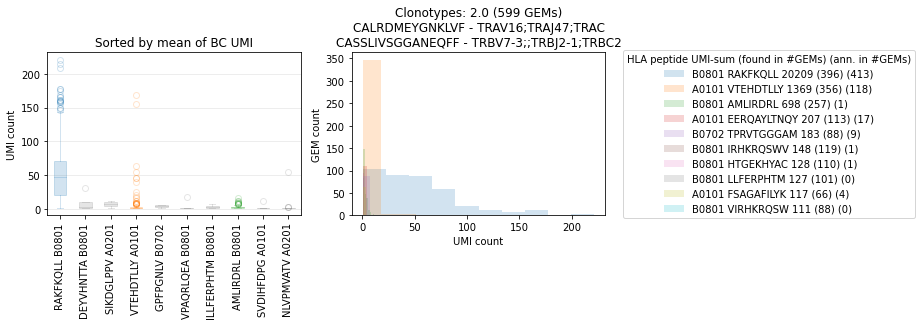

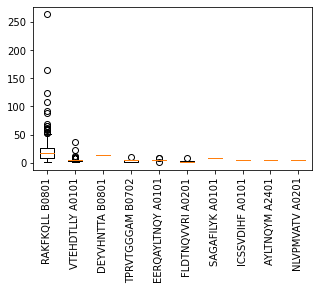

[1.]


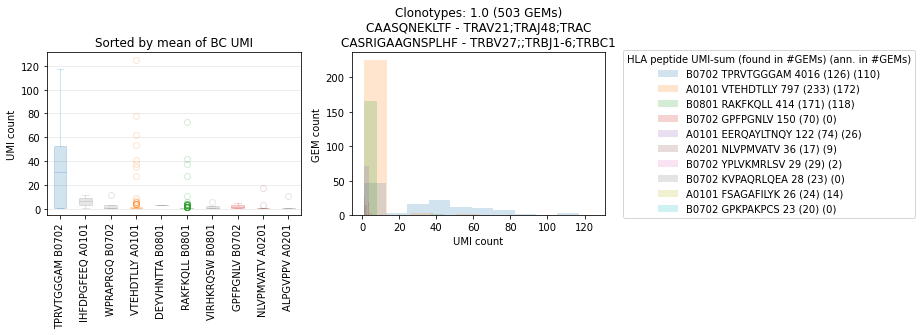

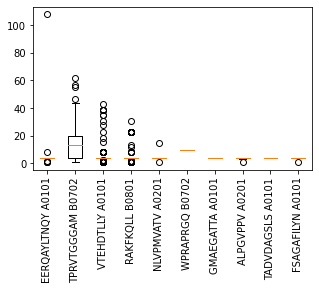

[3.]


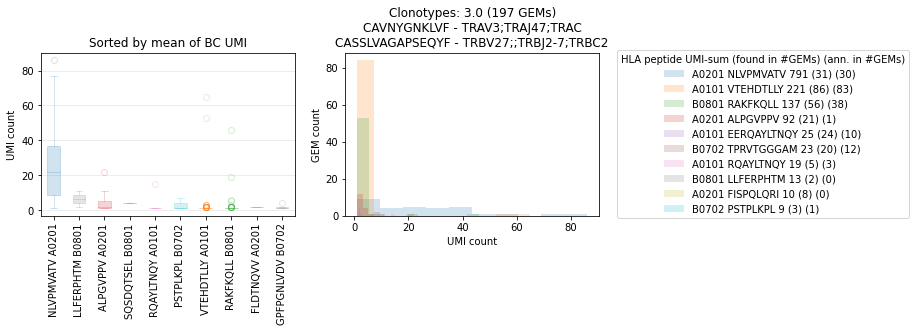

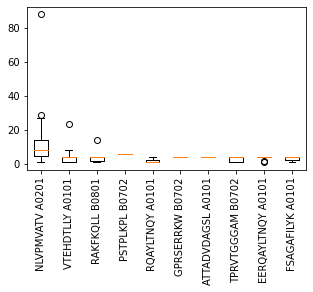

[18.]
('CASSLIVSGGANEQFF', 'CAASQNEKLTF') unresolved
        peptide                                        peptide_lst  \
19    VTEHDTLLY                        ['EERQAYLTNQY' 'VTEHDTLLY']   
19    VTEHDTLLY                        ['EERQAYLTNQY' 'VTEHDTLLY']   
19    VTEHDTLLY                        ['EERQAYLTNQY' 'VTEHDTLLY']   
19    VTEHDTLLY                        ['EERQAYLTNQY' 'VTEHDTLLY']   
19    VTEHDTLLY                        ['EERQAYLTNQY' 'VTEHDTLLY']   
...         ...                                                ...   
1890   RAKFKQLL  ['TPRVTGGGAM' 'VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDR...   
1890   RAKFKQLL  ['TPRVTGGGAM' 'VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDR...   
1890   RAKFKQLL  ['TPRVTGGGAM' 'VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDR...   
1890   RAKFKQLL  ['TPRVTGGGAM' 'VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDR...   
1890   RAKFKQLL  ['TPRVTGGGAM' 'VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDR...   

     umi_count_lst_mhc    cdr3_lst_TRA  \
19              [1, 1]  CALRDMEYGNKLVF   
19              [1, 1]

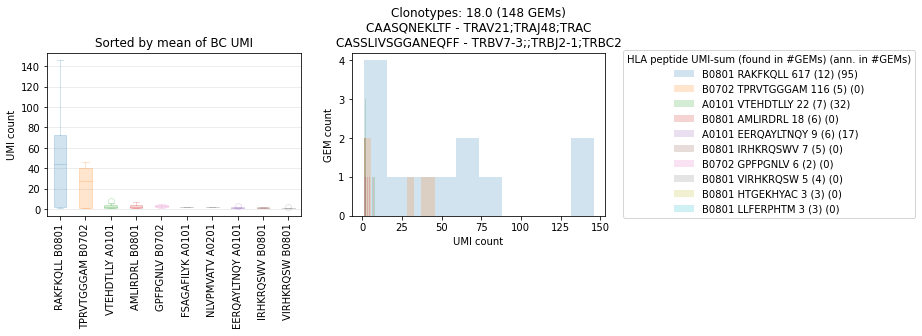

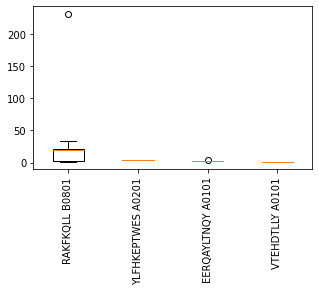

[6.]


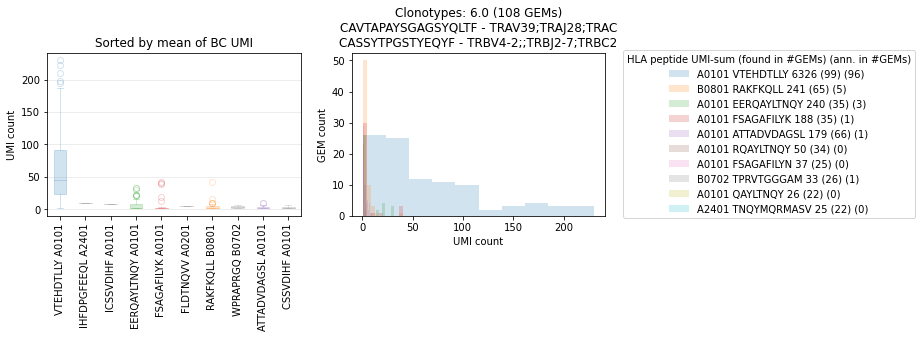

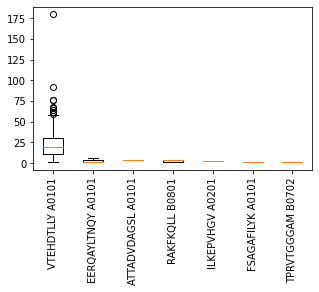

[7.]


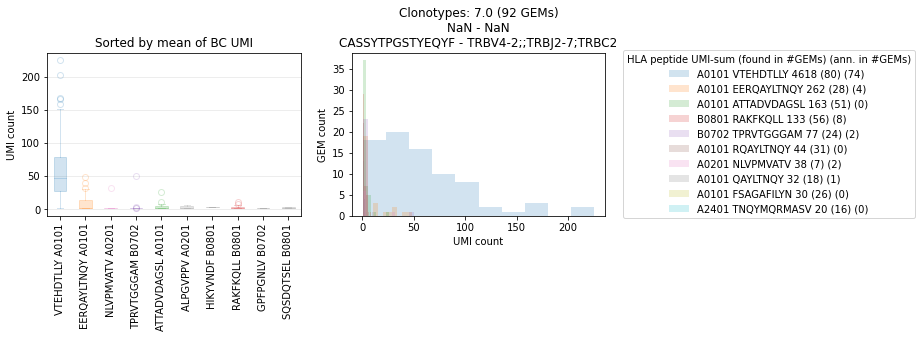

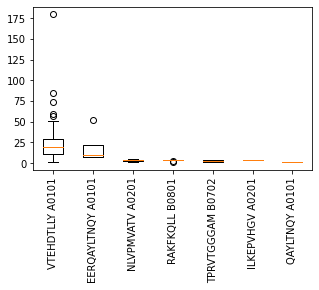

[11.]
[10.]


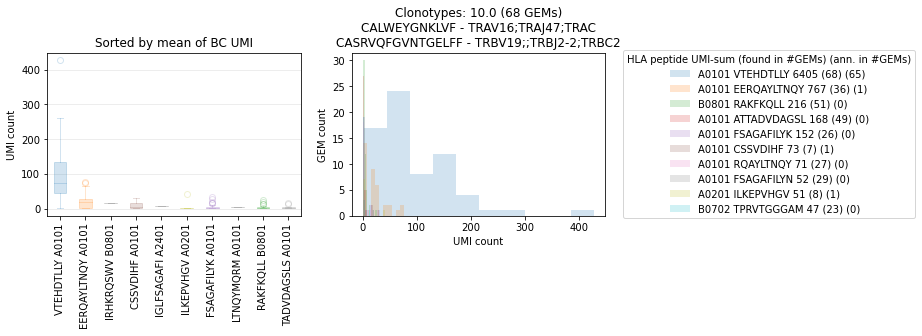

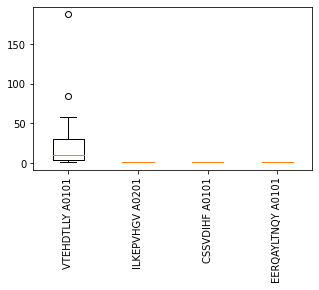

[39.]
('CASSLIVSGGANEQFF', 'CAVNYGNKLVF') unresolved
        peptide                                        peptide_lst  \
7      RAKFKQLL  ['TPRVTGGGAM' 'IRHKRQSWV' 'EERQAYLTNQY' 'MDMFS...   
7      RAKFKQLL  ['TPRVTGGGAM' 'IRHKRQSWV' 'EERQAYLTNQY' 'MDMFS...   
7      RAKFKQLL  ['TPRVTGGGAM' 'IRHKRQSWV' 'EERQAYLTNQY' 'MDMFS...   
7      RAKFKQLL  ['TPRVTGGGAM' 'IRHKRQSWV' 'EERQAYLTNQY' 'MDMFS...   
7      RAKFKQLL  ['TPRVTGGGAM' 'IRHKRQSWV' 'EERQAYLTNQY' 'MDMFS...   
...         ...                                                ...   
1330   RAKFKQLL  ['YADYSYAI' 'AMLIRDRL' 'VIRHKRQSW' 'NLVPMVATV'...   
1330   RAKFKQLL  ['YADYSYAI' 'AMLIRDRL' 'VIRHKRQSW' 'NLVPMVATV'...   
1330   RAKFKQLL  ['YADYSYAI' 'AMLIRDRL' 'VIRHKRQSW' 'NLVPMVATV'...   
1330   RAKFKQLL  ['YADYSYAI' 'AMLIRDRL' 'VIRHKRQSW' 'NLVPMVATV'...   
1464  VTEHDTLLY                                      ['VTEHDTLLY']   

                                     umi_count_lst_mhc    cdr3_lst_TRA  \
7                               

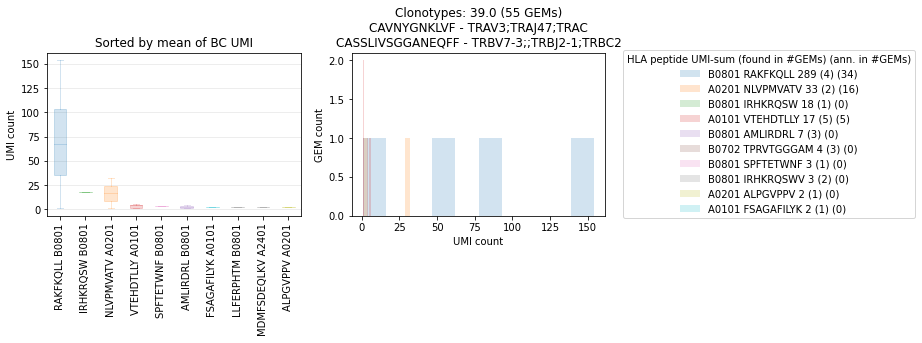

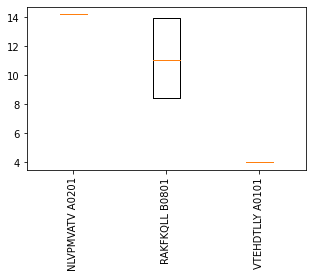

[14.]
('CSARGLGQAKEYGYTF', 'CAVEDRLDNDMRF') unresolved
        peptide                                        peptide_lst  \
25    VTEHDTLLY             ['ATTADVDAGSL' 'RAKFKQLL' 'VTEHDTLLY']   
198   VTEHDTLLY                         ['FSAGAFILYK' 'VTEHDTLLY']   
211   VTEHDTLLY                                      ['VTEHDTLLY']   
245   VTEHDTLLY  ['RQAYLTNQY' 'QAYLTNQY' 'ATTADVDAGSL' 'TNQYMQR...   
283   NLVPMVATV                                      ['NLVPMVATV']   
...         ...                                                ...   
2017  VTEHDTLLY  ['RAKFKQLL' 'RQAYLTNQY' 'FSAGAFILYN' 'ATTADVDA...   
2017  VTEHDTLLY  ['RAKFKQLL' 'RQAYLTNQY' 'FSAGAFILYN' 'ATTADVDA...   
2017  VTEHDTLLY  ['RAKFKQLL' 'RQAYLTNQY' 'FSAGAFILYN' 'ATTADVDA...   
2017  VTEHDTLLY  ['RAKFKQLL' 'RQAYLTNQY' 'FSAGAFILYN' 'ATTADVDA...   
2017  VTEHDTLLY  ['RAKFKQLL' 'RQAYLTNQY' 'FSAGAFILYN' 'ATTADVDA...   

        umi_count_lst_mhc    cdr3_lst_TRA  \
25             [2, 2, 45]   CAVEDRLDNDMRF   
198           

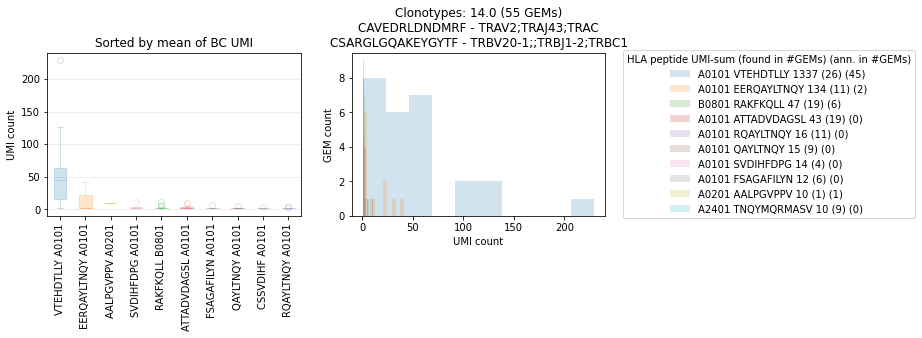

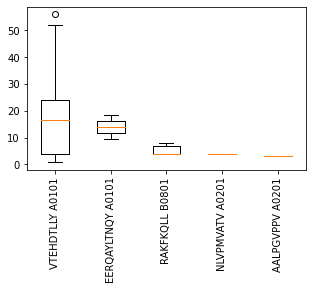

[4.]


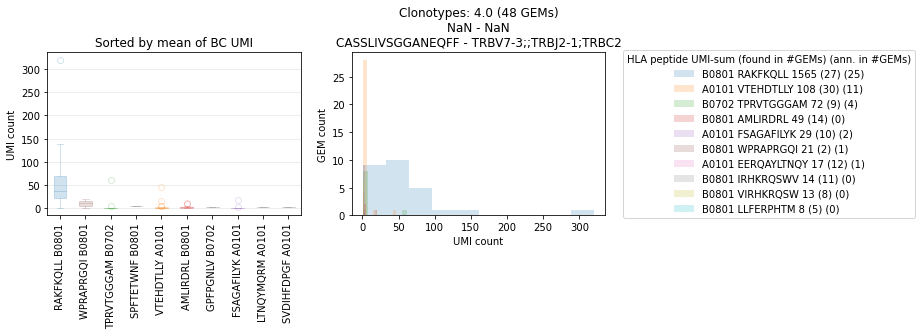

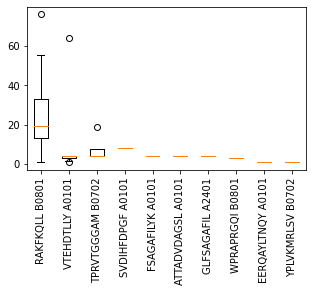

[49.]
[66.]
('CASSLVAGAPSEQYF', 'CAASQNEKLTF') unresolved
         peptide                  peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
555   FSAGAFILYK  ['TPRVTGGGAM' 'FSAGAFILYK']            [1, 1]  CAVNYGNKLVF   
555   FSAGAFILYK  ['TPRVTGGGAM' 'FSAGAFILYK']            [1, 1]  CAASQNEKLTF   
555   FSAGAFILYK  ['TPRVTGGGAM' 'FSAGAFILYK']            [1, 1]  CAVNYGNKLVF   
555   FSAGAFILYK  ['TPRVTGGGAM' 'FSAGAFILYK']            [1, 1]  CAASQNEKLTF   
555   FSAGAFILYK  ['TPRVTGGGAM' 'FSAGAFILYK']            [1, 1]  CAVNYGNKLVF   
...          ...                          ...               ...          ...   
1603   VTEHDTLLY                ['VTEHDTLLY']               [1]  CAASQNEKLTF   
1603   VTEHDTLLY                ['VTEHDTLLY']               [1]  CAVNYGNKLVF   
1603   VTEHDTLLY                ['VTEHDTLLY']               [1]  CAVNYGNKLVF   
1603   VTEHDTLLY                ['VTEHDTLLY']               [1]  CAASQNEKLTF   
1603   VTEHDTLLY                ['VTEHDTLLY']               [1

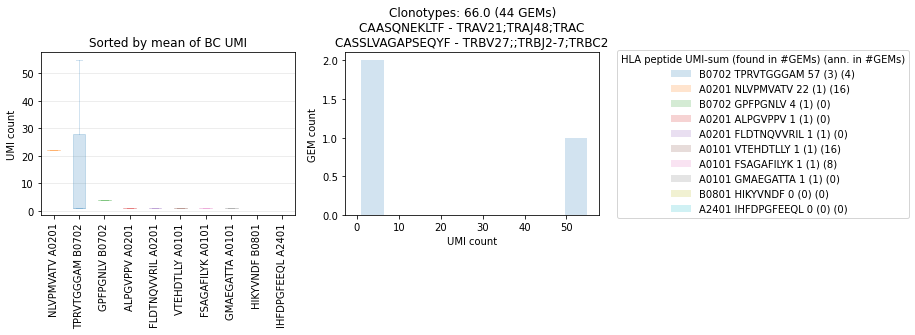

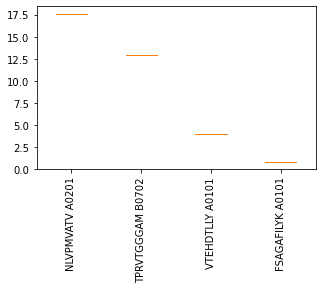

[13.]
[37.]
('CASSQTYPNTGELFF', 'CAYREYGNKLVF') unresolved
        peptide                                        peptide_lst  \
104    RAKFKQLL  ['AMLIRDRL' 'ILLFERPHTM' 'LLFERPHTM' 'VTEHDTLL...   
309   VTEHDTLLY                        ['ATTADVDAGSL' 'VTEHDTLLY']   
309   VTEHDTLLY                        ['ATTADVDAGSL' 'VTEHDTLLY']   
309   VTEHDTLLY                        ['ATTADVDAGSL' 'VTEHDTLLY']   
309   VTEHDTLLY                        ['ATTADVDAGSL' 'VTEHDTLLY']   
...         ...                                                ...   
754   VTEHDTLLY  ['SVDIHFDPG' 'TNQYMQRMASV' 'TPRVTGGGAM' 'SQKVL...   
1101   RAKFKQLL    ['VTEHDTLLY' 'HTGEKHYAC' 'AMLIRDRL' 'RAKFKQLL']   
1349   RAKFKQLL                ['IRHKRQSWV' 'AMLIRDRL' 'RAKFKQLL']   
1786   RAKFKQLL                ['VIRHKRQSW' 'AMLIRDRL' 'RAKFKQLL']   
1989  VTEHDTLLY                                      ['VTEHDTLLY']   

                                      umi_count_lst_mhc  cdr3_lst_TRA  \
104                        

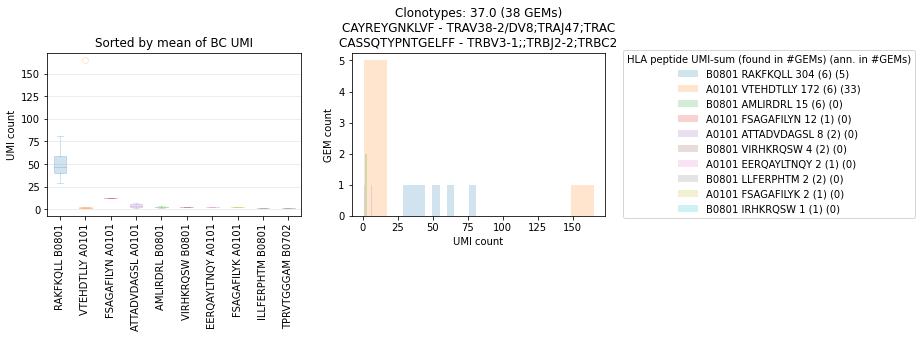

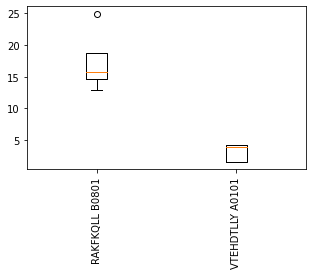

[5.]


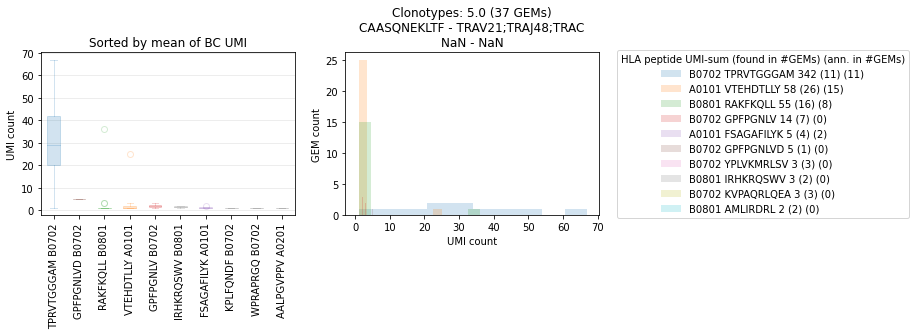

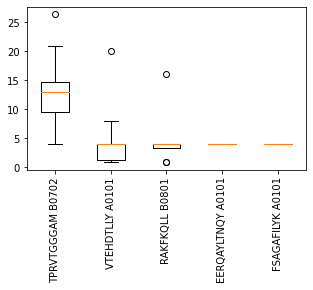

[24.]
('CASSERGQGAYEQYF', 'CAAENQGGKLIF') unresolved
        peptide                                        peptide_lst  \
562   VTEHDTLLY  ['EERQAYLTNQY' 'TPRVTGGGAM' 'RAKFKQLL' 'ATTADV...   
671   VTEHDTLLY  ['FSAGAFILYK' 'NLVPMVATV' 'QAYLTNQY' 'RAKFKQLL...   
671   VTEHDTLLY  ['FSAGAFILYK' 'NLVPMVATV' 'QAYLTNQY' 'RAKFKQLL...   
671   VTEHDTLLY  ['FSAGAFILYK' 'NLVPMVATV' 'QAYLTNQY' 'RAKFKQLL...   
671   VTEHDTLLY  ['FSAGAFILYK' 'NLVPMVATV' 'QAYLTNQY' 'RAKFKQLL...   
...         ...                                                ...   
1775  VTEHDTLLY                                      ['VTEHDTLLY']   
1775  VTEHDTLLY                                      ['VTEHDTLLY']   
1775  VTEHDTLLY                                      ['VTEHDTLLY']   
1775  VTEHDTLLY                                      ['VTEHDTLLY']   
1775  VTEHDTLLY                                      ['VTEHDTLLY']   

        umi_count_lst_mhc     cdr3_lst_TRA  \
562      [1, 1, 1, 2, 42]     CAAENQGGKLIF   
671   [1, 1, 1

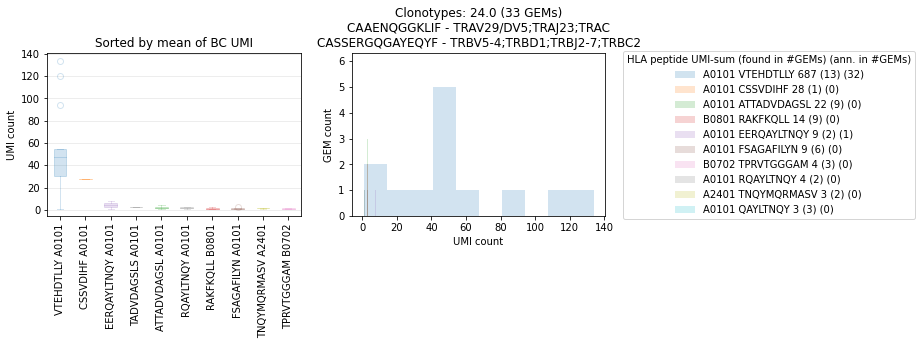

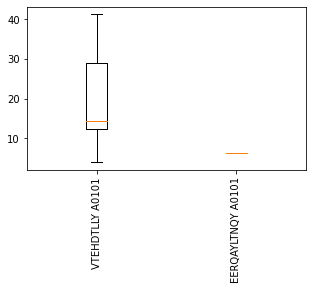

[22.]
[26.]
('CASSSPGSGASEKLFF', 'CAVGAGSNTGKLIF') unresolved
         peptide                  peptide_lst umi_count_lst_mhc  \
103   SVDIHFDPGF               ['SVDIHFDPGF']               [1]   
335    VTEHDTLLY  ['EERQAYLTNQY' 'VTEHDTLLY']            [1, 2]   
335    VTEHDTLLY  ['EERQAYLTNQY' 'VTEHDTLLY']            [1, 2]   
335    VTEHDTLLY  ['EERQAYLTNQY' 'VTEHDTLLY']            [1, 2]   
335    VTEHDTLLY  ['EERQAYLTNQY' 'VTEHDTLLY']            [1, 2]   
...          ...                          ...               ...   
1766    RAKFKQLL                 ['RAKFKQLL']               [1]   
1766    RAKFKQLL                 ['RAKFKQLL']               [1]   
1766    RAKFKQLL                 ['RAKFKQLL']               [1]   
1766    RAKFKQLL                 ['RAKFKQLL']               [1]   
1766    RAKFKQLL                 ['RAKFKQLL']               [1]   

        cdr3_lst_TRA                                    genes_lst_TRA  \
103   CAVGAGSNTGKLIF                          ['TRAV8-3;TRAJ

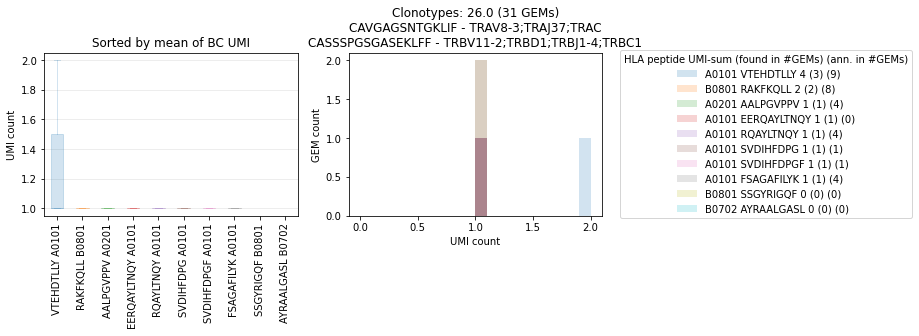

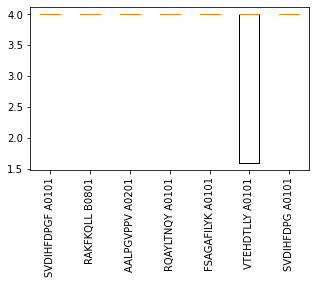

[51.]
('CASSLERDRPYEQYF', 'CAARPGAQKLVF') unresolved
          peptide                                        peptide_lst  \
26      VTEHDTLLY  ['QAYLTNQY' 'RAKFKQLL' 'GMAEGATTA' 'TNQYMQRMAS...   
26      VTEHDTLLY  ['QAYLTNQY' 'RAKFKQLL' 'GMAEGATTA' 'TNQYMQRMAS...   
26      VTEHDTLLY  ['QAYLTNQY' 'RAKFKQLL' 'GMAEGATTA' 'TNQYMQRMAS...   
26      VTEHDTLLY  ['QAYLTNQY' 'RAKFKQLL' 'GMAEGATTA' 'TNQYMQRMAS...   
26      VTEHDTLLY  ['QAYLTNQY' 'RAKFKQLL' 'GMAEGATTA' 'TNQYMQRMAS...   
...           ...                                                ...   
72    EERQAYLTNQY            ['LFSAGAFIL' 'VTEHDTLLY' 'EERQAYLTNQY']   
72    EERQAYLTNQY            ['LFSAGAFIL' 'VTEHDTLLY' 'EERQAYLTNQY']   
403     VTEHDTLLY   ['RAKFKQLL' 'SVDIHFDPG' 'RQAYLTNQY' 'VTEHDTLLY']   
1061    VTEHDTLLY  ['EERQAYLTNQY' 'TNQYMQRMASV' 'RAKFKQLL' 'VTEHD...   
2009    VTEHDTLLY          ['TNQYMQRMASV' 'ATTADVDAGSL' 'VTEHDTLLY']   

        umi_count_lst_mhc  cdr3_lst_TRA  \
26    [1, 1, 1, 2, 2, 86]   CAASQNEKLTF

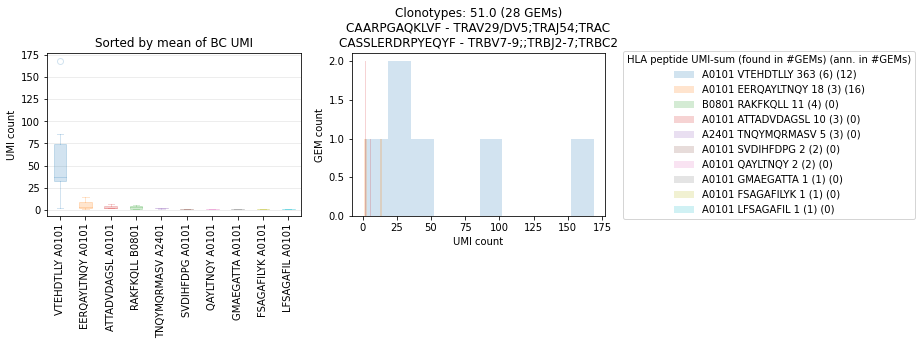

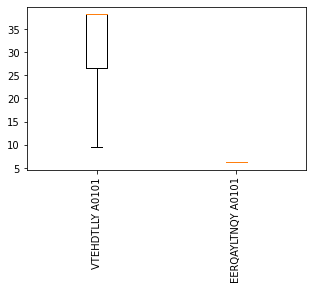

[17.]
[9.]
('CASSLVAGAPSEQYF', 'NaN') unresolved
         peptide                                        peptide_lst  \
2109   NLVPMVATV  ['ALPGVPPV' 'YLFHKEPTW' 'VTEHDTLLY' 'FISPQLQRI...   
2134   AIFCAIQNL                                      ['AIFCAIQNL']   
2155   VTEHDTLLY                                      ['VTEHDTLLY']   
2155   VTEHDTLLY                                      ['VTEHDTLLY']   
2155   VTEHDTLLY                                      ['VTEHDTLLY']   
2155   VTEHDTLLY                                      ['VTEHDTLLY']   
2171   VTEHDTLLY                                      ['VTEHDTLLY']   
2188    RAKFKQLL                                       ['RAKFKQLL']   
2250   VTEHDTLLY  ['RAKFKQLL' 'EERQAYLTNQY' 'ATTADVDAGSL' 'TPRVT...   
2280   VTEHDTLLY                                      ['VTEHDTLLY']   
2288   VTEHDTLLY                                      ['VTEHDTLLY']   
2295    RAKFKQLL                         ['ATTADVDAGSL' 'RAKFKQLL']   
2301   VTEHDTLLY            

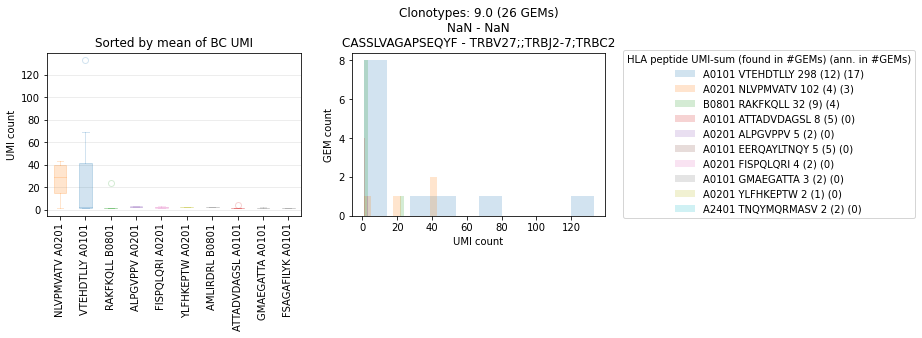

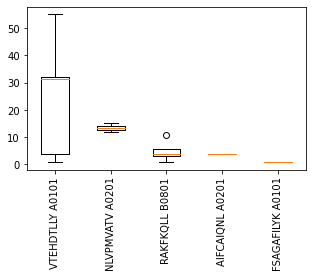

[68.]
('CASSYTPGSTYEQYF', 'CALRDMEYGNKLVF') unresolved
        peptide                                        peptide_lst  \
595   VTEHDTLLY  ['NLVPMVATV' 'EERQAYLTNQY' 'TADVDAGSLS' 'RQAYL...   
595   VTEHDTLLY  ['NLVPMVATV' 'EERQAYLTNQY' 'TADVDAGSLS' 'RQAYL...   
595   VTEHDTLLY  ['NLVPMVATV' 'EERQAYLTNQY' 'TADVDAGSLS' 'RQAYL...   
595   VTEHDTLLY  ['NLVPMVATV' 'EERQAYLTNQY' 'TADVDAGSLS' 'RQAYL...   
595   VTEHDTLLY  ['NLVPMVATV' 'EERQAYLTNQY' 'TADVDAGSLS' 'RQAYL...   
...         ...                                                ...   
1688   RAKFKQLL  ['IRHKRQSWV' 'GMAEGATTA' 'TNQYMQRMASV' 'AMLIRD...   
1688   RAKFKQLL  ['IRHKRQSWV' 'GMAEGATTA' 'TNQYMQRMASV' 'AMLIRD...   
1688   RAKFKQLL  ['IRHKRQSWV' 'GMAEGATTA' 'TNQYMQRMASV' 'AMLIRD...   
1688   RAKFKQLL  ['IRHKRQSWV' 'GMAEGATTA' 'TNQYMQRMASV' 'AMLIRD...   
1688   RAKFKQLL  ['IRHKRQSWV' 'GMAEGATTA' 'TNQYMQRMASV' 'AMLIRD...   

                           umi_count_lst_mhc    cdr3_lst_TRA  \
595   [1, 1, 1, 1, 1, 1, 2, 3, 3, 4, 9, 

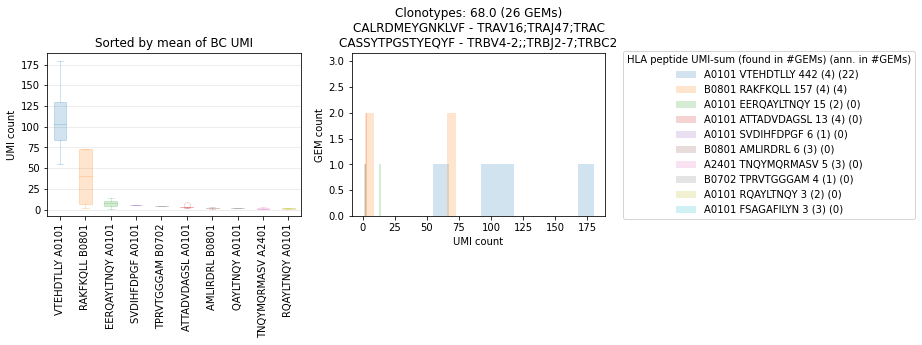

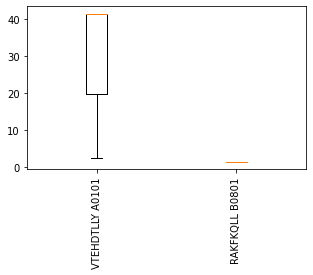

[67.]
('CASSYTPGSTYEQYF', 'CAASQNEKLTF') unresolved
        peptide                                        peptide_lst  \
660   VTEHDTLLY  ['TADVDAGSLS' 'RAKFKQLL' 'ATTADVDAGSL' 'FSAGAF...   
732   VTEHDTLLY  ['EERQAYLTNQY' 'ATTADVDAGSL' 'TPRVTGGGAM' 'RAK...   
732   VTEHDTLLY  ['EERQAYLTNQY' 'ATTADVDAGSL' 'TPRVTGGGAM' 'RAK...   
732   VTEHDTLLY  ['EERQAYLTNQY' 'ATTADVDAGSL' 'TPRVTGGGAM' 'RAK...   
732   VTEHDTLLY  ['EERQAYLTNQY' 'ATTADVDAGSL' 'TPRVTGGGAM' 'RAK...   
...         ...                                                ...   
1790  VTEHDTLLY  ['ILKEPVHGV' 'TPRVTGGGAM' 'RQAYLTNQY' 'FSAGAFI...   
1790  VTEHDTLLY  ['ILKEPVHGV' 'TPRVTGGGAM' 'RQAYLTNQY' 'FSAGAFI...   
1790  VTEHDTLLY  ['ILKEPVHGV' 'TPRVTGGGAM' 'RQAYLTNQY' 'FSAGAFI...   
1790  VTEHDTLLY  ['ILKEPVHGV' 'TPRVTGGGAM' 'RQAYLTNQY' 'FSAGAFI...   
1790  VTEHDTLLY  ['ILKEPVHGV' 'TPRVTGGGAM' 'RQAYLTNQY' 'FSAGAFI...   

           umi_count_lst_mhc        cdr3_lst_TRA  \
660         [1, 1, 2, 6, 30]         CAASQNEKLTF   
732

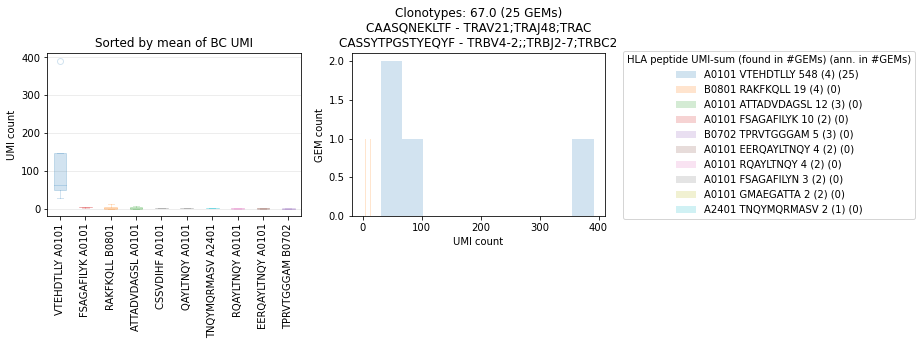

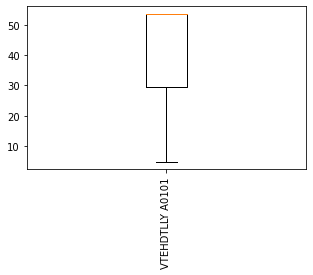

[23.]
('CSVEVPGKVFRTEAFF', 'CAASEPAKIPKAAGNKLTF') unresolved
         peptide                                        peptide_lst  \
99     VTEHDTLLY  ['GPRSERRKW' 'WPRAPRGQ' 'EERQAYLTNQY' 'VTEHDTL...   
178     RAKFKQLL                                       ['RAKFKQLL']   
178     RAKFKQLL                                       ['RAKFKQLL']   
178     RAKFKQLL                                       ['RAKFKQLL']   
178     RAKFKQLL                                       ['RAKFKQLL']   
...          ...                                                ...   
1827  TPRVTGGGAM                                     ['TPRVTGGGAM']   
1827  TPRVTGGGAM                                     ['TPRVTGGGAM']   
1827  TPRVTGGGAM                                     ['TPRVTGGGAM']   
1827  TPRVTGGGAM                                     ['TPRVTGGGAM']   
1975   VTEHDTLLY                                      ['VTEHDTLLY']   

     umi_count_lst_mhc         cdr3_lst_TRA  \
99     [1, 1, 1, 3, 3]  CAASEPAKIPKAAGN

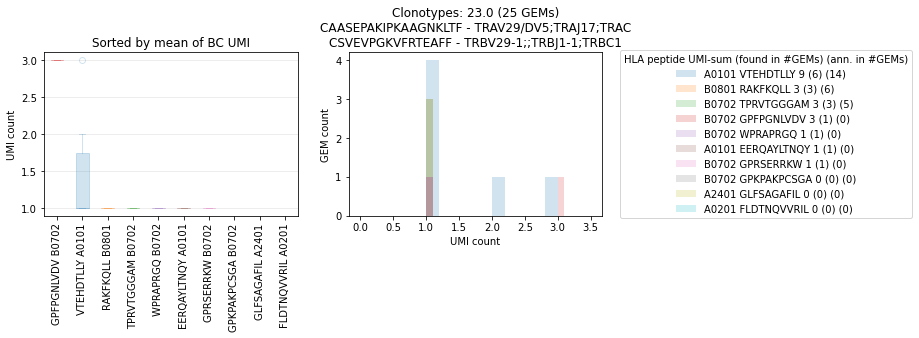

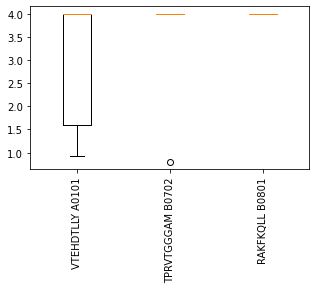

[260.]
('CASSGGQIDSGANVLTF', 'CVVTLHRDDKIIF') unresolved
        peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
2067  VTEHDTLLY  ['VTEHDTLLY']               [1]  CALSPRNNNARLMF   
2067  VTEHDTLLY  ['VTEHDTLLY']               [1]  CALSPRNNNARLMF   
2067  VTEHDTLLY  ['VTEHDTLLY']               [1]     CAASQNEKLTF   
2067  VTEHDTLLY  ['VTEHDTLLY']               [1]     CAASQNEKLTF   
2067  VTEHDTLLY  ['VTEHDTLLY']               [1]   CVVTLHRDDKIIF   
...         ...            ...               ...             ...   
2067  VTEHDTLLY  ['VTEHDTLLY']               [1]  CALSPRNNNARLMF   
2067  VTEHDTLLY  ['VTEHDTLLY']               [1]     CAASQNEKLTF   
2067  VTEHDTLLY  ['VTEHDTLLY']               [1]     CAASQNEKLTF   
2067  VTEHDTLLY  ['VTEHDTLLY']               [1]   CVVTLHRDDKIIF   
2067  VTEHDTLLY  ['VTEHDTLLY']               [1]   CVVTLHRDDKIIF   

                                          genes_lst_TRA umi_count_lst_TRA  \
2067  ['TRAV19;TRAJ31;TRAC' 'TRAV21;TRAJ48;TRAC' 

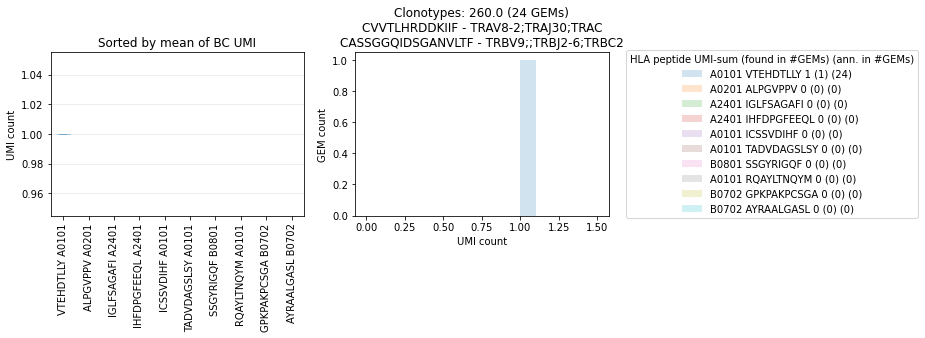

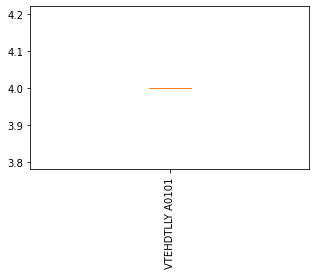

[484.]
('CASSLIVSGGANEQFF', 'CALSGSRNQFYF') unresolved
      peptide                                      peptide_lst  \
327  RAKFKQLL  ['AMLIRDRL' 'IRHKRQSWV' 'VTEHDTLLY' 'RAKFKQLL']   
327  RAKFKQLL  ['AMLIRDRL' 'IRHKRQSWV' 'VTEHDTLLY' 'RAKFKQLL']   
327  RAKFKQLL  ['AMLIRDRL' 'IRHKRQSWV' 'VTEHDTLLY' 'RAKFKQLL']   
327  RAKFKQLL  ['AMLIRDRL' 'IRHKRQSWV' 'VTEHDTLLY' 'RAKFKQLL']   
327  RAKFKQLL  ['AMLIRDRL' 'IRHKRQSWV' 'VTEHDTLLY' 'RAKFKQLL']   
..        ...                                              ...   
327  RAKFKQLL  ['AMLIRDRL' 'IRHKRQSWV' 'VTEHDTLLY' 'RAKFKQLL']   
327  RAKFKQLL  ['AMLIRDRL' 'IRHKRQSWV' 'VTEHDTLLY' 'RAKFKQLL']   
327  RAKFKQLL  ['AMLIRDRL' 'IRHKRQSWV' 'VTEHDTLLY' 'RAKFKQLL']   
327  RAKFKQLL  ['AMLIRDRL' 'IRHKRQSWV' 'VTEHDTLLY' 'RAKFKQLL']   
327  RAKFKQLL  ['AMLIRDRL' 'IRHKRQSWV' 'VTEHDTLLY' 'RAKFKQLL']   

    umi_count_lst_mhc     cdr3_lst_TRA  \
327     [1, 1, 2, 38]   CALRDMEYGNKLVF   
327     [1, 1, 2, 38]   CALRDMEYGNKLVF   
327     [1, 1, 2, 38]  CIV

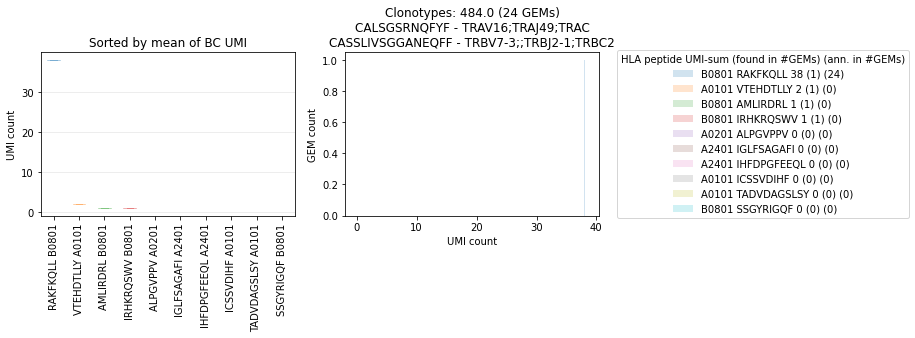

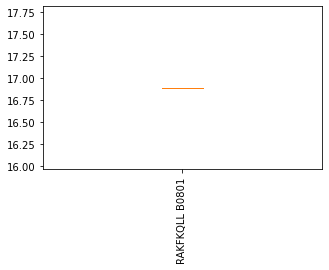

[479.]
('CASSPGQIGKTQYF', 'CALRDMEYGNKLVF') unresolved
      peptide                                        peptide_lst  \
171  RAKFKQLL  ['EERQAYLTNQY' 'IRHKRQSWV' 'VTEHDTLLY' 'AMLIRD...   
171  RAKFKQLL  ['EERQAYLTNQY' 'IRHKRQSWV' 'VTEHDTLLY' 'AMLIRD...   
171  RAKFKQLL  ['EERQAYLTNQY' 'IRHKRQSWV' 'VTEHDTLLY' 'AMLIRD...   
171  RAKFKQLL  ['EERQAYLTNQY' 'IRHKRQSWV' 'VTEHDTLLY' 'AMLIRD...   
171  RAKFKQLL  ['EERQAYLTNQY' 'IRHKRQSWV' 'VTEHDTLLY' 'AMLIRD...   
..        ...                                                ...   
171  RAKFKQLL  ['EERQAYLTNQY' 'IRHKRQSWV' 'VTEHDTLLY' 'AMLIRD...   
171  RAKFKQLL  ['EERQAYLTNQY' 'IRHKRQSWV' 'VTEHDTLLY' 'AMLIRD...   
171  RAKFKQLL  ['EERQAYLTNQY' 'IRHKRQSWV' 'VTEHDTLLY' 'AMLIRD...   
171  RAKFKQLL  ['EERQAYLTNQY' 'IRHKRQSWV' 'VTEHDTLLY' 'AMLIRD...   
171  RAKFKQLL  ['EERQAYLTNQY' 'IRHKRQSWV' 'VTEHDTLLY' 'AMLIRD...   

     umi_count_lst_mhc    cdr3_lst_TRA  \
171  [1, 1, 2, 6, 167]     CAVDSNYQLIW   
171  [1, 1, 2, 6, 167]     CAVDSNYQLIW   
17

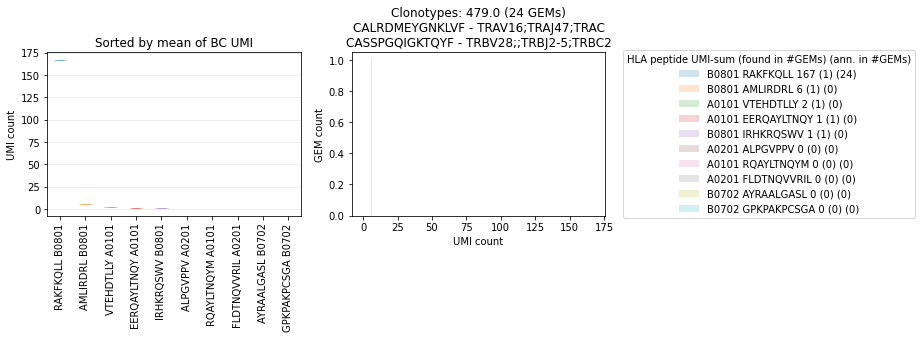

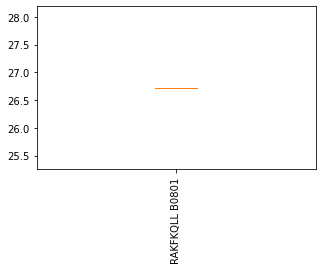

[46.]
('CASSEWGGRGGGYEQYF', 'CAHGNNRLAF') unresolved
         peptide                                        peptide_lst  \
230     RAKFKQLL                                       ['RAKFKQLL']   
230     RAKFKQLL                                       ['RAKFKQLL']   
230     RAKFKQLL                                       ['RAKFKQLL']   
230     RAKFKQLL                                       ['RAKFKQLL']   
230     RAKFKQLL                                       ['RAKFKQLL']   
...          ...                                                ...   
709    VTEHDTLLY  ['RQAYLTNQY' 'FSAGAFILYN' 'TNQYMQRMASV' 'GMAEG...   
709    VTEHDTLLY  ['RQAYLTNQY' 'FSAGAFILYN' 'TNQYMQRMASV' 'GMAEG...   
803    VTEHDTLLY                                      ['VTEHDTLLY']   
1813  FSAGAFILYK                                     ['FSAGAFILYK']   
1930   SAGAFILYK            ['VTEHDTLLY' 'EERQAYLTNQY' 'SAGAFILYK']   

                                     umi_count_lst_mhc cdr3_lst_TRA  \
230                    

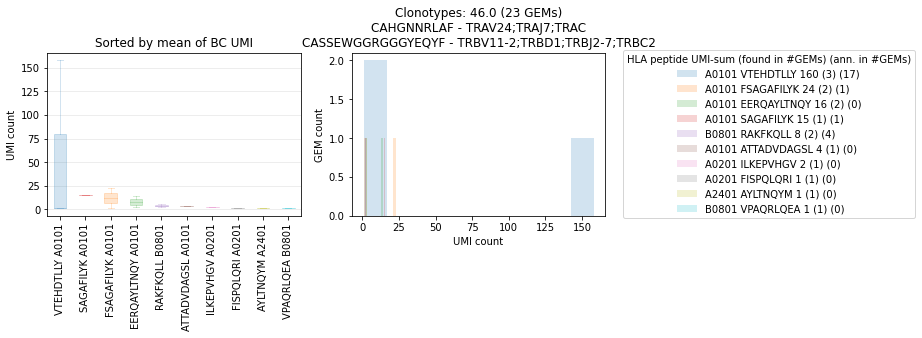

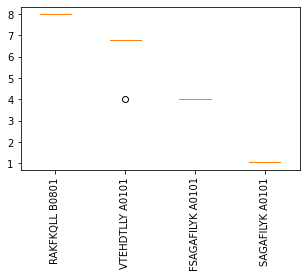

[16.]
[120.]
('CASSLERDRPYEQYF', 'CAASQNEKLTF') unresolved
        peptide                                        peptide_lst  \
1993  VTEHDTLLY          ['TNQYMQRMASV' 'ATTADVDAGSL' 'VTEHDTLLY']   
1993  VTEHDTLLY          ['TNQYMQRMASV' 'ATTADVDAGSL' 'VTEHDTLLY']   
1993  VTEHDTLLY          ['TNQYMQRMASV' 'ATTADVDAGSL' 'VTEHDTLLY']   
1993  VTEHDTLLY          ['TNQYMQRMASV' 'ATTADVDAGSL' 'VTEHDTLLY']   
1993  VTEHDTLLY          ['TNQYMQRMASV' 'ATTADVDAGSL' 'VTEHDTLLY']   
...         ...                                                ...   
2041  VTEHDTLLY  ['VDIHFDPGF' 'QAYLTNQY' 'RAKFKQLL' 'FSAGAFILYK...   
2041  VTEHDTLLY  ['VDIHFDPGF' 'QAYLTNQY' 'RAKFKQLL' 'FSAGAFILYK...   
2041  VTEHDTLLY  ['VDIHFDPGF' 'QAYLTNQY' 'RAKFKQLL' 'FSAGAFILYK...   
2041  VTEHDTLLY  ['VDIHFDPGF' 'QAYLTNQY' 'RAKFKQLL' 'FSAGAFILYK...   
2041  VTEHDTLLY  ['VDIHFDPGF' 'QAYLTNQY' 'RAKFKQLL' 'FSAGAFILYK...   

      umi_count_lst_mhc  cdr3_lst_TRA  \
1993         [1, 1, 24]  CAARPGAQKLVF   
1993         [1, 1

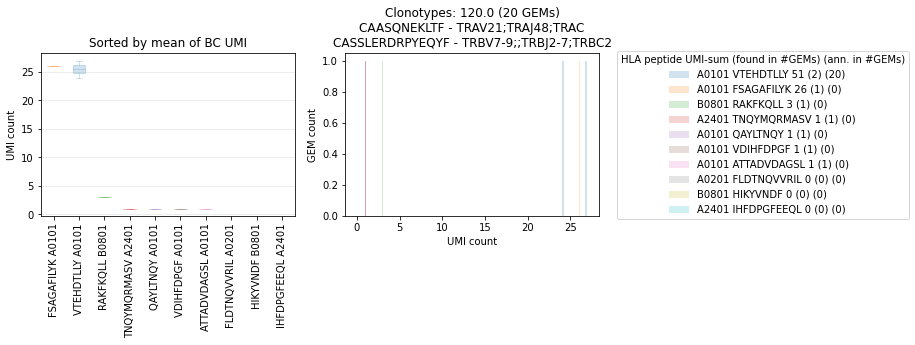

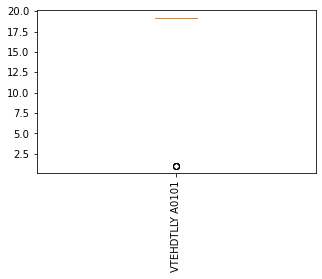

[33.]
[29.]
('CASSSLNTEAFF', 'CIVRVGGDSWGKLQF') unresolved
        peptide                                        peptide_lst  \
110    RAKFKQLL  ['EERQAYLTNQY' 'ATTADVDAGSL' 'VTEHDTLLY' 'IRHK...   
124   VTEHDTLLY                                      ['VTEHDTLLY']   
205   VTEHDTLLY                                      ['VTEHDTLLY']   
485    RAKFKQLL    ['NLVPMVATV' 'VTEHDTLLY' 'AMLIRDRL' 'RAKFKQLL']   
485    RAKFKQLL    ['NLVPMVATV' 'VTEHDTLLY' 'AMLIRDRL' 'RAKFKQLL']   
485    RAKFKQLL    ['NLVPMVATV' 'VTEHDTLLY' 'AMLIRDRL' 'RAKFKQLL']   
485    RAKFKQLL    ['NLVPMVATV' 'VTEHDTLLY' 'AMLIRDRL' 'RAKFKQLL']   
485    RAKFKQLL    ['NLVPMVATV' 'VTEHDTLLY' 'AMLIRDRL' 'RAKFKQLL']   
485    RAKFKQLL    ['NLVPMVATV' 'VTEHDTLLY' 'AMLIRDRL' 'RAKFKQLL']   
485    RAKFKQLL    ['NLVPMVATV' 'VTEHDTLLY' 'AMLIRDRL' 'RAKFKQLL']   
485    RAKFKQLL    ['NLVPMVATV' 'VTEHDTLLY' 'AMLIRDRL' 'RAKFKQLL']   
485    RAKFKQLL    ['NLVPMVATV' 'VTEHDTLLY' 'AMLIRDRL' 'RAKFKQLL']   
485    RAKFKQLL    ['NLVPMVATV'

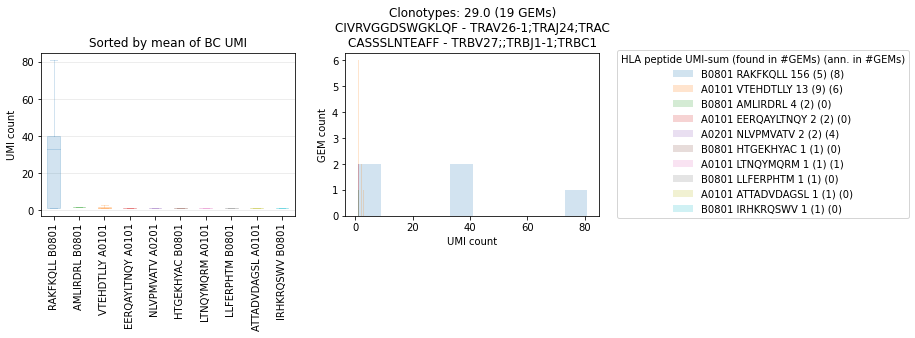

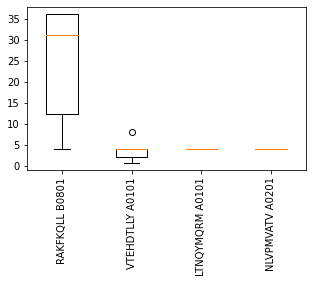

[578.]
('CASRMAGALSYEQYF', 'CAVRDIGQAGTALIF') unresolved
      peptide   peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
872  RAKFKQLL  ['RAKFKQLL']               [1]   CAASGGEYGNKLVF   
872  RAKFKQLL  ['RAKFKQLL']               [1]   CAASGGEYGNKLVF   
872  RAKFKQLL  ['RAKFKQLL']               [1]  CAVRDIGQAGTALIF   
872  RAKFKQLL  ['RAKFKQLL']               [1]  CAVRDIGQAGTALIF   
872  RAKFKQLL  ['RAKFKQLL']               [1]   CAASGGEYGNKLVF   
..        ...           ...               ...              ...   
872  RAKFKQLL  ['RAKFKQLL']               [1]  CAVRDIGQAGTALIF   
872  RAKFKQLL  ['RAKFKQLL']               [1]   CAASGGEYGNKLVF   
872  RAKFKQLL  ['RAKFKQLL']               [1]   CAASGGEYGNKLVF   
872  RAKFKQLL  ['RAKFKQLL']               [1]  CAVRDIGQAGTALIF   
872  RAKFKQLL  ['RAKFKQLL']               [1]  CAVRDIGQAGTALIF   

                                      genes_lst_TRA umi_count_lst_TRA  \
872  ['TRAV29/DV5;TRAJ47;TRAC' 'TRAV3;TRAJ15;TRAC']                 1   
872 

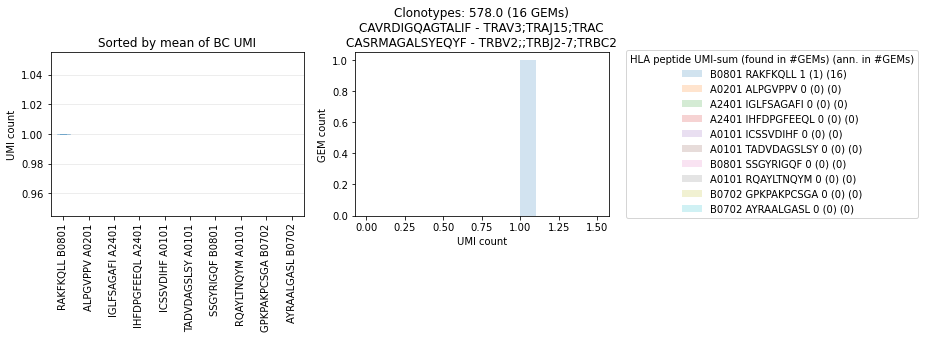

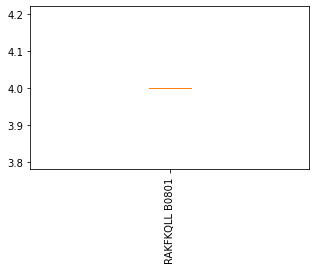

[678.]
('CASRVQFGVNTGELFF', 'CAASQNEKLTF') unresolved
       peptide                                        peptide_lst  \
156  VTEHDTLLY  ['SVDIHFDPGF' 'QAYLTNQY' 'NLVPMVATV' 'ATTADVDA...   
156  VTEHDTLLY  ['SVDIHFDPGF' 'QAYLTNQY' 'NLVPMVATV' 'ATTADVDA...   
156  VTEHDTLLY  ['SVDIHFDPGF' 'QAYLTNQY' 'NLVPMVATV' 'ATTADVDA...   
156  VTEHDTLLY  ['SVDIHFDPGF' 'QAYLTNQY' 'NLVPMVATV' 'ATTADVDA...   
156  VTEHDTLLY  ['SVDIHFDPGF' 'QAYLTNQY' 'NLVPMVATV' 'ATTADVDA...   
..         ...                                                ...   
156  VTEHDTLLY  ['SVDIHFDPGF' 'QAYLTNQY' 'NLVPMVATV' 'ATTADVDA...   
156  VTEHDTLLY  ['SVDIHFDPGF' 'QAYLTNQY' 'NLVPMVATV' 'ATTADVDA...   
156  VTEHDTLLY  ['SVDIHFDPGF' 'QAYLTNQY' 'NLVPMVATV' 'ATTADVDA...   
156  VTEHDTLLY  ['SVDIHFDPGF' 'QAYLTNQY' 'NLVPMVATV' 'ATTADVDA...   
156  VTEHDTLLY  ['SVDIHFDPGF' 'QAYLTNQY' 'NLVPMVATV' 'ATTADVDA...   

            umi_count_lst_mhc  cdr3_lst_TRA  \
156  [1, 1, 1, 2, 3, 13, 143]  CALWEYGNKLVF   
156  [1, 1, 1, 2, 3, 13

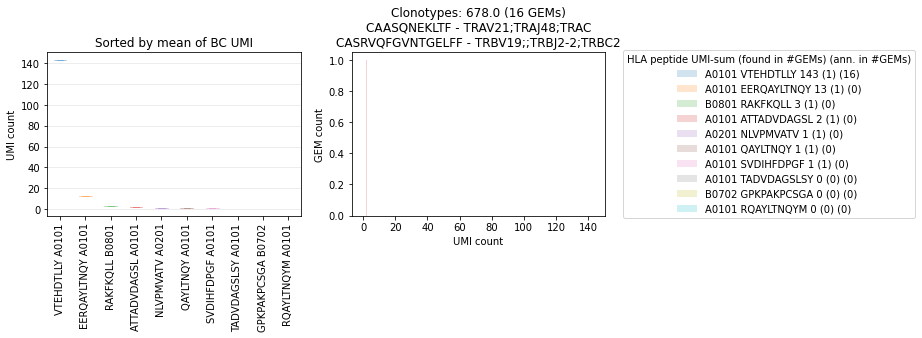

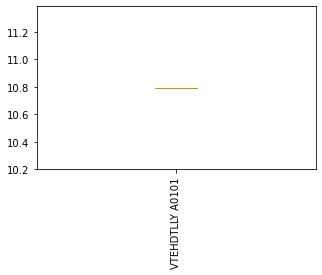

[619.]
('CASSDLNSPLHF', 'CAVTAPAYSGAGSYQLTF') unresolved
      peptide                                        peptide_lst  \
407  RAKFKQLL  ['LLFERPHTM' 'ATTADVDAGSL' 'RQAYLTNQY' 'HTGEKH...   
407  RAKFKQLL  ['LLFERPHTM' 'ATTADVDAGSL' 'RQAYLTNQY' 'HTGEKH...   
407  RAKFKQLL  ['LLFERPHTM' 'ATTADVDAGSL' 'RQAYLTNQY' 'HTGEKH...   
407  RAKFKQLL  ['LLFERPHTM' 'ATTADVDAGSL' 'RQAYLTNQY' 'HTGEKH...   
407  RAKFKQLL  ['LLFERPHTM' 'ATTADVDAGSL' 'RQAYLTNQY' 'HTGEKH...   
..        ...                                                ...   
407  RAKFKQLL  ['LLFERPHTM' 'ATTADVDAGSL' 'RQAYLTNQY' 'HTGEKH...   
407  RAKFKQLL  ['LLFERPHTM' 'ATTADVDAGSL' 'RQAYLTNQY' 'HTGEKH...   
407  RAKFKQLL  ['LLFERPHTM' 'ATTADVDAGSL' 'RQAYLTNQY' 'HTGEKH...   
407  RAKFKQLL  ['LLFERPHTM' 'ATTADVDAGSL' 'RQAYLTNQY' 'HTGEKH...   
407  RAKFKQLL  ['LLFERPHTM' 'ATTADVDAGSL' 'RQAYLTNQY' 'HTGEKH...   

                    umi_count_lst_mhc        cdr3_lst_TRA  \
407  [1, 1, 1, 1, 1, 2, 3, 4, 26, 91]     CIVRVGGDSWGKLQF   
407 

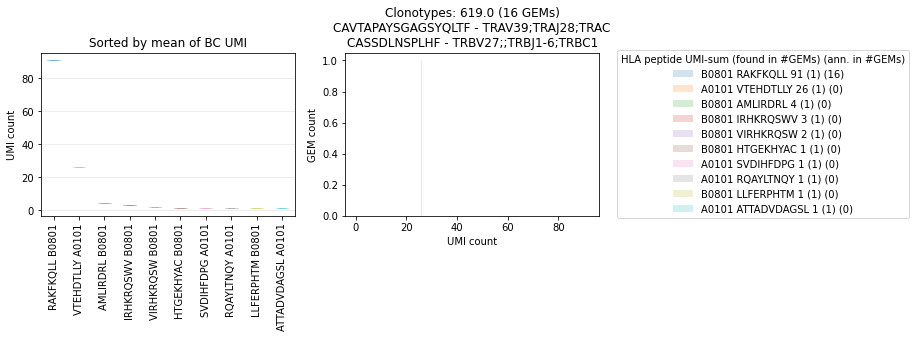

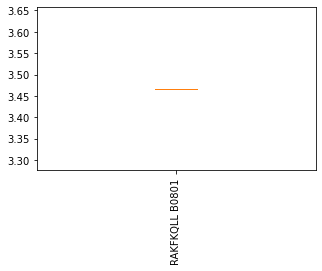

[705.]
('CASSLEASASPYEQYF', 'CAASQNEKLTF') unresolved
        peptide      peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
71  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAARGTASKLTF   
71  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAARGTASKLTF   
71  EERQAYLTNQY  ['EERQAYLTNQY']               [1]   CAASQNEKLTF   
71  EERQAYLTNQY  ['EERQAYLTNQY']               [1]   CAASQNEKLTF   
71  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAARGTASKLTF   
..          ...              ...               ...           ...   
71  EERQAYLTNQY  ['EERQAYLTNQY']               [1]   CAASQNEKLTF   
71  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAARGTASKLTF   
71  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAARGTASKLTF   
71  EERQAYLTNQY  ['EERQAYLTNQY']               [1]   CAASQNEKLTF   
71  EERQAYLTNQY  ['EERQAYLTNQY']               [1]   CAASQNEKLTF   

                                      genes_lst_TRA umi_count_lst_TRA  \
71  ['TRAV29/DV5;TRAJ44;TRAC' 'TRAV21;TRAJ48;TRAC']     

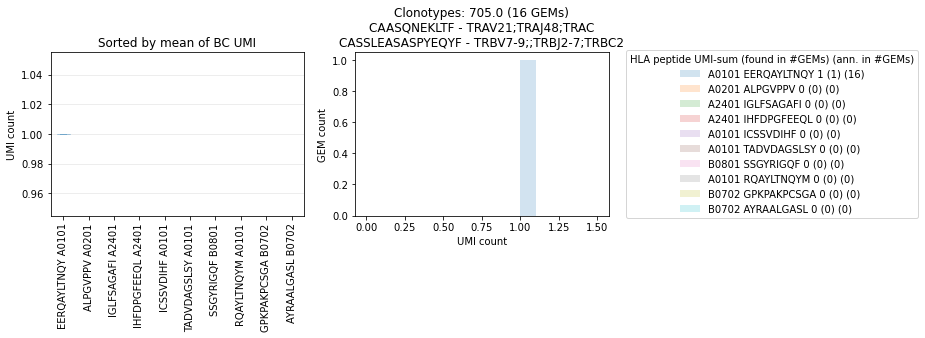

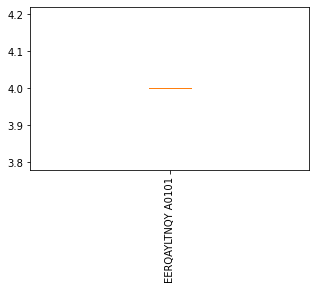

[20.]
[566.]
('CASSYRTVSSYEQYF', 'CAAFRAYNTDKLIF') unresolved
        peptide                           peptide_lst umi_count_lst_mhc  \
1149  VTEHDTLLY  ['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']        [1, 1, 63]   
1149  VTEHDTLLY  ['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']        [1, 1, 63]   
1149  VTEHDTLLY  ['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']        [1, 1, 63]   
1149  VTEHDTLLY  ['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']        [1, 1, 63]   
1149  VTEHDTLLY  ['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']        [1, 1, 63]   
...         ...                                   ...               ...   
1149  VTEHDTLLY  ['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']        [1, 1, 63]   
1149  VTEHDTLLY  ['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']        [1, 1, 63]   
1149  VTEHDTLLY  ['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']        [1, 1, 63]   
1149  VTEHDTLLY  ['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']        [1, 1, 63]   
1149  VTEHDTLLY  ['RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']        [1, 1, 63]   

           cdr3_lst_TRA              

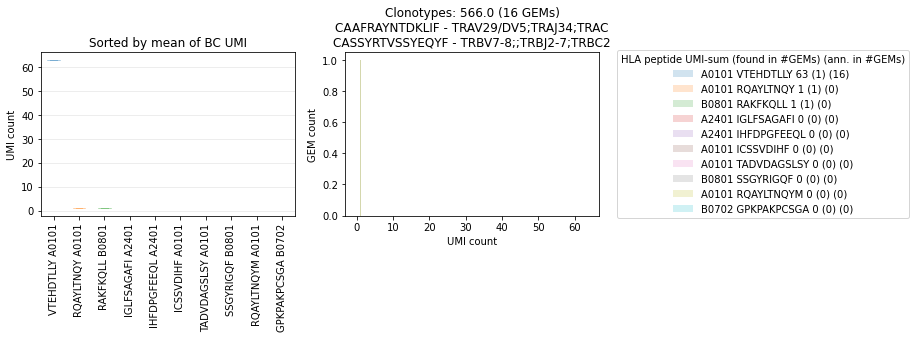

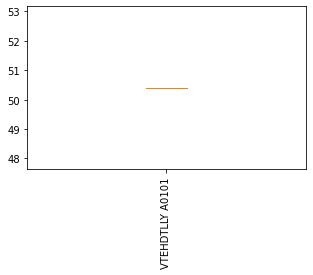

[704.]
('CASSYRTVSSYEQYF', 'CAASQNEKLTF') unresolved
       peptide    peptide_lst umi_count_lst_mhc       cdr3_lst_TRA  \
974  VTEHDTLLY  ['VTEHDTLLY']               [1]  CILRASYSGAGSYQLTF   
974  VTEHDTLLY  ['VTEHDTLLY']               [1]  CILRASYSGAGSYQLTF   
974  VTEHDTLLY  ['VTEHDTLLY']               [1]        CAASQNEKLTF   
974  VTEHDTLLY  ['VTEHDTLLY']               [1]        CAASQNEKLTF   
974  VTEHDTLLY  ['VTEHDTLLY']               [1]  CILRASYSGAGSYQLTF   
..         ...            ...               ...                ...   
974  VTEHDTLLY  ['VTEHDTLLY']               [1]        CAASQNEKLTF   
974  VTEHDTLLY  ['VTEHDTLLY']               [1]  CILRASYSGAGSYQLTF   
974  VTEHDTLLY  ['VTEHDTLLY']               [1]  CILRASYSGAGSYQLTF   
974  VTEHDTLLY  ['VTEHDTLLY']               [1]        CAASQNEKLTF   
974  VTEHDTLLY  ['VTEHDTLLY']               [1]        CAASQNEKLTF   

                                     genes_lst_TRA umi_count_lst_TRA  \
974  ['TRAV26-2;TRAJ28;TRAC' 'TRAV

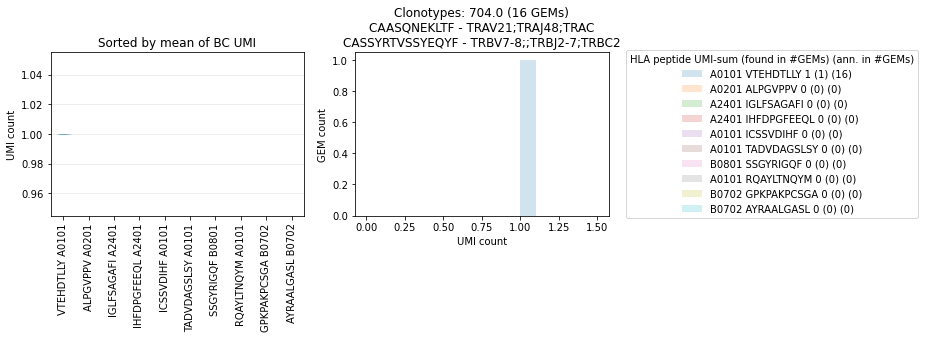

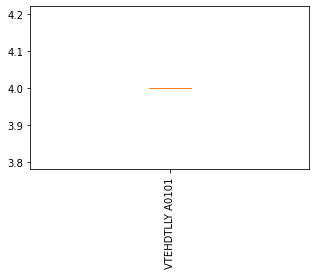

[585.]
('CASSYTPGSTYEQYF', 'CAARPNNARLMF') unresolved
        peptide                                        peptide_lst  \
1390  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFILY...   
1390  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFILY...   
1390  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFILY...   
1390  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFILY...   
1390  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFILY...   
...         ...                                                ...   
1390  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFILY...   
1390  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFILY...   
1390  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFILY...   
1390  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFILY...   
1390  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'FSAGAFILY...   

                     umi_count_lst_mhc        cdr3_lst_TRA  \
1390  [1, 1, 1, 1, 1, 2, 3, 4, 8, 198]  CAV

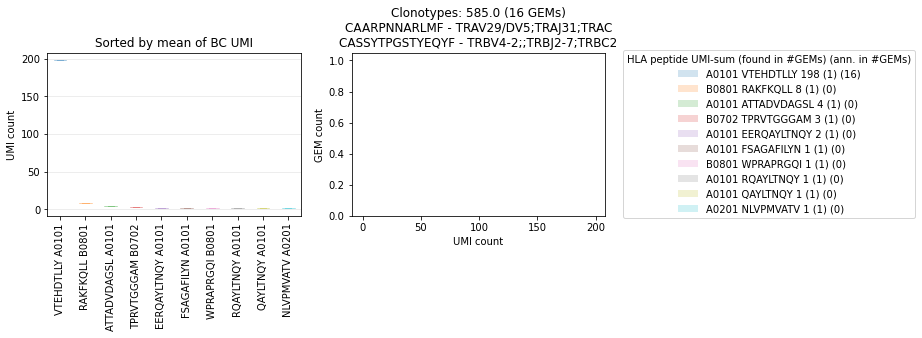

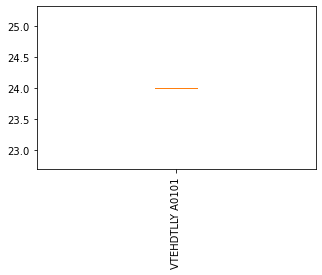

[25.]
[34.]
('CSVEVPGKVFRTEAFF', 'CAVETSGSRLTF') unresolved
          peptide                                        peptide_lst  \
259   TNQYMQRMASV                                    ['TNQYMQRMASV']   
259   TNQYMQRMASV                                    ['TNQYMQRMASV']   
259   TNQYMQRMASV                                    ['TNQYMQRMASV']   
259   TNQYMQRMASV                                    ['TNQYMQRMASV']   
726   ATTADVDAGSL                         ['QAYLTNQY' 'ATTADVDAGSL']   
878     VTEHDTLLY                                      ['VTEHDTLLY']   
984   EERQAYLTNQY                                    ['EERQAYLTNQY']   
984   EERQAYLTNQY                                    ['EERQAYLTNQY']   
984   EERQAYLTNQY                                    ['EERQAYLTNQY']   
984   EERQAYLTNQY                                    ['EERQAYLTNQY']   
984   EERQAYLTNQY                                    ['EERQAYLTNQY']   
984   EERQAYLTNQY                                    ['EERQAYLTNQY']   
984 

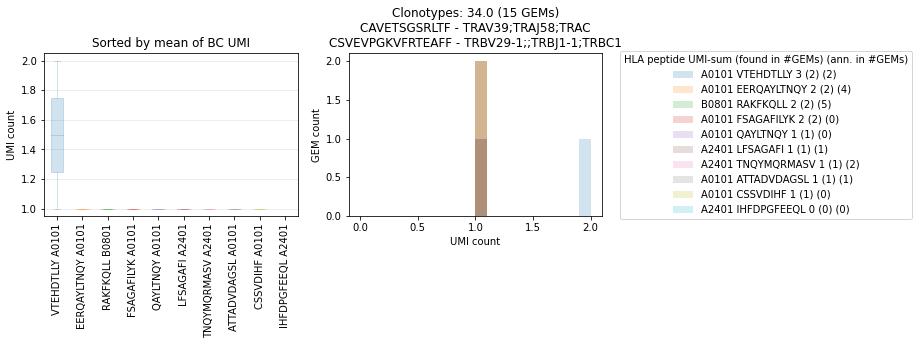

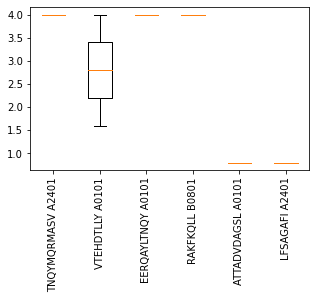

[8.]
('CASRIGAAGNSPLHF', 'NaN') unresolved
          peptide                  peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2078     RAKFKQLL     ['VIRHKRQSW' 'RAKFKQLL']           [1, 26]                
2116    VTEHDTLLY                ['VTEHDTLLY']               [1]                
2123    RRKVPAQRL                ['RRKVPAQRL']               [1]                
2166    SAGAFILYK  ['EERQAYLTNQY' 'SAGAFILYK']           [2, 14]                
2178    VTEHDTLLY    ['IRHKRQSWV' 'VTEHDTLLY']            [1, 1]                
2223    VTEHDTLLY                ['VTEHDTLLY']               [1]                
2265    VTEHDTLLY                ['VTEHDTLLY']               [1]                
2283    VTEHDTLLY                ['VTEHDTLLY']               [1]                
2363    VTEHDTLLY                ['VTEHDTLLY']               [1]                
2364     RAKFKQLL                 ['RAKFKQLL']               [1]                
2385  EERQAYLTNQY              ['EERQAYLTNQY']               [1]  

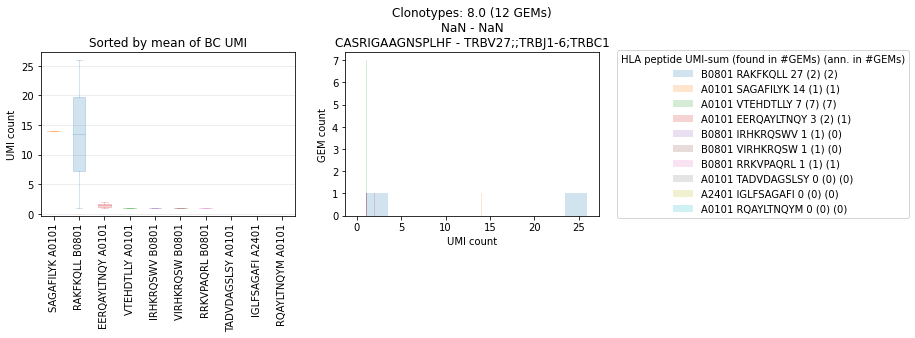

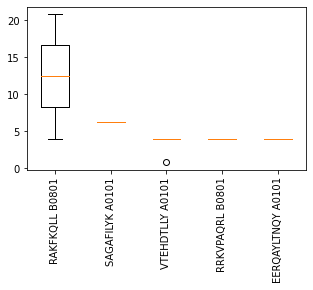

[32.]
[131.]
('CASSYTPGSTYEQYF', 'CAVNYGNKLVF') unresolved
        peptide                                        peptide_lst  \
1120  VTEHDTLLY  ['TNQYMQRMASV' 'TPRVTGGGAM' 'SVDIHFDPG' 'GMAEG...   
1120  VTEHDTLLY  ['TNQYMQRMASV' 'TPRVTGGGAM' 'SVDIHFDPG' 'GMAEG...   
1120  VTEHDTLLY  ['TNQYMQRMASV' 'TPRVTGGGAM' 'SVDIHFDPG' 'GMAEG...   
1120  VTEHDTLLY  ['TNQYMQRMASV' 'TPRVTGGGAM' 'SVDIHFDPG' 'GMAEG...   
1120  VTEHDTLLY  ['TNQYMQRMASV' 'TPRVTGGGAM' 'SVDIHFDPG' 'GMAEG...   
...         ...                                                ...   
1776  VTEHDTLLY  ['ATTADVDAGSL' 'FSAGAFILYK' 'RAKFKQLL' 'VTEHDT...   
1776  VTEHDTLLY  ['ATTADVDAGSL' 'FSAGAFILYK' 'RAKFKQLL' 'VTEHDT...   
1776  VTEHDTLLY  ['ATTADVDAGSL' 'FSAGAFILYK' 'RAKFKQLL' 'VTEHDT...   
1776  VTEHDTLLY  ['ATTADVDAGSL' 'FSAGAFILYK' 'RAKFKQLL' 'VTEHDT...   
1776  VTEHDTLLY  ['ATTADVDAGSL' 'FSAGAFILYK' 'RAKFKQLL' 'VTEHDT...   

                        umi_count_lst_mhc        cdr3_lst_TRA  \
1120  [1, 1, 1, 1, 1, 1, 1, 2, 5, 7

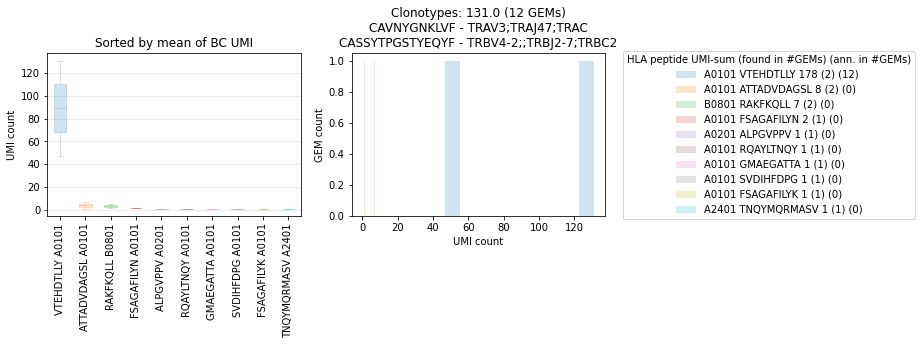

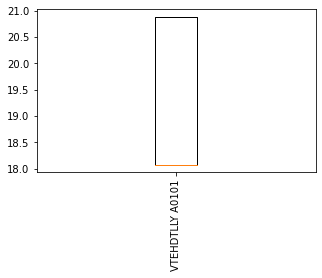

[21.]
('CAWPRSTGELFF', 'CAVADSWGKFQF') unresolved
          peptide                                        peptide_lst  \
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLTNQY                                    ['EERQAYLTNQY']   
131   EERQAYLT

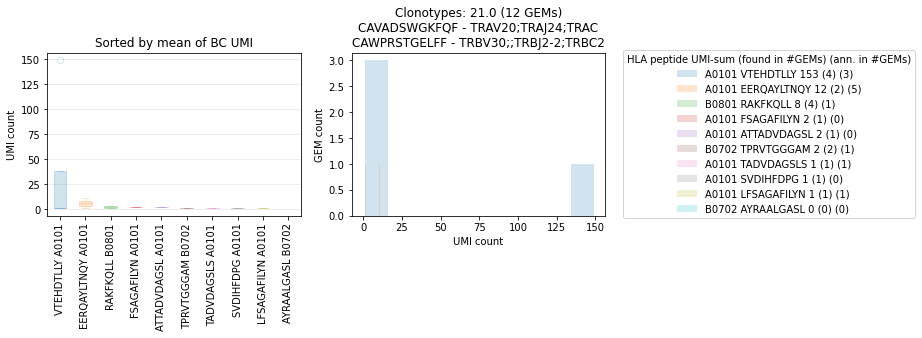

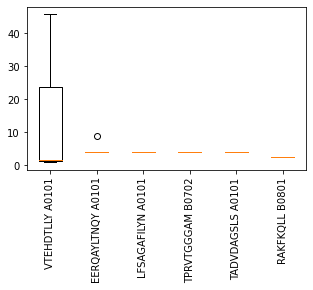

[35.]
('CASSLEFGSRPYEQYF', 'CAARPNNARLMF') unresolved
          peptide                                        peptide_lst  \
306     VTEHDTLLY  ['EERQAYLTNQY' 'FSAGAFILYN' 'SVDIHFDPG' 'TADVD...   
351     VTEHDTLLY  ['RAKFKQLL' 'SSGYRIGQF' 'TPRVTGGGAM' 'ATTADVDA...   
600   EERQAYLTNQY            ['RQAYLTNQY' 'VTEHDTLLY' 'EERQAYLTNQY']   
649    FSAGAFILYK  ['TADVDAGSLSY' 'LFSAGAFILYN' 'RAKFKQLL' 'VDIHF...   
956     VTEHDTLLY  ['RQAYLTNQY' 'ATTADVDAGSL' 'EERQAYLTNQY' 'IHFD...   
1105    VTEHDTLLY  ['QAYLTNQY' 'RQAYLTNQY' 'ATTADVDAGSL' 'RAKFKQL...   
1148    VTEHDTLLY  ['FSAGAFILYN' 'SVDIHFDPG' 'TPRVTGGGAM' 'SAGAFI...   
1243    VTEHDTLLY  ['DEYVHNTTA' 'EERQAYLTNQY' 'AMLIRDRL' 'CSSVDIH...   
1406    VTEHDTLLY  ['RQAYLTNQY' 'TNQYMQRMASV' 'RAKFKQLL' 'ATTADVD...   
1508    VTEHDTLLY  ['RAKFKQLL' 'RQAYLTNQY' 'ATTADVDAGSL' 'SVDIHFD...   
1576    VTEHDTLLY  ['TADVDAGSLS' 'QAYLTNQY' 'LFSAGAFILYN' 'LTNQYM...   

                                 umi_count_lst_mhc  cdr3_lst_TRA  \
306        [1

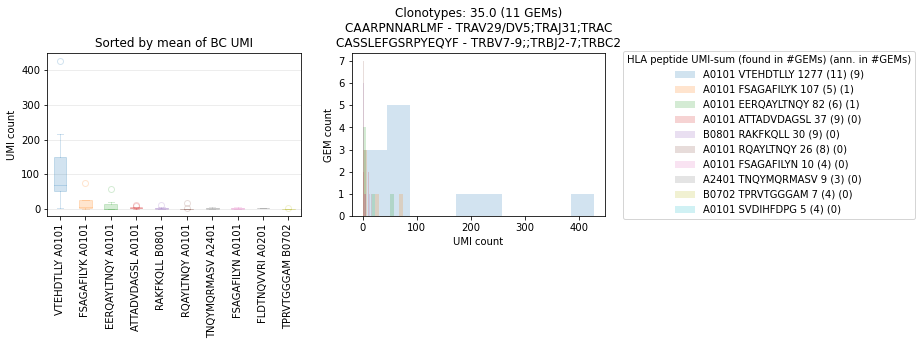

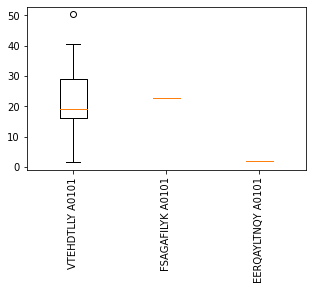

[59.]
('CASSLGGEPGELFF', 'CAAVQGAQKLVF') unresolved
          peptide                                        peptide_lst  \
217   EERQAYLTNQY                                    ['EERQAYLTNQY']   
217   EERQAYLTNQY                                    ['EERQAYLTNQY']   
217   EERQAYLTNQY                                    ['EERQAYLTNQY']   
217   EERQAYLTNQY                                    ['EERQAYLTNQY']   
217   EERQAYLTNQY                                    ['EERQAYLTNQY']   
...           ...                                                ...   
217   EERQAYLTNQY                                    ['EERQAYLTNQY']   
217   EERQAYLTNQY                                    ['EERQAYLTNQY']   
511   EERQAYLTNQY                        ['VTEHDTLLY' 'EERQAYLTNQY']   
971     VTEHDTLLY                          ['NLVPMVATV' 'VTEHDTLLY']   
1740    GPFPGNLVD  ['VTEHDTLLY' 'TPRVTGGGAM' 'RAKFKQLL' 'GPFPGNLVD']   

     umi_count_lst_mhc  cdr3_lst_TRA  \
217                [1]   CAASQNEKLTF   
217

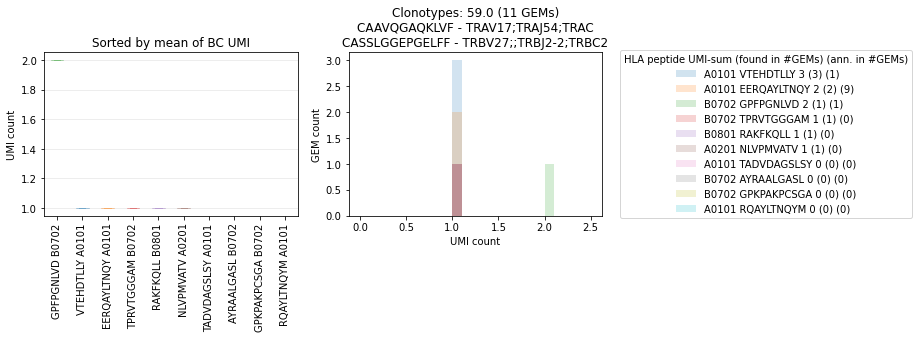

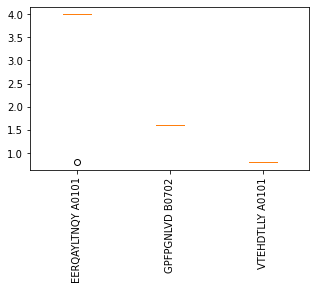

[28.]
[31.]
('CASSMDFQETQYF', 'CAMREGDYKLSF') unresolved
          peptide                                        peptide_lst  \
477     RTMFWGPEV                                      ['RTMFWGPEV']   
499     VTEHDTLLY                                      ['VTEHDTLLY']   
829   EERQAYLTNQY  ['RAKFKQLL' 'VTEHDTLLY' 'SVDIHFDPGF' 'EERQAYLT...   
958      RAKFKQLL                           ['VTEHDTLLY' 'RAKFKQLL']   
968    GPFPGNLVDV  ['VTEHDTLLY' 'SAGAFILYK' 'WPRAPRGQ' 'RQSWVNATL...   
1263    VTEHDTLLY                                      ['VTEHDTLLY']   
1900     RAKFKQLL                          ['TPRVTGGGAM' 'RAKFKQLL']   
1900     RAKFKQLL                          ['TPRVTGGGAM' 'RAKFKQLL']   
1900     RAKFKQLL                          ['TPRVTGGGAM' 'RAKFKQLL']   
1900     RAKFKQLL                          ['TPRVTGGGAM' 'RAKFKQLL']   
1900     RAKFKQLL                          ['TPRVTGGGAM' 'RAKFKQLL']   
1900     RAKFKQLL                          ['TPRVTGGGAM' 'RAKFKQLL']   
1900   

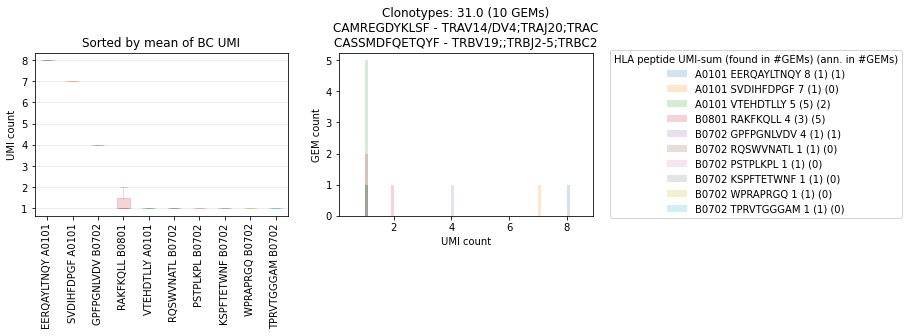

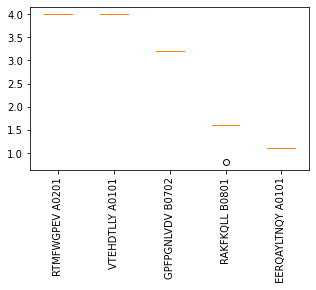

[702.]
('CASSLGAEYYEQYF', 'CAASQNEKLTF') unresolved
        peptide     peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
500  FSAGAFILYK  ['FSAGAFILYK']               [1]  CAGGGNYGQNFVF   
500  FSAGAFILYK  ['FSAGAFILYK']               [1]  CAGGGNYGQNFVF   
500  FSAGAFILYK  ['FSAGAFILYK']               [1]  CAGGGNYGQNFVF   
500  FSAGAFILYK  ['FSAGAFILYK']               [1]  CAVGSGGYQKVTF   
500  FSAGAFILYK  ['FSAGAFILYK']               [1]  CAVGSGGYQKVTF   
..          ...             ...               ...            ...   
500  FSAGAFILYK  ['FSAGAFILYK']               [1]  CAVGSGGYQKVTF   
500  FSAGAFILYK  ['FSAGAFILYK']               [1]  CAVGSGGYQKVTF   
500  FSAGAFILYK  ['FSAGAFILYK']               [1]    CAASQNEKLTF   
500  FSAGAFILYK  ['FSAGAFILYK']               [1]    CAASQNEKLTF   
500  FSAGAFILYK  ['FSAGAFILYK']               [1]    CAASQNEKLTF   

                                         genes_lst_TRA umi_count_lst_TRA  \
500  ['TRAV27;TRAJ26;TRAC' 'TRAV25;TRAJ13;TRAC' 'TR... 

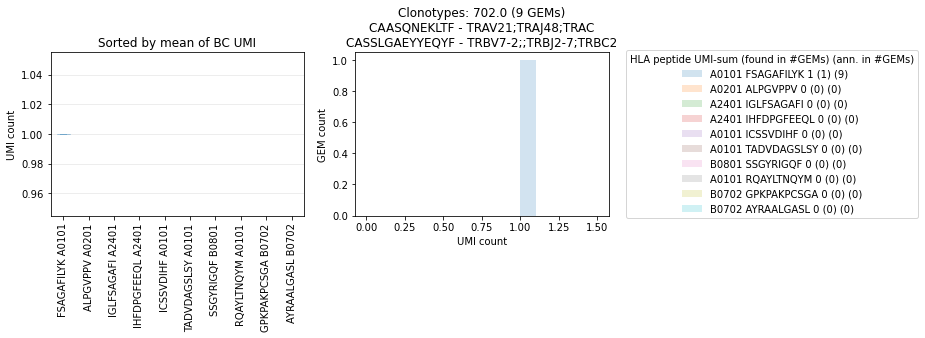

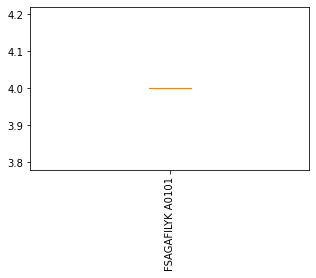

[103.]
('CASSVGQGSSYEQYF', 'CAVYLIQGAQKLVF') unresolved
       peptide                                        peptide_lst  \
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAYLTNQY' 'AALPGVP...   
184  VTEHDTLLY  ['SVDIHFDPG' 'IHFDPGFEEQ' 'RQAY

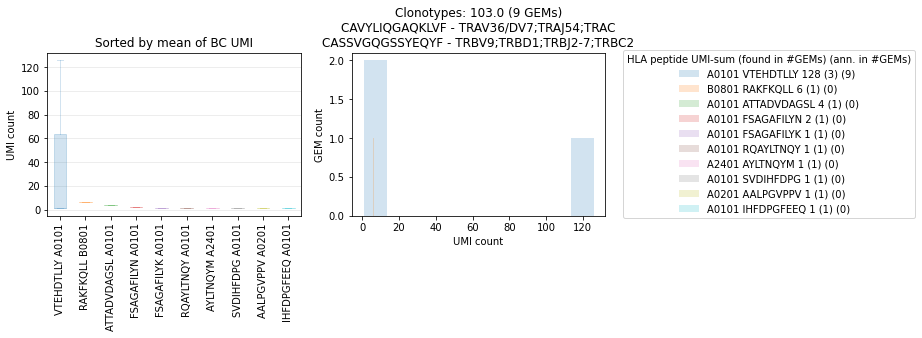

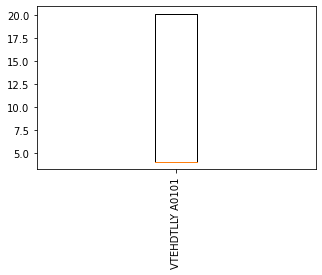

[12.]
('NaN', 'CALRDMEYGNKLVF') unresolved
         peptide                                        peptide_lst  \
135     RAKFKQLL  ['AMLIRDRL' 'VIRHKRQSW' 'LLFERPHTM' 'EERQAYLTN...   
329   FSAGAFILYK                                     ['FSAGAFILYK']   
396     RAKFKQLL    ['LLFERPHTM' 'HTGEKHYAC' 'AMLIRDRL' 'RAKFKQLL']   
816     RAKFKQLL                                       ['RAKFKQLL']   
1076    RAKFKQLL                                       ['RAKFKQLL']   
1213    RAKFKQLL  ['LLFERPHTM' 'IRHKRQSW' 'AMLIRDRL' 'IRHKRQSWV'...   
1222    RAKFKQLL  ['TPRVTGGGAM' 'LLFERPHTM' 'FSAGAFILYK' 'HTGEKH...   
1785    RAKFKQLL  ['FSAGAFILYK' 'IRHKRQSWV' 'EERQAYLTNQY' 'TPRVT...   
1862   VTEHDTLLY  ['FSAGAFILYN' 'TPRVTGGGAM' 'FSAGAFILYK' 'GMAEG...   

                 umi_count_lst_mhc    cdr3_lst_TRA           genes_lst_TRA  \
135         [1, 1, 1, 1, 2, 5, 55]  CALRDMEYGNKLVF  ['TRAV16;TRAJ47;TRAC']   
329                            [1]  CALRDMEYGNKLVF  ['TRAV16;TRAJ47;TRAC']   
396         

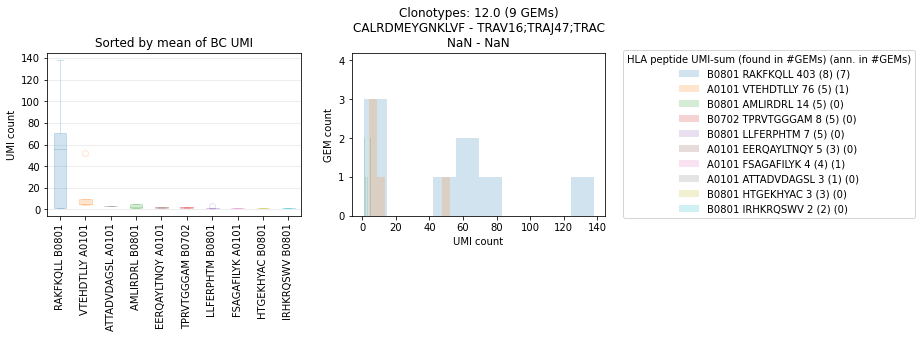

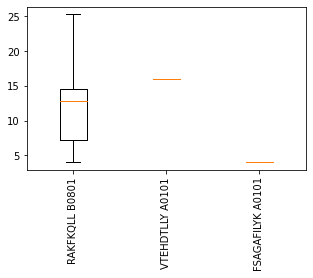

[15.]
('NaN', 'CAVNYGNKLVF') unresolved
          peptide                            peptide_lst umi_count_lst_mhc  \
213      RAKFKQLL                           ['RAKFKQLL']               [1]   
255      IRHKRQSW                           ['IRHKRQSW']               [1]   
611   EERQAYLTNQY                        ['EERQAYLTNQY']               [1]   
688     VTEHDTLLY                          ['VTEHDTLLY']               [1]   
757      RAKFKQLL                           ['RAKFKQLL']               [1]   
1050    VTEHDTLLY                          ['VTEHDTLLY']               [1]   
1057    VTEHDTLLY  ['RAKFKQLL' 'FSAGAFILYK' 'VTEHDTLLY']         [1, 1, 2]   
1473   TPRVTGGGAM                         ['TPRVTGGGAM']               [1]   
1479    VTEHDTLLY                          ['VTEHDTLLY']               [1]   

     cdr3_lst_TRA          genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB  \
213   CAVNYGNKLVF  ['TRAV3;TRAJ47;TRAC']                 2                
255   CAVNYGNKLVF  ['TRAV3;TR

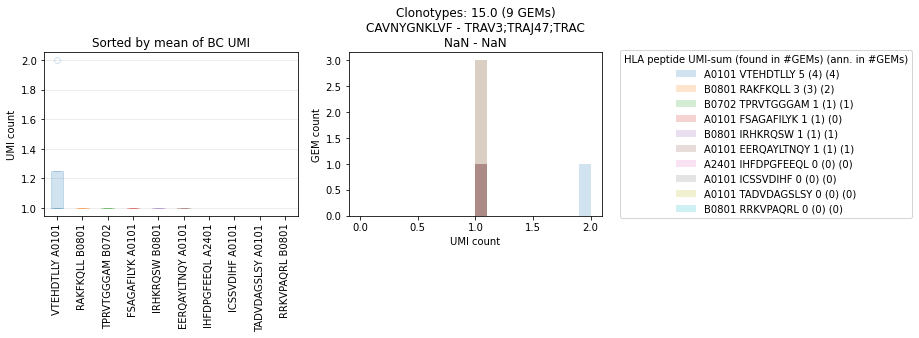

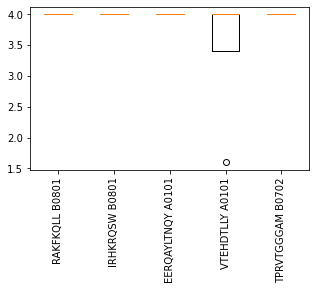

[74.]
('CASSLEFGSRPYEQYF', 'NaN') unresolved
          peptide                                        peptide_lst  \
2192    VTEHDTLLY  ['IHFDPGFEEQ' 'SVDIHFDPG' 'EERQAYLTNQY' 'RAKFK...   
2193    VTEHDTLLY  ['FSAGAFILYK' 'TTADVDAG' 'TADVDAGSLS' 'GMAEGAT...   
2216    VTEHDTLLY  ['EERQAYLTNQY' 'GMAEGATTA' 'TNQYMQRMASV' 'RQAY...   
2216    VTEHDTLLY  ['EERQAYLTNQY' 'GMAEGATTA' 'TNQYMQRMASV' 'RQAY...   
2216    VTEHDTLLY  ['EERQAYLTNQY' 'GMAEGATTA' 'TNQYMQRMASV' 'RQAY...   
2216    VTEHDTLLY  ['EERQAYLTNQY' 'GMAEGATTA' 'TNQYMQRMASV' 'RQAY...   
2216    VTEHDTLLY  ['EERQAYLTNQY' 'GMAEGATTA' 'TNQYMQRMASV' 'RQAY...   
2216    VTEHDTLLY  ['EERQAYLTNQY' 'GMAEGATTA' 'TNQYMQRMASV' 'RQAY...   
2216    VTEHDTLLY  ['EERQAYLTNQY' 'GMAEGATTA' 'TNQYMQRMASV' 'RQAY...   
2216    VTEHDTLLY  ['EERQAYLTNQY' 'GMAEGATTA' 'TNQYMQRMASV' 'RQAY...   
2216    VTEHDTLLY  ['EERQAYLTNQY' 'GMAEGATTA' 'TNQYMQRMASV' 'RQAY...   
2216    VTEHDTLLY  ['EERQAYLTNQY' 'GMAEGATTA' 'TNQYMQRMASV' 'RQAY...   
2216    VTEHDTLLY  

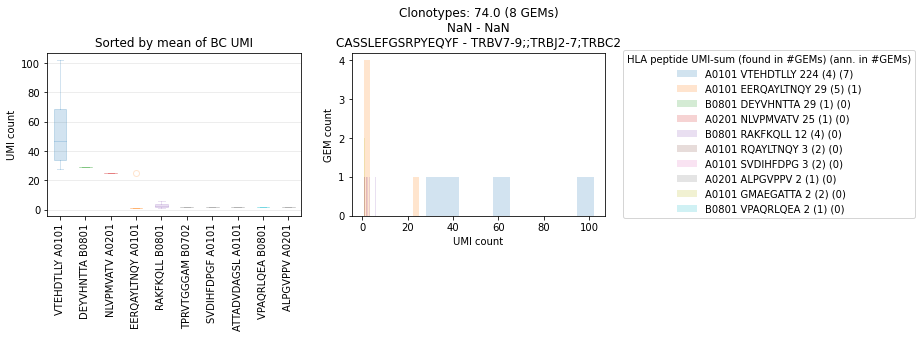

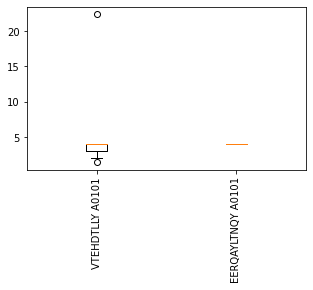

[582.]
('CASSLIVSGGANEQFF', 'CAAFRAYNTDKLIF') unresolved
       peptide                                        peptide_lst  \
1429  RAKFKQLL  ['TPRVTGGGAM' 'YLFHKEPTW' 'FSAGAFILYK' 'MDMFSD...   
1429  RAKFKQLL  ['TPRVTGGGAM' 'YLFHKEPTW' 'FSAGAFILYK' 'MDMFSD...   
1429  RAKFKQLL  ['TPRVTGGGAM' 'YLFHKEPTW' 'FSAGAFILYK' 'MDMFSD...   
1429  RAKFKQLL  ['TPRVTGGGAM' 'YLFHKEPTW' 'FSAGAFILYK' 'MDMFSD...   
1429  RAKFKQLL  ['TPRVTGGGAM' 'YLFHKEPTW' 'FSAGAFILYK' 'MDMFSD...   
...        ...                                                ...   
1429  RAKFKQLL  ['TPRVTGGGAM' 'YLFHKEPTW' 'FSAGAFILYK' 'MDMFSD...   
1429  RAKFKQLL  ['TPRVTGGGAM' 'YLFHKEPTW' 'FSAGAFILYK' 'MDMFSD...   
1429  RAKFKQLL  ['TPRVTGGGAM' 'YLFHKEPTW' 'FSAGAFILYK' 'MDMFSD...   
1429  RAKFKQLL  ['TPRVTGGGAM' 'YLFHKEPTW' 'FSAGAFILYK' 'MDMFSD...   
1429  RAKFKQLL  ['TPRVTGGGAM' 'YLFHKEPTW' 'FSAGAFILYK' 'MDMFSD...   

                                      umi_count_lst_mhc    cdr3_lst_TRA  \
1429  [1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 3,

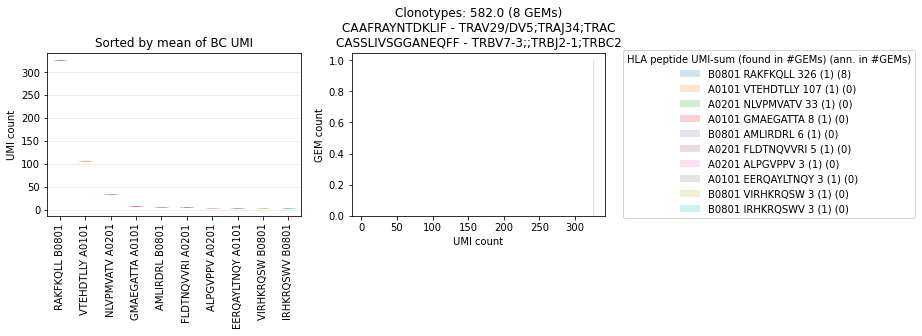

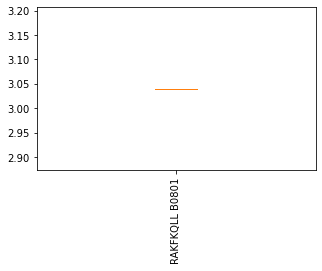

[87.]
('CASSLVAGAPSEQYF', 'CALRDMEYGNKLVF') unresolved
        peptide               peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1287  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]     CAVNYGNKLVF   
1287  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]     CAVNYGNKLVF   
1287  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]  CALRDMEYGNKLVF   
1287  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]  CALRDMEYGNKLVF   
1287  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]     CAVNYGNKLVF   
...         ...                       ...               ...             ...   
1287  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]  CALRDMEYGNKLVF   
1287  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]     CAVNYGNKLVF   
1287  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]     CAVNYGNKLVF   
1287  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]  CALRDMEYGNKLVF   
1287  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]  CALRDMEYGNKLVF 

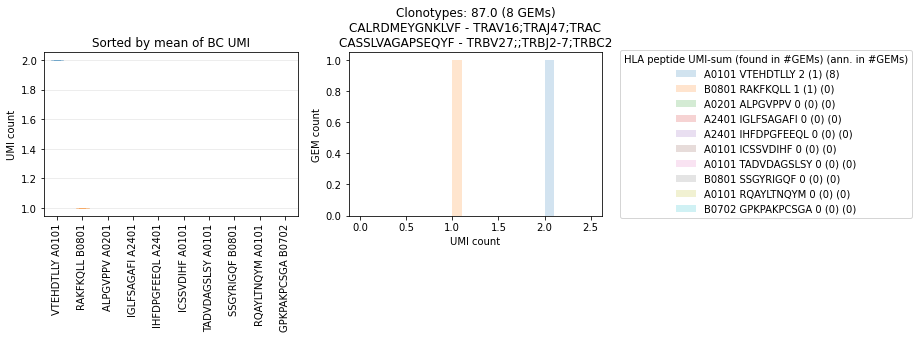

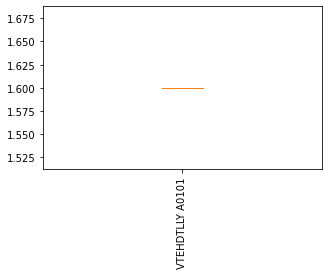

[30.]
[54.]
[36.]
('CASSFRRGQSSYEQYF', 'NaN') unresolved
          peptide                                        peptide_lst  \
2176    VTEHDTLLY  ['TNQYMQRMASV' 'FSAGAFILYN' 'TPRVTGGGAM' 'RAKF...   
2233    ILKEPVHGV                                      ['ILKEPVHGV']   
2296    VTEHDTLLY  ['GLFSAGAFIL' 'CSSVDIHF' 'EERQAYLTNQY' 'RAKFKQ...   
2299     RAKFKQLL                           ['VTEHDTLLY' 'RAKFKQLL']   
2375  EERQAYLTNQY                                    ['EERQAYLTNQY']   
2402  EERQAYLTNQY             ['VTEHDTLLY' 'RAKFKQLL' 'EERQAYLTNQY']   
2404    VTEHDTLLY  ['RQAYLTNQY' 'GMAEGATTA' 'FSAGAFILYN' 'EERQAYL...   

                        umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2176                  [1, 1, 1, 1, 2, 53]                        NaN   
2233                                  [1]                        NaN   
2296           [1, 1, 1, 3, 5, 8, 13, 14]                        NaN   
2299                               [1, 2]                        NaN   
2375  

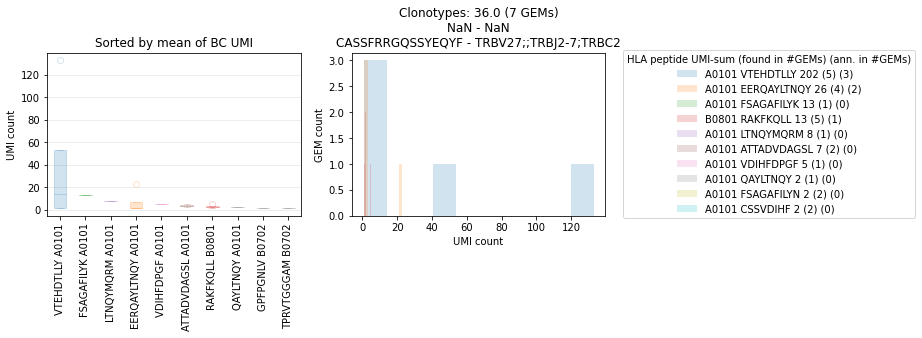

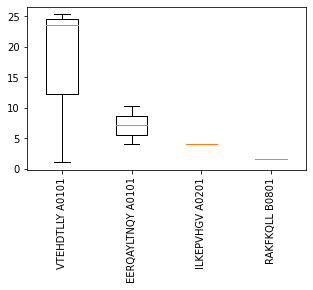

[41.]
('CASSLIGQGLGDEQFF', 'CATVSRMDSSYKLIF') unresolved
         peptide                                        peptide_lst  \
174     RAKFKQLL                                       ['RAKFKQLL']   
501   TPRVTGGGAM  ['FSAGAFILYK' 'GLFSAGAF' 'VTEHDTLLY' 'KPLFQNDF...   
1286   VTEHDTLLY                                      ['VTEHDTLLY']   
1653  TPRVTGGGAM                                     ['TPRVTGGGAM']   
1941  TPRVTGGGAM  ['VPEGPFPGNLV' 'NLVPMVATV' 'AMLIRDRL' 'VTFLDTN...   
1969  TPRVTGGGAM                          ['RAKFKQLL' 'TPRVTGGGAM']   
1995  TPRVTGGGAM    ['KPLFQNDF' 'RAKFKQLL' 'GPFPGNLV' 'TPRVTGGGAM']   

                    umi_count_lst_mhc     cdr3_lst_TRA  \
174                               [1]  CATVSRMDSSYKLIF   
501            [1, 1, 1, 1, 3, 5, 82]  CATVSRMDSSYKLIF   
1286                              [1]  CATVSRMDSSYKLIF   
1653                              [1]  CATVSRMDSSYKLIF   
1941  [1, 1, 1, 1, 1, 1, 1, 1, 4, 34]  CATVSRMDSSYKLIF   
1969                      

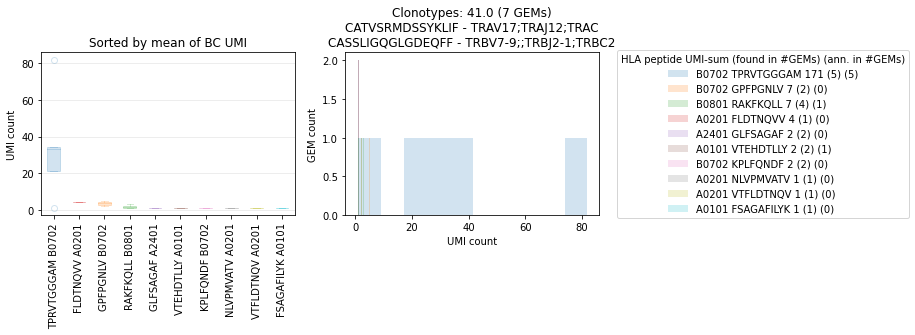

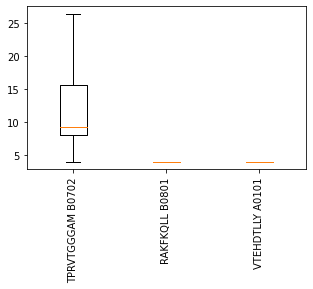

[56.]
('CASSSVNEQFF', 'CAVRDTDARLMF') unresolved
          peptide      peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1127     RAKFKQLL     ['RAKFKQLL']               [1]  CAVRDTDARLMF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CALQVGYSTLTF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CALQVGYSTLTF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CAVRDTDARLMF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CAVRDTDARLMF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CALQVGYSTLTF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CALQVGYSTLTF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CAVRDTDARLMF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CAVRDTDARLMF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CALQVGYSTLTF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CALQVGYSTLTF   
1877    VTEHDTLLY    ['VTEHDTLLY']               [2]  CAVRDTDARLMF   
1877    VTEHDTLLY    ['VTEHDTLLY']       

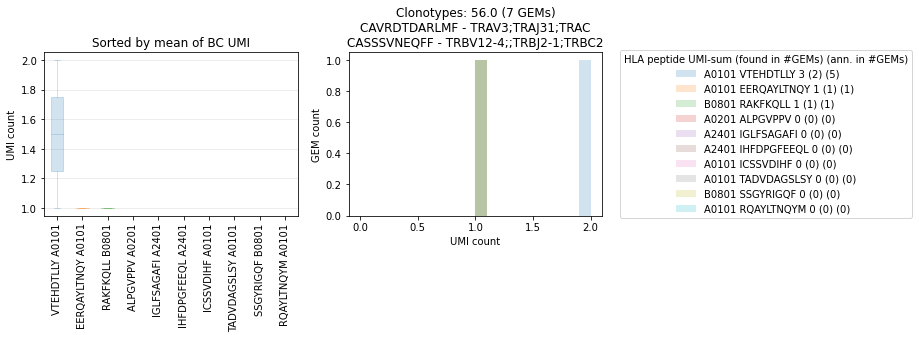

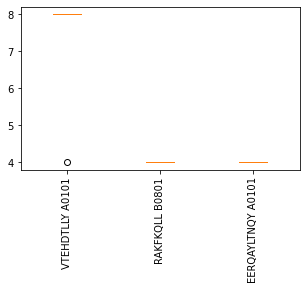

[48.]
[674.]
('CASSLIVSGGANEQFF', 'CAVEDRLDNDMRF') unresolved
       peptide              peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL' 'RAKFKQLL']           [3, 47]  CAVEDRLDNDMRF   
2068  RAKFKQLL  ['AMLIRDRL

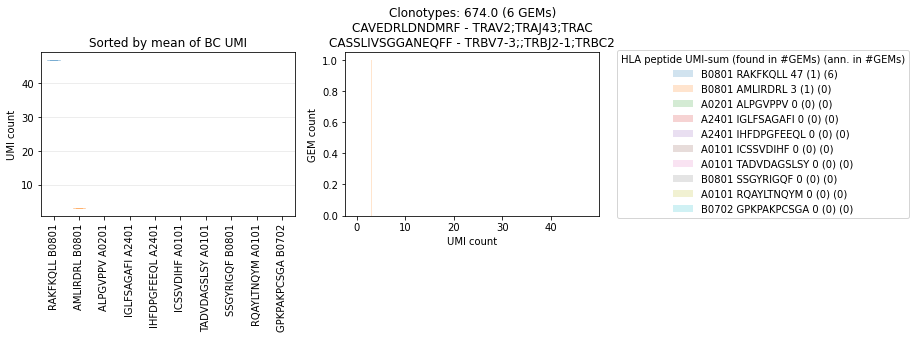

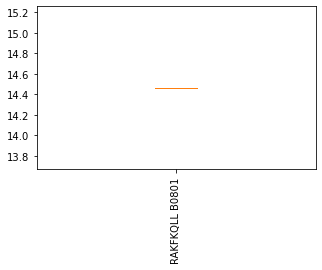

[42.]
('CASSYRTVSSYEQYF', 'CAVRPAPPCGANSKLTF') unresolved
         peptide                                        peptide_lst  \
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL                                       ['RAKFKQLL']   
280     RAKFKQLL   

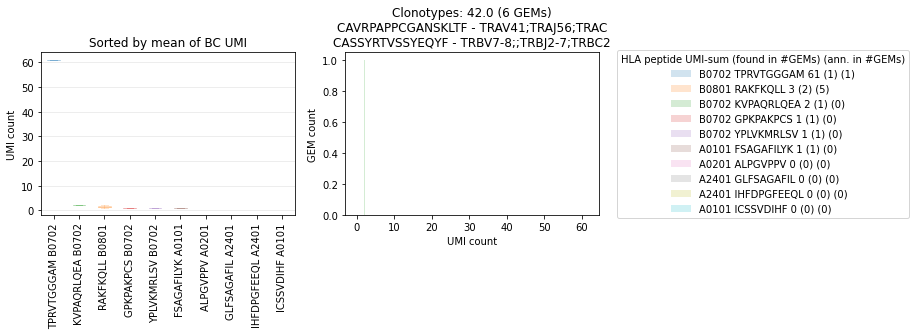

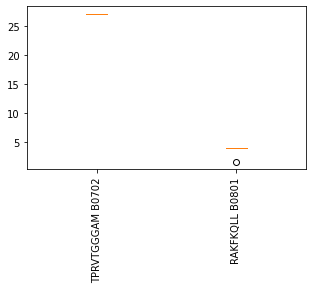

[79.]
('CASSYRTVSSYEQYF', 'CILRASYSGAGSYQLTF') unresolved
         peptide     peptide_lst umi_count_lst_mhc       cdr3_lst_TRA  \
368     RAKFKQLL    ['RAKFKQLL']               [1]  CILRASYSGAGSYQLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CAVRPAPPCGANSKLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CAVRPAPPCGANSKLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CILRASYSGAGSYQLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CILRASYSGAGSYQLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CAVRPAPPCGANSKLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CAVRPAPPCGANSKLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CILRASYSGAGSYQLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CILRASYSGAGSYQLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CAVRPAPPCGANSKLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CAVRPAPPCGANSKLTF   
1632   VTEHDTLLY   ['VTEHDTLLY']               [1]  CILRASYSGAGSYQ

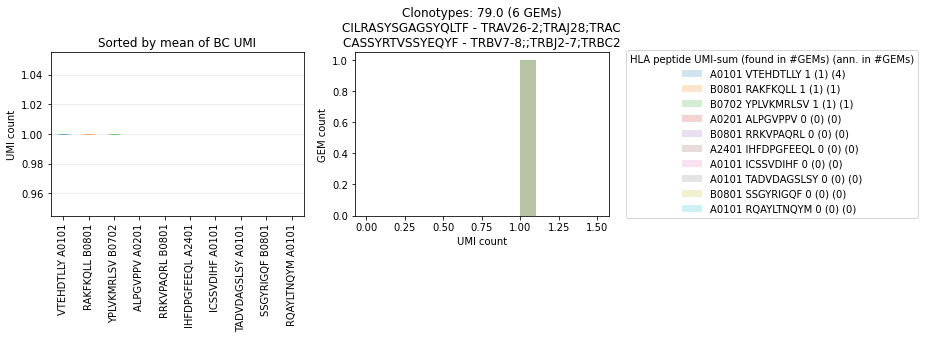

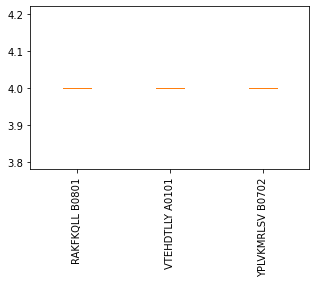

[168.]
('CAGGQGFSEAFF', 'CAAISGGYNKLIF') unresolved
         peptide     peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
797    VTEHDTLLY   ['VTEHDTLLY']               [1]    CAAISGGYNKLIF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CALSRASGGSYIPTF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CALSRASGGSYIPTF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]    CAAISGGYNKLIF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]    CAAISGGYNKLIF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CALSRASGGSYIPTF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CALSRASGGSYIPTF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]    CAAISGGYNKLIF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]    CAAISGGYNKLIF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CALSRASGGSYIPTF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CALSRASGGSYIPTF   
1014  TPRVTGGGAM  ['TPRVTGGGAM']               [1]    CAAISGGYNKLIF   
1014  TPRVTGGGAM  ['TPRVT

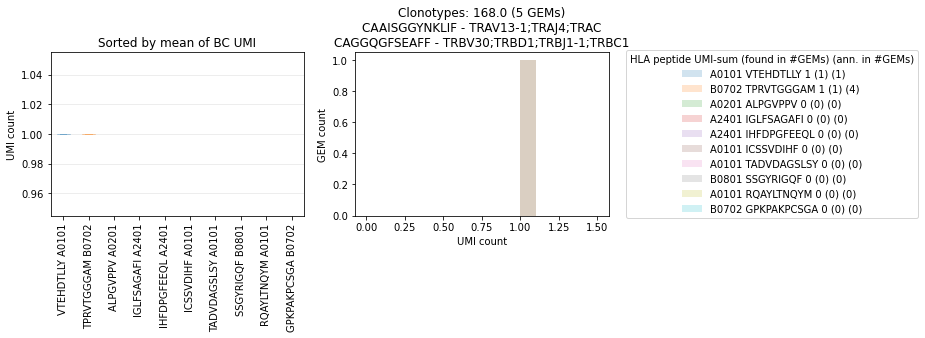

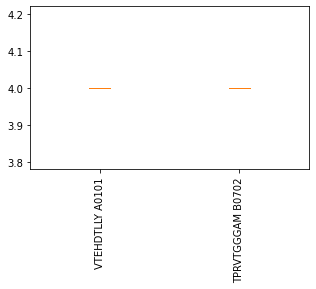

[72.]
('CASSSLNTEAFF', 'CALSGSRNQFYF') unresolved
       peptide                                        peptide_lst  \
1183  RAKFKQLL    ['VTEHDTLLY' 'WPRAPRGQI' 'AMLIRDRL' 'RAKFKQLL']   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSWV' 'VIRHK...   
1704  RAKFKQLL  ['EERQAYLTNQY' 'TPRVTGGGAM' 'IRHKRQSW

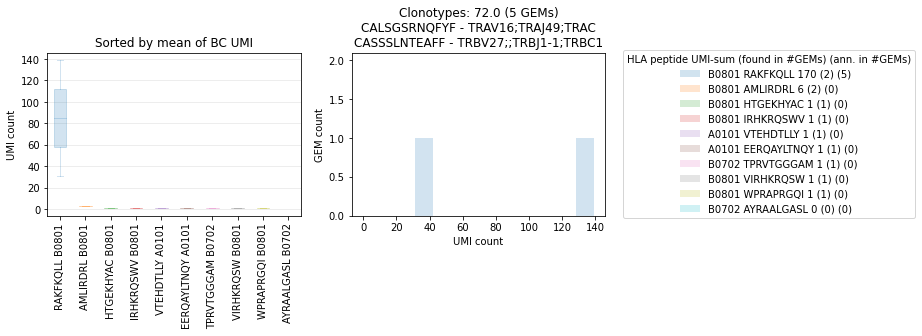

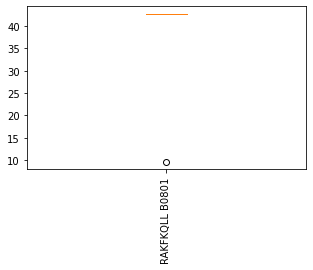

[65.]
('NaN', 'CAAENQGGKLIF') unresolved
        peptide                                        peptide_lst  \
134   VTEHDTLLY  ['RQAYLTNQY' 'FLDTNQVV' 'LFSAGAFIL' 'NLVPMVATV...   
134   VTEHDTLLY  ['RQAYLTNQY' 'FLDTNQVV' 'LFSAGAFIL' 'NLVPMVATV...   
134   VTEHDTLLY  ['RQAYLTNQY' 'FLDTNQVV' 'LFSAGAFIL' 'NLVPMVATV...   
134   VTEHDTLLY  ['RQAYLTNQY' 'FLDTNQVV' 'LFSAGAFIL' 'NLVPMVATV...   
1605  VTEHDTLLY                           ['RAKFKQLL' 'VTEHDTLLY']   
1605  VTEHDTLLY                           ['RAKFKQLL' 'VTEHDTLLY']   
1605  VTEHDTLLY                           ['RAKFKQLL' 'VTEHDTLLY']   
1605  VTEHDTLLY                           ['RAKFKQLL' 'VTEHDTLLY']   
1879  VTEHDTLLY              ['RAKFKQLL' 'TADVDAGSLS' 'VTEHDTLLY']   

                  umi_count_lst_mhc     cdr3_lst_TRA  \
134   [1, 1, 1, 1, 2, 3, 3, 53, 62]  CAASRYAGNNRKLIW   
134   [1, 1, 1, 1, 2, 3, 3, 53, 62]     CAAENQGGKLIF   
134   [1, 1, 1, 1, 2, 3, 3, 53, 62]  CAASRYAGNNRKLIW   
134   [1, 1, 1, 1, 2, 3, 3, 53, 62

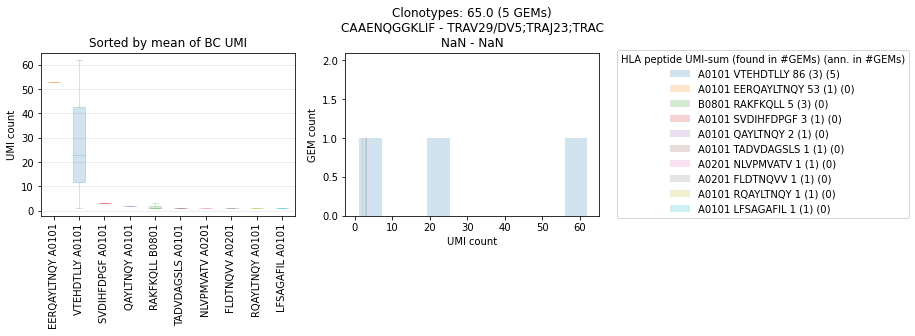

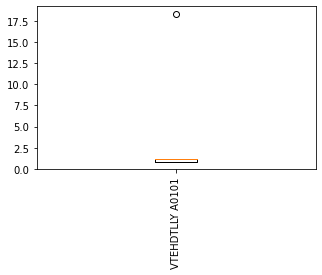

[130.]
('CAGGQGFSEAFF', 'CALSRASGGSYIPTF') unresolved
        peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]    CAAISGGYNKLIF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]    CAAISGGYNKLIF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]  CALSRASGGSYIPTF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]  CALSRASGGSYIPTF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]    CAAISGGYNKLIF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]    CAAISGGYNKLIF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]  CALSRASGGSYIPTF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]  CALSRASGGSYIPTF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]    CAAISGGYNKLIF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]    CAAISGGYNKLIF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]  CALSRASGGSYIPTF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3]  CALSRASGGSYIPTF   
1880  VTEHDTLLY  ['VTEHDTLLY']               [3] 

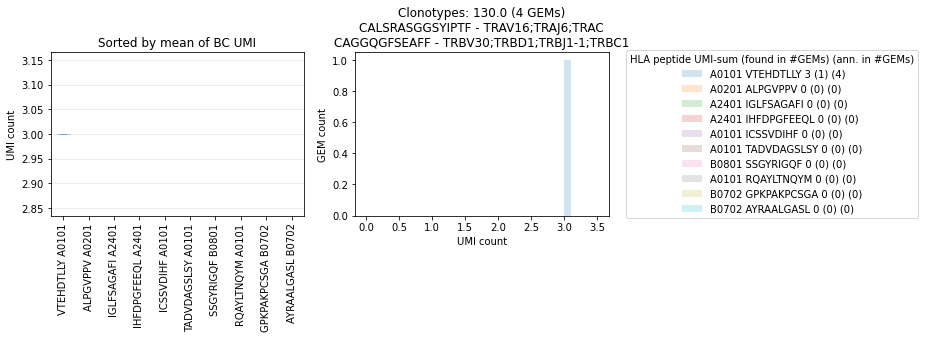

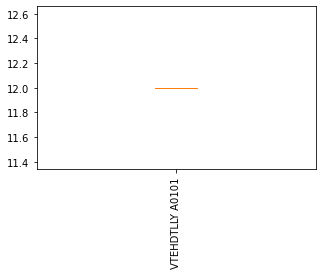

[27.]
('CAMAGTGSTDTQYF', 'NaN') unresolved
       peptide                                        peptide_lst  \
2191  RAKFKQLL  ['MDMFSDEQLKV' 'AMLIRDRL' 'TPRVTGGGAM' 'LLFERP...   
2271  RAKFKQLL  ['MDMFSDEQLKV' 'IRHKRQSWV' 'GLFSAGAF' 'NLVPMVA...   
2336  RAKFKQLL                ['AMLIRDRL' 'VTEHDTLLY' 'RAKFKQLL']   
2347  RAKFKQLL                                       ['RAKFKQLL']   

                     umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2191         [1, 1, 1, 1, 1, 1, 6, 65]                        NaN   
2271  [1, 1, 1, 1, 1, 2, 2, 3, 6, 115]                        NaN   
2336                        [1, 5, 70]                        NaN   
2347                               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB                     genes_lst_TRB  \
2191               NaN  CAMAGTGSTDTQYF  ['TRBV10-3;TRBD1;TRBJ2-3;TRBC2']   
2271               NaN  CAMAGTGSTDTQYF  ['TRBV10-3;TRBD1;TRBJ2-3;TRBC2']   
2336               NaN  CAMAGTGSTDTQY

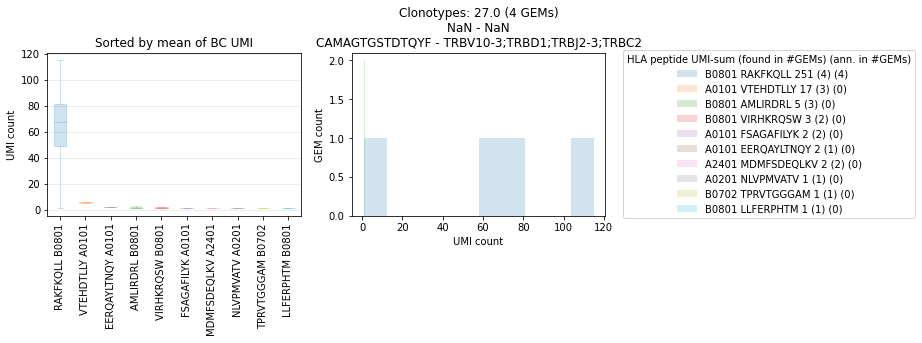

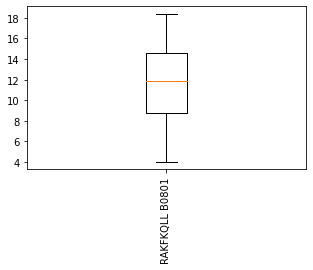

[485.]
('CASKQAGTEAFF', 'CAMRGDFGNEKLTF') unresolved
       peptide               peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]     CAASQNEKLTF   
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]     CAASQNEKLTF   
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]  CAMRGDFGNEKLTF   
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]  CAMRGDFGNEKLTF   
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]     CAASQNEKLTF   
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]     CAASQNEKLTF   
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]  CAMRGDFGNEKLTF   
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]  CAMRGDFGNEKLTF   
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]     CAASQNEKLTF   
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]     CAASQNEKLTF   
542  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]  CAMRGDFGNEKLTF   
542  VTEHDT

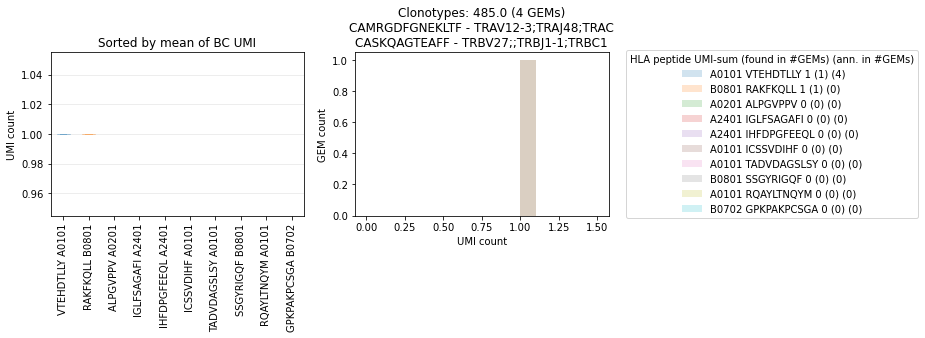

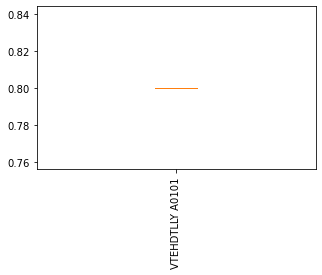

[629.]
('CASRPRYRSYNEQFF', 'CAVNYGNKLVF') unresolved
       peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAGLAGNQFYF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAGLAGNQFYF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAVNYGNKLVF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAVNYGNKLVF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAGLAGNQFYF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAGLAGNQFYF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAVNYGNKLVF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAVNYGNKLVF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAGLAGNQFYF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAGLAGNQFYF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAVNYGNKLVF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAVNYGNKLVF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CAGLAGNQFYF   
938  GMAEGATTA  ['GMAEGATTA']               [1]  CA

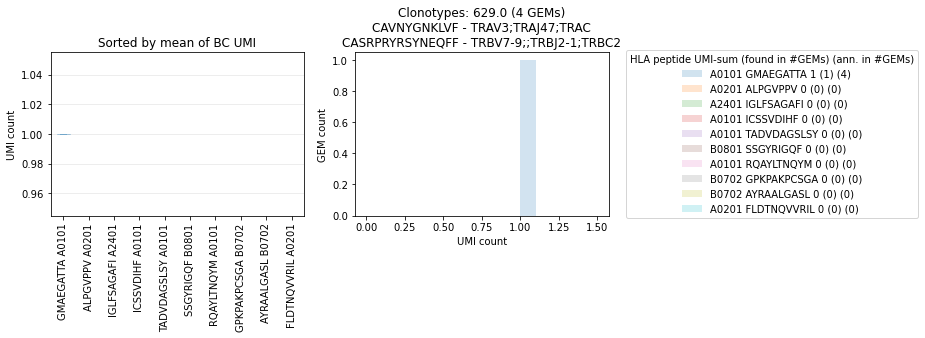

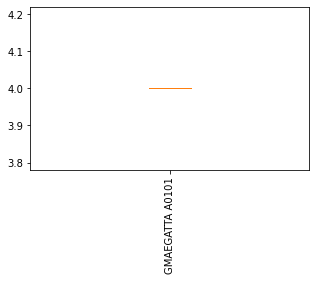

[568.]
('CASRVQFGVNTGELFF', 'CAASRYAGNNRKLIW') unresolved
       peptide                                        peptide_lst  \
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVDIHFDPG' 'RQAYLTNQ...   
276  VTEHDTLLY  ['FSAGAFILYN' 'ALPGVPPV' 'SVD

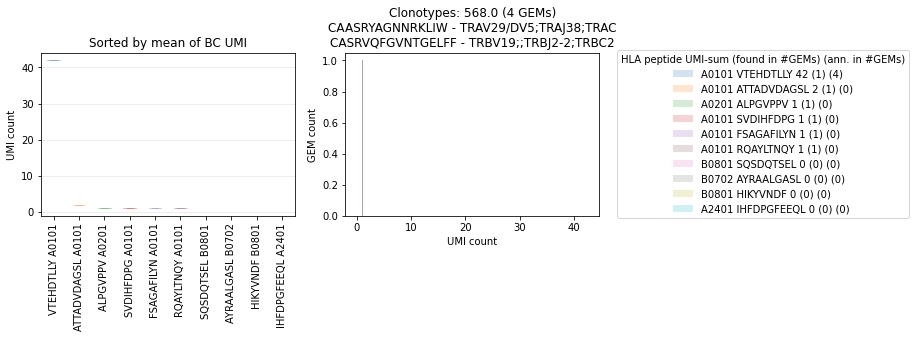

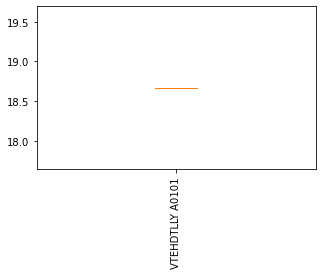

[624.]
('CASRVQFGVNTGELFF', 'CAVNYGNKLVF') unresolved
        peptide                                        peptide_lst  \
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPVHGV' 'SVDIHFDPG' 'LTNQYMQRM...   
1352  VTEHDTLLY  ['CSSVDIHF' 'ILKEPV

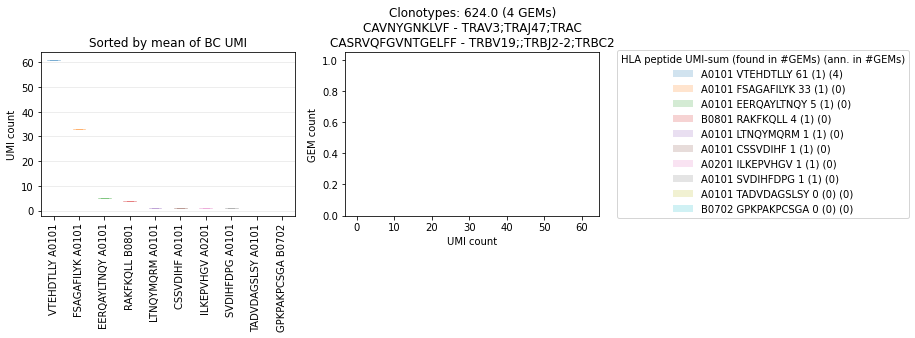

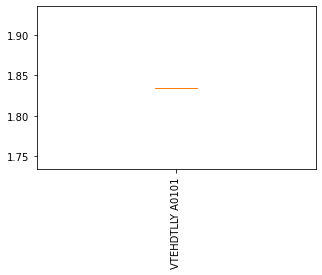

[203.]
('CASSEREGDSNQPQHF', 'CAVRTGNTGGFKTIF') resolved by trash bin
      peptide   peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
227  WPRAPRGQ  ['WPRAPRGQ']               [1]     CAVKDSNYQLIW   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]     CAVKDSNYQLIW   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]  CAVRTGNTGGFKTIF   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]  CAVRTGNTGGFKTIF   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]     CAVKDSNYQLIW   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]     CAVKDSNYQLIW   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]  CAVRTGNTGGFKTIF   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]  CAVRTGNTGGFKTIF   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]     CAVKDSNYQLIW   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]     CAVKDSNYQLIW   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]  CAVRTGNTGGFKTIF   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]  CAVRTGNTGGFKTIF   
227  WPRAPRGQ  ['WPRAPRGQ']               [1]     CAVKDSNYQLIW   
227  WP

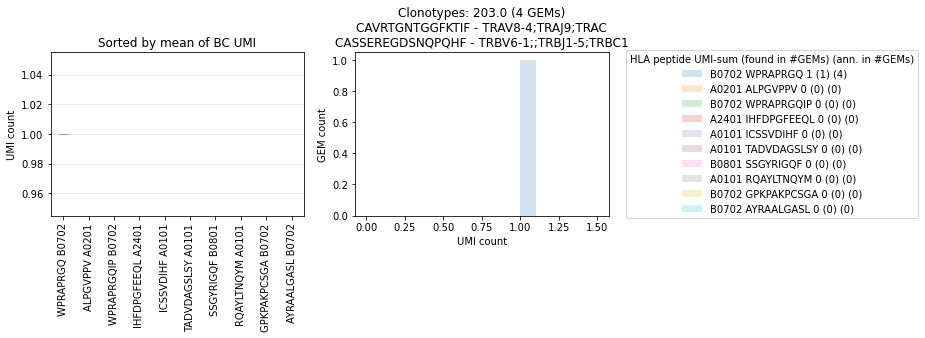

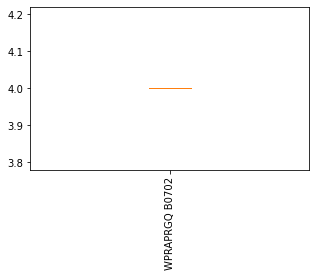

[656.]
('CASSEWGGRGGGYEQYF', 'CAASQNEKLTF') unresolved
       peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
463  VTEHDTLLY  ['VTEHDTLLY']               [1]   CAHGNNRLAF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]   CAHGNNRLAF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAASQNEKLTF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAASQNEKLTF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]   CAHGNNRLAF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]   CAHGNNRLAF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAASQNEKLTF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAASQNEKLTF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]   CAHGNNRLAF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]   CAHGNNRLAF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAASQNEKLTF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAASQNEKLTF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]   CAHGNNRLAF   
463  VTEHDTLLY  ['VTEHDTLLY']               [1]  

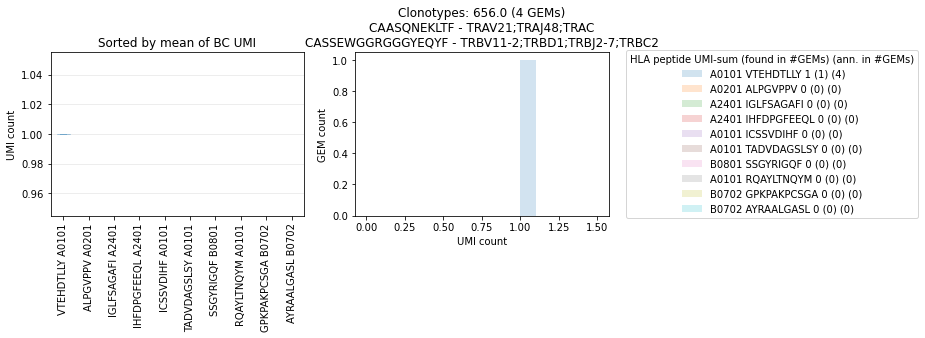

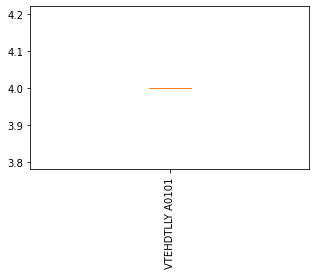

[477.]
('CASSEWGGRGGGYEQYF', 'CALRDMEYGNKLVF') unresolved
       peptide                                        peptide_lst  \
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'AMLIRDRL' 'CSSVDIH...   
1106  RAKFKQLL  ['MDMFSDEQLKV' 'NLVPMVATV' 'A

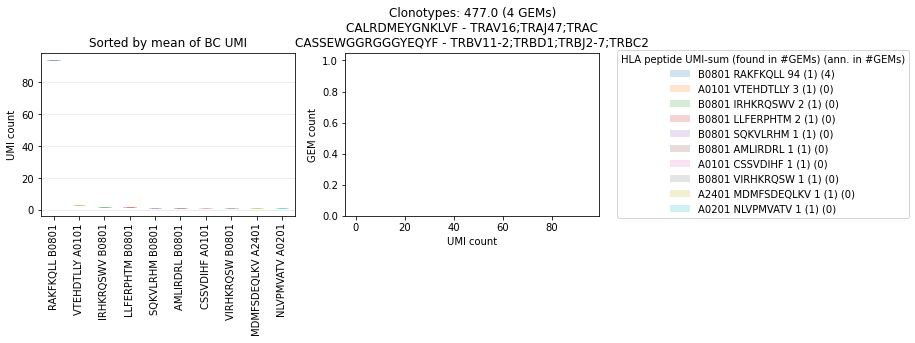

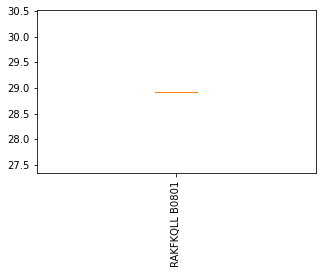

[712.]
('CASSFRRGQSSYEQYF', 'CAFIGAGSYQLTF') unresolved
       peptide                                        peptide_lst  \
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAGAFILYK' 'GMAEGA...   
907  VTEHDTLLY  ['TNQYMQRMASV' 'QAYLTNQY' 'FSAG

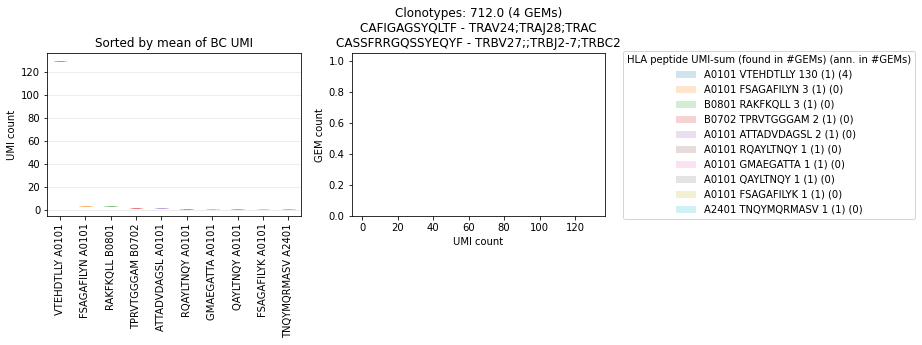

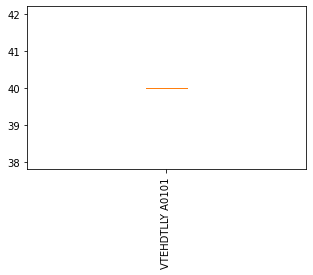

[43.]
('CASSGRDRFTDTQYF', 'CAMREGYTGGFKTIF') unresolved
          peptide      peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
98       RAKFKQLL     ['RAKFKQLL']               [1]  CAMREGYTGGFKTIF   
632      RAKFKQLL     ['RAKFKQLL']               [1]  CAMREGYTGGFKTIF   
1313    VTEHDTLLY    ['VTEHDTLLY']               [1]  CAMREGYTGGFKTIF   
1647  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAMREGYTGGFKTIF   

                  genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
98    ['TRAV14/DV4;TRAJ9;TRAC']                 4  CASSGRDRFTDTQYF   
632   ['TRAV14/DV4;TRAJ9;TRAC']                 4  CASSGRDRFTDTQYF   
1313  ['TRAV14/DV4;TRAJ9;TRAC']                 3  CASSGRDRFTDTQYF   
1647  ['TRAV14/DV4;TRAJ9;TRAC']                 5  CASSGRDRFTDTQYF   

                  genes_lst_TRB umi_count_lst_TRB  
98    ['TRBV19;;TRBJ2-3;TRBC2']                 7  
632   ['TRBV19;;TRBJ2-3;TRBC2']                 3  
1313  ['TRBV19;;TRBJ2-3;TRBC2']                 7  
1647  ['TRBV19;;TRB

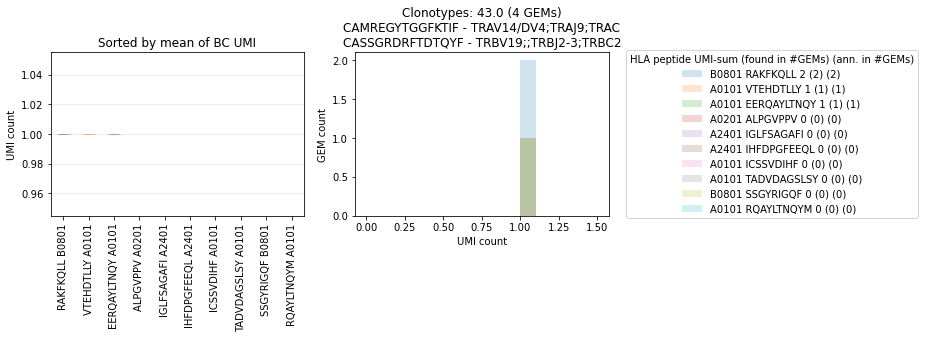

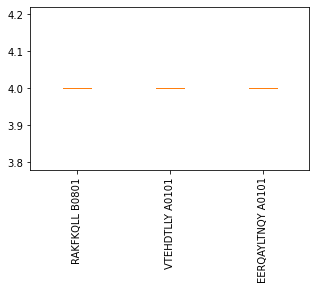

[425.]
('CASSITGTGGVGNTIYF', 'CAMREGGYNTDKLIF') unresolved
        peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]    CAASKGSNYQLIW   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]    CAASKGSNYQLIW   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAMREGGYNTDKLIF   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAMREGGYNTDKLIF   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]    CAASKGSNYQLIW   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]    CAASKGSNYQLIW   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAMREGGYNTDKLIF   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAMREGGYNTDKLIF   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]    CAASKGSNYQLIW   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]    CAASKGSNYQLIW   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAMREGGYNTDKLIF   
1794  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAMREGGYNTDKLIF   
1794  VTEHDTLLY  ['VTEHDTLLY']              

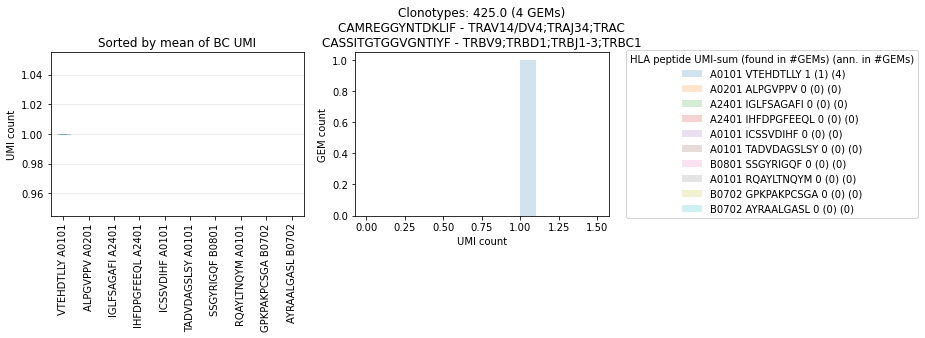

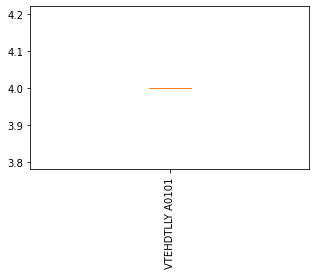

[47.]
('CASSLATGRTYGYTF', 'NaN') unresolved
          peptide                                        peptide_lst  \
2108    VTEHDTLLY                                      ['VTEHDTLLY']   
2255    VTEHDTLLY                                      ['VTEHDTLLY']   
2270    VTEHDTLLY  ['SVDIHFDPG' 'QAYLTNQY' 'EERQAYLTNQY' 'VTEHDTL...   
2302  EERQAYLTNQY  ['FSAGAFILYK' 'SAGAFILYK' 'VTEHDTLLY' 'RAKFKQL...   

     umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2108              [18]                        NaN               NaN   
2255               [1]                        NaN               NaN   
2270     [1, 1, 1, 32]                        NaN               NaN   
2302  [1, 1, 1, 2, 22]                        NaN               NaN   

         cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
2108  CASSLATGRTYGYTF  ['TRBV7-8;;TRBJ1-2;TRBC1']                 9  
2255  CASSLATGRTYGYTF  ['TRBV7-8;;TRBJ1-2;TRBC1']                 3  
2270  CASSLATGRTYGYTF  ['TRBV

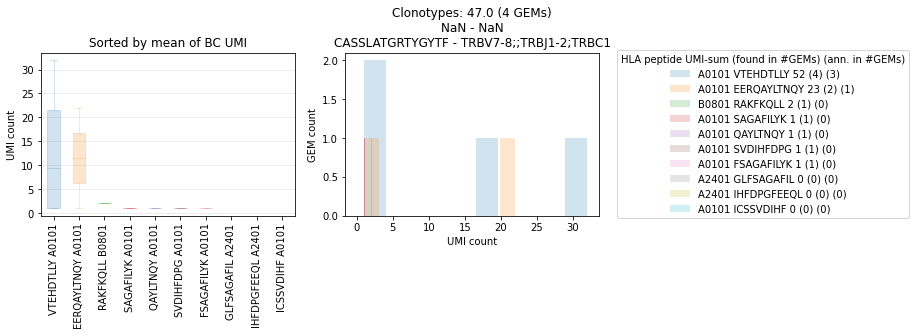

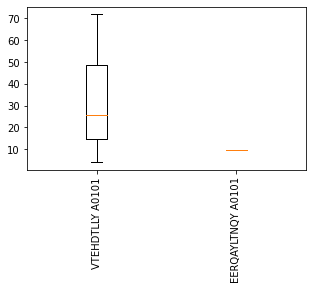

[630.]
('CASSLEAGQKPYEQYF', 'CAVNYGNKLVF') unresolved
        peptide                                        peptide_lst  \
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIHFDPGF' 'TADVDAGSLS' 'GLFSAG...   
1187  VTEHDTLLY  ['TPRVTGGGAM' 'VDIH

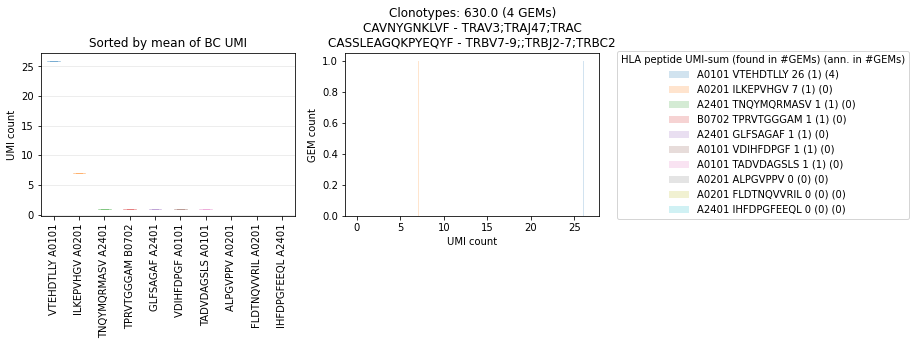

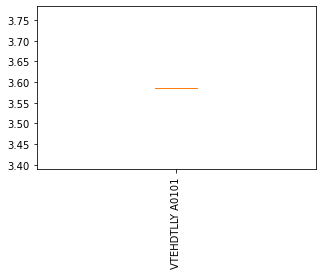

[690.]
('CASSLEAGQKPYEQYF', 'CIVRVGGDSWGKLQF') unresolved
        peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   
2053  VTEHDTLLY  ['VTEHDTLLY']               

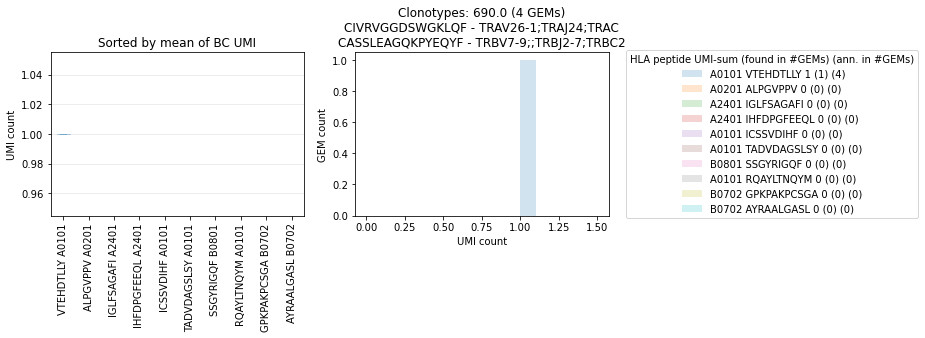

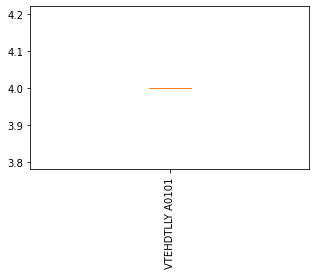

[19.]
('CASSLEAGQKPYEQYF', 'NaN') unresolved
          peptide                                        peptide_lst  \
2154  EERQAYLTNQY  ['CSSVDIHF' 'FSAGAFILYK' 'NLVPMVATV' 'SAGAFILY...   
2179    VTEHDTLLY  ['RAKFKQLL' 'TNQYMQRMASV' 'RQAYLTNQY' 'ATTADVD...   
2279    VTEHDTLLY  ['AYLTNQYM' 'RAKFKQLL' 'FSAGAFILYN' 'GPFPGNLVD...   
2400    VTEHDTLLY  ['SVDIHFDPG' 'FSAGAFILYN' 'ATTADVDAGSL' 'VTEHD...   

                      umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2154                [1, 1, 1, 1, 2, 46]                        NaN   
2179                   [1, 1, 2, 3, 43]                        NaN   
2279  [1, 1, 1, 1, 1, 2, 3, 15, 21, 65]                        NaN   
2400                      [1, 1, 1, 49]                        NaN   

     umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
2154               NaN  CASSLEAGQKPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']   
2179               NaN  CASSLEAGQKPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']   
2279               NaN  CAS

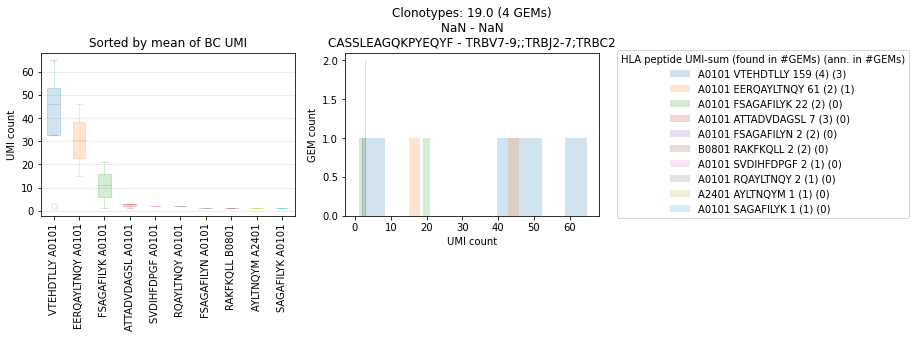

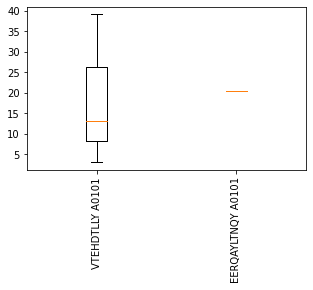

[80.]
('CASSLERDRPYEQYF', 'NaN') unresolved
          peptide                                        peptide_lst  \
2170    VTEHDTLLY  ['RQAYLTNQY' 'GMAEGATTA' 'EERQAYLTNQY' 'NLVPMV...   
2225  EERQAYLTNQY  ['ICSSVDIHF' 'RAKFKQLL' 'TADVDAGSLS' 'CSSVDIHF...   
2230    VTEHDTLLY            ['SVDIHFDPG' 'ATTADVDAGSL' 'VTEHDTLLY']   
2391    VTEHDTLLY                          ['GMAEGATTA' 'VTEHDTLLY']   

                     umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2170  [1, 1, 1, 1, 1, 1, 2, 5, 8, 130]                        NaN   
2225                 [1, 1, 2, 13, 22]                        NaN   
2230                        [1, 5, 22]                        NaN   
2391                           [1, 13]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
2170               NaN  CASSLERDRPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']   
2225               NaN  CASSLERDRPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']   
2230               NaN  CASSLERDRPYE

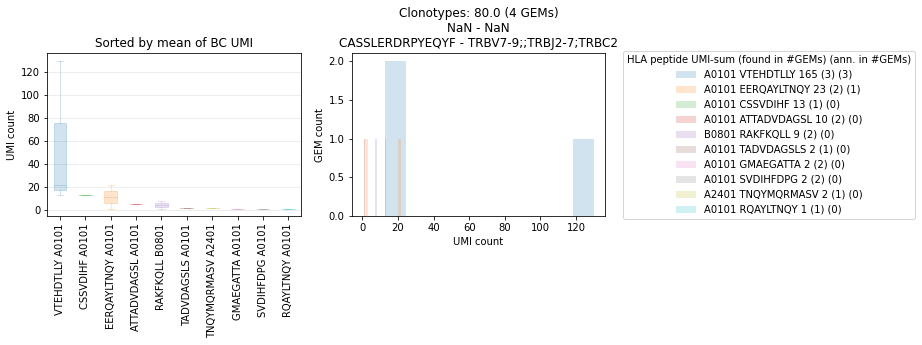

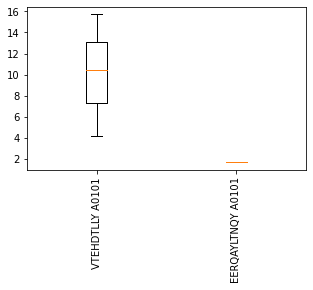

[55.]
('CASSLGIHYEQYF', 'CAVSDRSGGGADGLTF') unresolved
        peptide               peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
272   VTEHDTLLY             ['VTEHDTLLY']               [1]  CAVSDRSGGGADGLTF   
978    RAKFKQLL  ['VIRHKRQSW' 'RAKFKQLL']            [3, 8]  CAVSDRSGGGADGLTF   
1608  VTEHDTLLY             ['VTEHDTLLY']               [1]  CAVSDRSGGGADGLTF   
1991   RAKFKQLL              ['RAKFKQLL']               [1]  CAVSDRSGGGADGLTF   

                genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
272   ['TRAV8-6;TRAJ45;TRAC']                 1  CASSLGIHYEQYF   
978   ['TRAV8-6;TRAJ45;TRAC']                 5  CASSLGIHYEQYF   
1608  ['TRAV8-6;TRAJ45;TRAC']                 4  CASSLGIHYEQYF   
1991  ['TRAV8-6;TRAJ45;TRAC']                 5  CASSLGIHYEQYF   

                  genes_lst_TRB umi_count_lst_TRB  
272   ['TRBV28;;TRBJ2-7;TRBC2']                13  
978   ['TRBV28;;TRBJ2-7;TRBC2']                 5  
1608  ['TRBV28;;TRBJ2-7;TRBC2']                 8  


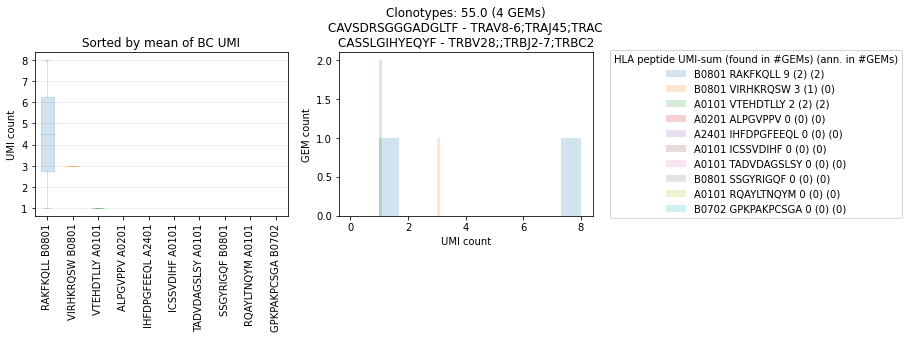

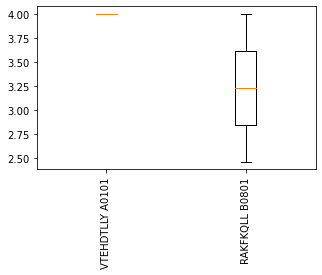

[689.]
('CASSLGTGIYEQYF', 'CIVRVGGDSWGKLQF') unresolved
          peptide      peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQF   
1892  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CIVRVGGDSWGKLQ

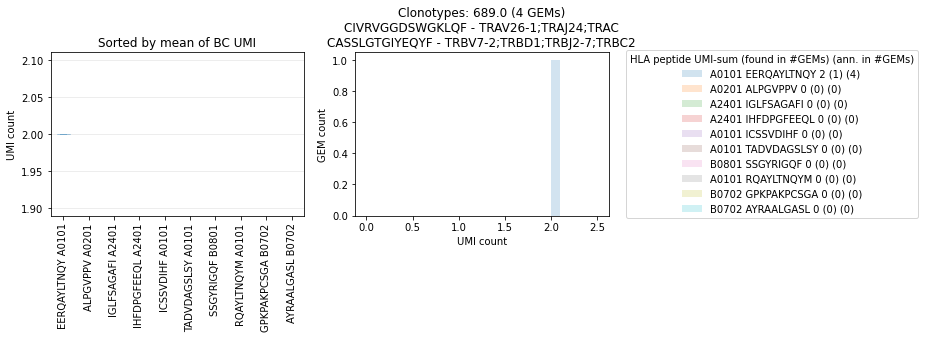

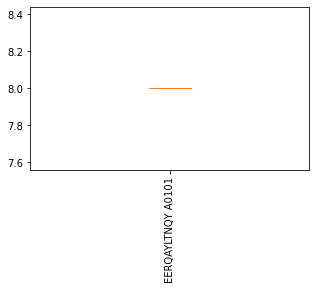

[225.]
('CASSLIVSGGANEQFF', 'CAESTINTGTASKLTF') unresolved
        peptide                 peptide_lst umi_count_lst_mhc  \
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 'VTEHDTLLY']            [1, 1]   
1543  VTEHDTLLY  ['FSAGAFILYN' 

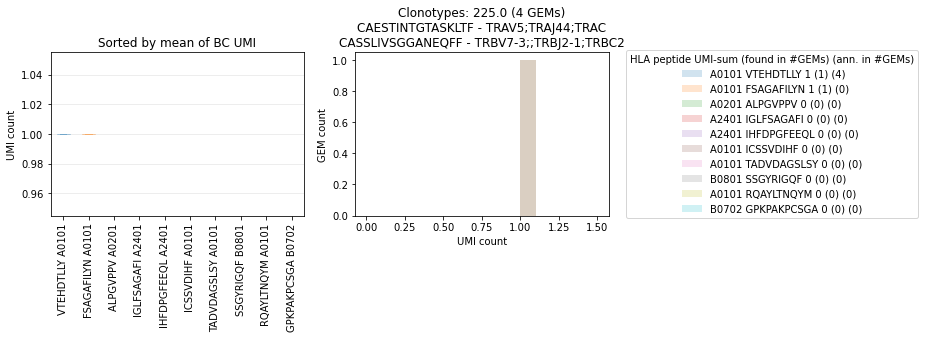

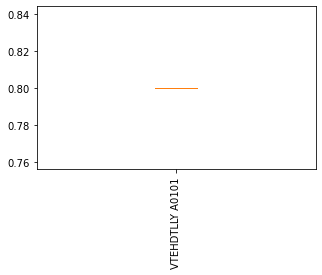

[174.]
('CASSLIVSGGANEQFF', 'CAVGADASGTYKYIF') unresolved
       peptide                                        peptide_lst  \
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EERQAYLTNQY' 'FSAGAF...   
785  VTEHDTLLY  ['QAYLTNQY' 'FSAGAFILYK' 'EER

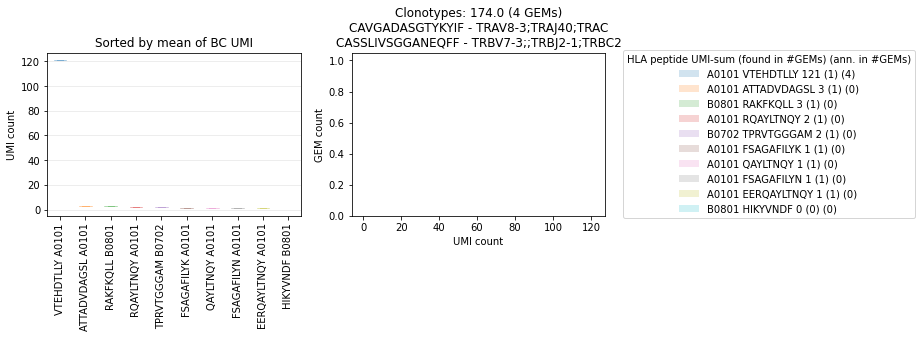

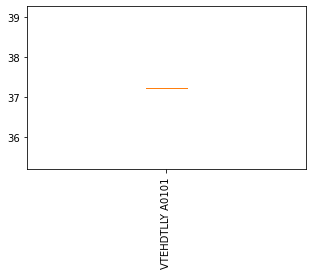

[504.]
('CASSLIVSGGANEQFF', 'CAVMDSNYQLIW') unresolved
      peptide                                        peptide_lst  \
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV...   
637  RAKFKQLL  ['VIRHKRQSW' 'IRHKRQSWV' 'AMLIRDRL' 'NLVPMVATV

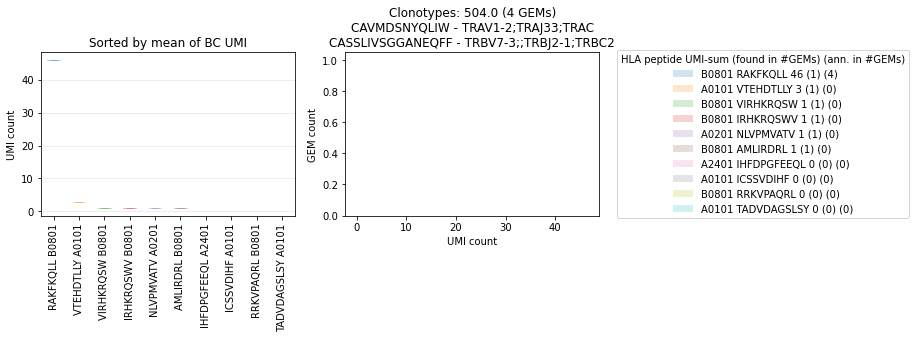

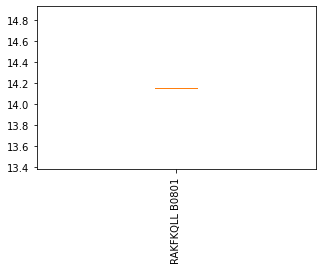

[537.]
('CASSLSGGGRGAEAFF', 'CAAQGGKLIF') resolved by trash bin
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFILYK']               [1]   CAAQGGKLIF   
1284  SAGAFILYK  ['SAGAFIL

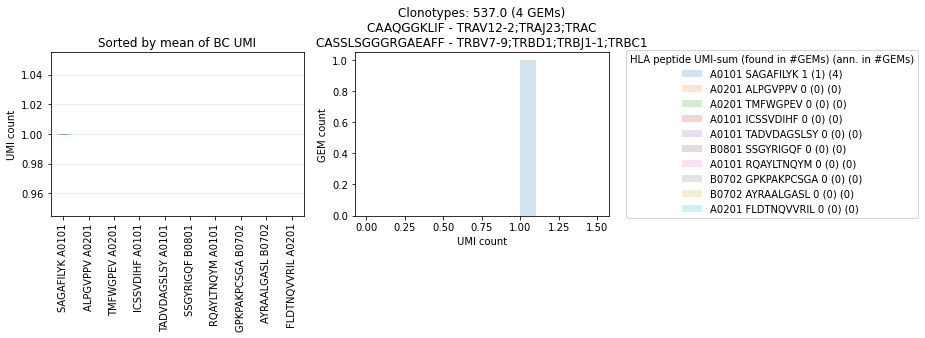

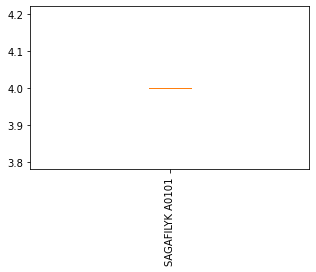

[419.]
('CASSLVAGAPSEQYF', 'CAMREASTTDSWGKLQF') unresolved
         peptide                                        peptide_lst  \
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  ['EERQAYLTNQY' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFI...   
2061  FSAGAFILYK  

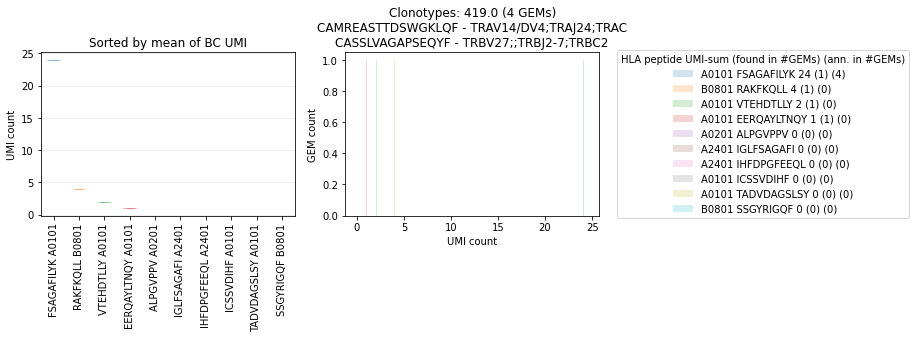

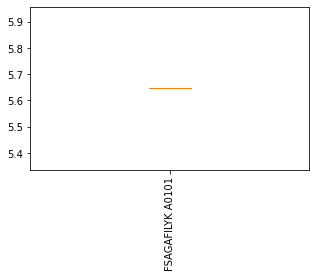

[126.]
('CASSLVSGGYTEAFF', 'CAAPPSGNTPLVF') unresolved
       peptide   peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAVNEPSGYALNF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAVNEPSGYALNF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAAPPSGNTPLVF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAAPPSGNTPLVF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAVNEPSGYALNF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAVNEPSGYALNF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAAPPSGNTPLVF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAAPPSGNTPLVF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAVNEPSGYALNF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAVNEPSGYALNF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAAPPSGNTPLVF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAAPPSGNTPLVF   
1436  RAKFKQLL  ['RAKFKQLL']               [1]  CAVNEPSGYALNF   
1436  RAKFKQLL  ['RAKFKQLL']       

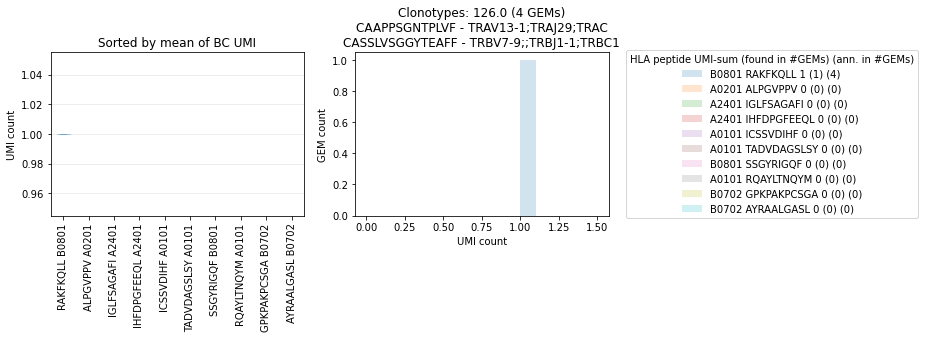

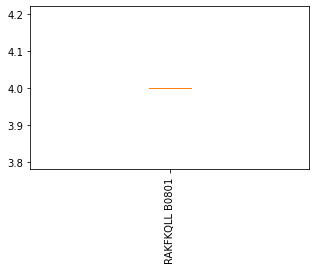

[190.]
('CASSPTYEQYF', 'CALIGMYSGGGADGLTF') unresolved
       peptide    peptide_lst umi_count_lst_mhc       cdr3_lst_TRA  \
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']               [1]  CALIGMYSGGGADGLTF   
210  NLVPMVATV  ['NLVPMVATV']      

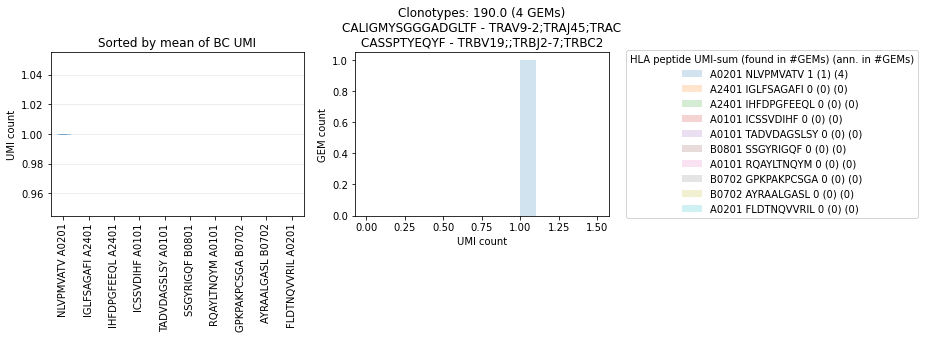

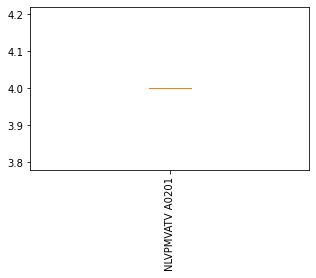

[415.]
('CASSSHEWSGVRTEAFF', 'CAMREGSDSSYKLIF') unresolved
        peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]         CAATKFYF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]         CAATKFYF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]  CAMREGSDSSYKLIF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]  CAMREGSDSSYKLIF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]         CAATKFYF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]         CAATKFYF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]  CAMREGSDSSYKLIF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]  CAMREGSDSSYKLIF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]         CAATKFYF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]         CAATKFYF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]  CAMREGSDSSYKLIF   
1710  VTEHDTLLY  ['VTEHDTLLY']               [3]  CAMREGSDSSYKLIF   
1710  VTEHDTLLY  ['VTEHDTLLY']              

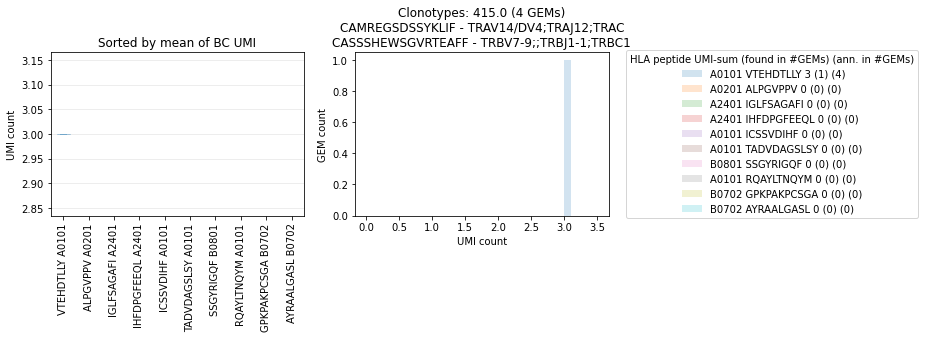

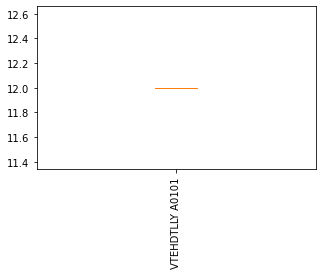

[706.]
('CASSVGQGVTYEQYF', 'CAASQNEKLTF') unresolved
        peptide                  peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   
1819  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 47]  CAASQNEKLTF   

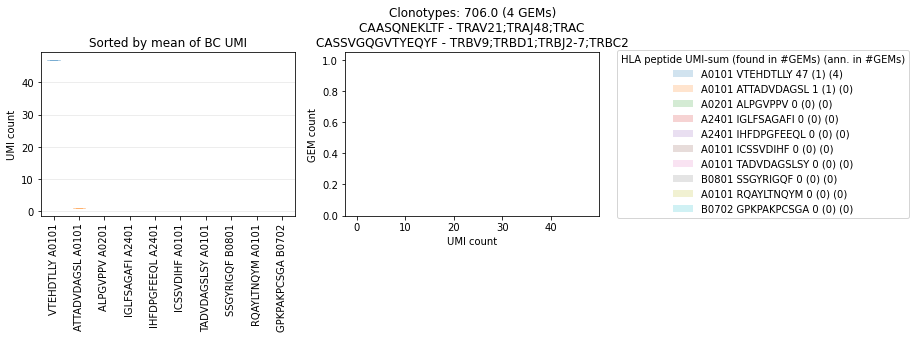

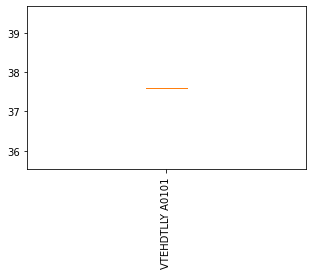

[583.]
('CASSYTPGSTYEQYF', 'CAAFRAYNTDKLIF') unresolved
        peptide                                        peptide_lst  \
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVDIHFDPGF' 'TPRVTGGGAM' 'NLVPMV...   
1201  VTEHDTLLY  ['ILKEPVHGV' 'SVD

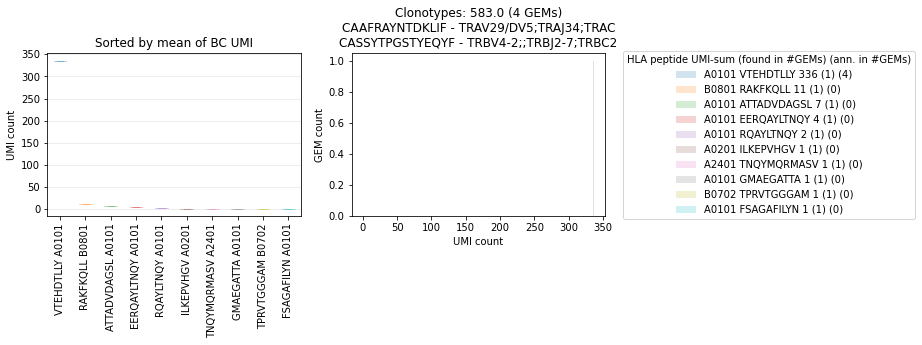

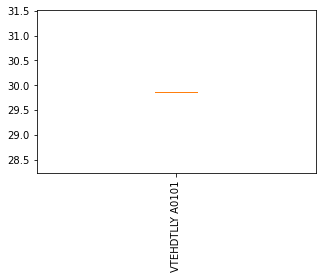

[63.]
('CASTPRDRGFQPQHF', 'NaN') unresolved
          peptide                                        peptide_lst  \
2124    VTEHDTLLY                                      ['VTEHDTLLY']   
2138  EERQAYLTNQY  ['NLVPMVATV' 'RAKFKQLL' 'FSAGAFILYK' 'VTEHDTLL...   
2151    VTEHDTLLY                                      ['VTEHDTLLY']   
2215    VTEHDTLLY  ['NLVPMVATV' 'RAKFKQLL' 'RTMFWGPEV' 'ATTADVDAG...   

     umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2124               [1]                        NaN               NaN   
2138  [1, 1, 1, 2, 12]                        NaN               NaN   
2151              [27]                        NaN               NaN   
2215  [1, 1, 1, 1, 24]                        NaN               NaN   

         cdr3_lst_TRB                   genes_lst_TRB umi_count_lst_TRB  
2124  CASTPRDRGFQPQHF  ['TRBV19;TRBD1;TRBJ1-5;TRBC1']                 3  
2138  CASTPRDRGFQPQHF  ['TRBV19;TRBD1;TRBJ1-5;TRBC1']                 4  
2151  CASTPRDRGFQ

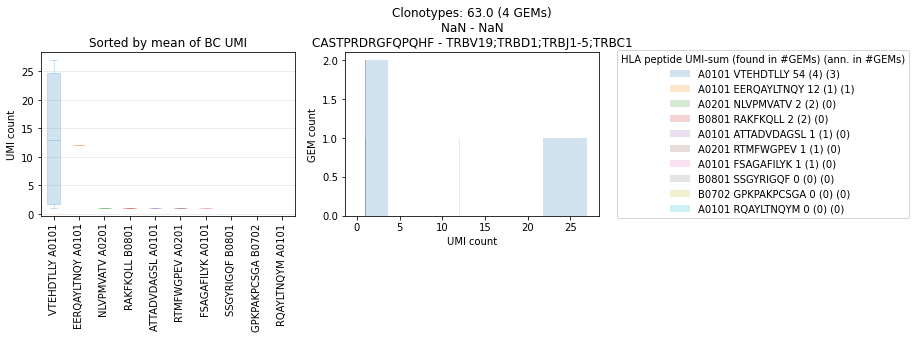

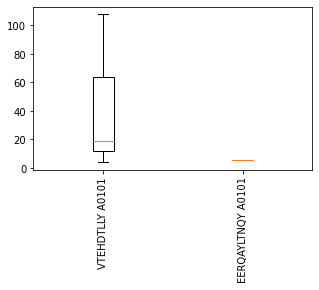

[478.]
('CSARGLGQAKEYGYTF', 'CALRDMEYGNKLVF') unresolved
       peptide                  peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']            [1, 7]  CALRDMEYGNKLVF   
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']            [1, 7]  CALRDMEYGNKLVF   
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']            [1, 7]  CALRDMEYGNKLVF   
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']            [1, 7]  CALRDMEYGNKLVF   
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']            [1, 7]  CALRDMEYGNKLVF   
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']            [1, 7]  CALRDMEYGNKLVF   
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']            [1, 7]  CALRDMEYGNKLVF   
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']            [1, 7]  CALRDMEYGNKLVF   
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']            [1, 7]  CALRDMEYGNKLVF   
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']            [1, 7]  CALRDMEYGNKLVF   
609  VTEHDTLLY  ['TNQYMQRMASV' 'VTEHDTLLY']         

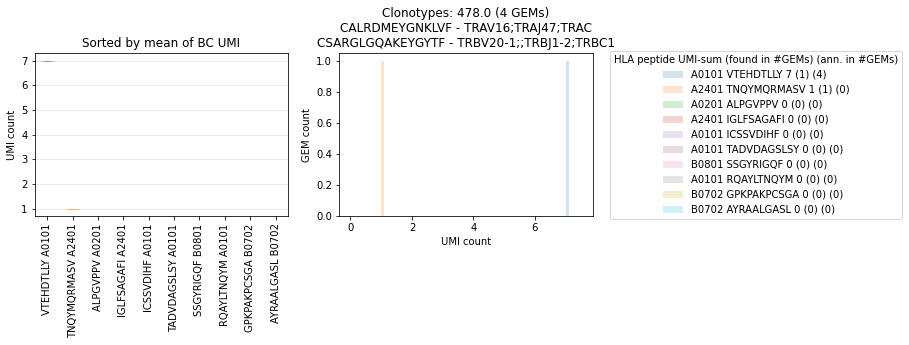

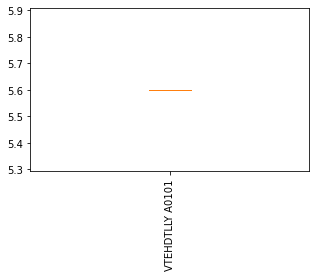

[716.]
('CSARGLGQAKEYGYTF', 'CAVNYGNKLVF') unresolved
         peptide      peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]  CAAFRAYNTDKLIF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]  CAAFRAYNTDKLIF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]     CAVNYGNKLVF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]     CAVNYGNKLVF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]  CAAFRAYNTDKLIF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]  CAAFRAYNTDKLIF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]     CAVNYGNKLVF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]     CAVNYGNKLVF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]  CAAFRAYNTDKLIF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]  CAAFRAYNTDKLIF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]     CAVNYGNKLVF   
940  EERQAYLTNQY  ['EERQAYLTNQY']               [8]     CAVNYGNKLVF   
940  EERQAYLTNQY  ['EER

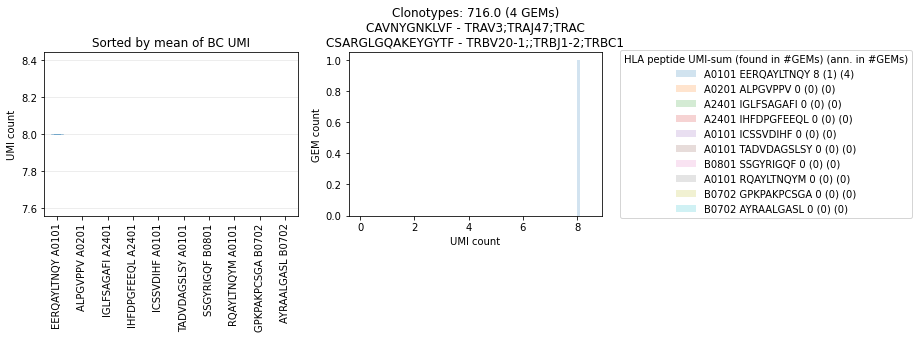

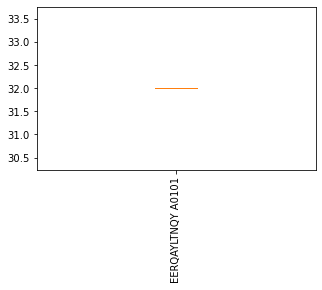

[597.]
('NaN', 'CAATTTDSWGKLQF') unresolved
      peptide                                     peptide_lst  \
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHYAC' 'RAKFKQLL']   
256  RAKFKQLL  ['AMLIRDRL' 'SQKVLRHM' 'HTGEKHY

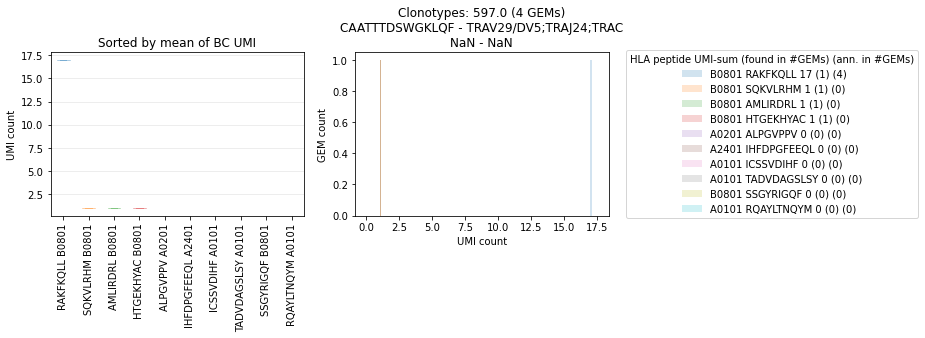

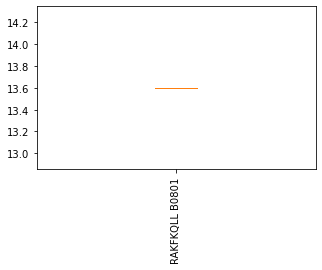

[75.]
('CASSAEQGVPYEQYF', 'CAARPTASKLTF') unresolved
        peptide                                        peptide_lst  \
328    RAKFKQLL                           ['GMAEGATTA' 'RAKFKQLL']   
644   VTEHDTLLY                        ['ATTADVDAGSL' 'VTEHDTLLY']   
2062  VTEHDTLLY  ['GMAEGATTA' 'RQAYLTNQY' 'RAKFKQLL' 'TNQYMQRMA...   

         umi_count_lst_mhc  cdr3_lst_TRA               genes_lst_TRA  \
328                 [1, 1]  CAARPTASKLTF  ['TRAV29/DV5;TRAJ44;TRAC']   
644                [1, 26]  CAARPTASKLTF  ['TRAV29/DV5;TRAJ44;TRAC']   
2062  [1, 1, 1, 1, 4, 121]  CAARPTASKLTF  ['TRAV29/DV5;TRAJ44;TRAC']   

     umi_count_lst_TRA     cdr3_lst_TRB                    genes_lst_TRB  \
328                  2  CASSAEQGVPYEQYF  ['TRBV7-9;TRBD1;TRBJ2-7;TRBC2']   
644                  2  CASSAEQGVPYEQYF  ['TRBV7-9;TRBD1;TRBJ2-7;TRBC2']   
2062                 6  CASSAEQGVPYEQYF  ['TRBV7-9;TRBD1;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
328                 11  
644                 12

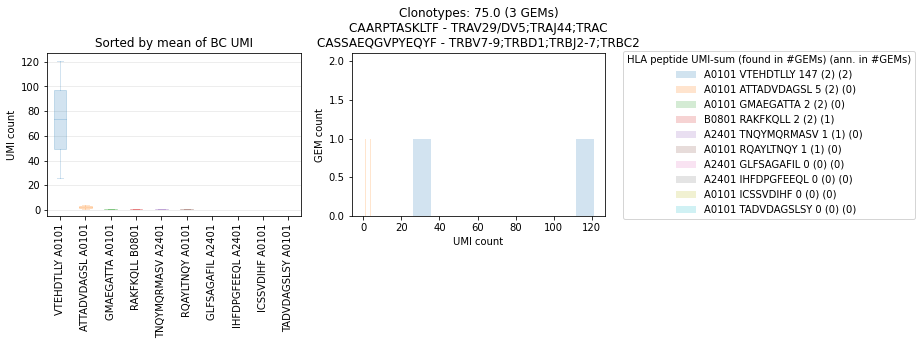

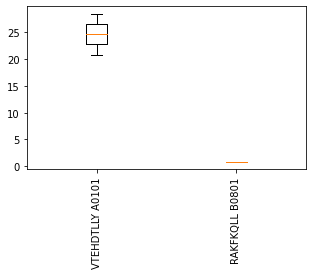

[111.]
('CASSDEWAEKLFF', 'NaN') unresolved
         peptide     peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2159    RAKFKQLL    ['RAKFKQLL']               [1]                        NaN   
2294   VTEHDTLLY   ['VTEHDTLLY']               [2]                        NaN   
2431  FSAGAFILYK  ['FSAGAFILYK']               [1]                        NaN   

     umi_count_lst_TRA   cdr3_lst_TRB               genes_lst_TRB  \
2159               NaN  CASSDEWAEKLFF  ['TRBV7-9;;TRBJ1-4;TRBC1']   
2294               NaN  CASSDEWAEKLFF  ['TRBV7-9;;TRBJ1-4;TRBC1']   
2431               NaN  CASSDEWAEKLFF  ['TRBV7-9;;TRBJ1-4;TRBC1']   

     umi_count_lst_TRB  
2159                 8  
2294                 8  
2431                 4  


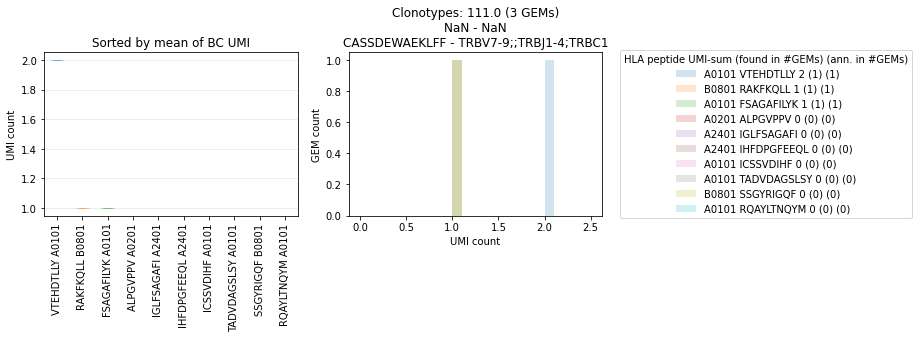

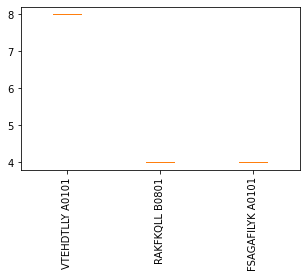

[58.]
('CASSEWGGRGGGYEQYF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2247   RAKFKQLL  ['IHFDPGFEEQL' 'VTEHDTLLY' 'HTGEKHYAC' 'RAKFKQ...   
2264  VTEHDTLLY                                      ['VTEHDTLLY']   
2278  VTEHDTLLY                                      ['VTEHDTLLY']   

     umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2247      [1, 2, 7, 7]                        NaN               NaN   
2264               [1]                        NaN               NaN   
2278               [1]                        NaN               NaN   

           cdr3_lst_TRB                     genes_lst_TRB umi_count_lst_TRB  
2247  CASSEWGGRGGGYEQYF  ['TRBV11-2;TRBD1;TRBJ2-7;TRBC2']                 4  
2264  CASSEWGGRGGGYEQYF  ['TRBV11-2;TRBD1;TRBJ2-7;TRBC2']                12  
2278  CASSEWGGRGGGYEQYF  ['TRBV11-2;TRBD1;TRBJ2-7;TRBC2']                10  


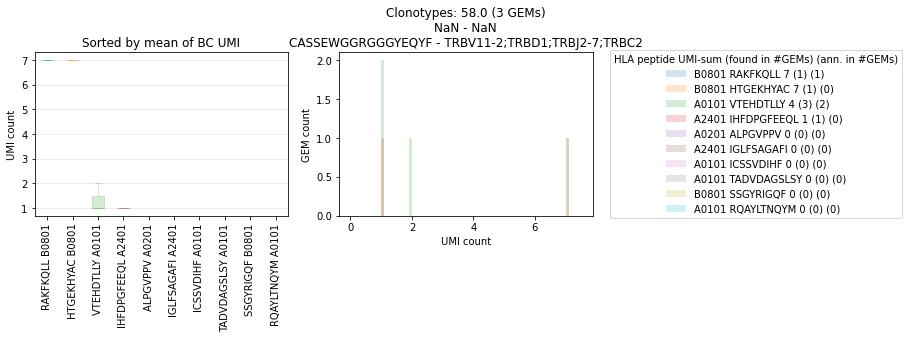

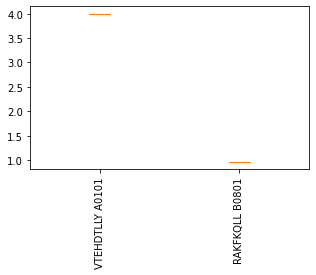

[40.]
('CASSFRTVSSYEQYF', 'CILRGAYSGAGSYQLTF') unresolved
         peptide                                        peptide_lst  \
518   TPRVTGGGAM  ['ATTADVDAGSL' 'RAKFKQLL' 'GPFPGNLV' 'IRHKRQSW...   
923   TPRVTGGGAM                                     ['TPRVTGGGAM']   
1629  KVPAQRLQEA  ['RTMFWGPEV' 'VTEHDTLLY' 'GPFPGNLV' 'RAKFKQLL'...   

                    umi_count_lst_mhc       cdr3_lst_TRA  \
518   [1, 1, 1, 1, 1, 1, 1, 2, 5, 58]  CILRGAYSGAGSYQLTF   
923                               [1]  CILRGAYSGAGSYQLTF   
1629             [1, 1, 1, 2, 10, 11]  CILRGAYSGAGSYQLTF   

                 genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
518   ['TRAV26-2;TRAJ28;TRAC']                 2  CASSFRTVSSYEQYF   
923   ['TRAV26-2;TRAJ28;TRAC']                 4  CASSFRTVSSYEQYF   
1629  ['TRAV26-2;TRAJ28;TRAC']                 2  CASSFRTVSSYEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
518   ['TRBV7-8;;TRBJ2-7;TRBC2']                14  
923   ['TRBV7-8;;TRBJ2-7;TRBC2'] 

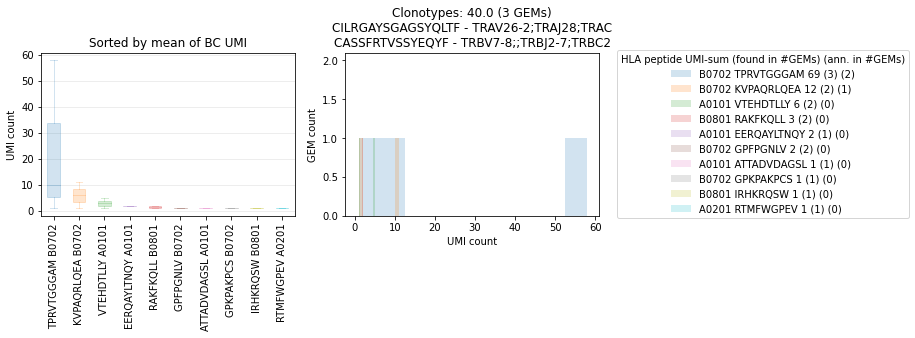

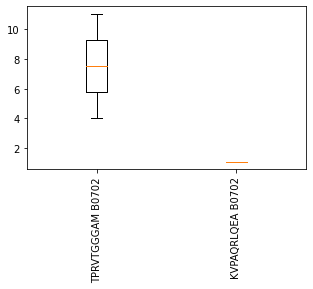

[77.]
('CASSFRVGGSYNEQFF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2372   RAKFKQLL                                       ['RAKFKQLL']   
2383  VTEHDTLLY  ['RAKFKQLL' 'EERQAYLTNQY' 'FSAGAFILYN' 'ATTADV...   
2383  VTEHDTLLY  ['RAKFKQLL' 'EERQAYLTNQY' 'FSAGAFILYN' 'ATTADV...   
2383  VTEHDTLLY  ['RAKFKQLL' 'EERQAYLTNQY' 'FSAGAFILYN' 'ATTADV...   
2383  VTEHDTLLY  ['RAKFKQLL' 'EERQAYLTNQY' 'FSAGAFILYN' 'ATTADV...   

        umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2372                  [1]                        NaN               NaN   
2383  [1, 1, 1, 1, 1, 42]                        NaN               NaN   
2383  [1, 1, 1, 1, 1, 42]                        NaN               NaN   
2383  [1, 1, 1, 1, 1, 42]                        NaN               NaN   
2383  [1, 1, 1, 1, 1, 42]                        NaN               NaN   

          cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
2372  CASSFRVGGSYN

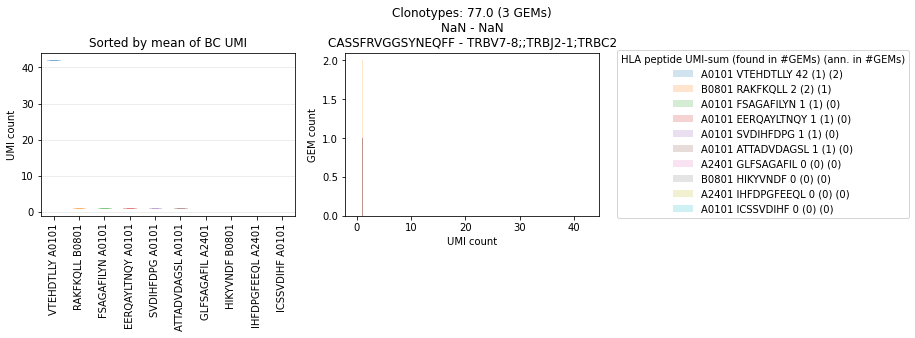

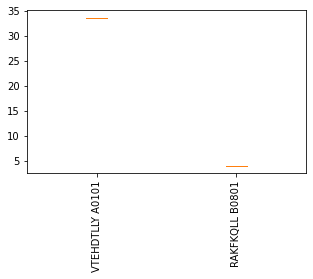

[69.]
('CASSLIGVSSYNEQFF', 'CATVPRMDSSYKLIF') unresolved
         peptide                                        peptide_lst  \
231     RAKFKQLL                                       ['RAKFKQLL']   
1823  TPRVTGGGAM  ['KVPAQRLQEA' 'SVDIHFDPGF' 'GPFPGNLV' 'YPLVKMR...   
2050  GLFSAGAFIL                                     ['GLFSAGAFIL']   

           umi_count_lst_mhc     cdr3_lst_TRA           genes_lst_TRA  \
231                      [1]  CATVPRMDSSYKLIF  ['TRAV17;TRAJ12;TRAC']   
1823  [1, 1, 2, 2, 3, 4, 51]  CATVPRMDSSYKLIF  ['TRAV17;TRAJ12;TRAC']   
2050                     [1]  CATVPRMDSSYKLIF  ['TRAV17;TRAJ12;TRAC']   

     umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
231                  3  CASSLIGVSSYNEQFF  ['TRBV7-9;;TRBJ2-1;TRBC2']   
1823                 1  CASSLIGVSSYNEQFF  ['TRBV7-9;;TRBJ2-1;TRBC2']   
2050                 3  CASSLIGVSSYNEQFF  ['TRBV7-9;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
231                 11  
1823                 8  
2

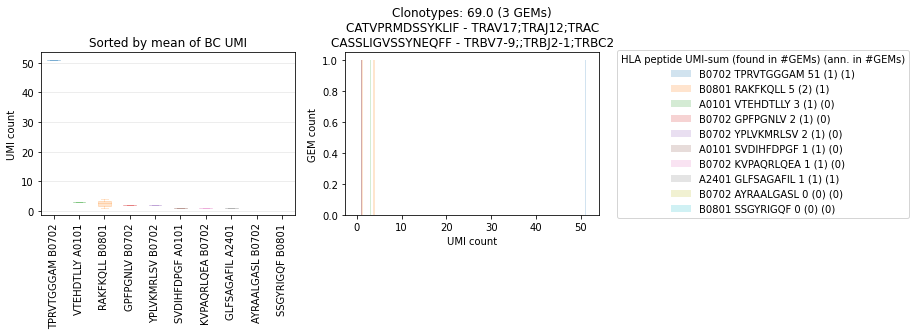

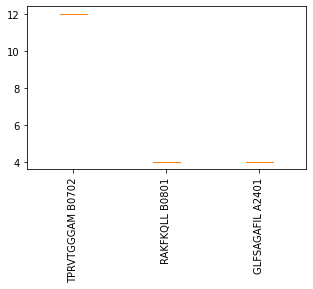

[91.]
('CASSLTSGAPLQQYF', 'CAVAEGNQFYF') unresolved
        peptide               peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
93     RAKFKQLL  ['VTEHDTLLY' 'RAKFKQLL']            [1, 2]  CAVAEGNQFYF   
723   VTEHDTLLY             ['VTEHDTLLY']               [1]  CAVAEGNQFYF   
1477  VTEHDTLLY             ['VTEHDTLLY']               [1]  CAVAEGNQFYF   

                genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
93    ['TRAV8-3;TRAJ49;TRAC']                 3  CASSLTSGAPLQQYF   
723   ['TRAV8-3;TRAJ49;TRAC']                 2  CASSLTSGAPLQQYF   
1477  ['TRAV8-3;TRAJ49;TRAC']                 3  CASSLTSGAPLQQYF   

                  genes_lst_TRB umi_count_lst_TRB  
93    ['TRBV27;;TRBJ2-7;TRBC2']                 2  
723   ['TRBV27;;TRBJ2-7;TRBC2']                 5  
1477  ['TRBV27;;TRBJ2-7;TRBC2']                 8  


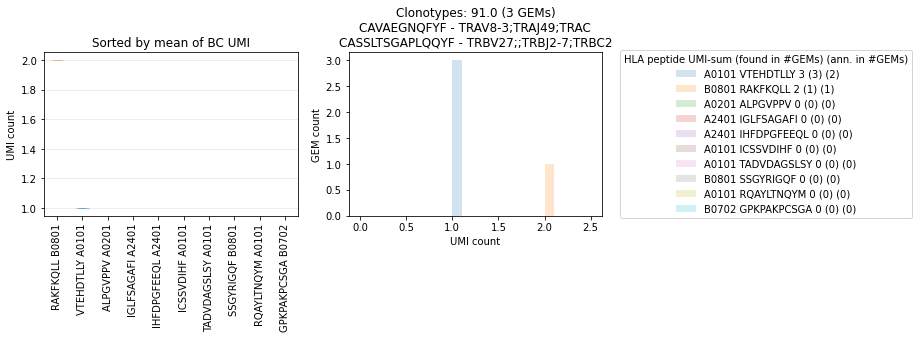

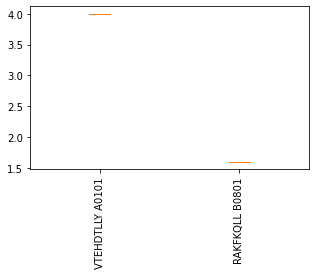

[113.]
('CASSSGAGPTYEQYF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2114  VTEHDTLLY  ['TNQYMQRMASV' 'SVDIHFDPGF' 'SAGAFILYK' 'QAYLT...   
2199  VTEHDTLLY  ['ALPGVPPV' 'VIRHKRQSW' 'SQSDQTSEL' 'RQAYLTNQY...   
2326  VTEHDTLLY  ['RQAYLTNQY' 'NLVPMVATV' 'QAYLTNQY' 'ALPGVPPV'...   

                                      umi_count_lst_mhc cdr3_lst_TRA  \
2114           [1, 1, 1, 1, 1, 1, 1, 3, 3, 15, 24, 112]                
2199  [1, 1, 1, 1, 1, 1, 1, 2, 2, 4, 5, 6, 8, 9, 15,...                
2326               [1, 1, 1, 1, 1, 2, 2, 5, 5, 15, 147]                

     genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2114           NaN               NaN  CASSSGAGPTYEQYF   
2199           NaN               NaN  CASSSGAGPTYEQYF   
2326           NaN               NaN  CASSSGAGPTYEQYF   

                 genes_lst_TRB umi_count_lst_TRB  
2114  ['TRBV9;;TRBJ2-7;TRBC2']                 7  
2199  ['TRBV9;;TRBJ2-7;TRBC2']                 6  
232

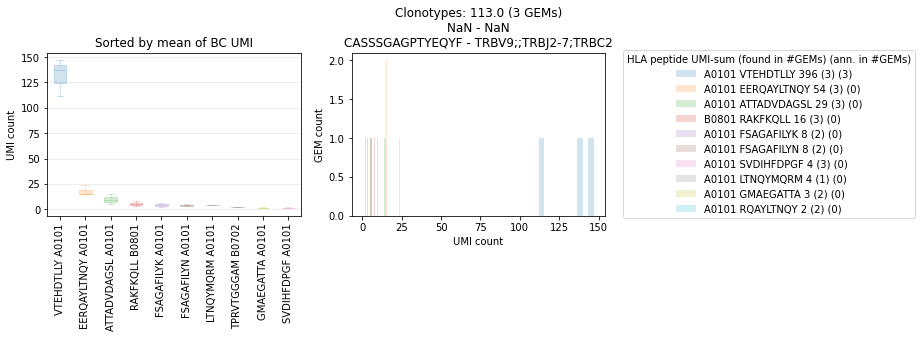

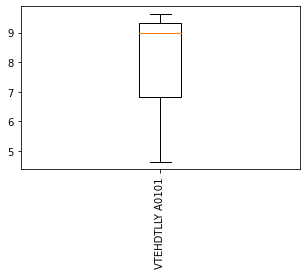

[44.]
('CASSSPGSGASEKLFF', 'CAASPGGFKTIF') unresolved
          peptide      peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
483   EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAASPGGFKTIF   
1360    VTEHDTLLY    ['VTEHDTLLY']               [1]  CAASPGGFKTIF   
1553  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAASPGGFKTIF   

                  genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
483   ['TRAV29/DV5;TRAJ9;TRAC']                 4  CASSSPGSGASEKLFF   
1360  ['TRAV29/DV5;TRAJ9;TRAC']                 4  CASSSPGSGASEKLFF   
1553  ['TRAV29/DV5;TRAJ9;TRAC']                 2  CASSSPGSGASEKLFF   

                         genes_lst_TRB umi_count_lst_TRB  
483   ['TRBV11-2;TRBD1;TRBJ1-4;TRBC1']                12  
1360  ['TRBV11-2;TRBD1;TRBJ1-4;TRBC1']                 4  
1553  ['TRBV11-2;TRBD1;TRBJ1-4;TRBC1']                 8  


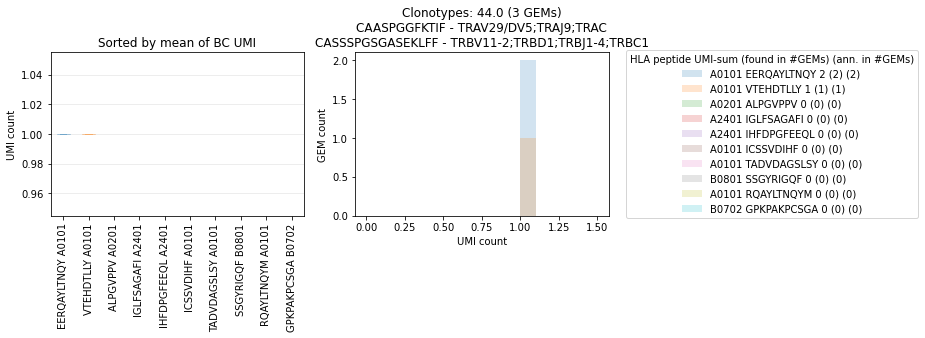

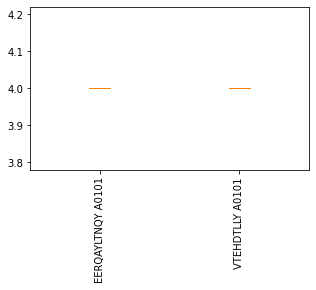

[98.]
('CASSSTGPGNQPQHF', 'CAAIETSYDKVIF') unresolved
       peptide                                       peptide_lst  \
80   VTEHDTLLY                                     ['VTEHDTLLY']   
584   RAKFKQLL  ['VTEHDTLLY' 'IRHKRQSWV' 'VIRHKRQSW' 'RAKFKQLL']   
762   RAKFKQLL  ['VTEHDTLLY' 'TPRVTGGGAM' 'AMLIRDRL' 'RAKFKQLL']   

    umi_count_lst_mhc   cdr3_lst_TRA             genes_lst_TRA  \
80                [1]  CAAIETSYDKVIF  ['TRAV13-1;TRAJ50;TRAC']   
584     [1, 1, 2, 29]  CAAIETSYDKVIF  ['TRAV13-1;TRAJ50;TRAC']   
762     [1, 1, 2, 74]  CAAIETSYDKVIF  ['TRAV13-1;TRAJ50;TRAC']   

    umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
80                  3  CASSSTGPGNQPQHF  ['TRBV7-9;;TRBJ1-5;TRBC1']   
584                 2  CASSSTGPGNQPQHF  ['TRBV7-9;;TRBJ1-5;TRBC1']   
762                 6  CASSSTGPGNQPQHF  ['TRBV7-9;;TRBJ1-5;TRBC1']   

    umi_count_lst_TRB  
80                 14  
584                11  
762                12  


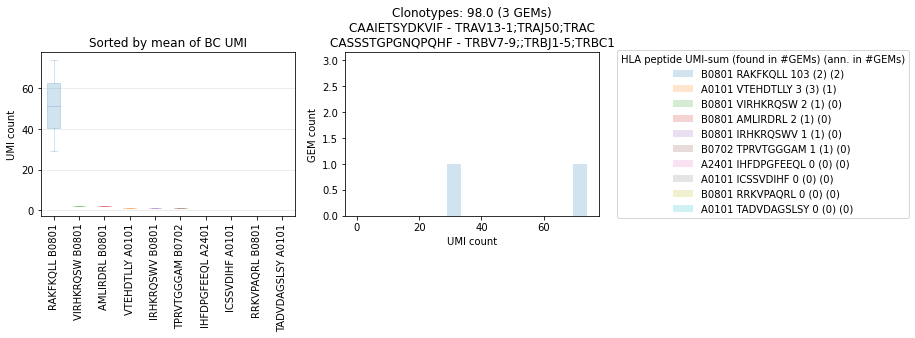

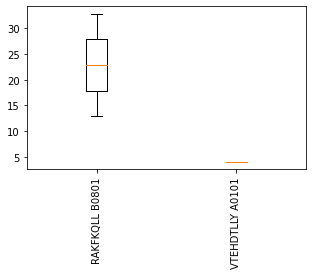

[57.]
('CASRIGAAGNSPLHF', 'CALRDMEYGNKLVF') unresolved
        peptide     peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
177  TADVDAGSLS  ['TADVDAGSLS']               [1]     CAVNYGNKLVF   
177  TADVDAGSLS  ['TADVDAGSLS']               [1]  CALRDMEYGNKLVF   
177  TADVDAGSLS  ['TADVDAGSLS']               [1]     CAVNYGNKLVF   
177  TADVDAGSLS  ['TADVDAGSLS']               [1]  CALRDMEYGNKLVF   

                                  genes_lst_TRA umi_count_lst_TRA  \
177  ['TRAV3;TRAJ47;TRAC' 'TRAV16;TRAJ47;TRAC']                 1   
177  ['TRAV3;TRAJ47;TRAC' 'TRAV16;TRAJ47;TRAC']                 1   
177  ['TRAV3;TRAJ47;TRAC' 'TRAV16;TRAJ47;TRAC']                 1   
177  ['TRAV3;TRAJ47;TRAC' 'TRAV16;TRAJ47;TRAC']                 1   

        cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
177  CASRIGAAGNSPLHF  ['TRBV27;;TRBJ1-6;TRBC1']                 1  
177  CASRIGAAGNSPLHF  ['TRBV27;;TRBJ1-6;TRBC1']                 1  
177  CASRIGAAGNSPLHF  ['TRBV27;;TRBJ1-6;TRBC1']  

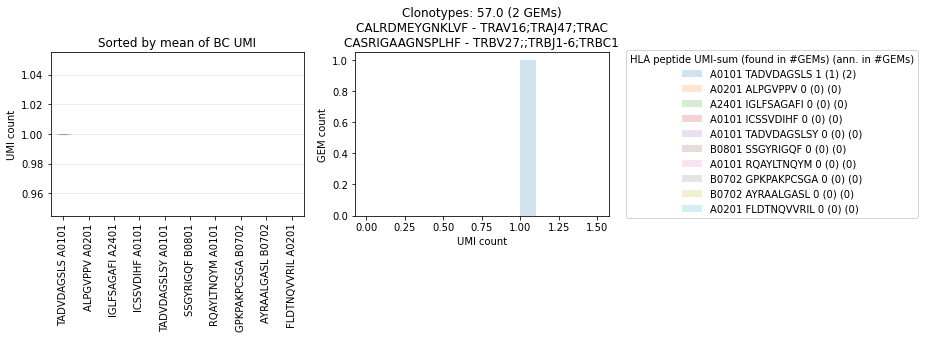

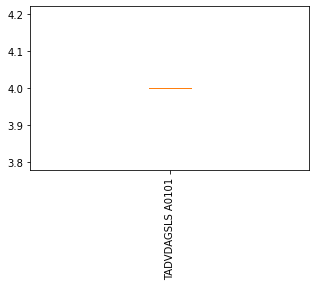

[89.]
('CASRMAGALSYEQYF', 'NaN') unresolved
       peptide               peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2213  RAKFKQLL              ['RAKFKQLL']               [1]                
2343  RAKFKQLL  ['VTEHDTLLY' 'RAKFKQLL']            [1, 1]                

     genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2213           NaN               NaN  CASRMAGALSYEQYF   
2343           NaN               NaN  CASRMAGALSYEQYF   

                 genes_lst_TRB umi_count_lst_TRB  
2213  ['TRBV2;;TRBJ2-7;TRBC2']                 1  
2343  ['TRBV2;;TRBJ2-7;TRBC2']                 7  


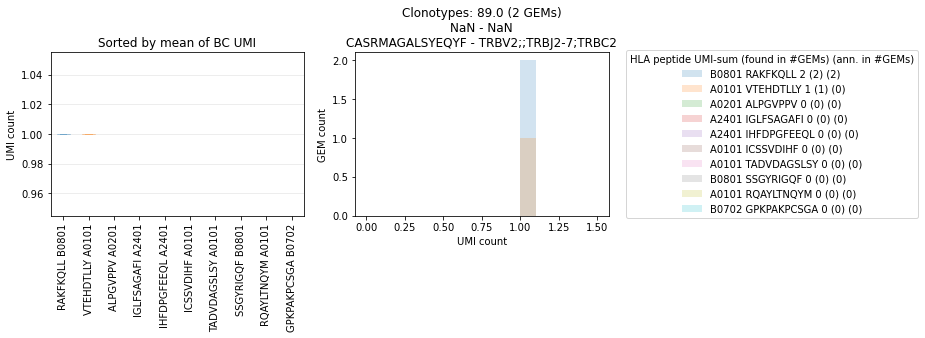

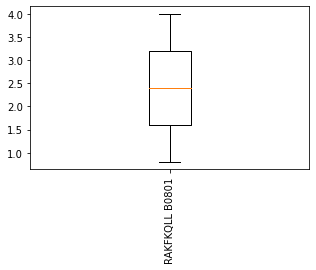

[73.]
('CASRPGLAGVYNEQFF', 'CAAAETSYDKVIF') unresolved
        peptide                  peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
13    IRHKRQSWV  ['EERQAYLTNQY' 'IRHKRQSWV']            [1, 1]  CAAAETSYDKVIF   
1649  VTEHDTLLY                ['VTEHDTLLY']               [1]  CAAAETSYDKVIF   

                 genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
13    ['TRAV13-1;TRAJ50;TRAC']                 4  CASRPGLAGVYNEQFF   
1649  ['TRAV13-1;TRAJ50;TRAC']                 9  CASRPGLAGVYNEQFF   

                        genes_lst_TRB umi_count_lst_TRB  
13    ['TRBV5-4;TRBD2;TRBJ2-1;TRBC2']                 9  
1649  ['TRBV5-4;TRBD2;TRBJ2-1;TRBC2']                17  


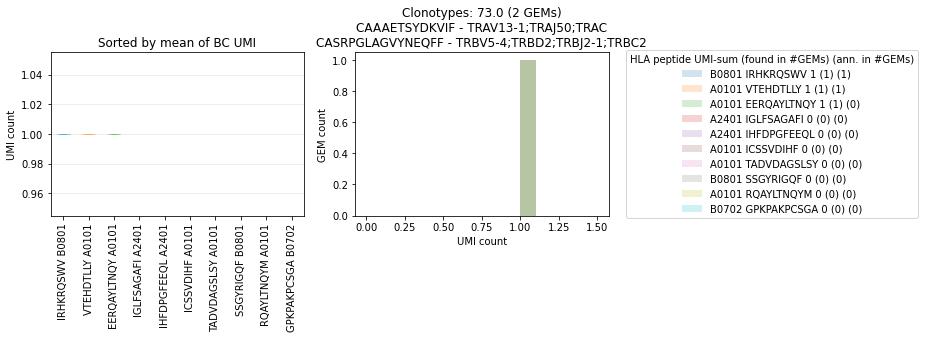

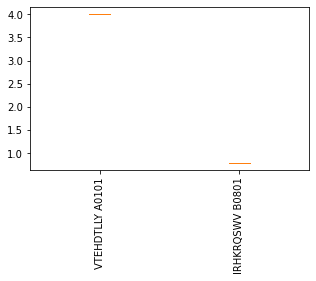

[137.]
('CASRRAGPVPFF', 'NaN') unresolved
        peptide                                       peptide_lst  \
2165  VTEHDTLLY  ['QAYLTNQY' 'RQAYLTNQY' 'GMAEGATTA' 'VTEHDTLLY']   
2308  VTEHDTLLY                       ['ATTADVDAGSL' 'VTEHDTLLY']   

     umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2165     [1, 1, 1, 92]                        NaN               NaN   
2308           [1, 49]                        NaN               NaN   

      cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
2165  CASRRAGPVPFF  ['TRBV19;;TRBJ1-1;TRBC1']                 3  
2308  CASRRAGPVPFF  ['TRBV19;;TRBJ1-1;TRBC1']                 4  


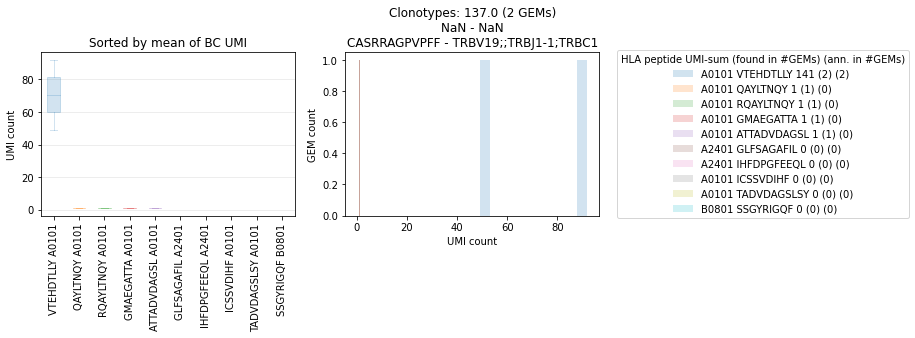

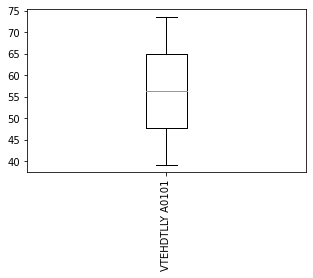

[154.]
('CASSAEQGVPYEQYF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2210  VTEHDTLLY              ['GMAEGATTA' 'NLVPMVATV' 'VTEHDTLLY']   
2392  VTEHDTLLY  ['QAYLTNQY' 'SIKDGLPPV' 'SSGYRIGQF' 'NLVPMVATV...   

                              umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2210                                [1, 1, 118]                        NaN   
2392  [1, 1, 1, 1, 1, 1, 2, 2, 2, 3, 4, 6, 183]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB                    genes_lst_TRB  \
2210               NaN  CASSAEQGVPYEQYF  ['TRBV7-9;TRBD1;TRBJ2-7;TRBC2']   
2392               NaN  CASSAEQGVPYEQYF  ['TRBV7-9;TRBD1;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
2210                13  
2392                20  


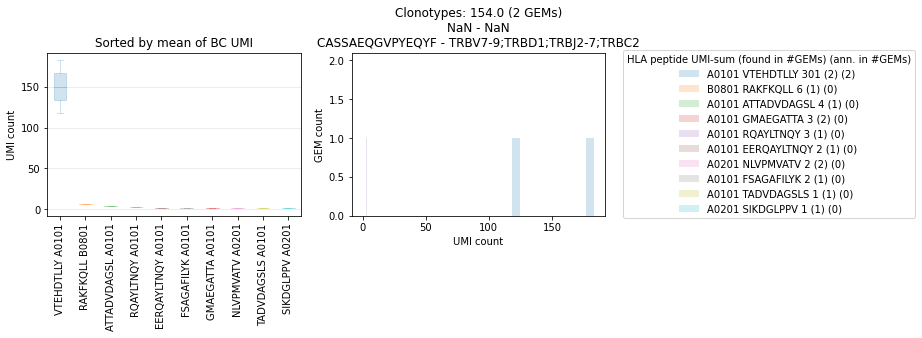

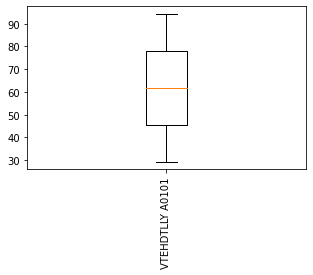

[112.]
('CASSDTGLAGYNEQFF', 'NaN') unresolved
          peptide      peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2337  MDMFSDEQLKV  ['MDMFSDEQLKV']               [1]                
2417    VTEHDTLLY    ['VTEHDTLLY']               [2]                

     genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
2337           NaN               NaN  CASSDTGLAGYNEQFF   
2417           NaN               NaN  CASSDTGLAGYNEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
2337  ['TRBV6-1;;TRBJ2-1;TRBC2']                11  
2417  ['TRBV6-1;;TRBJ2-1;TRBC2']                12  


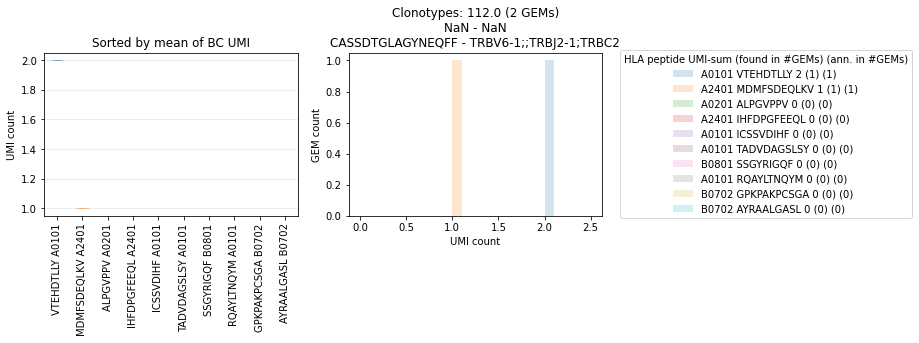

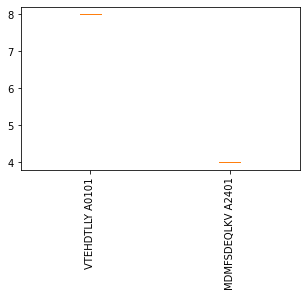

[70.]
('CASSDTSGSLGTQYF', 'CAARDSNYQLIW') unresolved
       peptide                              peptide_lst umi_count_lst_mhc  \
673   AMLIRDRL                             ['AMLIRDRL']               [1]   
1341  RAKFKQLL  ['SVDIHFDPGF' 'EERQAYLTNQY' 'RAKFKQLL']         [1, 1, 1]   

      cdr3_lst_TRA             genes_lst_TRA umi_count_lst_TRA  \
673   CAARDSNYQLIW  ['TRAV13-1;TRAJ33;TRAC']                 6   
1341  CAARDSNYQLIW  ['TRAV13-1;TRAJ33;TRAC']                 1   

         cdr3_lst_TRB             genes_lst_TRB umi_count_lst_TRB  
673   CASSDTSGSLGTQYF  ['TRBV9;;TRBJ2-3;TRBC2']                 7  
1341  CASSDTSGSLGTQYF  ['TRBV9;;TRBJ2-3;TRBC2']                 7  


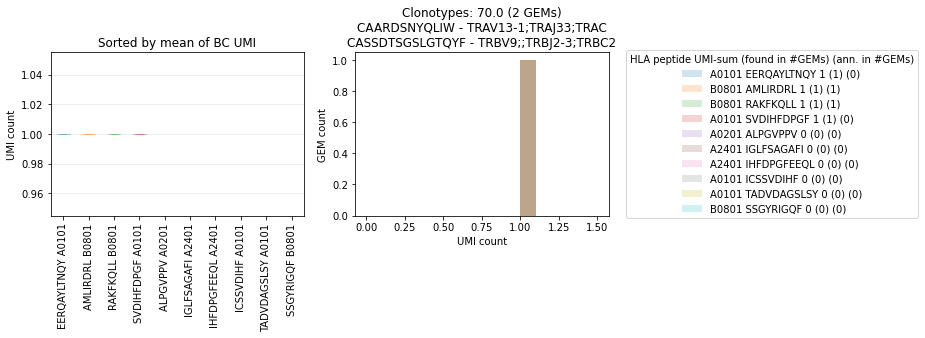

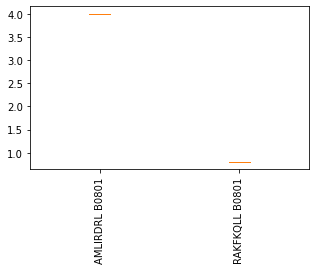

[547.]
('CASSEGRVRVDEQYF', 'CAVRGSVGKGFGNVLHC') unresolved
        peptide    peptide_lst umi_count_lst_mhc       cdr3_lst_TRA  \
1899  SSGYRIGQF  ['SSGYRIGQF']               [1]       CAERGGGFKTIF   
1899  SSGYRIGQF  ['SSGYRIGQF']               [1]  CAVRGSVGKGFGNVLHC   
1899  SSGYRIGQF  ['SSGYRIGQF']               [1]       CAERGGGFKTIF   
1899  SSGYRIGQF  ['SSGYRIGQF']               [1]  CAVRGSVGKGFGNVLHC   

                                   genes_lst_TRA umi_count_lst_TRA  \
1899  ['TRAV5;TRAJ9;TRAC' 'TRAV1-2;TRAJ35;TRAC']                 4   
1899  ['TRAV5;TRAJ9;TRAC' 'TRAV1-2;TRAJ35;TRAC']                 4   
1899  ['TRAV5;TRAJ9;TRAC' 'TRAV1-2;TRAJ35;TRAC']                 4   
1899  ['TRAV5;TRAJ9;TRAC' 'TRAV1-2;TRAJ35;TRAC']                 4   

         cdr3_lst_TRB             genes_lst_TRB umi_count_lst_TRB  
1899  CASSEGRVRVDEQYF  ['TRBV2;;TRBJ2-7;TRBC2']                 4  
1899  CASSEGRVRVDEQYF  ['TRBV2;;TRBJ2-7;TRBC2']                 4  
1899  CASSEGRVRVDEQYF  ['TRBV2

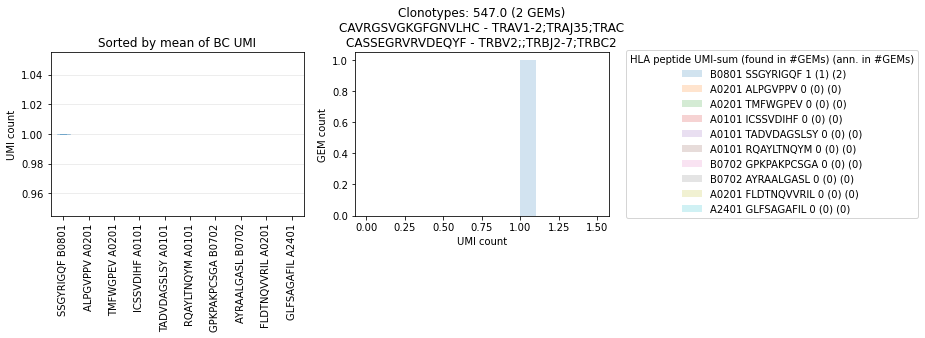

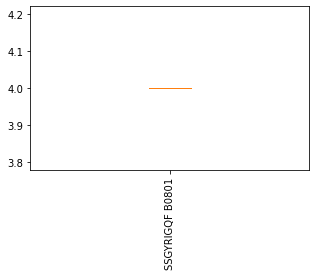

[138.]
('CASSETGNPTYEQYF', 'CAARVDYKLSF') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
121    RAKFKQLL   ['RAKFKQLL']               [1]  CAARVDYKLSF   
1280  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAARVDYKLSF   

                   genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
121   ['TRAV29/DV5;TRAJ20;TRAC']                 1  CASSETGNPTYEQYF   
1280  ['TRAV29/DV5;TRAJ20;TRAC']                 5  CASSETGNPTYEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
121   ['TRBV7-3;;TRBJ2-7;TRBC2']                15  
1280  ['TRBV7-3;;TRBJ2-7;TRBC2']                17  


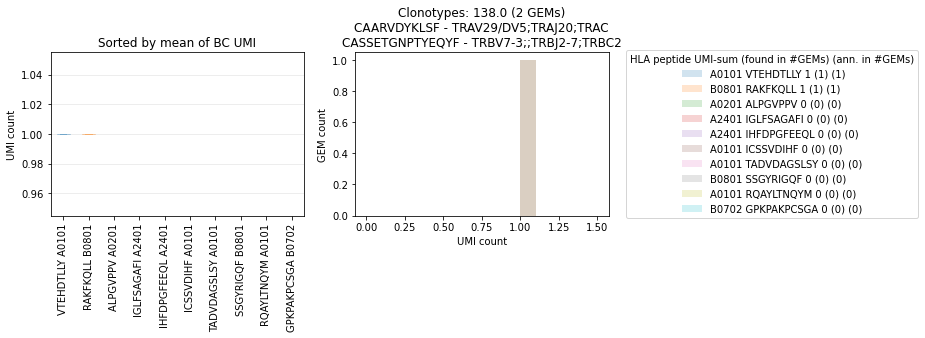

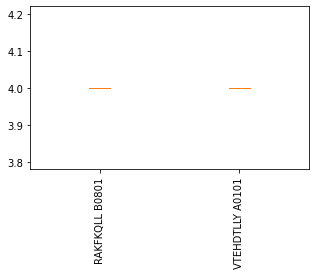

[124.]
('CASSFGGIEAFF', 'CALSEGQTGANNLFF') unresolved
          peptide                peptide_lst umi_count_lst_mhc  \
312     VTEHDTLLY  ['NLVPMVATV' 'VTEHDTLLY']            [1, 2]   
1866  EERQAYLTNQY            ['EERQAYLTNQY']               [1]   

         cdr3_lst_TRA           genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
312   CALSEGQTGANNLFF  ['TRAV19;TRAJ36;TRAC']                20  CASSFGGIEAFF   
1866  CALSEGQTGANNLFF  ['TRAV19;TRAJ36;TRAC']                 3  CASSFGGIEAFF   

                  genes_lst_TRB umi_count_lst_TRB  
312   ['TRBV14;;TRBJ1-1;TRBC1']                29  
1866  ['TRBV14;;TRBJ1-1;TRBC1']                 8  


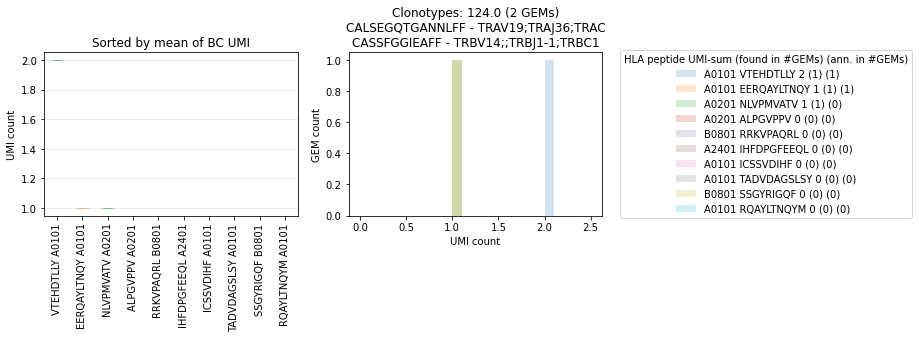

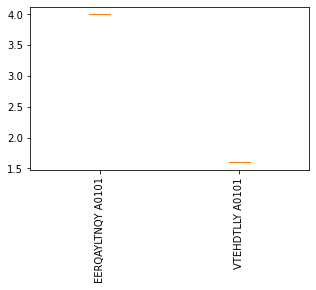

[92.]
('CASSFRTVSSYEQYF', 'NaN') unresolved
          peptide                peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2097  EERQAYLTNQY            ['EERQAYLTNQY']               [1]                
2101   TPRVTGGGAM  ['GPFPGNLV' 'TPRVTGGGAM']           [2, 55]                

     genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2097           NaN               NaN  CASSFRTVSSYEQYF   
2101           NaN               NaN  CASSFRTVSSYEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
2097  ['TRBV7-8;;TRBJ2-7;TRBC2']                12  
2101  ['TRBV7-8;;TRBJ2-7;TRBC2']                17  


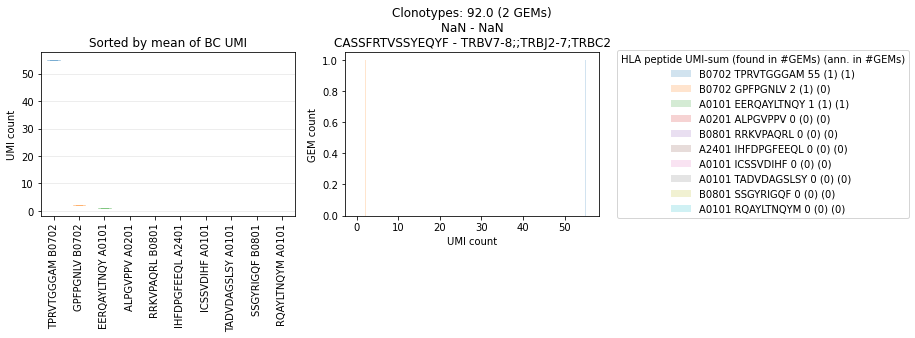

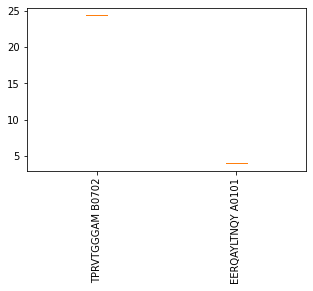

[76.]
('CASSFVYNEQFF', 'CAETEGTALIF') unresolved
         peptide                  peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
669  EERQAYLTNQY  ['VTEHDTLLY' 'EERQAYLTNQY']            [1, 1]  CAETEGTALIF   
817    VTEHDTLLY                ['VTEHDTLLY']               [2]  CAETEGTALIF   

             genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
669  ['TRAV5;TRAJ15;TRAC']                 3  CASSFVYNEQFF   
817  ['TRAV5;TRAJ15;TRAC']                 3  CASSFVYNEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
669  ['TRBV11-2;;TRBJ2-1;TRBC2']                14  
817  ['TRBV11-2;;TRBJ2-1;TRBC2']                16  


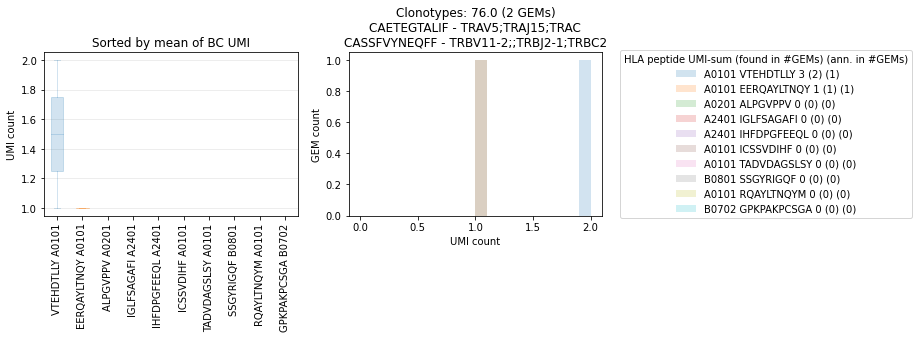

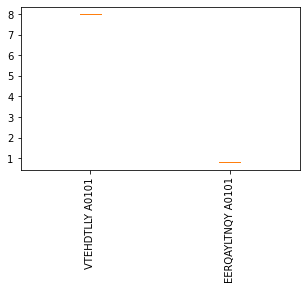

[170.]
('CASSIGDVLEQETQYF', 'CAMRPFNDYKLSF') unresolved
       peptide   peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
668   CSSVDIHF  ['CSSVDIHF']               [1]  CAMRPFNDYKLSF   
1593  RAKFKQLL  ['RAKFKQLL']               [1]  CAMRPFNDYKLSF   

                   genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
668   ['TRAV14/DV4;TRAJ20;TRAC']                 3  CASSIGDVLEQETQYF   
1593  ['TRAV14/DV4;TRAJ20;TRAC']                 6  CASSIGDVLEQETQYF   

                  genes_lst_TRB umi_count_lst_TRB  
668   ['TRBV19;;TRBJ2-5;TRBC2']                 9  
1593  ['TRBV19;;TRBJ2-5;TRBC2']                11  


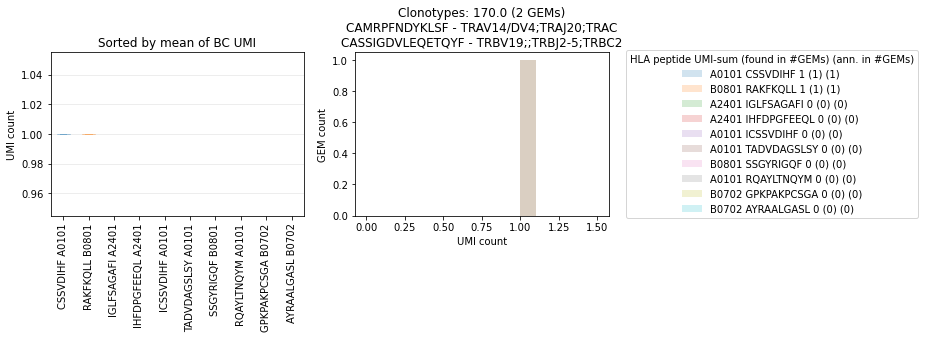

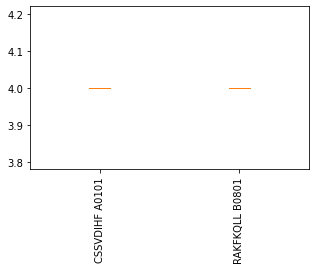

[653.]
('CASSKGPQLSTSGELFF', 'CAGCTGTASKLTF') unresolved
        peptide               peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
1992  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']           [1, 35]  CAARSGGYQKVTF   
1992  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']           [1, 35]  CAGCTGTASKLTF   
1992  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']           [1, 35]  CAARSGGYQKVTF   
1992  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']           [1, 35]  CAGCTGTASKLTF   

                                    genes_lst_TRA umi_count_lst_TRA  \
1992  ['TRAV21;TRAJ13;TRAC' 'TRAV21;TRAJ44;TRAC']                 1   
1992  ['TRAV21;TRAJ13;TRAC' 'TRAV21;TRAJ44;TRAC']                 1   
1992  ['TRAV21;TRAJ13;TRAC' 'TRAV21;TRAJ44;TRAC']                 1   
1992  ['TRAV21;TRAJ13;TRAC' 'TRAV21;TRAJ44;TRAC']                 1   

           cdr3_lst_TRB             genes_lst_TRB umi_count_lst_TRB  
1992  CASSKGPQLSTSGELFF  ['TRBV9;;TRBJ2-2;TRBC2']                 1  
1992  CASSKGPQLSTSGELFF  ['TRBV9;;TRBJ2-2;TRBC2']       

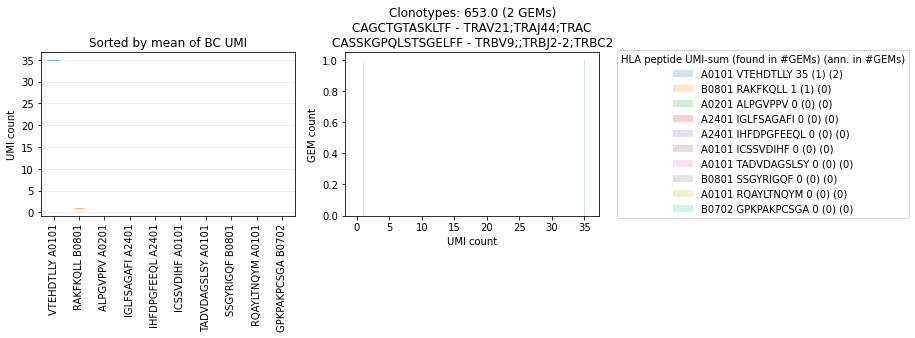

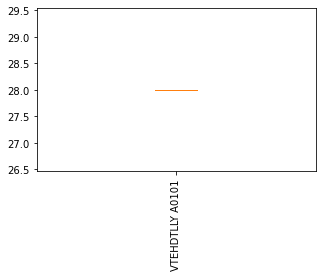

[149.]
('CASSLEASASPYEQYF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2284  VTEHDTLLY             ['ATTADVDAGSL' 'RAKFKQLL' 'VTEHDTLLY']   
2345  VTEHDTLLY  ['RQAYLTNQY' 'GMAEGATTA' 'YPLVKMRLSV' 'ATTADVD...   

                        umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2284                           [1, 1, 76]                        NaN   
2345  [1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 152]                        NaN   

     umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
2284               NaN  CASSLEASASPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']   
2345               NaN  CASSLEASASPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
2284                 2  
2345                16  


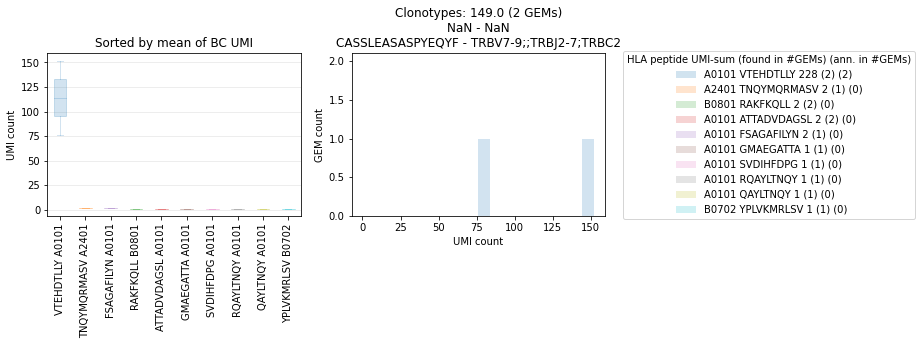

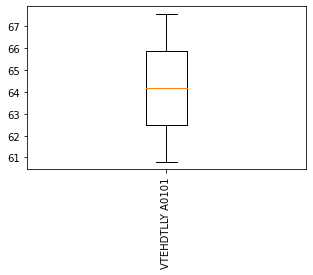

[114.]
('CASSLEASGHPYEQYF', 'CAARPGADKLIF') unresolved
        peptide                             peptide_lst umi_count_lst_mhc  \
764   VTEHDTLLY                           ['VTEHDTLLY']               [1]   
1482  VTEHDTLLY  ['NLVPMVATV' 'FSAGAFILYN' 'VTEHDTLLY']        [1, 1, 36]   

      cdr3_lst_TRA               genes_lst_TRA umi_count_lst_TRA  \
764   CAARPGADKLIF  ['TRAV29/DV5;TRAJ34;TRAC']                 1   
1482  CAARPGADKLIF  ['TRAV29/DV5;TRAJ34;TRAC']                 1   

          cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
764   CASSLEASGHPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']                 8  
1482  CASSLEASGHPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']                 9  


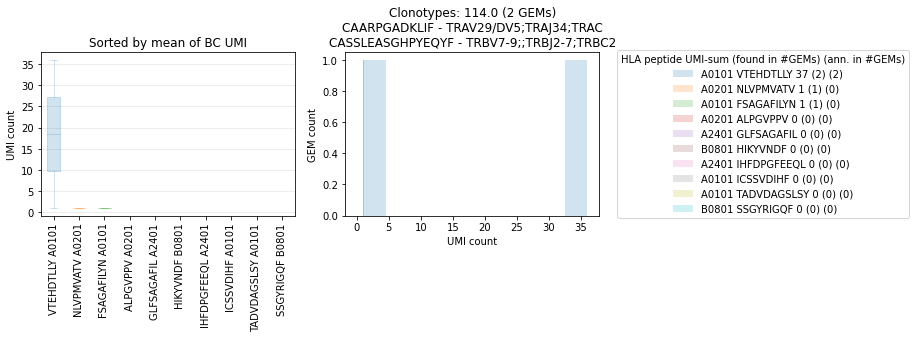

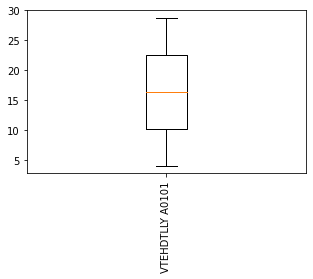

[162.]
('CASSLEGGDRPYEQYF', 'CAARPGAQKLVF') unresolved
        peptide                                        peptide_lst  \
346   VTEHDTLLY  ['RQAYLTNQY' 'EERQAYLTNQY' 'QAYLTNQY' 'FSAGAFI...   
1851  VTEHDTLLY  ['AMLIRDRL' 'FSAGAFILYN' 'RQAYLTNQY' 'AALPGVPP...   

           umi_count_lst_mhc  cdr3_lst_TRA               genes_lst_TRA  \
346   [1, 1, 1, 1, 2, 3, 93]  CAARPGAQKLVF  ['TRAV29/DV5;TRAJ54;TRAC']   
1851  [1, 1, 1, 1, 2, 2, 42]  CAARPGAQKLVF  ['TRAV29/DV5;TRAJ54;TRAC']   

     umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
346                  3  CASSLEGGDRPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']   
1851                 1  CASSLEGGDRPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
346                 24  
1851                11  


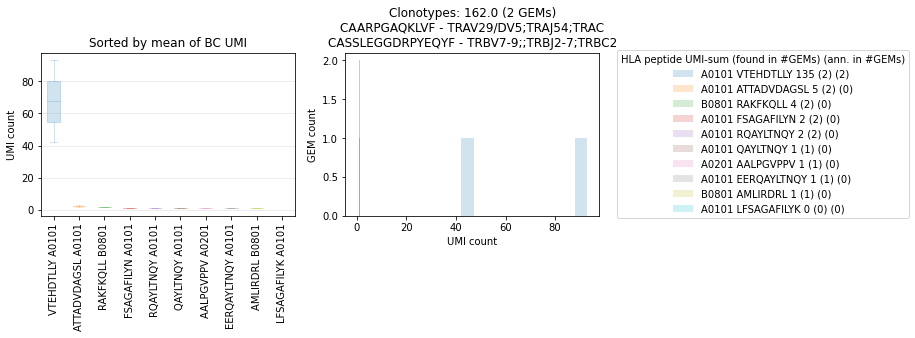

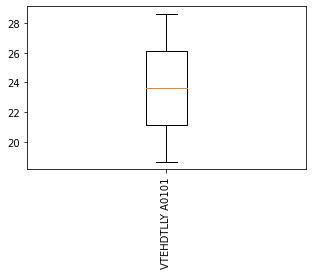

[62.]
('CASSLGGEPGELFF', 'NaN') unresolved
         peptide                                        peptide_lst  \
2173  TPRVTGGGAM  ['FSAGAFILYK' 'EERQAYLTNQY' 'TADVDAGSLS' 'VTEH...   
2409    RAKFKQLL                                       ['RAKFKQLL']   

           umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2173  [1, 1, 1, 3, 3, 4, 49]                        NaN               NaN   
2409                     [1]                        NaN               NaN   

        cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
2173  CASSLGGEPGELFF  ['TRBV27;;TRBJ2-2;TRBC2']                12  
2409  CASSLGGEPGELFF  ['TRBV27;;TRBJ2-2;TRBC2']                11  


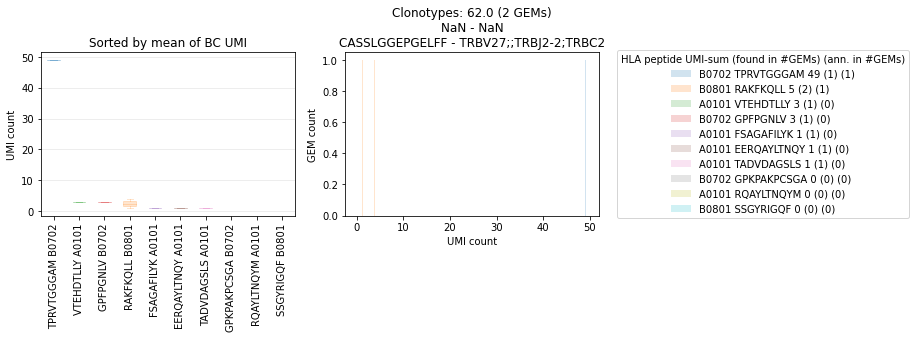

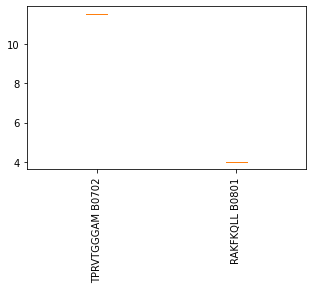

[440.]
('CASSLGGSPYEQYF', 'CAPLGDAGKSTF') unresolved
       peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
520  SVDIHFDPG  ['SVDIHFDPG']               [1]  CAAQTSGSARQLTF   
520  SVDIHFDPG  ['SVDIHFDPG']               [1]    CAPLGDAGKSTF   
520  SVDIHFDPG  ['SVDIHFDPG']               [1]  CAAQTSGSARQLTF   
520  SVDIHFDPG  ['SVDIHFDPG']               [1]    CAPLGDAGKSTF   

                                       genes_lst_TRA umi_count_lst_TRA  \
520  ['TRAV13-1;TRAJ22;TRAC' 'TRAV13-1;TRAJ27;TRAC']                 1   
520  ['TRAV13-1;TRAJ22;TRAC' 'TRAV13-1;TRAJ27;TRAC']                 1   
520  ['TRAV13-1;TRAJ22;TRAC' 'TRAV13-1;TRAJ27;TRAC']                 1   
520  ['TRAV13-1;TRAJ22;TRAC' 'TRAV13-1;TRAJ27;TRAC']                 1   

       cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
520  CASSLGGSPYEQYF  ['TRBV27;;TRBJ2-7;TRBC2']                 3  
520  CASSLGGSPYEQYF  ['TRBV27;;TRBJ2-7;TRBC2']                 3  
520  CASSLGGSPYEQYF  ['TRBV27;;TRBJ2-7;

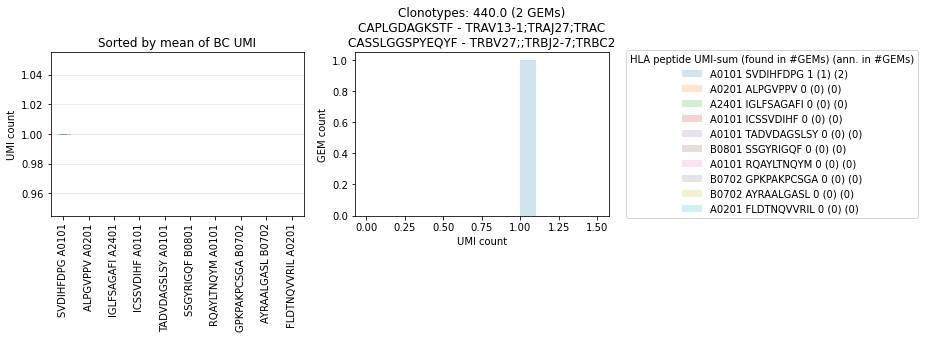

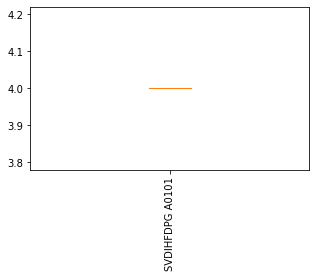

[50.]
('CASSLGIHYEQYF', 'NaN') resolved by trash bin
         peptide                                        peptide_lst  \
2169   VTEHDTLLY                                      ['VTEHDTLLY']   
2220  GPFPGNLVDV  ['GPKPAKPCS' 'VTEHDTLLY' 'PSTPLKPL' 'WPRAPRGQ'...   

       umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2169                 [1]                        NaN               NaN   
2220  [1, 1, 2, 4, 5, 6]                        NaN               NaN   

       cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
2169  CASSLGIHYEQYF  ['TRBV28;;TRBJ2-7;TRBC2']                 7  
2220  CASSLGIHYEQYF  ['TRBV28;;TRBJ2-7;TRBC2']                12  


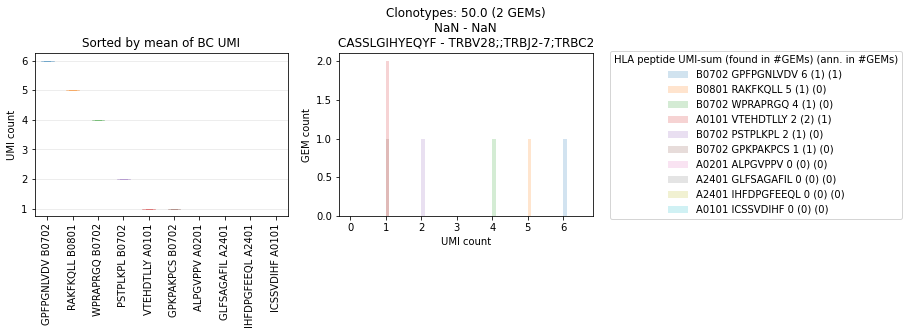

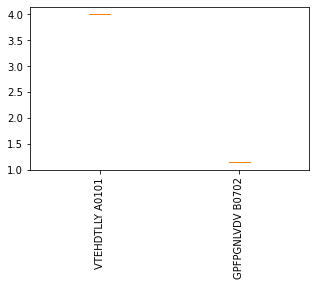

[621.]
('CASSLGSGTHTLHF', 'CARLRYNNNDMRF') unresolved
          peptide                  peptide_lst umi_count_lst_mhc  \
1951  TNQYMQRMASV  ['VTEHDTLLY' 'TNQYMQRMASV']            [1, 6]   
1951  TNQYMQRMASV  ['VTEHDTLLY' 'TNQYMQRMASV']            [1, 6]   
1951  TNQYMQRMASV  ['VTEHDTLLY' 'TNQYMQRMASV']            [1, 6]   
1951  TNQYMQRMASV  ['VTEHDTLLY' 'TNQYMQRMASV']            [1, 6]   

        cdr3_lst_TRA                                      genes_lst_TRA  \
1951  CAMRGILTGNQFYF  ['TRAV14/DV4;TRAJ49;TRAC' 'TRAV38-1;TRAJ43;TRAC']   
1951   CARLRYNNNDMRF  ['TRAV14/DV4;TRAJ49;TRAC' 'TRAV38-1;TRAJ43;TRAC']   
1951  CAMRGILTGNQFYF  ['TRAV14/DV4;TRAJ49;TRAC' 'TRAV38-1;TRAJ43;TRAC']   
1951   CARLRYNNNDMRF  ['TRAV14/DV4;TRAJ49;TRAC' 'TRAV38-1;TRAJ43;TRAC']   

     umi_count_lst_TRA    cdr3_lst_TRB               genes_lst_TRB  \
1951                 3  CASSLGSGTHTLHF  ['TRBV7-9;;TRBJ1-6;TRBC1']   
1951                 3  CASSLGSGTHTLHF  ['TRBV7-9;;TRBJ1-6;TRBC1']   
1951               

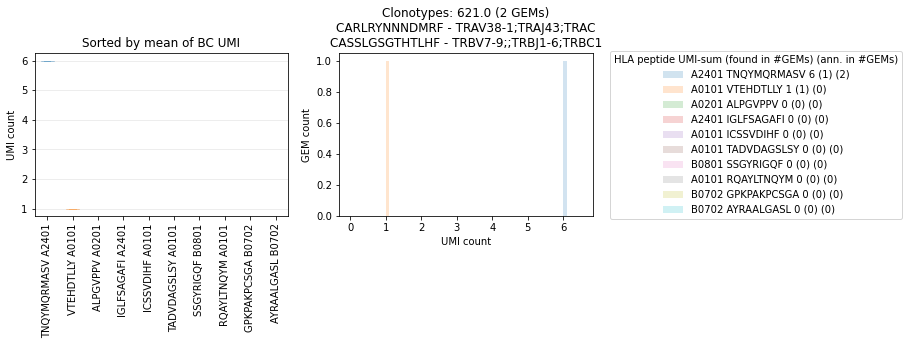

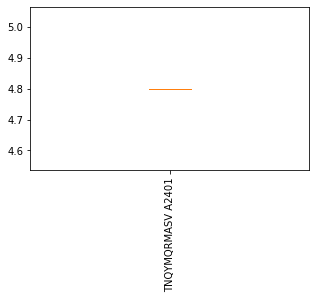

[38.]
('CASSLIGQGLGDEQFF', 'NaN') unresolved
         peptide               peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2099    RAKFKQLL  ['VTEHDTLLY' 'RAKFKQLL']            [1, 1]                
2311  TPRVTGGGAM            ['TPRVTGGGAM']               [1]                

     genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
2099           NaN               NaN  CASSLIGQGLGDEQFF   
2311           NaN               NaN  CASSLIGQGLGDEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
2099  ['TRBV7-9;;TRBJ2-1;TRBC2']                 5  
2311  ['TRBV7-9;;TRBJ2-1;TRBC2']                 4  


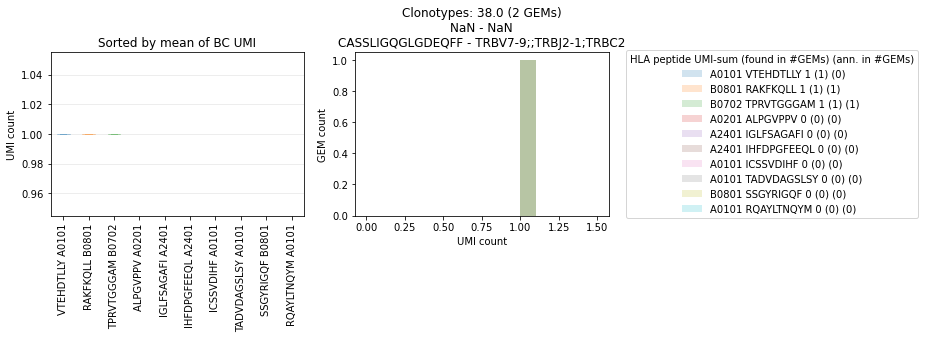

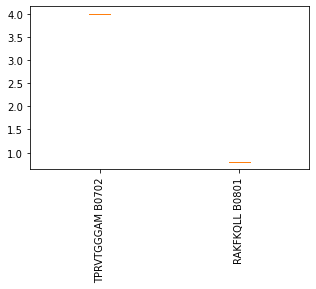

[45.]
('CASSLIGVSSYNEQFF', 'CATVTRMDSSYKLIF') unresolved
         peptide                                       peptide_lst  \
73    TPRVTGGGAM  ['GPFPGNLV' 'KPLFQNDF' 'VTEHDTLLY' 'TPRVTGGGAM']   
1711   VTEHDTLLY                                     ['VTEHDTLLY']   

     umi_count_lst_mhc     cdr3_lst_TRA           genes_lst_TRA  \
73       [1, 1, 1, 29]  CATVTRMDSSYKLIF  ['TRAV17;TRAJ12;TRAC']   
1711               [1]  CATVTRMDSSYKLIF  ['TRAV17;TRAJ12;TRAC']   

     umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
73                   1  CASSLIGVSSYNEQFF  ['TRBV7-9;;TRBJ2-1;TRBC2']   
1711                 2  CASSLIGVSSYNEQFF  ['TRBV7-9;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
73                  14  
1711                11  


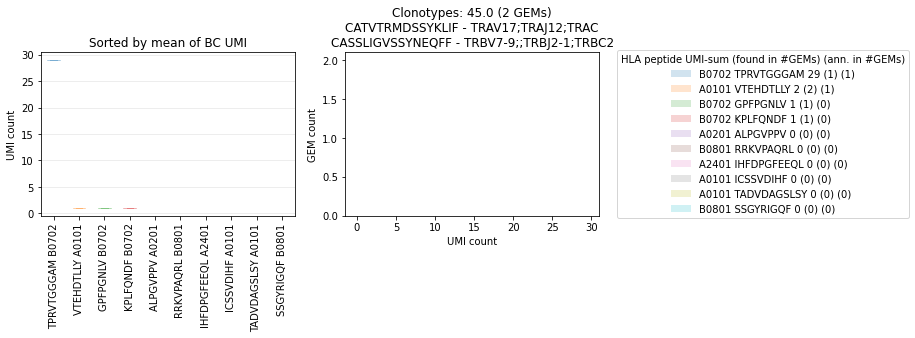

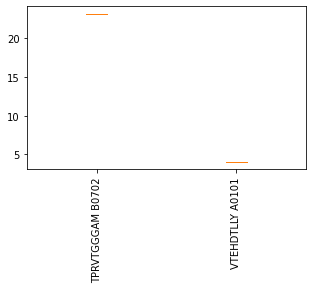

[60.]
('CASSLIGVSSYNEQFF', 'NaN') unresolved
         peptide                                        peptide_lst  \
2130  TPRVTGGGAM                          ['RAKFKQLL' 'TPRVTGGGAM']   
2300  TPRVTGGGAM  ['VTEHDTLLY' 'GPKPAKPCS' 'KPLFQNDF' 'RAKFKQLL'...   

                  umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2130                         [1, 4]                        NaN   
2300  [1, 1, 1, 1, 1, 3, 4, 5, 110]                        NaN   

     umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
2130               NaN  CASSLIGVSSYNEQFF  ['TRBV7-9;;TRBJ2-1;TRBC2']   
2300               NaN  CASSLIGVSSYNEQFF  ['TRBV7-9;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2130                 4  
2300                14  


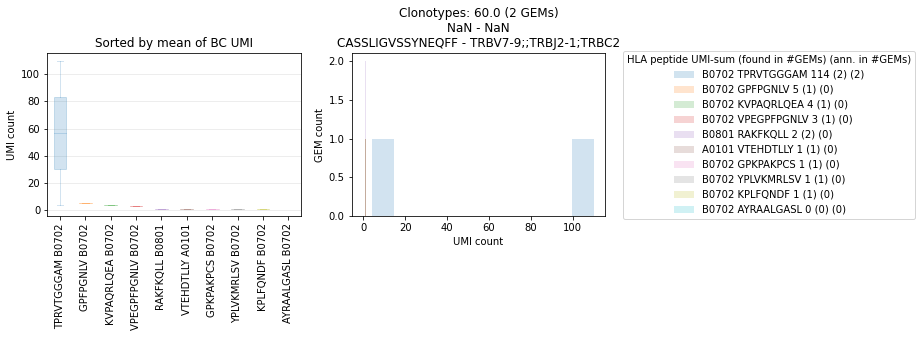

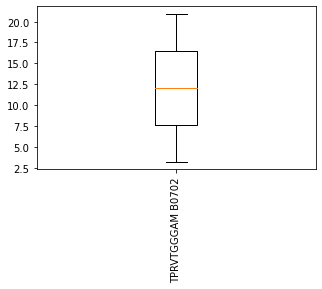

[147.]
('CASSLLQGARTEAFF', 'CAMREGRDSSYKLIF') unresolved
         peptide                                        peptide_lst  \
324   TPRVTGGGAM  ['GPFPGNLV' 'KVPAQRLQEA' 'YPLVKMRLSV' 'TADVDAG...   
1199    RAKFKQLL                                       ['RAKFKQLL']   

        umi_count_lst_mhc     cdr3_lst_TRA               genes_lst_TRA  \
324   [1, 1, 1, 1, 1, 28]  CAMREGRDSSYKLIF  ['TRAV14/DV4;TRAJ12;TRAC']   
1199                  [1]  CAMREGRDSSYKLIF  ['TRAV14/DV4;TRAJ12;TRAC']   

     umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
324                  5  CASSLLQGARTEAFF  ['TRBV7-9;;TRBJ1-1;TRBC1']   
1199                 2  CASSLLQGARTEAFF  ['TRBV7-9;;TRBJ1-1;TRBC1']   

     umi_count_lst_TRB  
324                 13  
1199                 3  


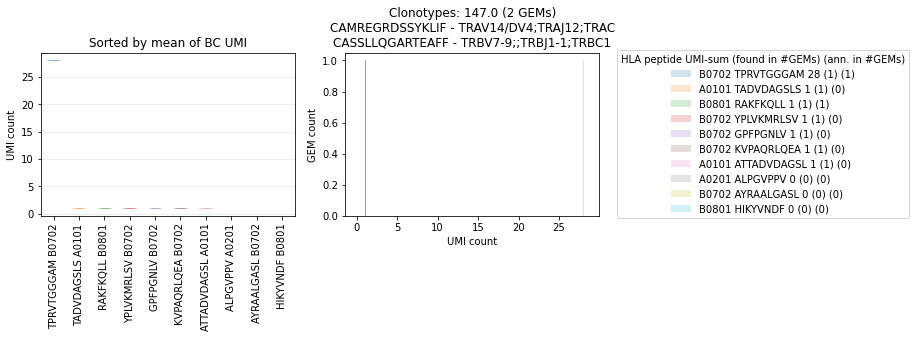

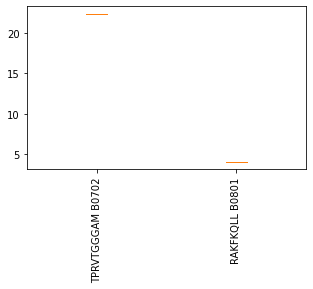

[150.]
('CASSLRDRGLYEQYF', 'CLVGDGPLGSGNTGKLIF') unresolved
        peptide    peptide_lst umi_count_lst_mhc        cdr3_lst_TRA  \
363   VTEHDTLLY  ['VTEHDTLLY']               [2]  CLVGDGPLGSGNTGKLIF   
1598  ILKEPVHGV  ['ILKEPVHGV']               [1]  CLVGDGPLGSGNTGKLIF   

              genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
363   ['TRAV4;TRAJ37;TRAC']                 3  CASSLRDRGLYEQYF   
1598  ['TRAV4;TRAJ37;TRAC']                 1  CASSLRDRGLYEQYF   

                         genes_lst_TRB umi_count_lst_TRB  
363   ['TRBV11-2;TRBD1;TRBJ2-7;TRBC2']                 2  
1598  ['TRBV11-2;TRBD1;TRBJ2-7;TRBC2']                 9  


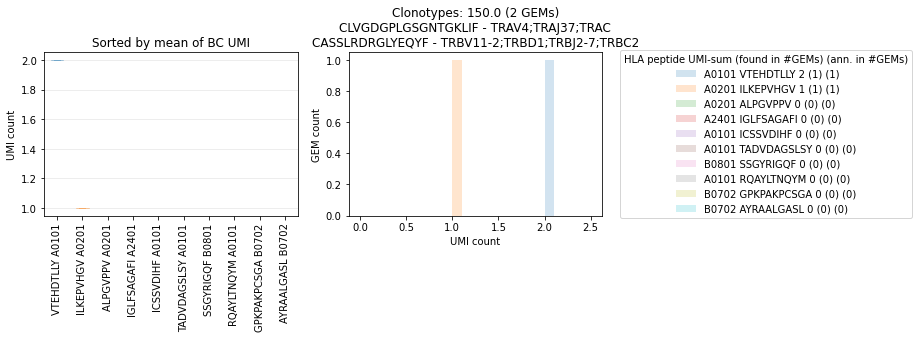

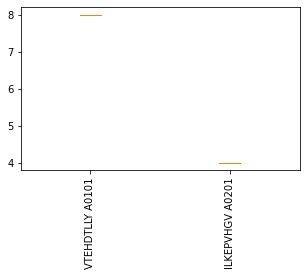

[95.]
('CASSLRGVYNEQFF', 'CAVHMEYGNKLVF') unresolved
        peptide    peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
435   VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVHMEYGNKLVF   
1086   RAKFKQLL   ['RAKFKQLL']               [2]  CAVHMEYGNKLVF   

               genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
435   ['TRAV21;TRAJ47;TRAC']                 1  CASSLRGVYNEQFF   
1086  ['TRAV21;TRAJ47;TRAC']                11  CASSLRGVYNEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
435   ['TRBV7-3;;TRBJ2-1;TRBC2']                11  
1086  ['TRBV7-3;;TRBJ2-1;TRBC2']                10  


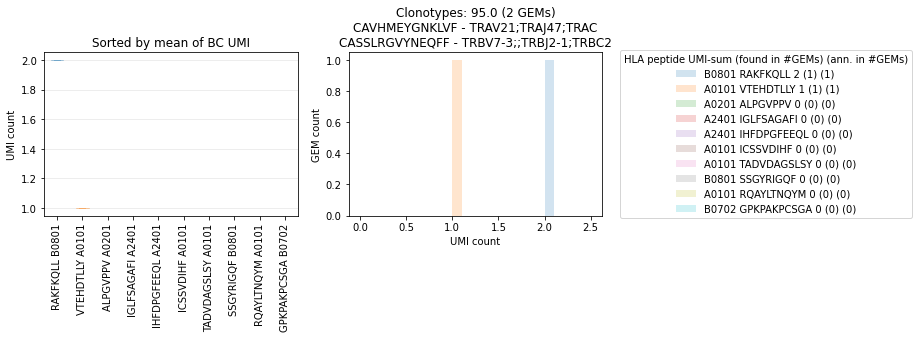

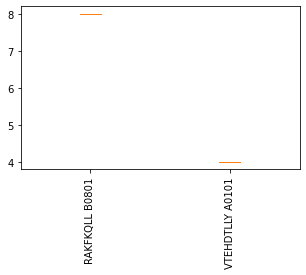

[94.]
('CASSNLDRGAGELFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2183  VTEHDTLLY  ['VTEHDTLLY']               [2]                        NaN   
2203   RAKFKQLL   ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB                    genes_lst_TRB  \
2183               NaN  CASSNLDRGAGELFF  ['TRBV7-9;TRBD1;TRBJ2-2;TRBC2']   
2203               NaN  CASSNLDRGAGELFF  ['TRBV7-9;TRBD1;TRBJ2-2;TRBC2']   

     umi_count_lst_TRB  
2183                10  
2203                 8  


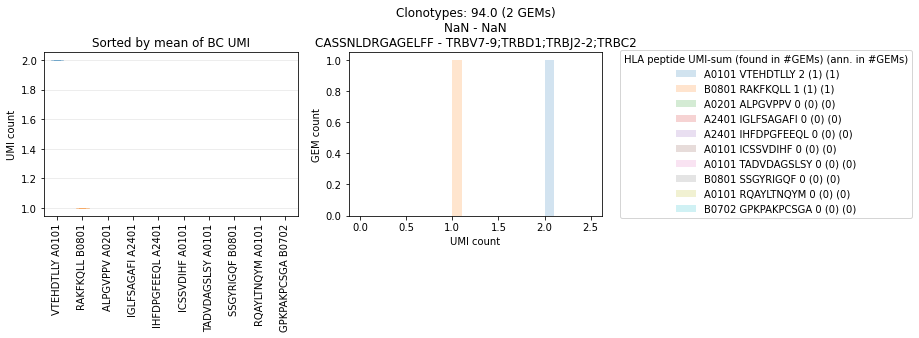

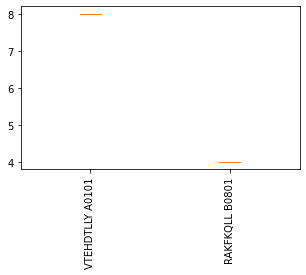

[169.]
('CASSPMGGVTGELFF', 'CAVDIETSGSRLTF') unresolved
        peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
37    VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVDIETSGSRLTF   
1107  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVDIETSGSRLTF   

               genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
37    ['TRAV39;TRAJ58;TRAC']                 4  CASSPMGGVTGELFF   
1107  ['TRAV39;TRAJ58;TRAC']                 2  CASSPMGGVTGELFF   

                 genes_lst_TRB umi_count_lst_TRB  
37    ['TRBV9;;TRBJ2-2;TRBC2']                 4  
1107  ['TRBV9;;TRBJ2-2;TRBC2']                 8  


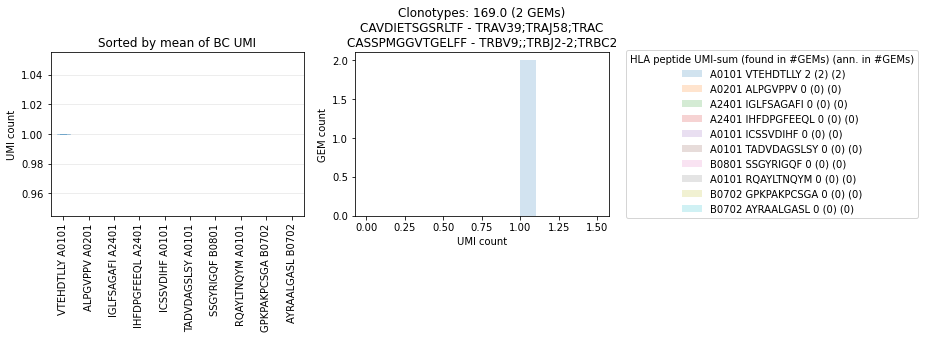

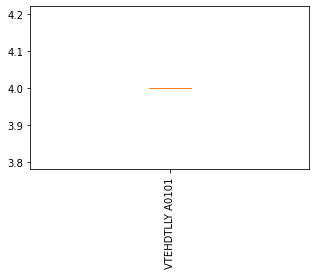

[52.]
('CASSPSDALVSEQYF', 'NaN') unresolved
         peptide               peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2269   VTEHDTLLY  ['LFSAGAFI' 'VTEHDTLLY']            [1, 2]                
2410  FLVNTMCLAL            ['FLVNTMCLAL']               [1]                

     genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2269           NaN               NaN  CASSPSDALVSEQYF   
2410           NaN               NaN  CASSPSDALVSEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
2269  ['TRBV7-9;;TRBJ2-7;TRBC2']                12  
2410  ['TRBV7-9;;TRBJ2-7;TRBC2']                 8  


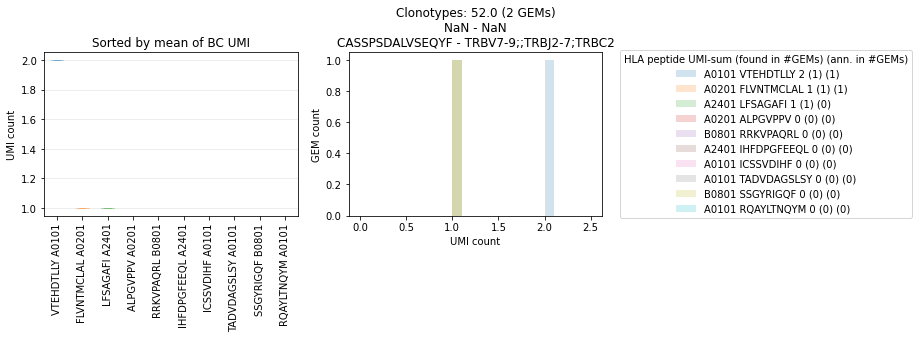

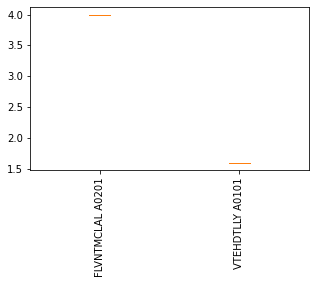

[164.]
('CASSQAAYGSYEQYF', 'CAYRGDFNKFYF') unresolved
       peptide                                        peptide_lst  \
1423  RAKFKQLL  ['HTGEKHYAC' 'NLVPMVATV' 'IRHKRQSWV' 'VIRHKRQS...   
1528  RAKFKQLL  ['MDMFSDEQLKV' 'HTGEKHYAC' 'ILKEPVHGV' 'AMLIRD...   

               umi_count_lst_mhc  cdr3_lst_TRA                 genes_lst_TRA  \
1423  [1, 1, 1, 2, 3, 4, 5, 134]  CAYRGDFNKFYF  ['TRAV38-2/DV8;TRAJ21;TRAC']   
1528  [1, 1, 1, 1, 2, 2, 8, 122]  CAYRGDFNKFYF  ['TRAV38-2/DV8;TRAJ21;TRAC']   

     umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
1423                 5  CASSQAAYGSYEQYF  ['TRBV4-1;;TRBJ2-7;TRBC2']   
1528                 1  CASSQAAYGSYEQYF  ['TRBV4-1;;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
1423                 4  
1528                 9  


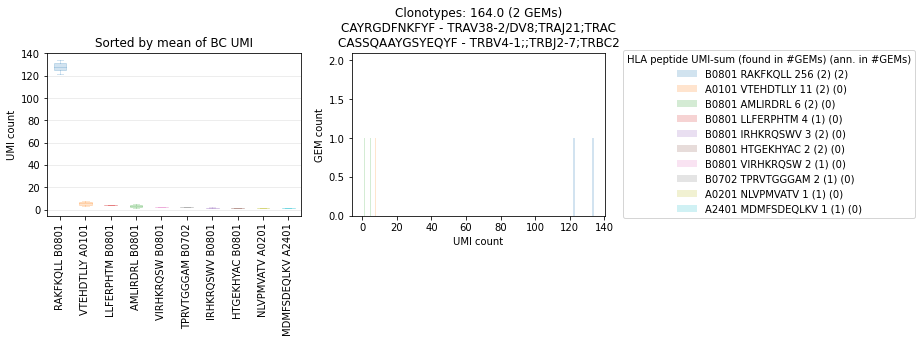

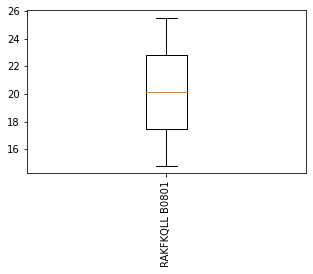

[157.]
('CASSSGAGPTYEQYF', 'CAVRFMLGNQFYF') unresolved
        peptide                                        peptide_lst  \
302   VTEHDTLLY  ['FSAGAFILYN' 'TNQYMQRMASV' 'ATTADVDAGSL' 'VTE...   
513  FSAGAFILYK  ['FLDTNQVVRI' 'EERQAYLTNQY' 'VTEHDTLLY' 'RAKFK...   

    umi_count_lst_mhc   cdr3_lst_TRA           genes_lst_TRA  \
302     [1, 1, 1, 30]  CAVRFMLGNQFYF  ['TRAV41;TRAJ49;TRAC']   
513  [1, 1, 2, 2, 26]  CAVRFMLGNQFYF  ['TRAV41;TRAJ49;TRAC']   

    umi_count_lst_TRA     cdr3_lst_TRB             genes_lst_TRB  \
302                 2  CASSSGAGPTYEQYF  ['TRBV9;;TRBJ2-7;TRBC2']   
513                 2  CASSSGAGPTYEQYF  ['TRBV9;;TRBJ2-7;TRBC2']   

    umi_count_lst_TRB  
302                 4  
513                 7  


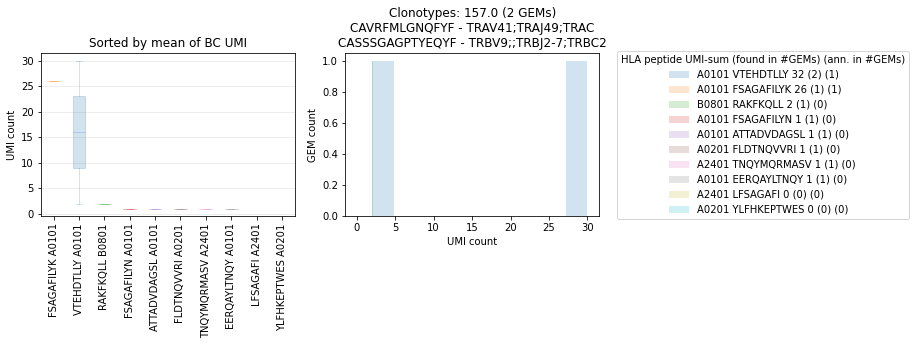

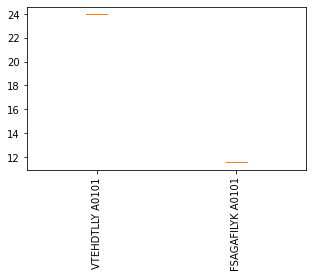

[118.]
('CASSSRPGPPSSYEQYF', 'CAEQEGGSYIPTF') unresolved
       peptide                                        peptide_lst  \
661   RAKFKQLL  ['LLFERPHTM' 'HTGEKHYAC' 'VTEHDTLLY' 'AMLIRDRL...   
1453  RAKFKQLL             ['VTEHDTLLY' 'TNQYMQRMASV' 'RAKFKQLL']   

     umi_count_lst_mhc   cdr3_lst_TRA         genes_lst_TRA umi_count_lst_TRA  \
661   [1, 1, 1, 2, 71]  CAEQEGGSYIPTF  ['TRAV5;TRAJ6;TRAC']                 3   
1453         [1, 1, 1]  CAEQEGGSYIPTF  ['TRAV5;TRAJ6;TRAC']                 5   

           cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
661   CASSSRPGPPSSYEQYF  ['TRBV27;;TRBJ2-7;TRBC2']                 9  
1453  CASSSRPGPPSSYEQYF  ['TRBV27;;TRBJ2-7;TRBC2']                 2  


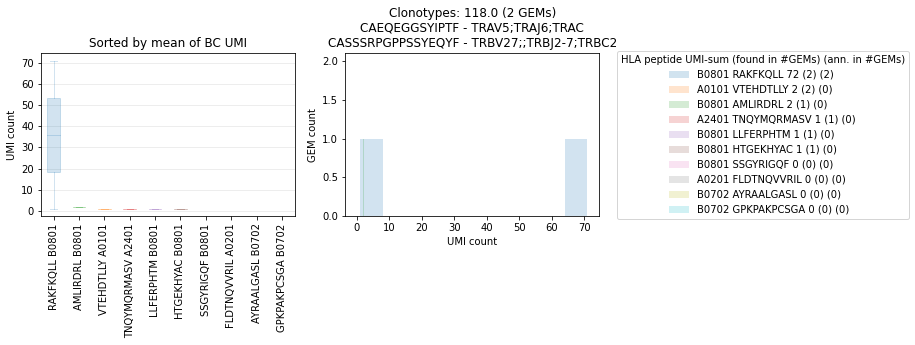

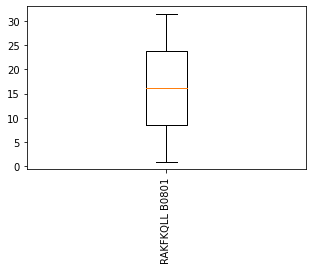

[78.]
('CASSSVNEQYF', 'CAVRDTDARLMF') unresolved
        peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
672    RAKFKQLL   ['RAKFKQLL']               [1]  CAVRDTDARLMF   
1166  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVRDTDARLMF   

              genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB  \
672   ['TRAV3;TRAJ31;TRAC']                 1  CASSSVNEQYF   
1166  ['TRAV3;TRAJ31;TRAC']                 7  CASSSVNEQYF   

                    genes_lst_TRB umi_count_lst_TRB  
672   ['TRBV12-4;;TRBJ2-7;TRBC2']                 4  
1166  ['TRBV12-4;;TRBJ2-7;TRBC2']                 7  


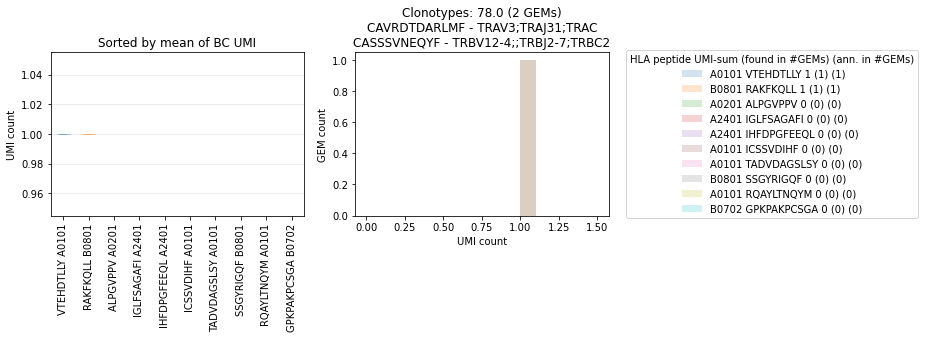

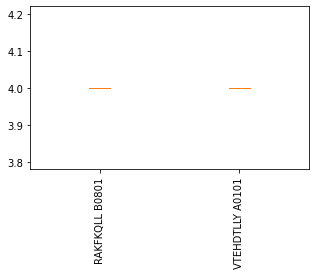

[136.]
('CASSTRDRGSYEQYF', 'CATEGRMDSSYKLIF') unresolved
        peptide                                        peptide_lst  \
291  FSAGAFILYK  ['GLFSAGAFIL' 'RAKFKQLL' 'LTNQYMQRM' 'FSAGAFIL...   
963  TPRVTGGGAM                                     ['TPRVTGGGAM']   

    umi_count_lst_mhc     cdr3_lst_TRA           genes_lst_TRA  \
291     [1, 1, 1, 39]  CATEGRMDSSYKLIF  ['TRAV17;TRAJ12;TRAC']   
963               [1]  CATEGRMDSSYKLIF      ['TRAV17;TRAJ12;']   

    umi_count_lst_TRA     cdr3_lst_TRB                    genes_lst_TRB  \
291                 3  CASSTRDRGSYEQYF  ['TRBV7-9;TRBD1;TRBJ2-7;TRBC2']   
963                 1  CASSTRDRGSYEQYF  ['TRBV7-9;TRBD1;TRBJ2-7;TRBC2']   

    umi_count_lst_TRB  
291                 5  
963                10  


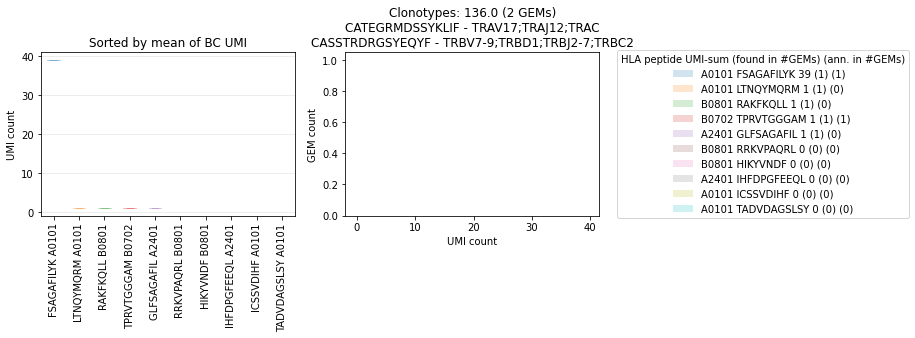

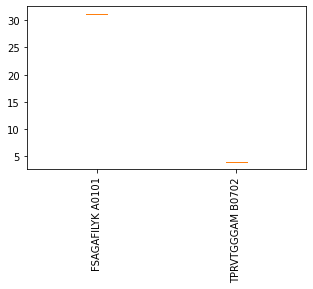

[171.]
('CASSVIPRAGGNTGELFF', 'CAVTGISSGSARQLTF') unresolved
     peptide                 peptide_lst umi_count_lst_mhc       cdr3_lst_TRA  \
28  RAKFKQLL  ['EERQAYLTNQY' 'RAKFKQLL']            [1, 1]  CAVSFLGDTGTASKLTF   
28  RAKFKQLL  ['EERQAYLTNQY' 'RAKFKQLL']            [1, 1]   CAVTGISSGSARQLTF   
28  RAKFKQLL  ['EERQAYLTNQY' 'RAKFKQLL']            [1, 1]  CAVSFLGDTGTASKLTF   
28  RAKFKQLL  ['EERQAYLTNQY' 'RAKFKQLL']            [1, 1]   CAVTGISSGSARQLTF   

                                    genes_lst_TRA umi_count_lst_TRA  \
28  ['TRAV1-2;TRAJ44;TRAC' 'TRAV8-4;TRAJ22;TRAC']                 1   
28  ['TRAV1-2;TRAJ44;TRAC' 'TRAV8-4;TRAJ22;TRAC']                 1   
28  ['TRAV1-2;TRAJ44;TRAC' 'TRAV8-4;TRAJ22;TRAC']                 1   
28  ['TRAV1-2;TRAJ44;TRAC' 'TRAV8-4;TRAJ22;TRAC']                 1   

          cdr3_lst_TRB             genes_lst_TRB umi_count_lst_TRB  
28  CASSVIPRAGGNTGELFF  ['TRBV9;;TRBJ2-2;TRBC2']                 7  
28  CASSVIPRAGGNTGELFF  ['TRBV9;;TRBJ2-

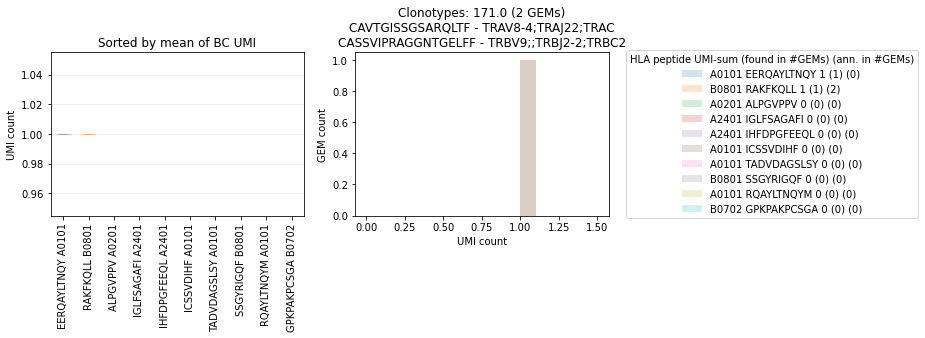

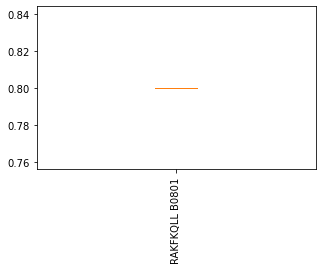

[569.]
('CASSWDVRNTDTQYF', 'CATQTGTASKLTF') resolved by trash bin
         peptide                                        peptide_lst  \
1831  IGLFSAGAFI  ['YPLVKMRLS' 'LFSAGAFI' 'EERQAYLTNQY' 'NLVPMVA...   
1831  IGLFSAGAFI  ['YPLVKMRLS' 'LFSAGAFI' 'EERQAYLTNQY' 'NLVPMVA...   
1831  IGLFSAGAFI  ['YPLVKMRLS' 'LFSAGAFI' 'EERQAYLTNQY' 'NLVPMVA...   
1831  IGLFSAGAFI  ['YPLVKMRLS' 'LFSAGAFI' 'EERQAYLTNQY' 'NLVPMVA...   

     umi_count_lst_mhc      cdr3_lst_TRA  \
1831  [1, 1, 1, 2, 10]  CAGASGIKAAGNKLTF   
1831  [1, 1, 1, 2, 10]     CATQTGTASKLTF   
1831  [1, 1, 1, 2, 10]  CAGASGIKAAGNKLTF   
1831  [1, 1, 1, 2, 10]     CATQTGTASKLTF   

                                        genes_lst_TRA umi_count_lst_TRA  \
1831  ['TRAV27;TRAJ17;TRAC' 'TRAV29/DV5;TRAJ44;TRAC']                 2   
1831  ['TRAV27;TRAJ17;TRAC' 'TRAV29/DV5;TRAJ44;TRAC']                 2   
1831  ['TRAV27;TRAJ17;TRAC' 'TRAV29/DV5;TRAJ44;TRAC']                 2   
1831  ['TRAV27;TRAJ17;TRAC' 'TRAV29/DV5;TRAJ44;TRAC']    

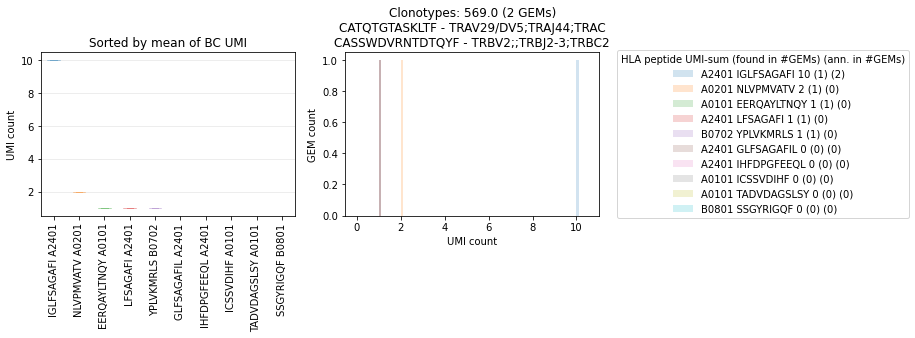

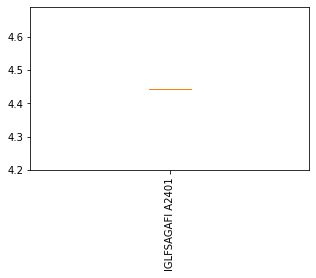

[104.]
('CATSRGAGTGGSYEQFF', 'CAVSSLTGANNLFF') unresolved
        peptide                                        peptide_lst  \
406   VTEHDTLLY  ['SVDIHFDPG' 'ATTADVDAGSL' 'EERQAYLTNQY' 'VTEH...   
1809  VTEHDTLLY  ['ALPGVPPV' 'VPAQRLQEA' 'RAKFKQLL' 'EERQAYLTNQ...   

        umi_count_lst_mhc    cdr3_lst_TRA           genes_lst_TRA  \
406         [1, 2, 9, 41]  CAVSSLTGANNLFF  ['TRAV21;TRAJ36;TRAC']   
1809  [1, 1, 2, 3, 3, 32]  CAVSSLTGANNLFF  ['TRAV21;TRAJ36;TRAC']   

     umi_count_lst_TRA       cdr3_lst_TRB                   genes_lst_TRB  \
406                  7  CATSRGAGTGGSYEQFF  ['TRBV15;TRBD1;TRBJ2-1;TRBC2']   
1809                 5  CATSRGAGTGGSYEQFF  ['TRBV15;TRBD1;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
406                  9  
1809                 8  


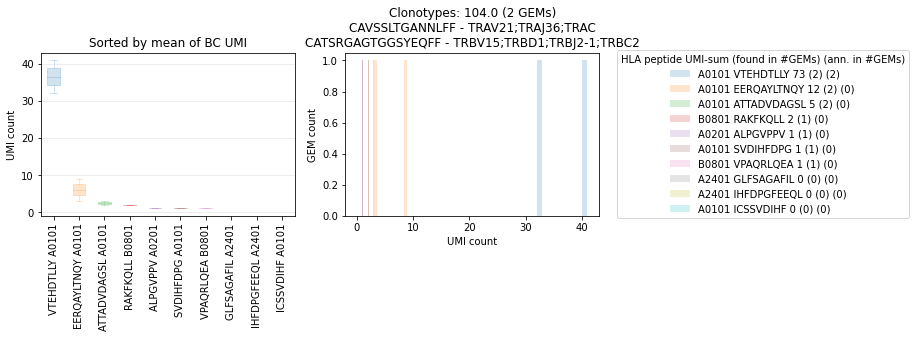

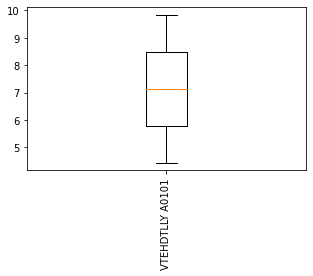

[108.]
('NaN', 'CAAADSSNDYKLSF') unresolved
          peptide                                        peptide_lst  \
861   EERQAYLTNQY  ['AMLIRDRL' 'CSSVDIHF' 'SVDIHFDPGF' 'TPRVTGGGA...   
1822     GLFSAGAF                                       ['GLFSAGAF']   

            umi_count_lst_mhc    cdr3_lst_TRA               genes_lst_TRA  \
861   [1, 1, 2, 3, 4, 33, 42]  CAAADSSNDYKLSF  ['TRAV29/DV5;TRAJ20;TRAC']   
1822                      [1]  CAAADSSNDYKLSF  ['TRAV29/DV5;TRAJ20;TRAC']   

     umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB umi_count_lst_TRB  
861                  4                        NaN               NaN  
1822                 1                        NaN               NaN  


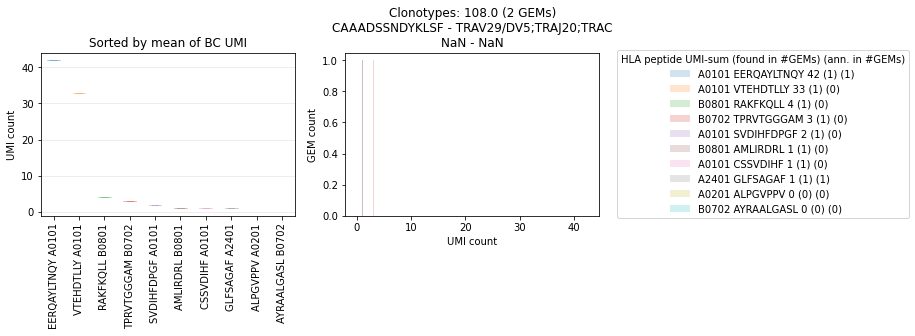

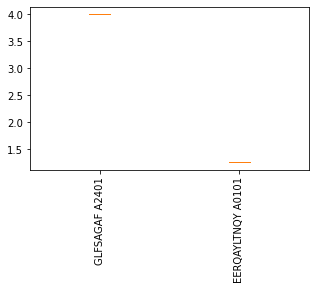

[83.]
('NaN', 'CAMREGYTGGFKTIF') unresolved
        peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
385   VTEHDTLLY  ['VTEHDTLLY']               [1]  CAMREGYTGGFKTIF   
1192   AMLIRDRL   ['AMLIRDRL']               [1]  CAMREGYTGGFKTIF   

                  genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB  \
385   ['TRAV14/DV4;TRAJ9;TRAC']                 1                        NaN   
1192  ['TRAV14/DV4;TRAJ9;TRAC']                 1                        NaN   

     umi_count_lst_TRB  
385                NaN  
1192               NaN  


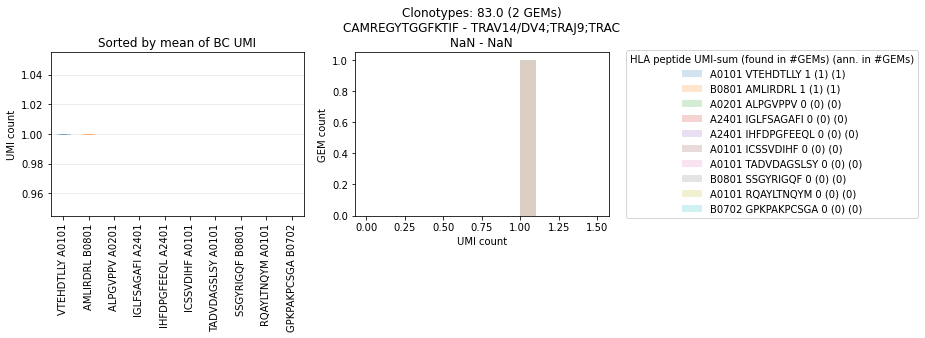

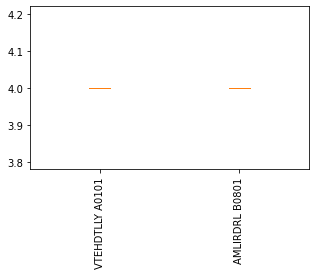

[134.]
('NaN', 'CAVNLGGGFKTIF') unresolved
         peptide                                        peptide_lst  \
1009  FSAGAFILYK                                     ['FSAGAFILYK']   
1906    RAKFKQLL  ['HTGEKHYAC' 'VIRHKRQSW' 'EERQAYLTNQY' 'TPRVTG...   

        umi_count_lst_mhc   cdr3_lst_TRA            genes_lst_TRA  \
1009                  [1]  CAVNLGGGFKTIF  ['TRAV12-2;TRAJ9;TRAC']   
1906  [1, 1, 1, 1, 2, 38]  CAVNLGGGFKTIF  ['TRAV12-2;TRAJ9;TRAC']   

     umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB umi_count_lst_TRB  
1009                 1                        NaN               NaN  
1906                 2                        NaN               NaN  


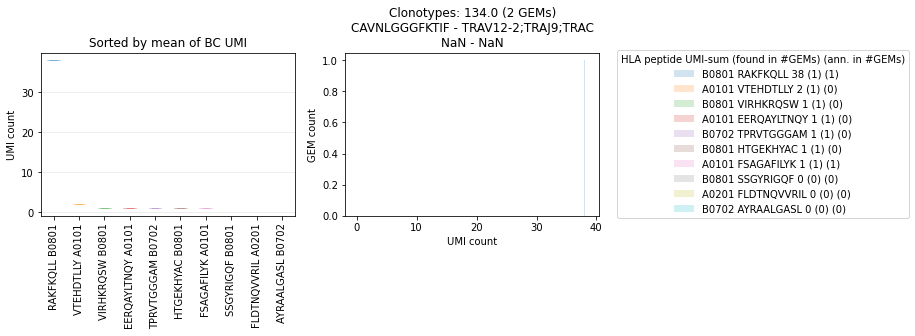

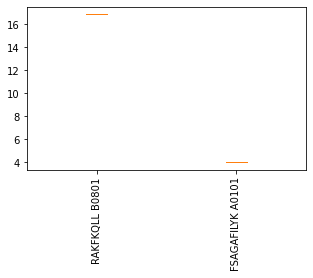

[565.]
('CAIKPRQLNTEAFF', 'CAAKYAGGTSYGKLTF') unresolved
        peptide    peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
1737  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAAKYAGGTSYGKLTF   

                   genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1737  ['TRAV29/DV5;TRAJ52;TRAC']                 3  CAIKPRQLNTEAFF   

                   genes_lst_TRB umi_count_lst_TRB  
1737  ['TRBV7-9;;TRBJ1-1;TRBC1']                13  


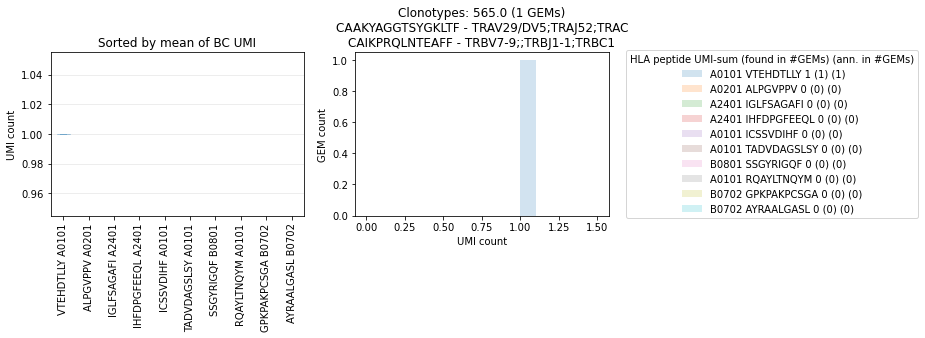

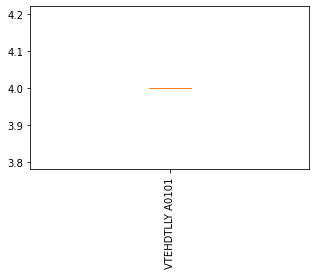

[300.]
('CASAGDGTYNEQFF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2274  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB              genes_lst_TRB  \
2274               NaN  CASAGDGTYNEQFF  ['TRBV27;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2274                 5  


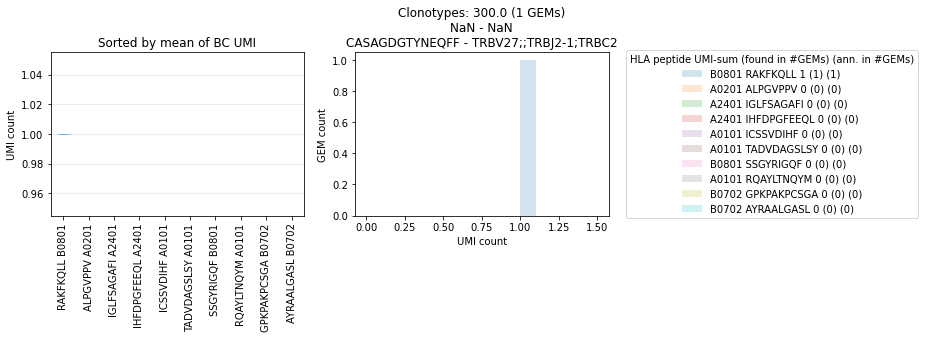

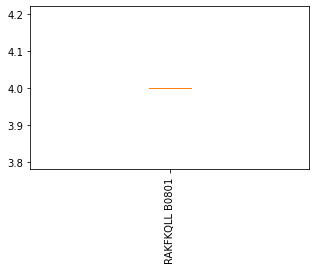

[557.]
('CASKGSGTGNSPLHF', 'CVVYAAFYDYKLSF') unresolved
        peptide                peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
845  TPRVTGGGAM  ['RAKFKQLL' 'TPRVTGGGAM']            [1, 1]  CVVYAAFYDYKLSF   

                genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
845  ['TRAV12-1;TRAJ20;TRAC']                 4  CASKGSGTGNSPLHF   

                genes_lst_TRB umi_count_lst_TRB  
845  ['TRBV2;;TRBJ1-6;TRBC1']                 4  


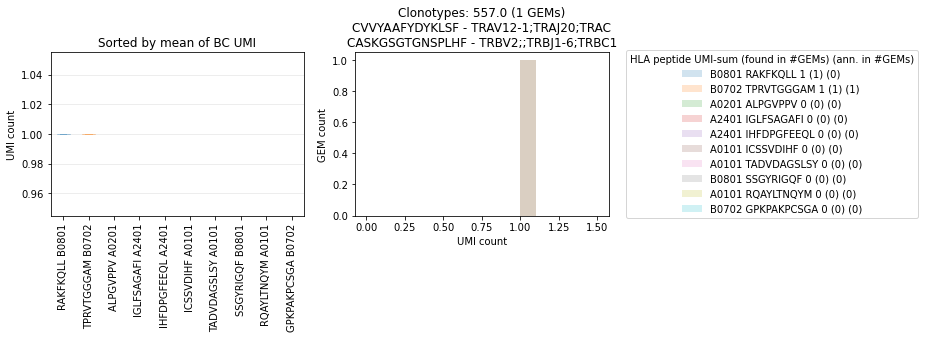

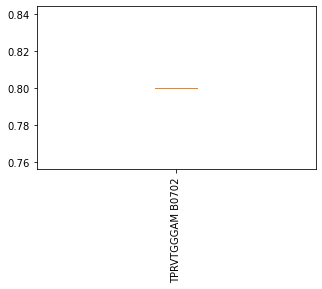

[570.]
('CASKMGGSTDTQYF', 'CAANFGNEKLTF') unresolved
      peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
70  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAANFGNEKLTF   

                 genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
70  ['TRAV29/DV5;TRAJ48;TRAC']                 5  CASKMGGSTDTQYF   

                genes_lst_TRB umi_count_lst_TRB  
70  ['TRBV18;;TRBJ2-3;TRBC2']                10  


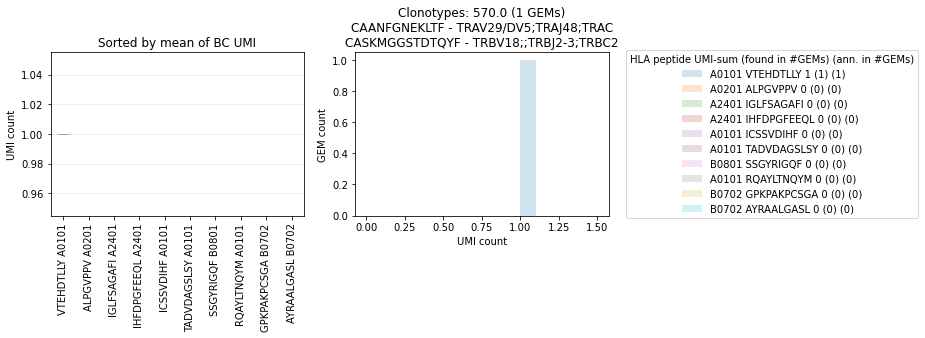

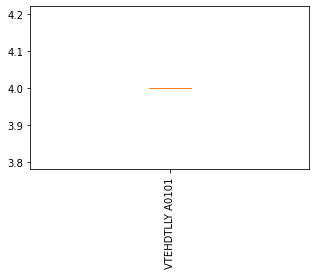

[614.]
('CASQDSSGNTIYF', 'CAYRWGGSQGNLIF') unresolved
     peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
8  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAYRWGGSQGNLIF   

                  genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
8  ['TRAV38-2/DV8;TRAJ42;TRAC']                11  CASQDSSGNTIYF   

                genes_lst_TRB umi_count_lst_TRB  
8  ['TRBV7-9;;TRBJ1-3;TRBC1']                 7  


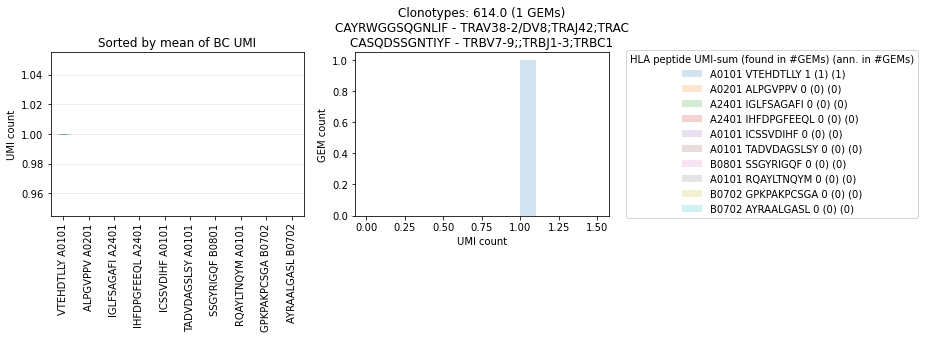

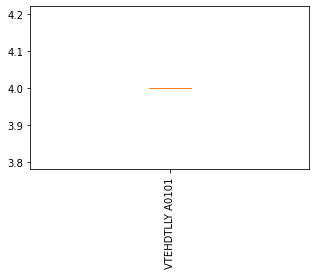

[311.]
('CASRDTGTGTSYEQYF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2268  VTEHDTLLY  ['ATTADVDAGSL' 'TNQYMQRMASV' 'QAYLTNQY' 'RQAYL...   

              umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2268  [1, 1, 1, 1, 1, 2, 2, 73]                        NaN               NaN   

          cdr3_lst_TRB                   genes_lst_TRB umi_count_lst_TRB  
2268  CASRDTGTGTSYEQYF  ['TRBV28;TRBD1;TRBJ2-7;TRBC2']                10  


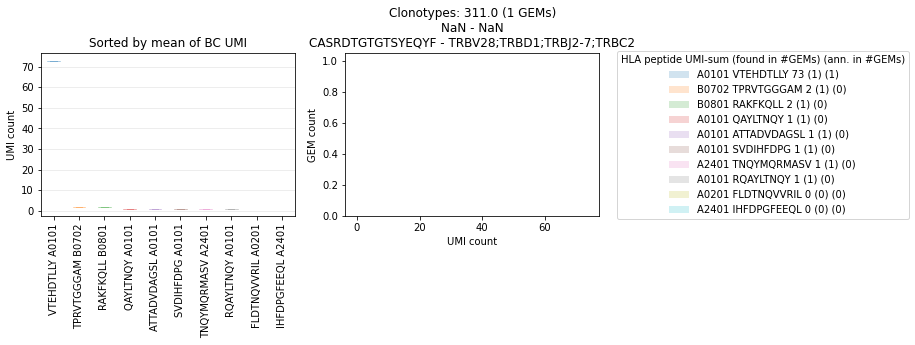

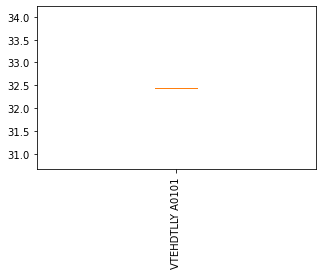

[194.]
('CASRETGTNTGELFF', 'CALDDNTGKLIF') unresolved
          peptide      peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1796  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CALDDNTGKLIF   

                genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
1796  ['TRAV9-2;TRAJ37;TRAC']                 3  CASRETGTNTGELFF   

                       genes_lst_TRB umi_count_lst_TRB  
1796  ['TRBV19;TRBD1;TRBJ2-2;TRBC2']                 8  


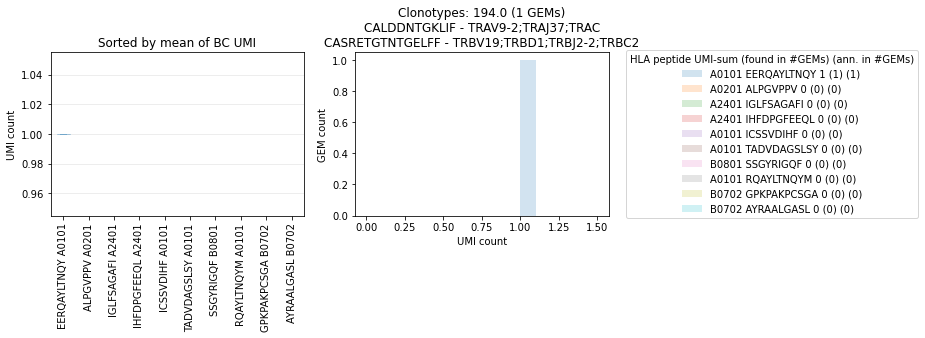

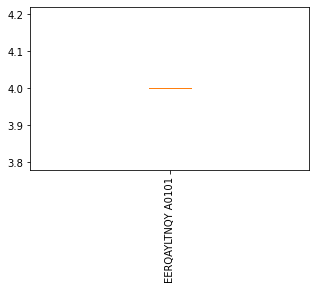

[304.]
('CASRETSGATDTQYF', 'NaN') unresolved
          peptide      peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2261  EERQAYLTNQY  ['EERQAYLTNQY']               [4]                

     genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2261           NaN               NaN  CASRETSGATDTQYF   

                   genes_lst_TRB umi_count_lst_TRB  
2261  ['TRBV6-4;;TRBJ2-3;TRBC2']                 3  


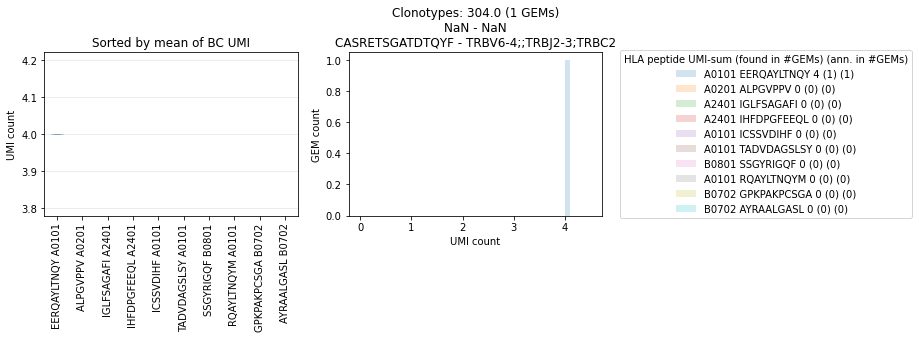

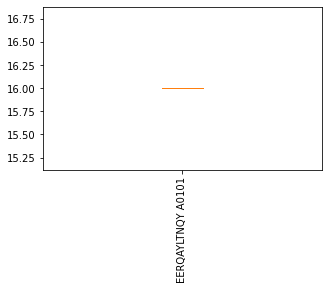

[664.]
('CASRFTRGSEQETQYF', 'CALSESGGSGNTGKLIF') unresolved
       peptide    peptide_lst umi_count_lst_mhc       cdr3_lst_TRA  \
853  VTEHDTLLY  ['VTEHDTLLY']               [1]  CALSESGGSGNTGKLIF   

              genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
853  ['TRAV19;TRAJ37;TRAC']                 6  CASRFTRGSEQETQYF   

                 genes_lst_TRB umi_count_lst_TRB  
853  ['TRBV27;;TRBJ2-5;TRBC2']                 9  


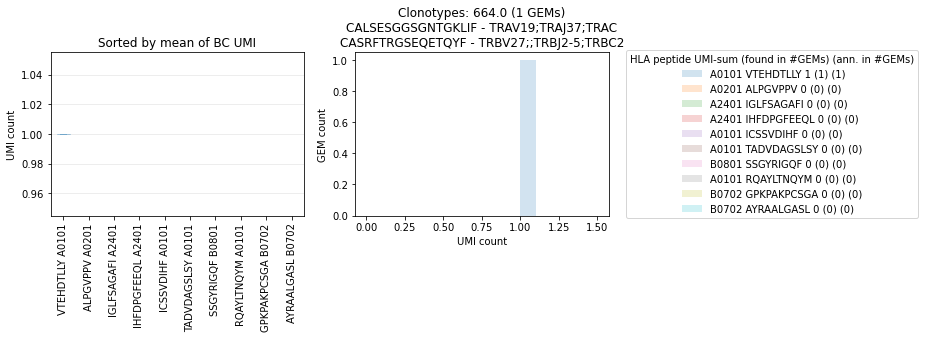

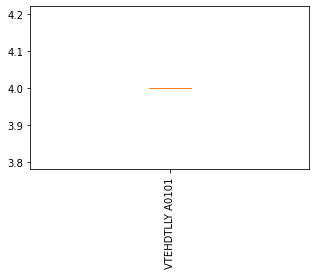

[53.]
('CASRIGAAGNSPLHF', 'CAVNYGNKLVF') unresolved
      peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
459  RAKFKQLL  ['RAKFKQLL']               [1]  CAVNYGNKLVF   

             genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
459  ['TRAV3;TRAJ47;TRAC']                 2  CASRIGAAGNSPLHF   

                 genes_lst_TRB umi_count_lst_TRB  
459  ['TRBV27;;TRBJ1-6;TRBC1']                 1  


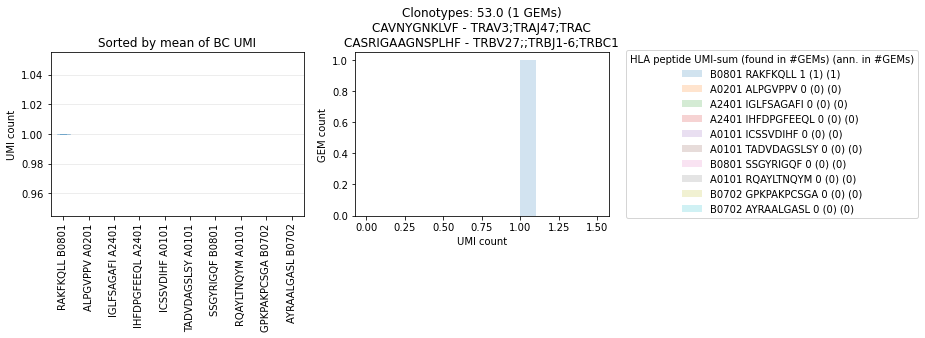

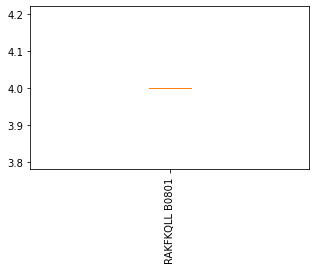

[298.]
('CASRPNTGTVSSYNEQFF', 'NaN') unresolved
       peptide                              peptide_lst umi_count_lst_mhc  \
2121  RAKFKQLL  ['FSAGAFILYK' 'EERQAYLTNQY' 'RAKFKQLL']         [1, 1, 1]   

     cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA        cdr3_lst_TRB  \
2121                        NaN               NaN  CASRPNTGTVSSYNEQFF   

                       genes_lst_TRB umi_count_lst_TRB  
2121  ['TRBV27;TRBD1;TRBJ2-1;TRBC2']                 5  


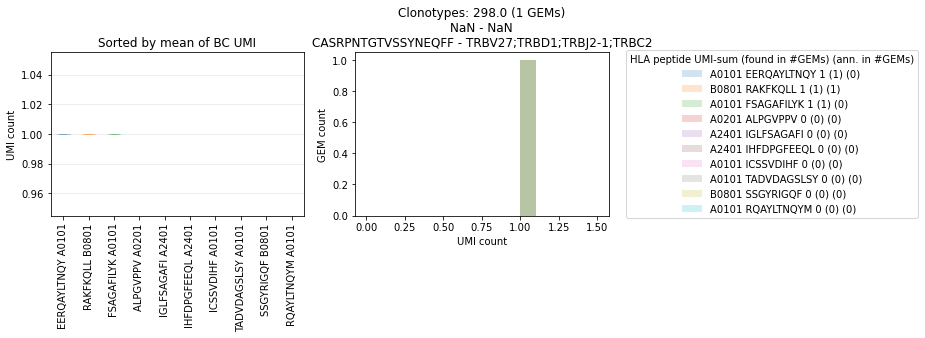

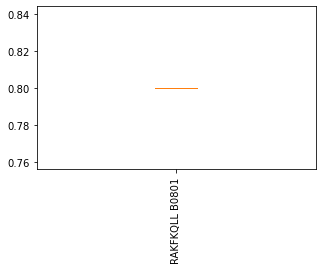

[272.]
('CASRRNLGGNQPQHF', 'CAVNTGDYKLSF') resolved by trash bin
      peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
82  VPAQRLQEA  ['VPAQRLQEA']               [1]  CAVNTGDYKLSF   

              genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
82  ['TRAV8-1;TRAJ20;TRAC']                 7  CASRRNLGGNQPQHF   

                genes_lst_TRB umi_count_lst_TRB  
82  ['TRBV28;;TRBJ1-5;TRBC1']                19  


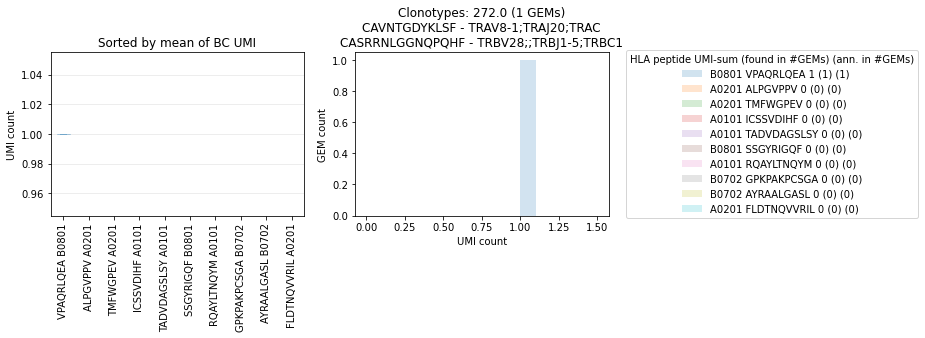

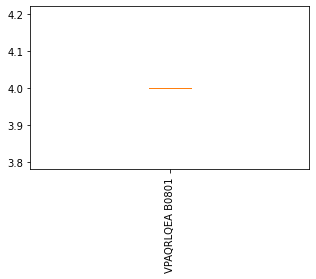

[576.]
('CASRSTEPNQPQHF', 'CAASERGGHTGANSKLTF') unresolved
      peptide   peptide_lst umi_count_lst_mhc        cdr3_lst_TRA  \
339  RAKFKQLL  ['RAKFKQLL']               [1]  CAASERGGHTGANSKLTF   

                  genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
339  ['TRAV29/DV5;TRAJ56;TRAC']                 3  CASRSTEPNQPQHF   

                  genes_lst_TRB umi_count_lst_TRB  
339  ['TRBV7-2;;TRBJ1-5;TRBC1']                 9  


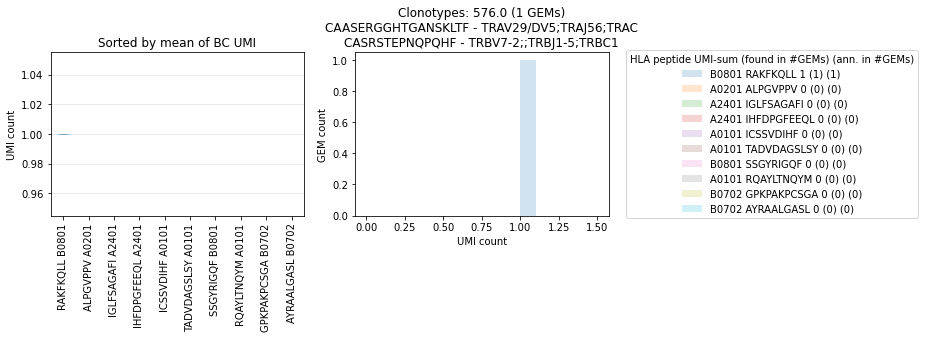

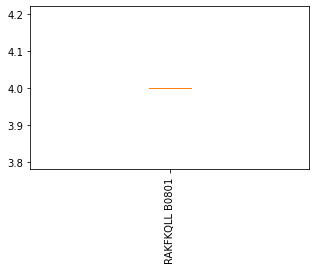

[140.]
('CASRTGGREPQHF', 'CAGNTDKLIF') unresolved
        peptide                peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
1118  VTEHDTLLY  ['LLFERPHTM' 'VTEHDTLLY']            [1, 1]   CAGNTDKLIF   

                genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1118  ['TRAV1-2;TRAJ34;TRAC']                 1  CASRTGGREPQHF   

                  genes_lst_TRB umi_count_lst_TRB  
1118  ['TRBV27;;TRBJ1-5;TRBC1']                 3  


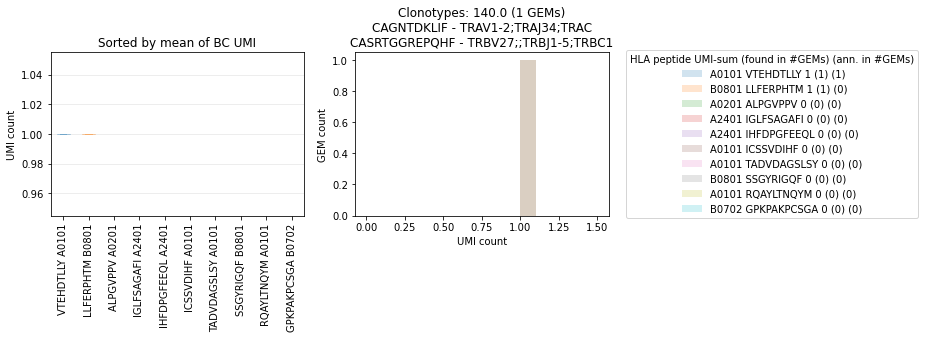

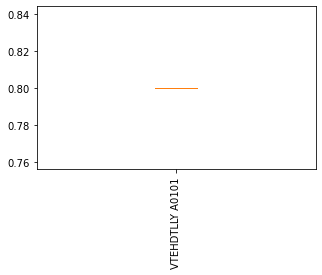

[647.]
('CASRTGGVNEQYF', 'CAVYSGAGSYQLTF') unresolved
       peptide   peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1921  RAKFKQLL  ['RAKFKQLL']               [1]  CAVYSGAGSYQLTF   

               genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1921  ['TRAV21;TRAJ28;TRAC']                 4  CASRTGGVNEQYF   

                       genes_lst_TRB umi_count_lst_TRB  
1921  ['TRBV27;TRBD1;TRBJ2-7;TRBC2']                 8  


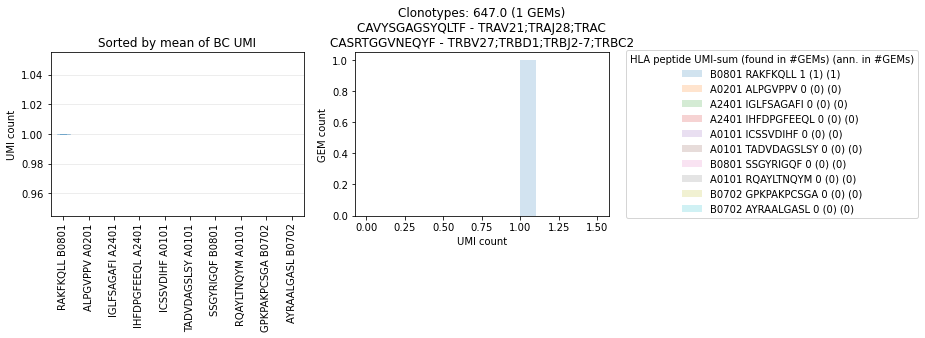

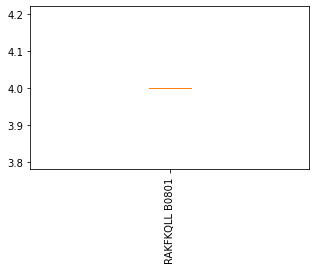

[135.]
('CASRVGLASSYNEQFF', 'CAVNGGFKTIF') unresolved
         peptide                            peptide_lst umi_count_lst_mhc  \
2055  TPRVTGGGAM  ['GPKPAKPCS' 'RAKFKQLL' 'TPRVTGGGAM']        [1, 1, 28]   

     cdr3_lst_TRA            genes_lst_TRA umi_count_lst_TRA  \
2055  CAVNGGFKTIF  ['TRAV12-2;TRAJ9;TRAC']                 6   

          cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
2055  CASRVGLASSYNEQFF  ['TRBV27;;TRBJ2-1;TRBC2']                 3  


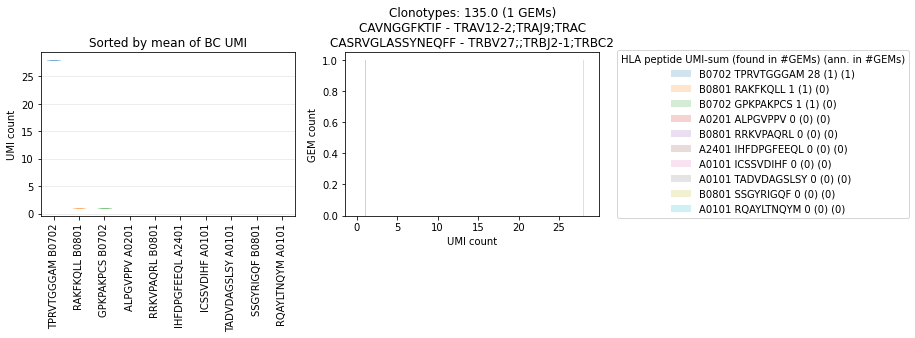

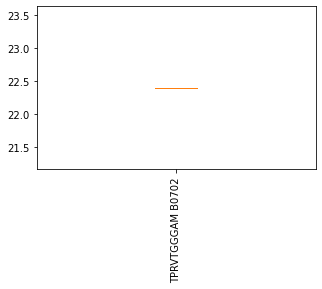

[608.]
('CASSADRSEAFF', 'CAYYSGAGSYQLTF') unresolved
      peptide               peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
193  RAKFKQLL  ['VTEHDTLLY' 'RAKFKQLL']            [1, 1]  CAYYSGAGSYQLTF   

                    genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
193  ['TRAV38-2/DV8;TRAJ28;TRAC']                 2  CASSADRSEAFF   

                   genes_lst_TRB umi_count_lst_TRB  
193  ['TRBV10-2;;TRBJ1-1;TRBC1']                 5  


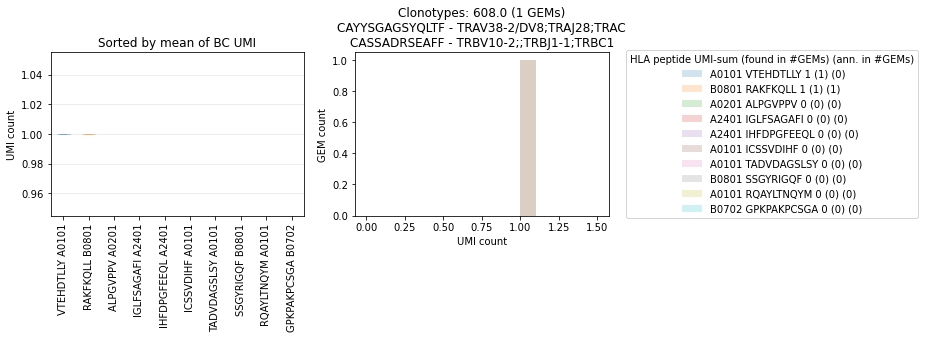

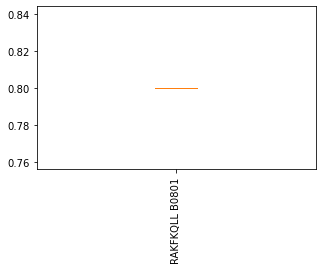

[635.]
('CASSAGQGSSYEQYF', 'CAVLLIQGAQKLVF') unresolved
       peptide                                        peptide_lst  \
687  VTEHDTLLY  ['FSAGAFILYN' 'ATTADVDAGSL' 'TPRVTGGGAM' 'RAKF...   

    umi_count_lst_mhc    cdr3_lst_TRA               genes_lst_TRA  \
687  [1, 1, 1, 1, 63]  CAVLLIQGAQKLVF  ['TRAV36/DV7;TRAJ54;TRAC']   

    umi_count_lst_TRA     cdr3_lst_TRB                  genes_lst_TRB  \
687                 4  CASSAGQGSSYEQYF  ['TRBV9;TRBD1;TRBJ2-7;TRBC2']   

    umi_count_lst_TRB  
687                18  


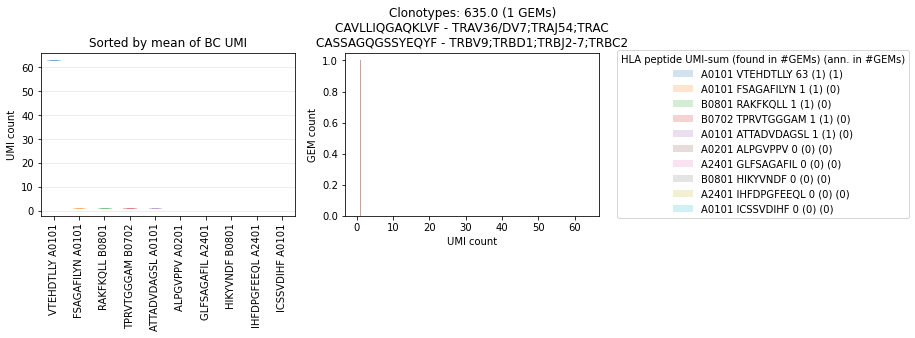

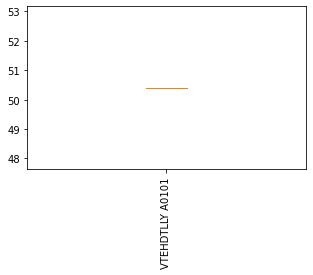

[498.]
('CASSAGSYNEQFF', 'CAAIDSNYQLIW') unresolved
       peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
100  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAAIDSNYQLIW   

               genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
100  ['TRAV1-2;TRAJ33;TRAC']                 1  CASSAGSYNEQFF   

                  genes_lst_TRB umi_count_lst_TRB  
100  ['TRBV6-2;;TRBJ2-1;TRBC2']                10  


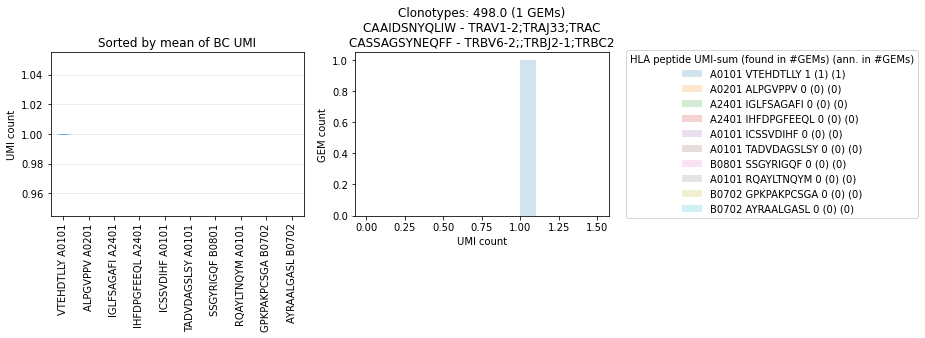

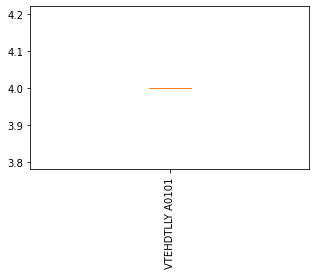

[333.]
('CASSAGTLNTEAFF', 'NaN') unresolved
         peptide     peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2084  FSAGAFILYK  ['FSAGAFILYK']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB               genes_lst_TRB  \
2084               NaN  CASSAGTLNTEAFF  ['TRBV4-1;;TRBJ1-1;TRBC1']   

     umi_count_lst_TRB  
2084                 6  


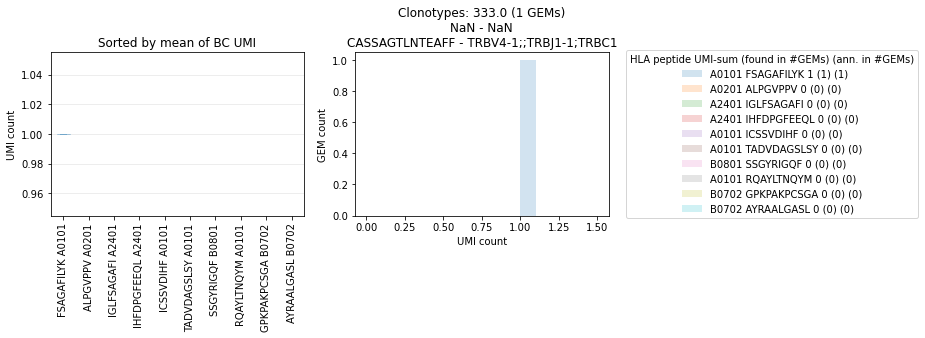

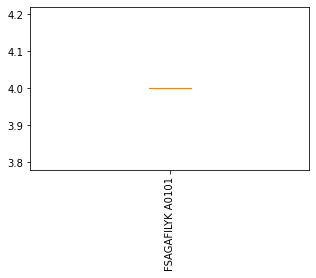

[188.]
('CASSDEWAEKLFF', 'CALLEETSGSRLTF') unresolved
       peptide   peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1226  RAKFKQLL  ['RAKFKQLL']               [2]  CALLEETSGSRLTF   

                genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1226  ['TRAV9-2;TRAJ58;TRAC']                 4  CASSDEWAEKLFF   

                   genes_lst_TRB umi_count_lst_TRB  
1226  ['TRBV7-9;;TRBJ1-4;TRBC1']                 5  


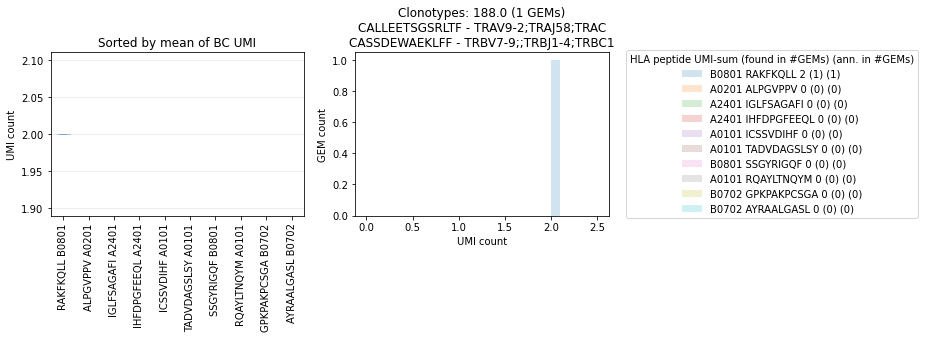

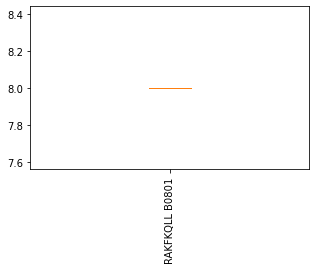

[374.]
('CASSDGWDEQFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2136  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA  cdr3_lst_TRB               genes_lst_TRB  \
2136               NaN  CASSDGWDEQFF  ['TRBV7-8;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2136                 2  


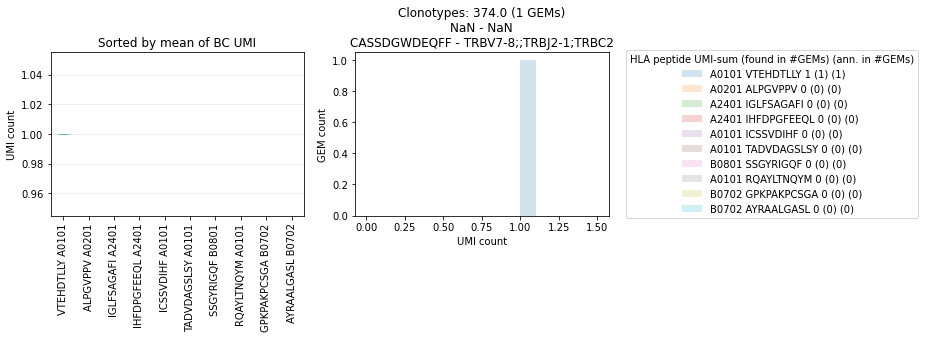

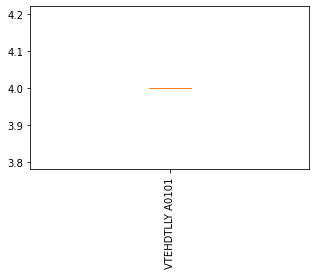

[71.]
('CASSDLNSPLHF', 'NaN') unresolved
       peptide                                        peptide_lst  \
2312  RAKFKQLL  ['GMAEGATTA' 'TPRVTGGGAM' 'FSAGAFILYK' 'MDMFSD...   

        umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2312  [1, 1, 1, 1, 2, 37]                        NaN               NaN   

      cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
2312  CASSDLNSPLHF  ['TRBV27;;TRBJ1-6;TRBC1']                 5  


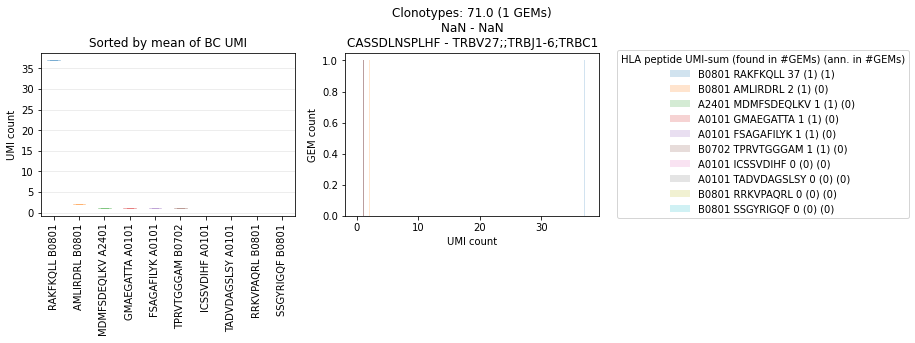

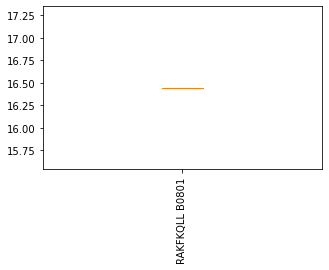

[503.]
('CASSDRDTGELFF', 'CAVMDSNYQLIW') unresolved
     peptide   peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
32  RAKFKQLL  ['RAKFKQLL']               [1]  CAVMDSNYQLIW   

              genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
32  ['TRAV1-2;TRAJ33;TRAC']                 1  CASSDRDTGELFF   

                 genes_lst_TRB umi_count_lst_TRB  
32  ['TRBV6-5;;TRBJ2-2;TRBC2']                 5  


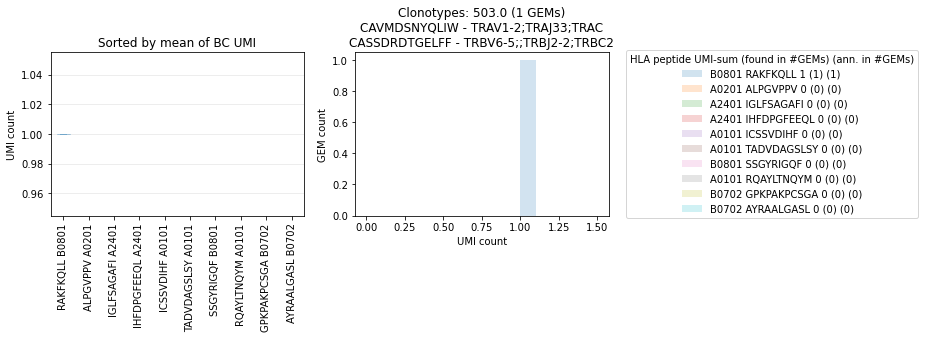

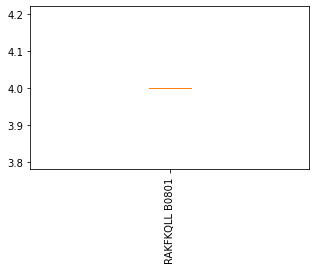

[549.]
('CASSDSSNYGYTF', 'CAVIHRNAGNMLTF') unresolved
        peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1343  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVIHRNAGNMLTF   

                genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1343  ['TRAV1-2;TRAJ39;TRAC']                 1  CASSDSSNYGYTF   

                 genes_lst_TRB umi_count_lst_TRB  
1343  ['TRBV2;;TRBJ1-2;TRBC1']                17  


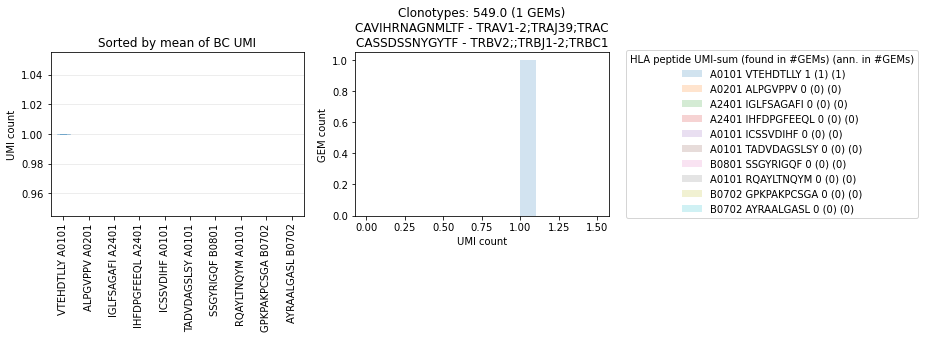

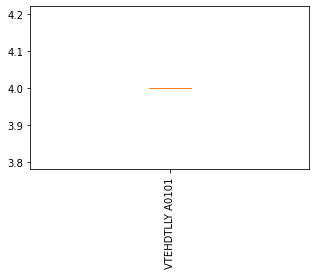

[520.]
('CASSDTGLAGYNEQFF', 'CAVIRRQAGTALIF') unresolved
       peptide   peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1504  RAKFKQLL  ['RAKFKQLL']               [1]  CAVIRRQAGTALIF   

                genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
1504  ['TRAV1-2;TRAJ15;TRAC']                 2  CASSDTGLAGYNEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
1504  ['TRBV6-1;;TRBJ2-1;TRBC2']                 7  


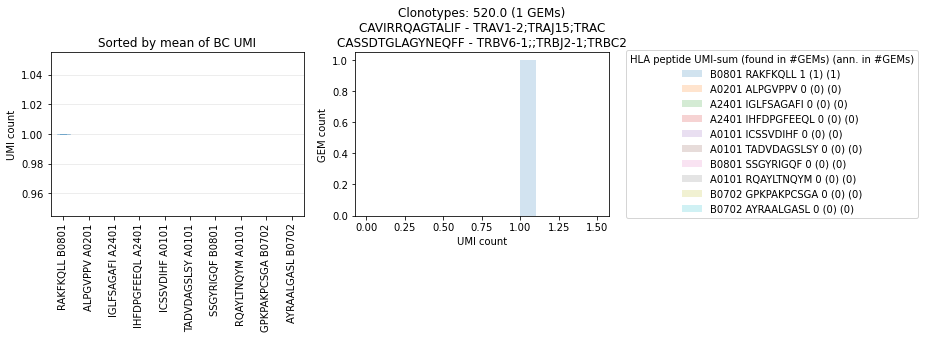

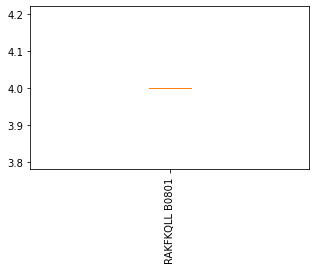

[244.]
('CASSDTSGSLGTQYF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2330  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB             genes_lst_TRB  \
2330               NaN  CASSDTSGSLGTQYF  ['TRBV9;;TRBJ2-3;TRBC2']   

     umi_count_lst_TRB  
2330                10  


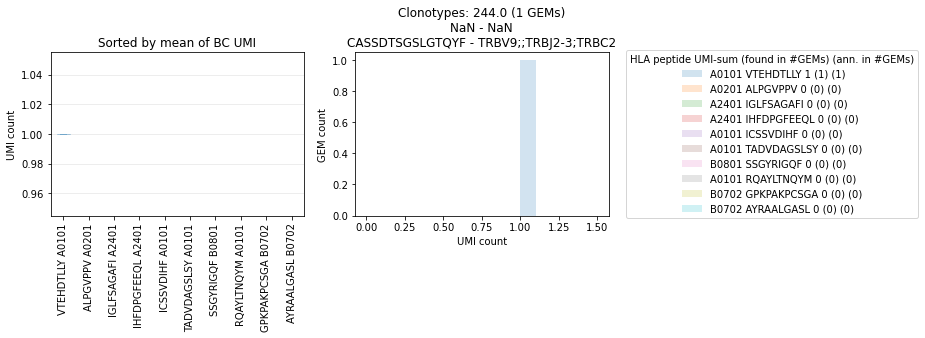

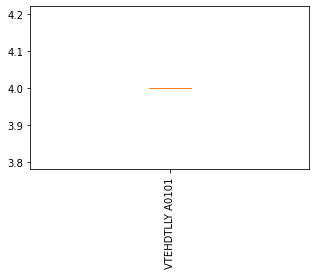

[312.]
('CASSEAGAGADEQFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2318  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
2318               NaN  CASSEAGAGADEQFF  ['TRBV6-1;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2318                 6  


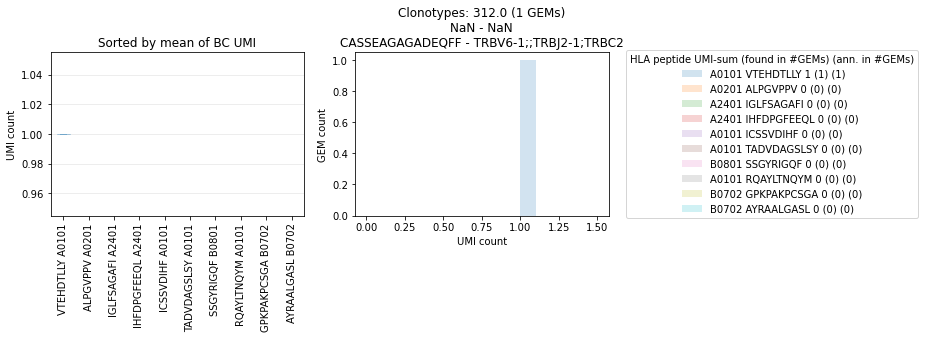

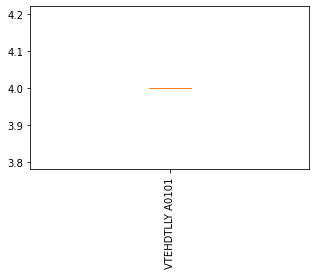

[309.]
('CASSEEDGPYNEQFF', 'NaN') unresolved
          peptide      peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2262  EERQAYLTNQY  ['EERQAYLTNQY']               [1]                

     genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2262           NaN               NaN  CASSEEDGPYNEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
2262  ['TRBV6-1;;TRBJ2-1;TRBC2']                 6  


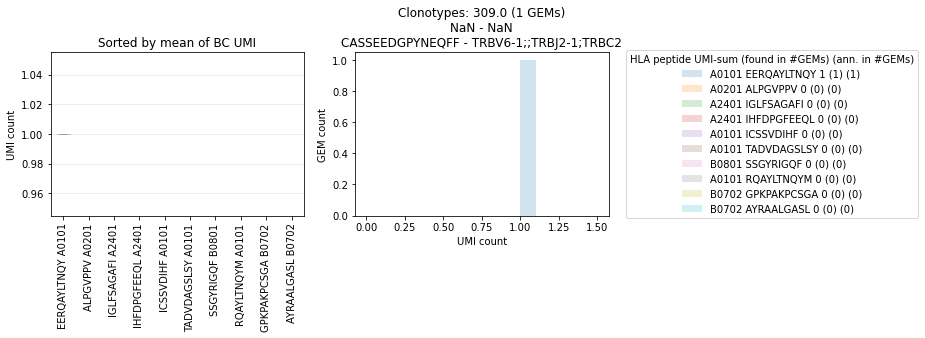

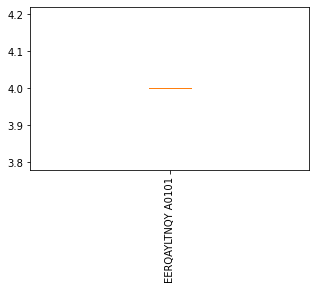

[495.]
('CASSEELAGGRETQYF', 'CAVLDSNYQLIW') resolved by trash bin
        peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1577  YLFHKEPTW  ['YLFHKEPTW']               [1]  CAVLDSNYQLIW   

                genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
1577  ['TRAV1-2;TRAJ33;TRAC']                 1  CASSEELAGGRETQYF   

                   genes_lst_TRB umi_count_lst_TRB  
1577  ['TRBV6-1;;TRBJ2-5;TRBC2']                 2  


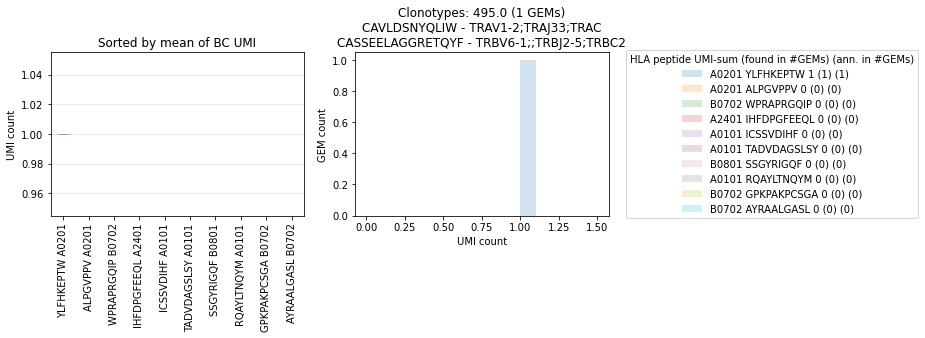

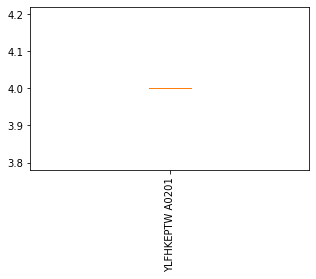

[246.]
('CASSEGDIIYEQYF', 'CVVSELGYYKGTYKYIF') unresolved
         peptide                  peptide_lst umi_count_lst_mhc  \
780  EERQAYLTNQY  ['VTEHDTLLY' 'EERQAYLTNQY']            [1, 1]   

          cdr3_lst_TRA            genes_lst_TRA umi_count_lst_TRA  \
780  CVVSELGYYKGTYKYIF  ['TRAV8-2;TRAJ40;TRAC']                 3   

       cdr3_lst_TRB             genes_lst_TRB umi_count_lst_TRB  
780  CASSEGDIIYEQYF  ['TRBV2;;TRBJ2-7;TRBC2']                11  


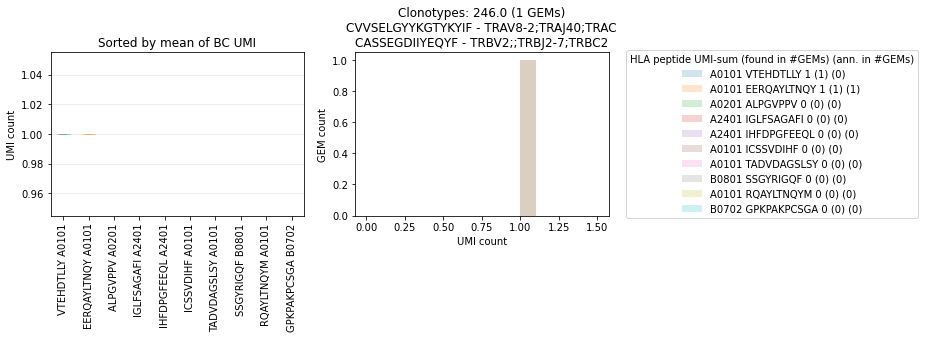

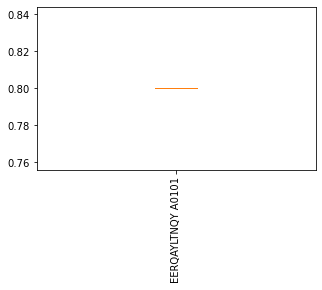

[226.]
('CASSEGQGRTYEQYF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2373  VTEHDTLLY  ['RAKFKQLL' 'ATTADVDAGSL' 'RQAYLTNQY' 'TTADVDA...   

         umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2373  [1, 1, 1, 1, 20, 74]                        NaN               NaN   

         cdr3_lst_TRB                  genes_lst_TRB umi_count_lst_TRB  
2373  CASSEGQGRTYEQYF  ['TRBV9;TRBD1;TRBJ2-7;TRBC2']                11  


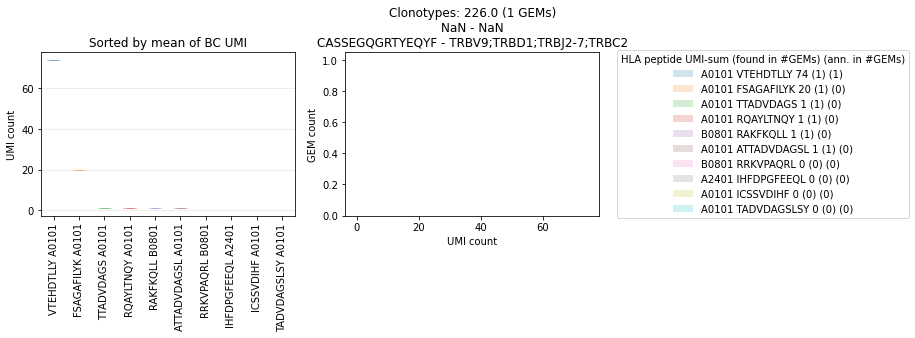

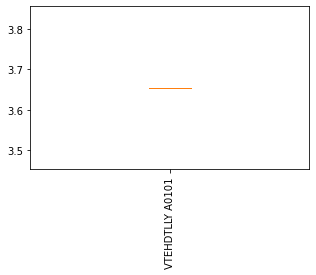

[636.]
('CASSEGQGSSYEQYF', 'CAVVLIQGAQKLVF') unresolved
       peptide               peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
543  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]  CAVVLIQGAQKLVF   

                  genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
543  ['TRAV36/DV7;TRAJ54;TRAC']                 2  CASSEGQGSSYEQYF   

                     genes_lst_TRB umi_count_lst_TRB  
543  ['TRBV9;TRBD1;TRBJ2-7;TRBC2']                13  


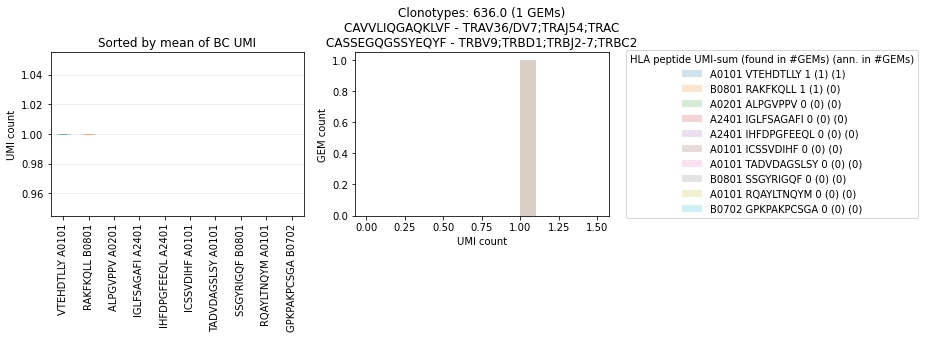

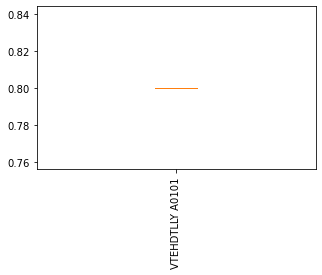

[376.]
('CASSEGQHLTEAFF', 'NaN') unresolved
         peptide     peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2153  TPRVTGGGAM  ['TPRVTGGGAM']               [2]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB               genes_lst_TRB  \
2153               NaN  CASSEGQHLTEAFF  ['TRBV7-3;;TRBJ1-1;TRBC1']   

     umi_count_lst_TRB  
2153                11  


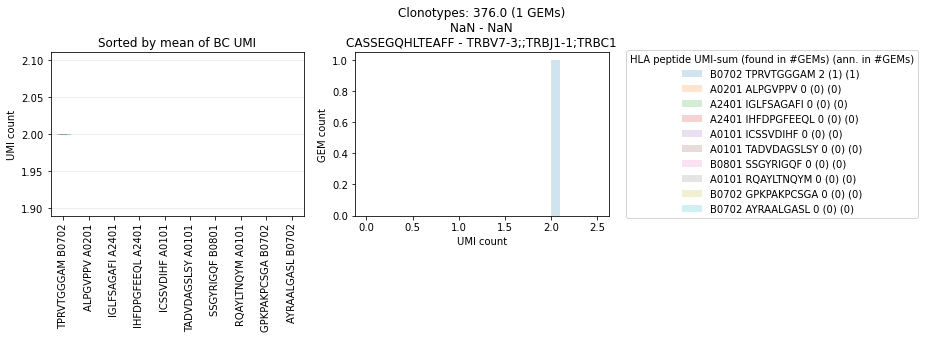

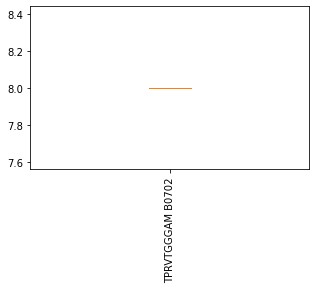

[385.]
('CASSELSGTKTQYF', 'CLVGLPRSGSARQLTF') unresolved
       peptide                                        peptide_lst  \
1976  RAKFKQLL  ['GPFPGNLV' 'HTGEKHYAC' 'TPRVTGGGAM' 'AMLIRDRL...   

     umi_count_lst_mhc      cdr3_lst_TRA          genes_lst_TRA  \
1976  [1, 1, 2, 2, 59]  CLVGLPRSGSARQLTF  ['TRAV4;TRAJ22;TRAC']   

     umi_count_lst_TRA    cdr3_lst_TRB               genes_lst_TRB  \
1976                 3  CASSELSGTKTQYF  ['TRBV6-1;;TRBJ2-5;TRBC2']   

     umi_count_lst_TRB  
1976                 5  


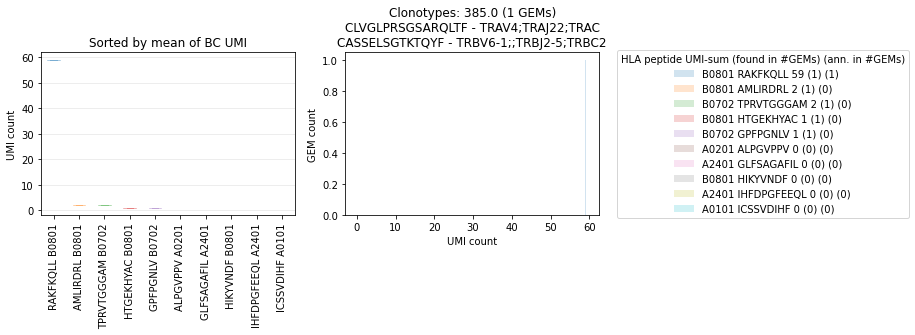

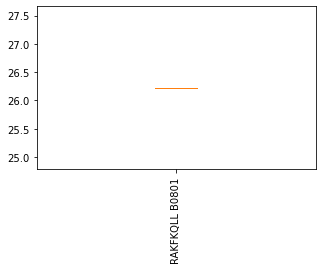

[399.]
('CASSENKRPNEQFF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2377  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB             genes_lst_TRB  \
2377               NaN  CASSENKRPNEQFF  ['TRBV2;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2377                 9  


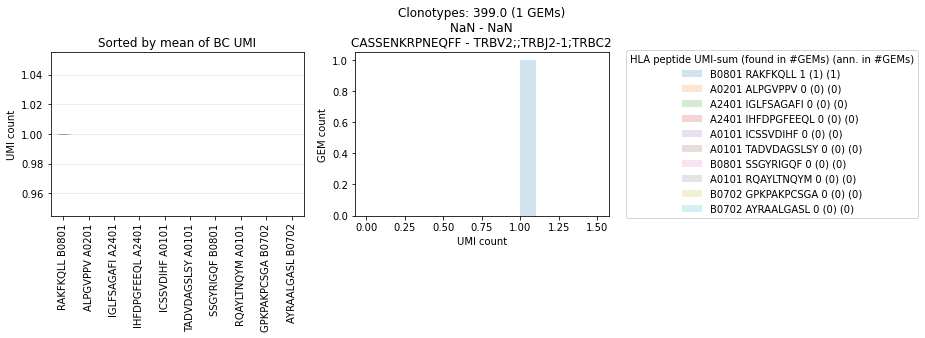

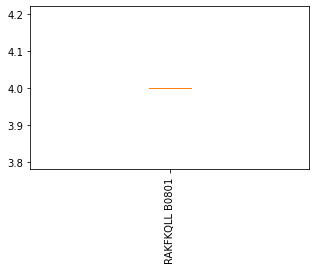

[494.]
('CASSEQGDTGELFF', 'CAVRDSNYQLIW') resolved by trash bin
        peptide     peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
809  FLDTNQVVRI  ['FLDTNQVVRI']               [1]  CAVRDSNYQLIW   

               genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
809  ['TRAV1-2;TRAJ33;TRAC']                 1  CASSEQGDTGELFF   

                       genes_lst_TRB umi_count_lst_TRB  
809  ['TRBV6-1;TRBD1;TRBJ2-2;TRBC2']                 3  


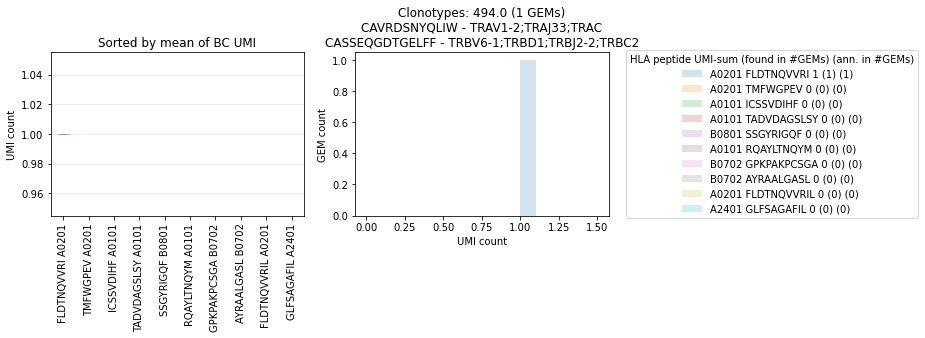

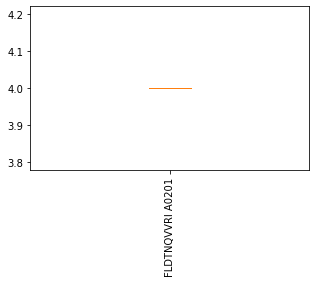

[148.]
('CASSERGQGAYEQYF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2137  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB                    genes_lst_TRB  \
2137               NaN  CASSERGQGAYEQYF  ['TRBV5-4;TRBD1;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
2137                 4  


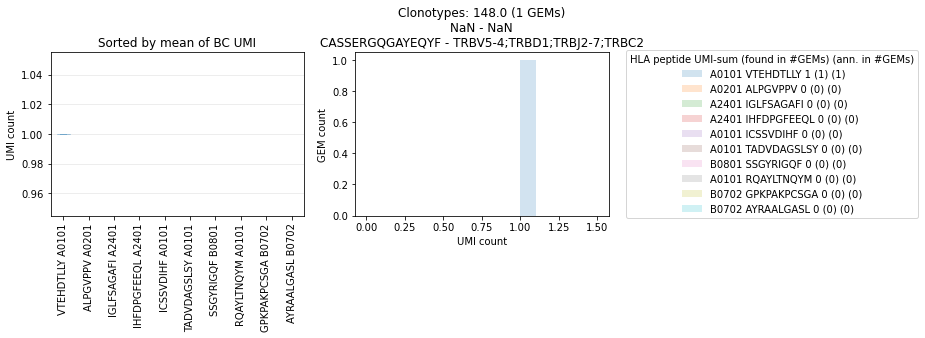

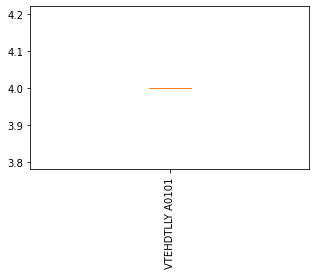

[342.]
('CASSESQSADTQYF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2232  GPFPGNLV  ['GPFPGNLV']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB               genes_lst_TRB  \
2232               NaN  CASSESQSADTQYF  ['TRBV6-4;;TRBJ2-3;TRBC2']   

     umi_count_lst_TRB  
2232                 2  


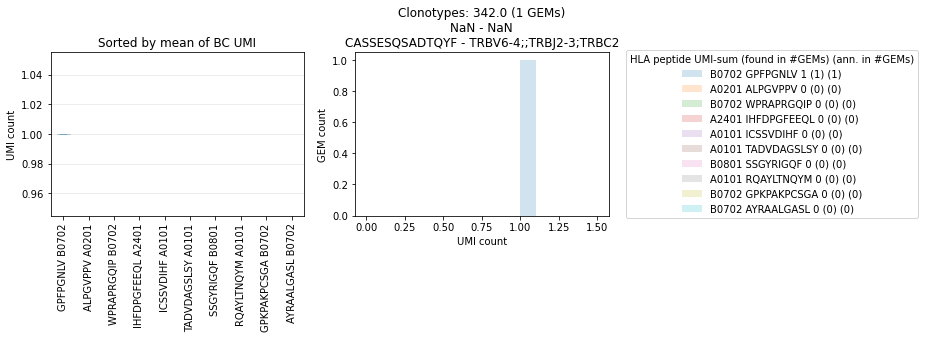

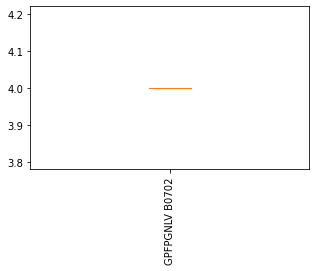

[413.]
('CASSETGKEKLFF', 'CAENGNKKGGKLIF') unresolved
       peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
201  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAENGNKKGGKLIF   

                genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
201  ['TRAV13-2;TRAJ23;TRAC']                 3  CASSETGKEKLFF   

                 genes_lst_TRB umi_count_lst_TRB  
201  ['TRBV13;;TRBJ1-4;TRBC1']                 1  


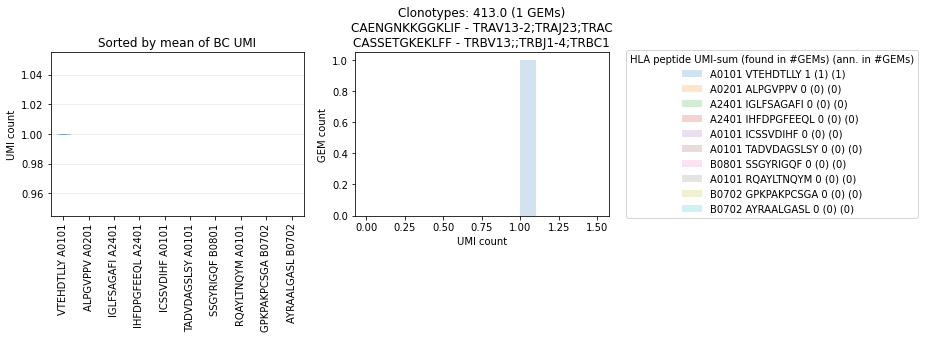

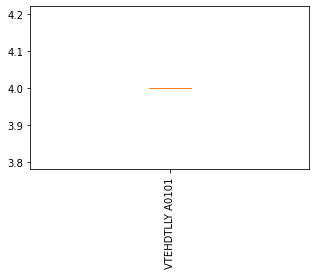

[654.]
('CASSFAGGPYNEQFF', 'CAVRGDRSSGDKLTF') unresolved
     peptide   peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
97  WPRAPRGQ  ['WPRAPRGQ']               [1]  CAVRGDRSSGDKLTF   

             genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
97  ['TRAV21;TRAJ46;TRAC']                 2  CASSFAGGPYNEQFF   

                  genes_lst_TRB umi_count_lst_TRB  
97  ['TRBV11-2;;TRBJ2-1;TRBC2']                13  


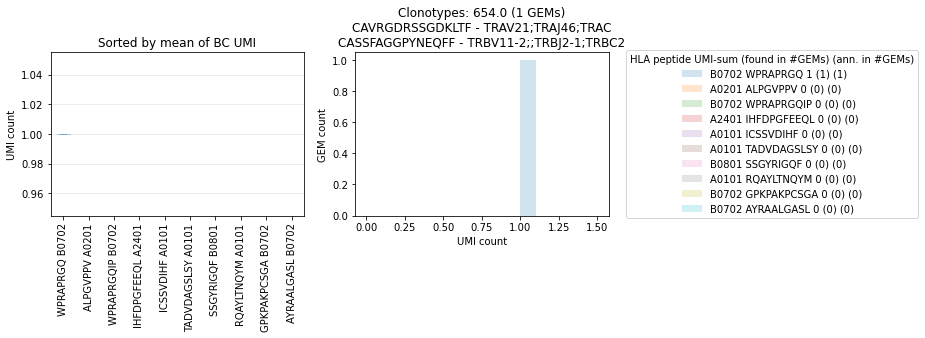

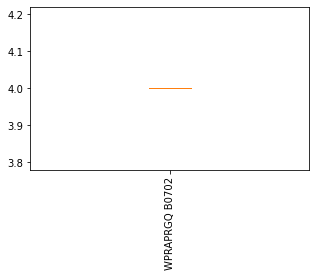

[85.]
('CASSFATDGYTF', 'CAANMDSSYKLIF') unresolved
       peptide    peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
228  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAANMDSSYKLIF   

               genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
228  ['TRAV1-1;TRAJ12;TRAC']                 4  CASSFATDGYTF   

                   genes_lst_TRB umi_count_lst_TRB  
228  ['TRBV12-4;;TRBJ1-2;TRBC1']                12  


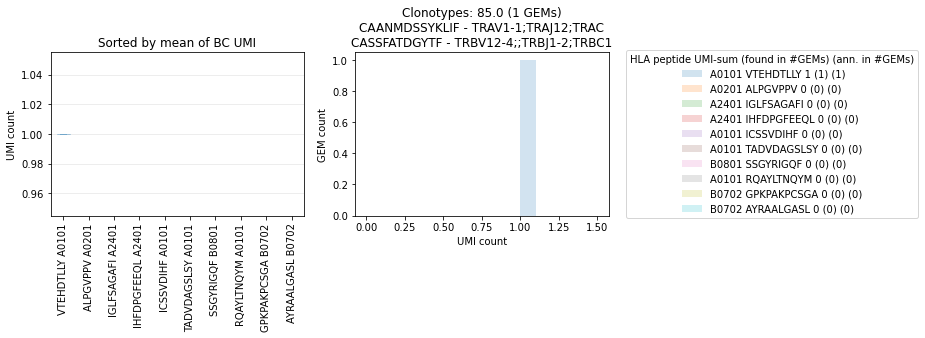

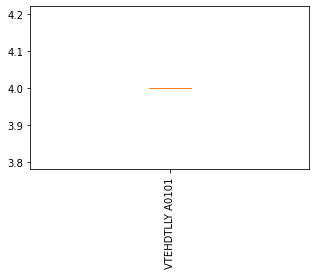

[474.]
('CASSFGDSYEQYF', 'CALSPEGFGNVLHC') unresolved
        peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1712  VTEHDTLLY  ['VTEHDTLLY']               [1]  CALSPEGFGNVLHC   

               genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1712  ['TRAV16;TRAJ35;TRAC']                 2  CASSFGDSYEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
1712  ['TRBV5-6;;TRBJ2-7;TRBC2']                 8  


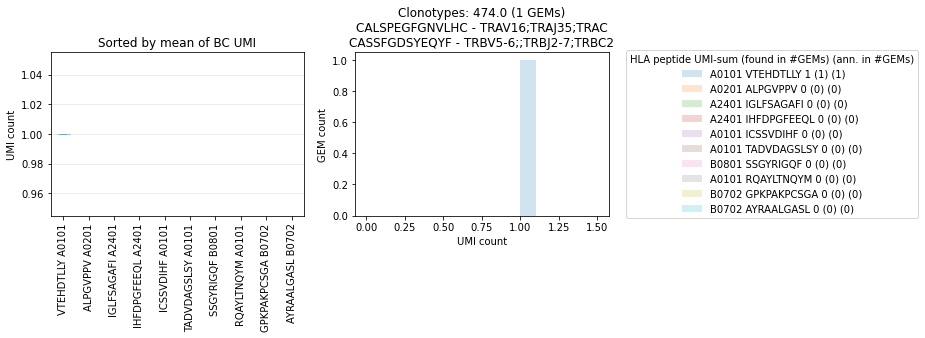

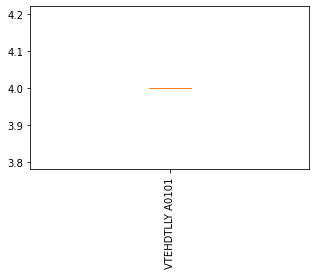

[642.]
('CASSFGGTGNQPQHF', 'CAPGPGTYKYIF') unresolved
       peptide                                        peptide_lst  \
167  VTEHDTLLY  ['EERQAYLTNQY' 'RQAYLTNQY' 'FSAGAFILYN' 'FSAGA...   

                  umi_count_lst_mhc  cdr3_lst_TRA           genes_lst_TRA  \
167  [1, 1, 1, 1, 1, 2, 7, 10, 248]  CAPGPGTYKYIF  ['TRAV21;TRAJ40;TRAC']   

    umi_count_lst_TRA     cdr3_lst_TRB                genes_lst_TRB  \
167                 1  CASSFGGTGNQPQHF  ['TRBV12-3;;TRBJ1-5;TRBC1']   

    umi_count_lst_TRB  
167                13  


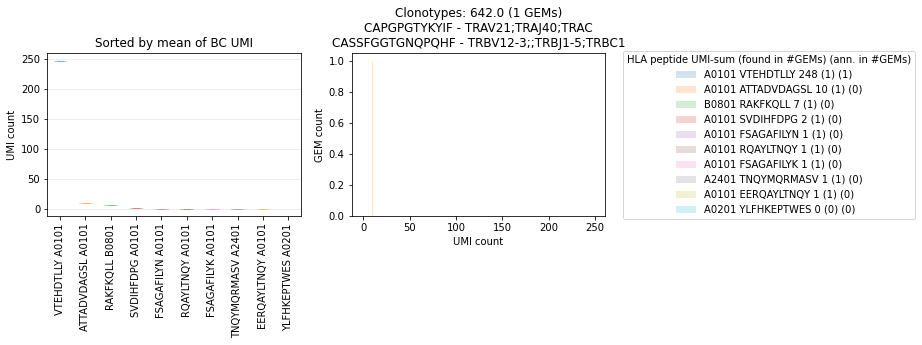

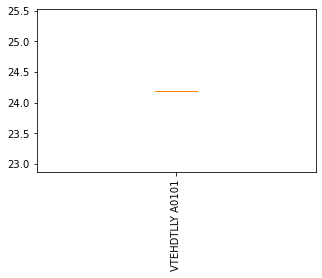

[278.]
('CASSFGLAGGELFF', 'NaN') unresolved
        peptide                 peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2186  LLFERPHTM  ['TPRVTGGGAM' 'LLFERPHTM']            [1, 1]                

     genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
2186           NaN               NaN  CASSFGLAGGELFF   

                       genes_lst_TRB umi_count_lst_TRB  
2186  ['TRBV27;TRBD2;TRBJ2-2;TRBC2']                 4  


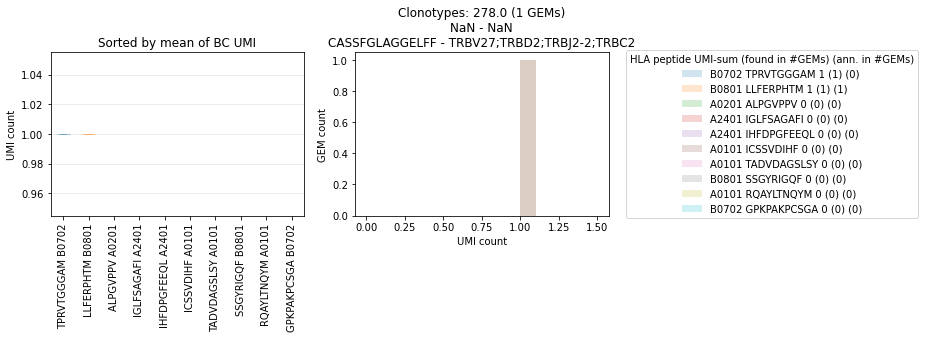

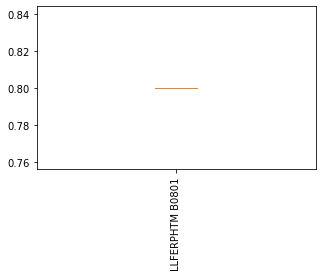

[263.]
('CASSFGQGADYEQYF', 'CVVGDNYGQNFVF') unresolved
       peptide   peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
1011  RAKFKQLL  ['RAKFKQLL']               [9]  CVVGDNYGQNFVF   

                genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
1011  ['TRAV8-2;TRAJ26;TRAC']                 7  CASSFGQGADYEQYF   

                        genes_lst_TRB umi_count_lst_TRB  
1011  ['TRBV4-1;TRBD1;TRBJ2-7;TRBC2']                12  


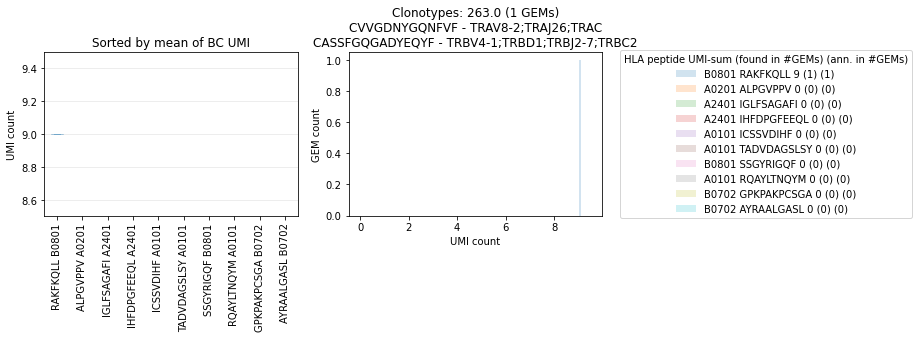

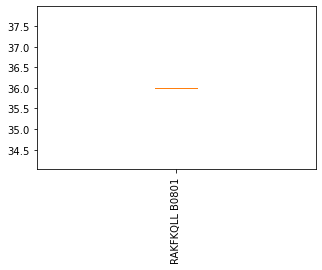

[308.]
('CASSFGQGNYGYTF', 'NaN') unresolved
          peptide      peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2131  EERQAYLTNQY  ['EERQAYLTNQY']               [1]                

     genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
2131           NaN               NaN  CASSFGQGNYGYTF   

                  genes_lst_TRB umi_count_lst_TRB  
2131  ['TRBV27;;TRBJ1-2;TRBC1']                11  


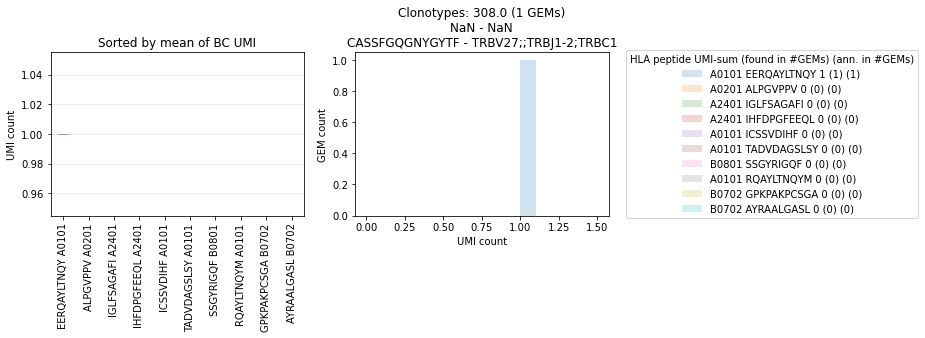

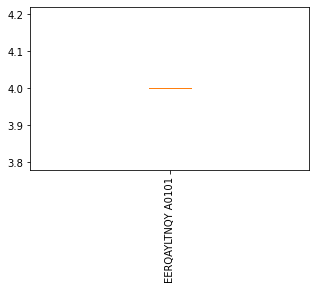

[97.]
('CASSFHSGRAVETQYF', 'CAMREGKDNDMRF') unresolved
         peptide                  peptide_lst umi_count_lst_mhc  \
145  EERQAYLTNQY  ['VTEHDTLLY' 'EERQAYLTNQY']            [1, 1]   

      cdr3_lst_TRA               genes_lst_TRA umi_count_lst_TRA  \
145  CAMREGKDNDMRF  ['TRAV14/DV4;TRAJ43;TRAC']                 5   

         cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
145  CASSFHSGRAVETQYF  ['TRBV28;;TRBJ2-5;TRBC2']                 6  


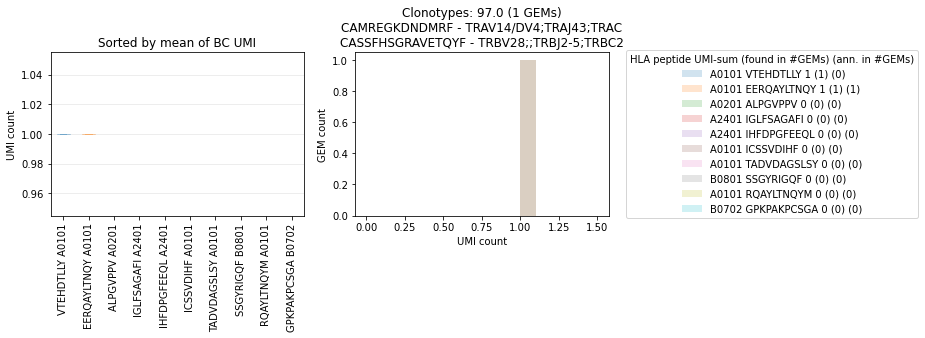

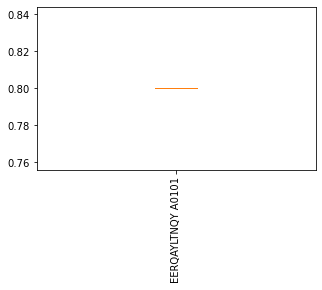

[286.]
('CASSFRVRALEAFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2243  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB              genes_lst_TRB  \
2243               NaN  CASSFRVRALEAFF  ['TRBV28;;TRBJ1-1;TRBC1']   

     umi_count_lst_TRB  
2243                 6  


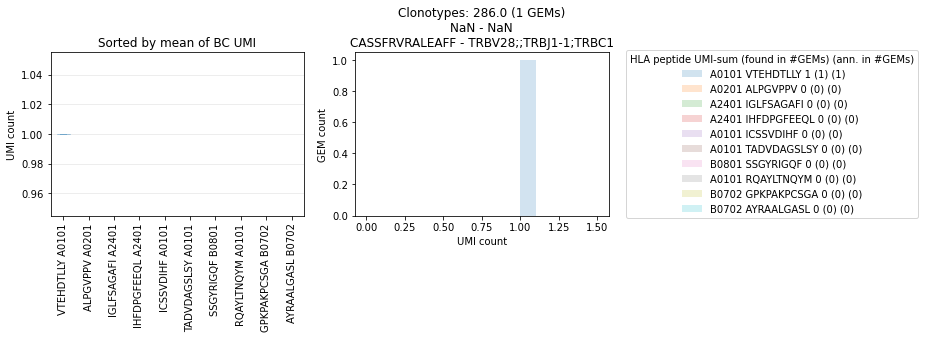

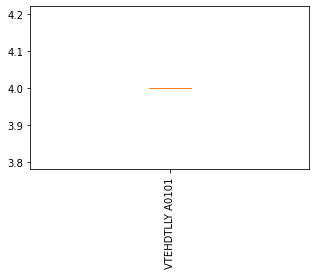

[586.]
('CASSFTIGTGELFF', 'CAGWNRDDKIIF') unresolved
       peptide                            peptide_lst umi_count_lst_mhc  \
1807  RAKFKQLL  ['TPRVTGGGAM' 'LLFERPHTM' 'RAKFKQLL']        [1, 2, 35]   

      cdr3_lst_TRA           genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1807  CAGWNRDDKIIF  ['TRAV27;TRAJ30;TRAC']                 3  CASSFTIGTGELFF   

                   genes_lst_TRB umi_count_lst_TRB  
1807  ['TRBV5-4;;TRBJ2-2;TRBC2']                 9  


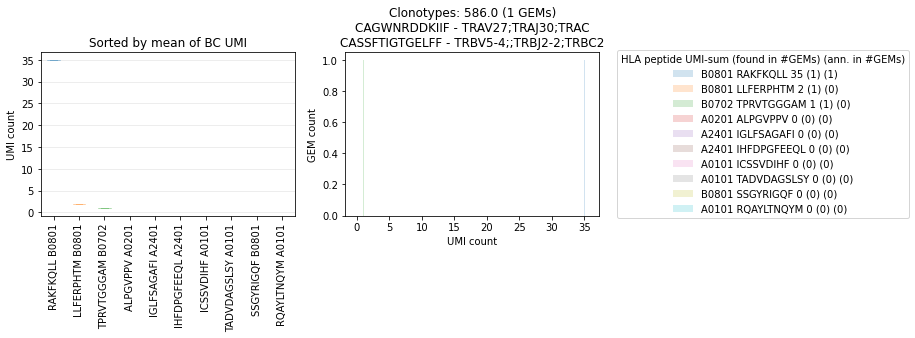

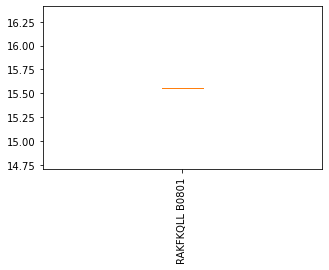

[535.]
('CASSFVEDTIYF', 'CAGFNQGGKLIF') resolved by trash bin
        peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1678  RTMFWGPEV  ['RTMFWGPEV']               [1]  CAGFNQGGKLIF   

                 genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
1678  ['TRAV12-2;TRAJ23;TRAC']                 3  CASSFVEDTIYF   

                  genes_lst_TRB umi_count_lst_TRB  
1678  ['TRBV28;;TRBJ1-3;TRBC1']                 9  


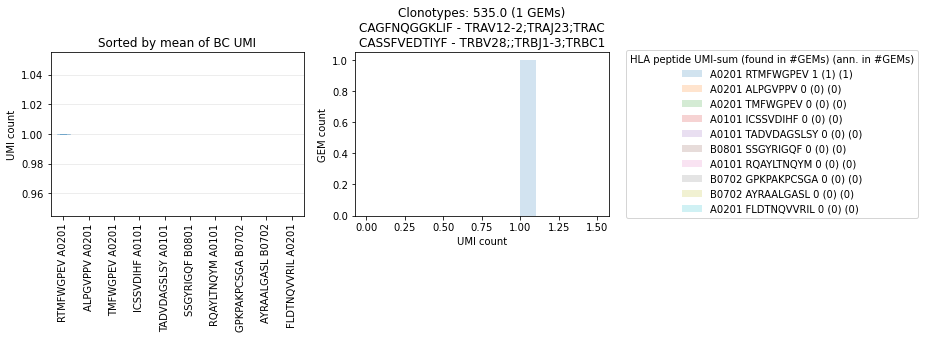

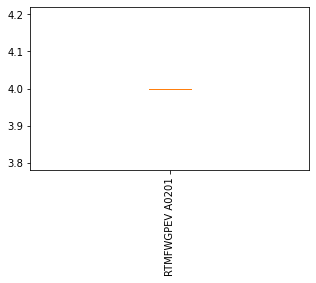

[302.]
('CASSFVGNSPLHF', 'NaN') unresolved
          peptide      peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2415  EERQAYLTNQY  ['EERQAYLTNQY']               [1]                

     genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
2415           NaN               NaN  CASSFVGNSPLHF   

                  genes_lst_TRB umi_count_lst_TRB  
2415  ['TRBV27;;TRBJ1-6;TRBC1']                 4  


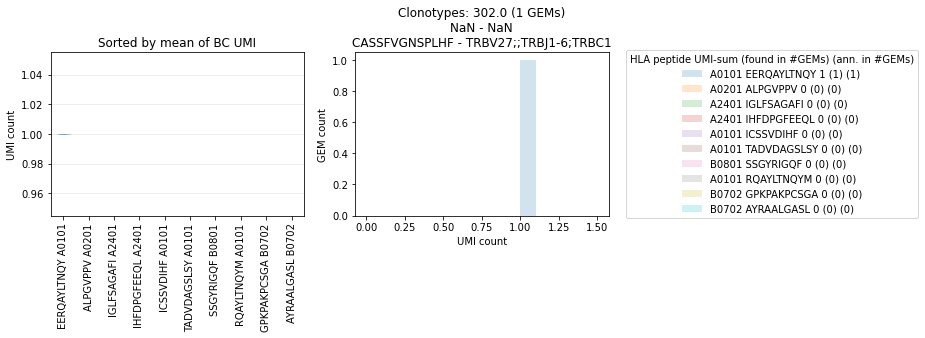

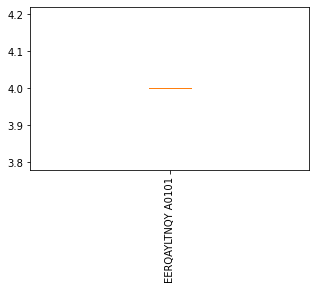

[580.]
('CASSFVRTDEQYF', 'CAVRTPYNQGGKLIF') unresolved
       peptide   peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1850  RAKFKQLL  ['RAKFKQLL']               [1]  CAVRTPYNQGGKLIF   

              genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1850  ['TRAV3;TRAJ23;TRAC']                 6  CASSFVRTDEQYF   

                    genes_lst_TRB umi_count_lst_TRB  
1850  ['TRBV12-4;;TRBJ2-7;TRBC2']                 7  


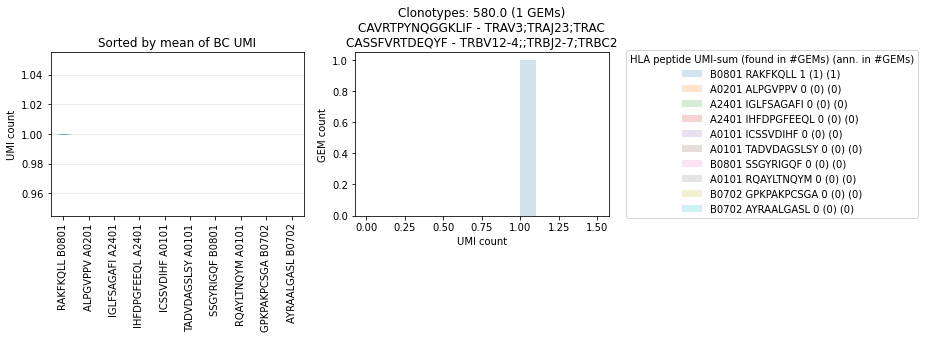

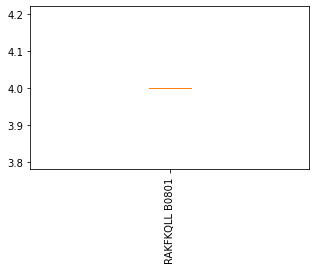

[365.]
('CASSFVYNEQFF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2316  RAKFKQLL  ['RAKFKQLL']               [2]                        NaN   

     umi_count_lst_TRA  cdr3_lst_TRB                genes_lst_TRB  \
2316               NaN  CASSFVYNEQFF  ['TRBV11-2;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2316                 7  


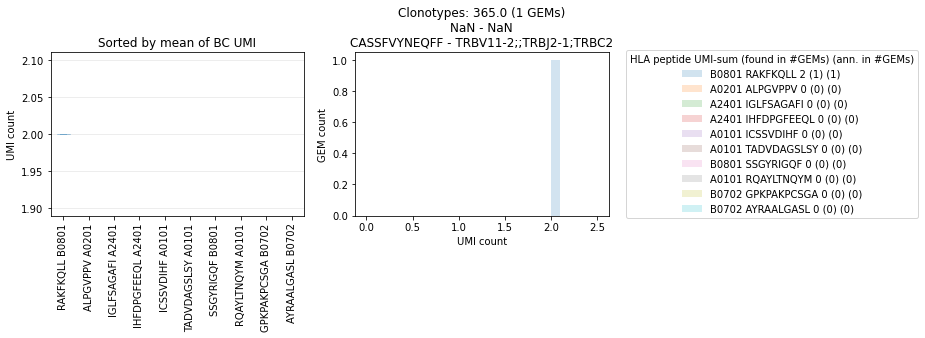

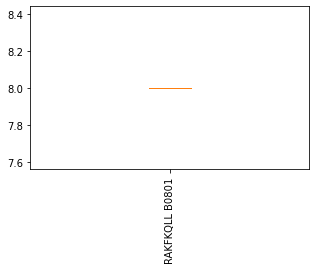

[673.]
('CASSGARERDGEQYF', 'CAVVLGSARQLTF') unresolved
       peptide     peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
59  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CAVVLGSARQLTF   

            genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
59  ['TRAV2;TRAJ22;TRAC']                 1  CASSGARERDGEQYF   

                 genes_lst_TRB umi_count_lst_TRB  
59  ['TRBV6-1;;TRBJ2-7;TRBC2']                 3  


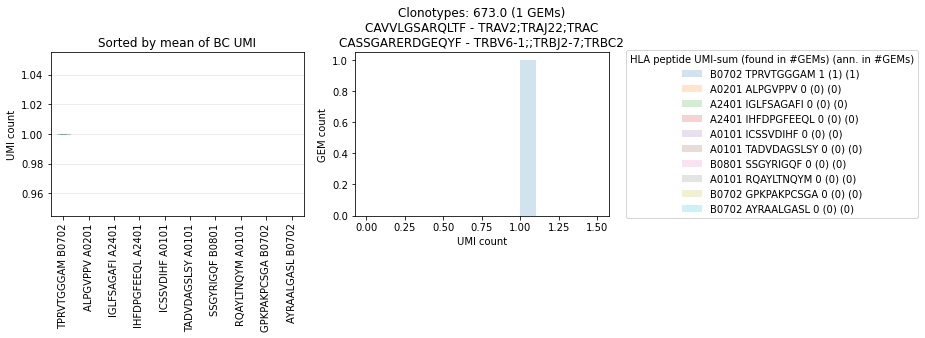

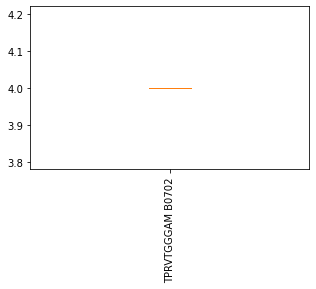

[377.]
('CASSGGLLSGYEQYF', 'NaN') unresolved
       peptide               peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2126  RAKFKQLL  ['VTEHDTLLY' 'RAKFKQLL']            [1, 1]                

     genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2126           NaN               NaN  CASSGGLLSGYEQYF   

                    genes_lst_TRB umi_count_lst_TRB  
2126  ['TRBV25-1;;TRBJ2-7;TRBC2']                 6  


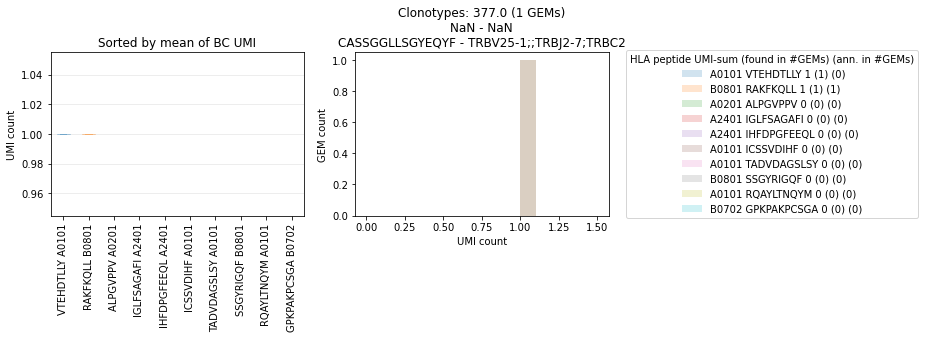

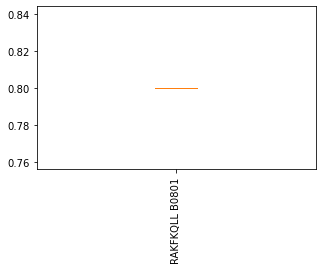

[378.]
('CASSGGPYNSPLHF', 'NaN') unresolved
         peptide     peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2275  TPRVTGGGAM  ['TPRVTGGGAM']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB              genes_lst_TRB  \
2275               NaN  CASSGGPYNSPLHF  ['TRBV19;;TRBJ1-6;TRBC1']   

     umi_count_lst_TRB  
2275                 2  


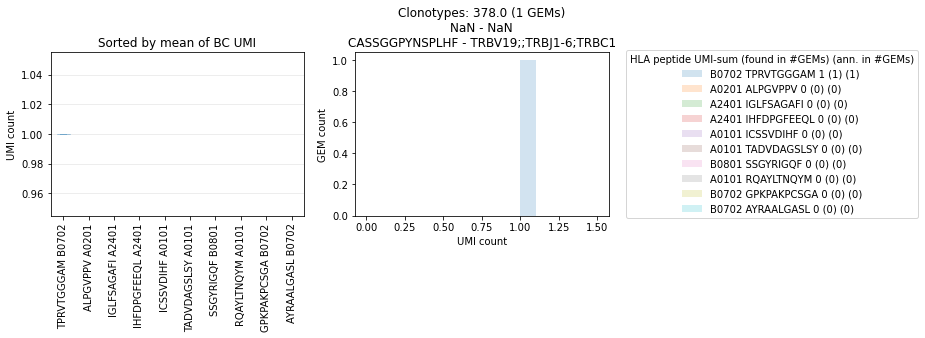

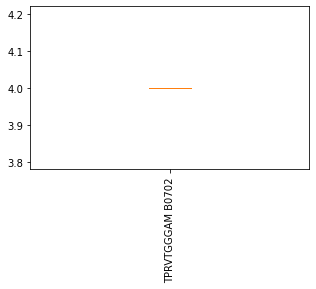

[141.]
('CASSGGQAGLDTQYF', 'CATASPESGAGSYQLTF') unresolved
        peptide      peptide_lst umi_count_lst_mhc       cdr3_lst_TRA  \
81  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CATASPESGAGSYQLTF   

             genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
81  ['TRAV17;TRAJ28;TRAC']                 1  CASSGGQAGLDTQYF   

                      genes_lst_TRB umi_count_lst_TRB  
81  ['TRBV6-1;TRBD1;TRBJ2-3;TRBC2']                 1  


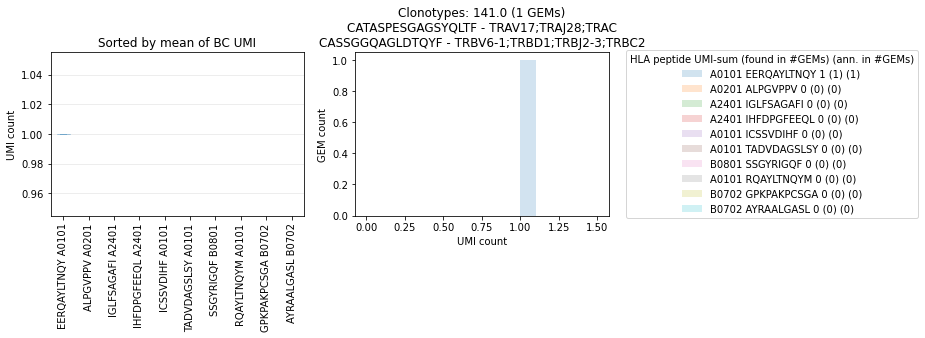

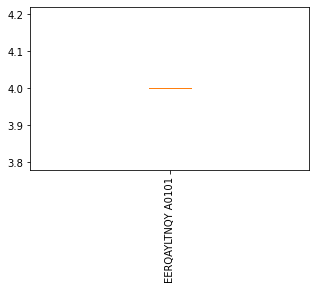

[464.]
('CASSGRGTGTGVDYEQYF', 'CALIGISSGSARQLTF') unresolved
     peptide   peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
51  RAKFKQLL  ['RAKFKQLL']               [1]  CALIGISSGSARQLTF   

             genes_lst_TRA umi_count_lst_TRA        cdr3_lst_TRB  \
51  ['TRAV19;TRAJ22;TRAC']                 7  CASSGRGTGTGVDYEQYF   

                      genes_lst_TRB umi_count_lst_TRB  
51  ['TRBV5-1;TRBD1;TRBJ2-7;TRBC2']                11  


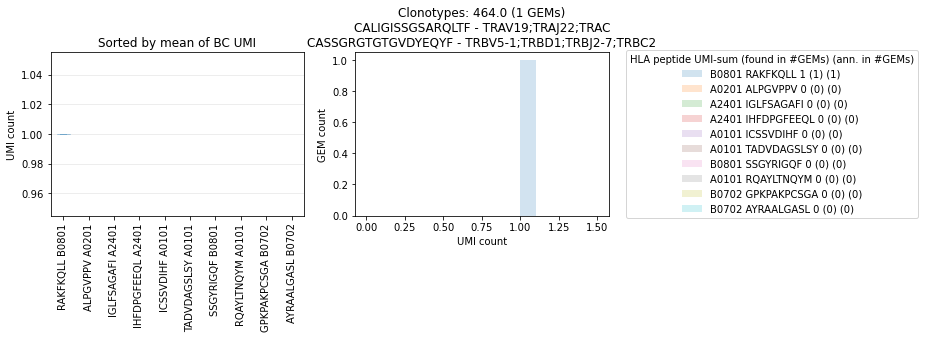

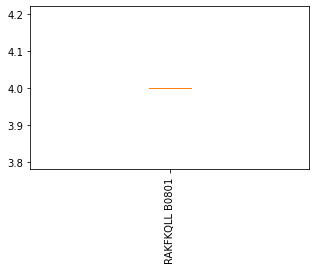

[388.]
('CASSGSDRGGYGYTF', 'NaN') unresolved
       peptide                                        peptide_lst  \
2408  ALPGVPPV  ['RAKFKQLL' 'FISPQLQRI' 'IRHKRQSW' 'VTEHDTLLY'...   

         umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2408  [1, 1, 1, 2, 10, 29]                        NaN               NaN   

         cdr3_lst_TRB                    genes_lst_TRB umi_count_lst_TRB  
2408  CASSGSDRGGYGYTF  ['TRBV6-5;TRBD1;TRBJ1-2;TRBC1']                 4  


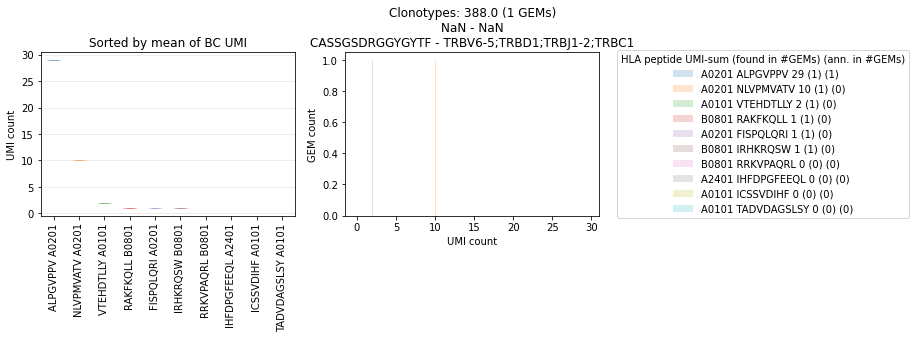

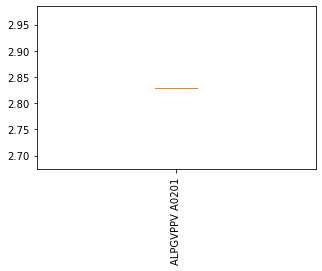

[328.]
('CASSHDGTFGGKDTQYF', 'NaN') unresolved
        peptide                            peptide_lst umi_count_lst_mhc  \
2310  LLFERPHTM  ['RAKFKQLL' 'TPRVTGGGAM' 'LLFERPHTM']         [1, 1, 1]   

     cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA       cdr3_lst_TRB  \
2310                        NaN               NaN  CASSHDGTFGGKDTQYF   

                   genes_lst_TRB umi_count_lst_TRB  
2310  ['TRBV4-1;;TRBJ2-3;TRBC2']                 6  


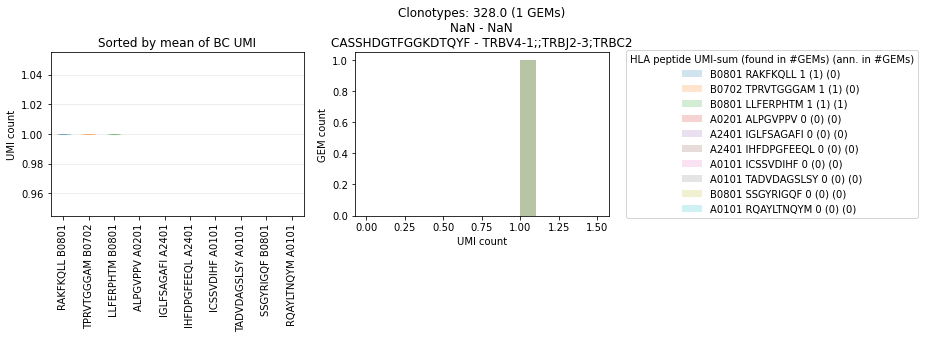

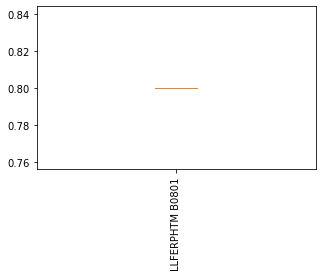

[453.]
('CASSHSRGPDNEQFF', 'CATVSSDGQKLLF') unresolved
       peptide   peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
1584  RAKFKQLL  ['RAKFKQLL']               [2]  CATVSSDGQKLLF   

               genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
1584  ['TRAV17;TRAJ16;TRAC']                 2  CASSHSRGPDNEQFF   

                    genes_lst_TRB umi_count_lst_TRB  
1584  ['TRBV10-1;;TRBJ2-1;TRBC2']                17  


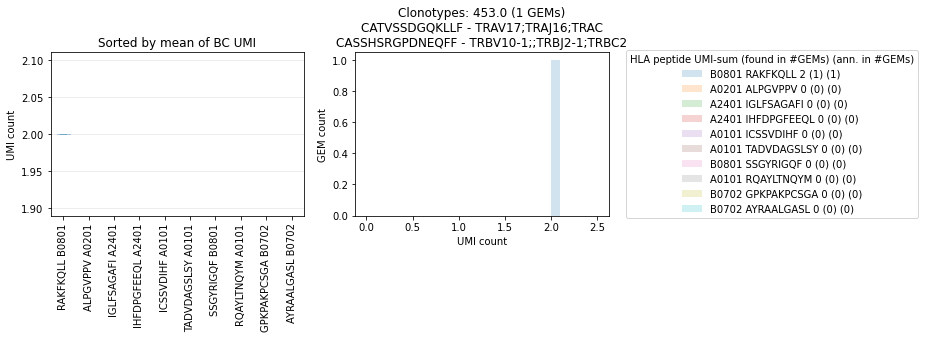

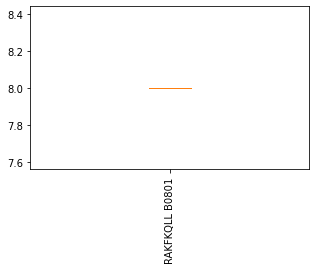

[119.]
('CASSIGWGRSYNEQFF', 'NaN') unresolved
        peptide                  peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2389  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 24]                

     genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
2389           NaN               NaN  CASSIGWGRSYNEQFF   

                  genes_lst_TRB umi_count_lst_TRB  
2389  ['TRBV19;;TRBJ2-1;TRBC2']                 1  


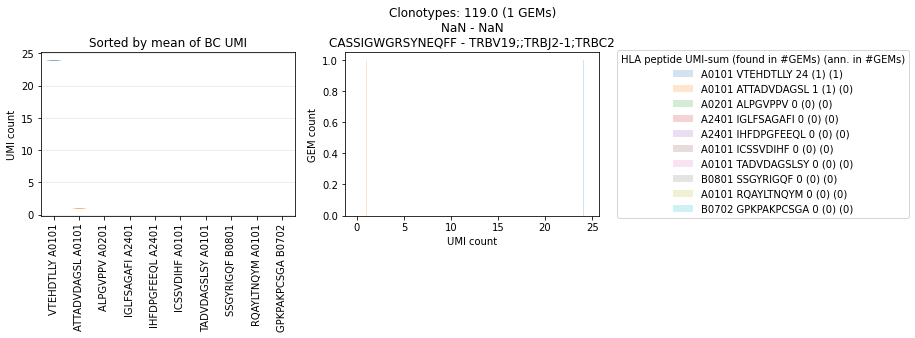

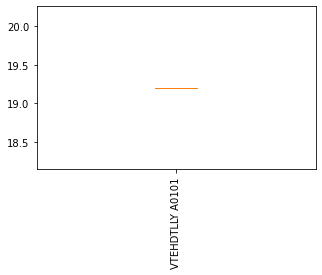

[270.]
('CASSISGDTGELFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2399  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB             genes_lst_TRB  \
2399               NaN  CASSISGDTGELFF  ['TRBV9;;TRBJ2-2;TRBC2']   

     umi_count_lst_TRB  
2399                 5  


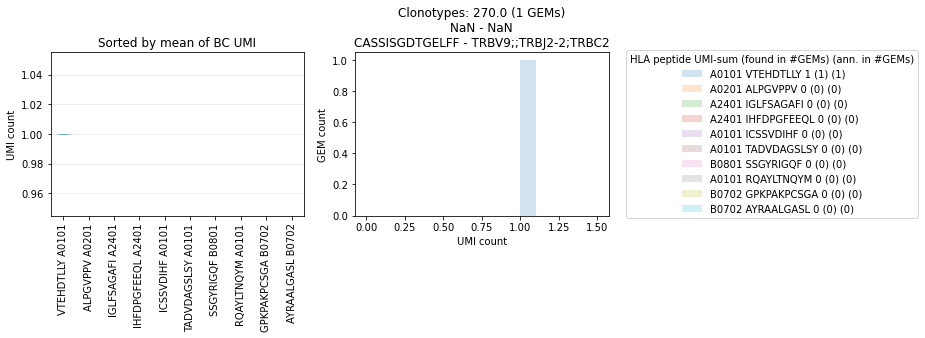

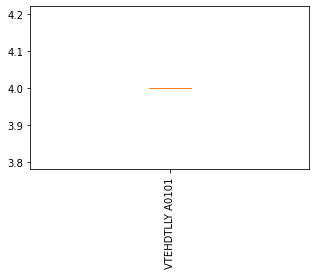

[622.]
('CASSISVAGEQFF', 'CAVNYGNKLVF') unresolved
        peptide                 peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
1791  VTEHDTLLY  ['TPRVTGGGAM' 'VTEHDTLLY']            [1, 2]  CAVNYGNKLVF   

              genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1791  ['TRAV3;TRAJ47;TRAC']                 2  CASSISVAGEQFF   

                  genes_lst_TRB umi_count_lst_TRB  
1791  ['TRBV19;;TRBJ2-1;TRBC2']                14  


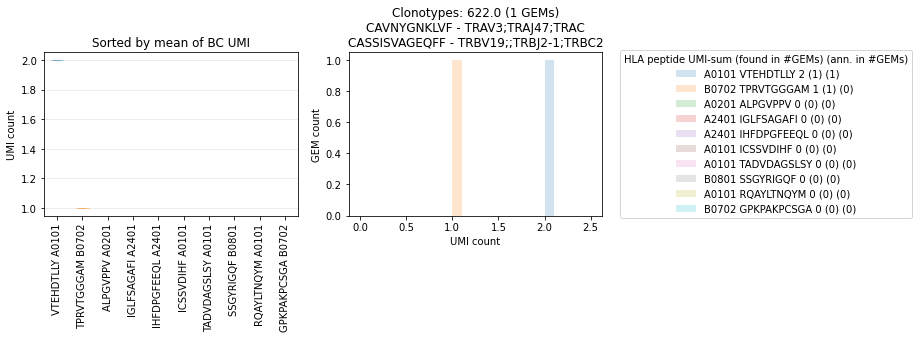

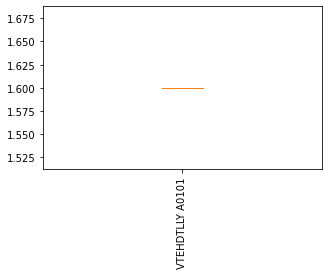

[347.]
('CASSITQVGTEAFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2079  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB              genes_lst_TRB  \
2079               NaN  CASSITQVGTEAFF  ['TRBV19;;TRBJ1-1;TRBC1']   

     umi_count_lst_TRB  
2079                 6  


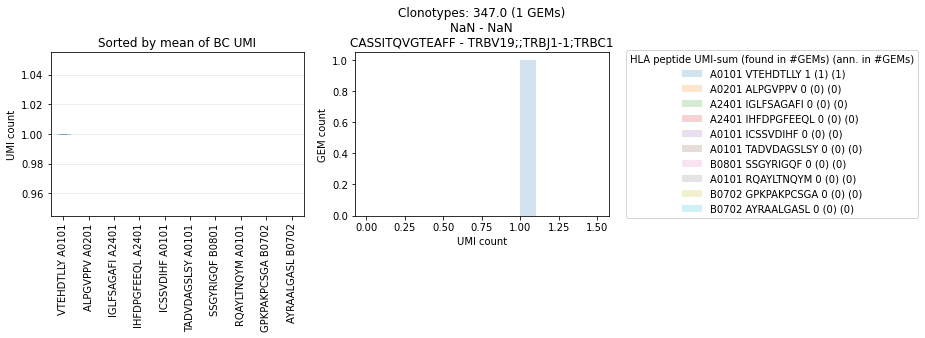

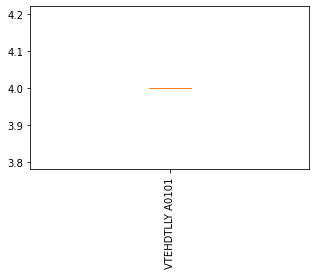

[681.]
('CASSKTVSRDRIRNTIYF', 'CAGPVGSSNTGKLIF') unresolved
        peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1842  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAGPVGSSNTGKLIF   

               genes_lst_TRA umi_count_lst_TRA        cdr3_lst_TRB  \
1842  ['TRAV25;TRAJ37;TRAC']                 3  CASSKTVSRDRIRNTIYF   

                       genes_lst_TRB umi_count_lst_TRB  
1842  ['TRBV19;TRBD1;TRBJ1-3;TRBC1']                 6  


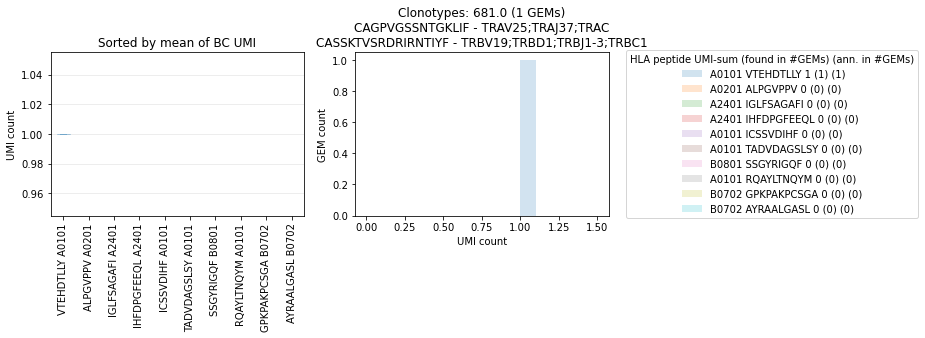

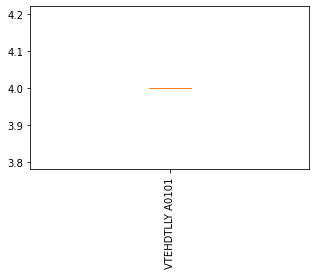

[248.]
('CASSLEASGHPYEQYF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2322  VTEHDTLLY  ['GMAEGATTA' 'RQAYLTNQY' 'TADVDAGSLS' 'QAYLTNQ...   

        umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2322  [1, 1, 1, 1, 2, 38]                        NaN               NaN   

          cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
2322  CASSLEASGHPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']                 2  


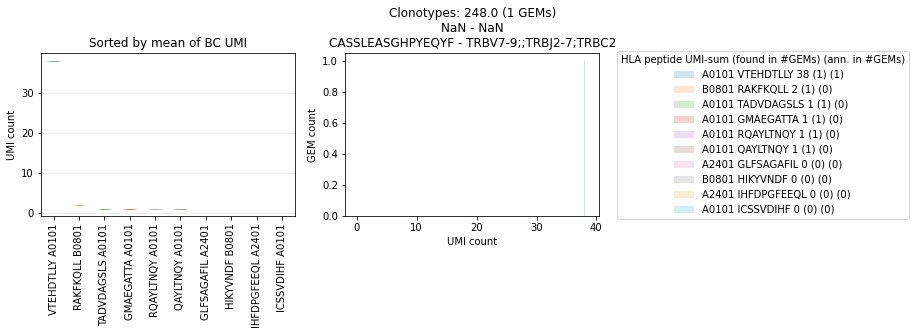

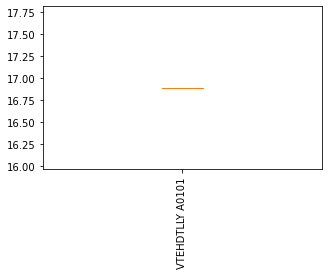

[252.]
('CASSLEGGDRPYEQYF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2087  VTEHDTLLY  ['TPRVTGGGAM' 'EERQAYLTNQY' 'RAKFKQLL' 'SVDIHF...   

     umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2087  [1, 1, 2, 2, 53]                        NaN               NaN   

          cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
2087  CASSLEGGDRPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']                12  


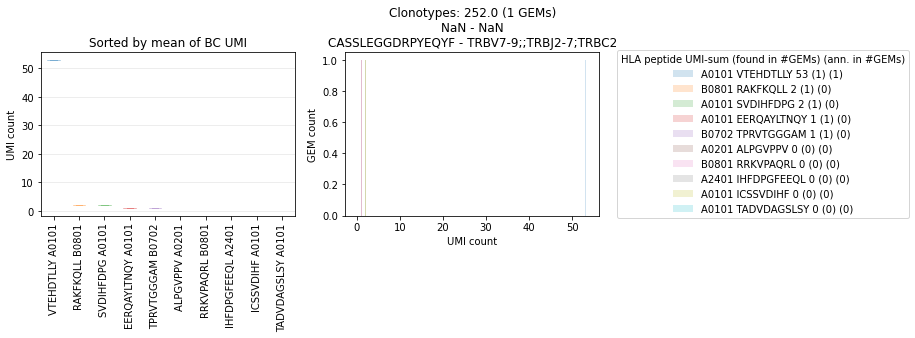

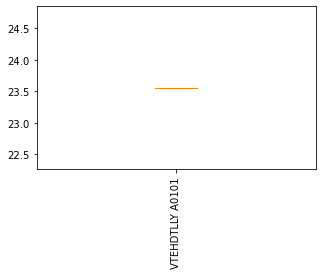

[550.]
('CASSLELAGGEQFF', 'CAVIGRWNNAGNMLTF') unresolved
       peptide   peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
1383  RAKFKQLL  ['RAKFKQLL']               [3]  CAVIGRWNNAGNMLTF   

                genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1383  ['TRAV1-2;TRAJ39;TRAC']                 2  CASSLELAGGEQFF   

                        genes_lst_TRB umi_count_lst_TRB  
1383  ['TRBV7-8;TRBD2;TRBJ2-1;TRBC2']                23  


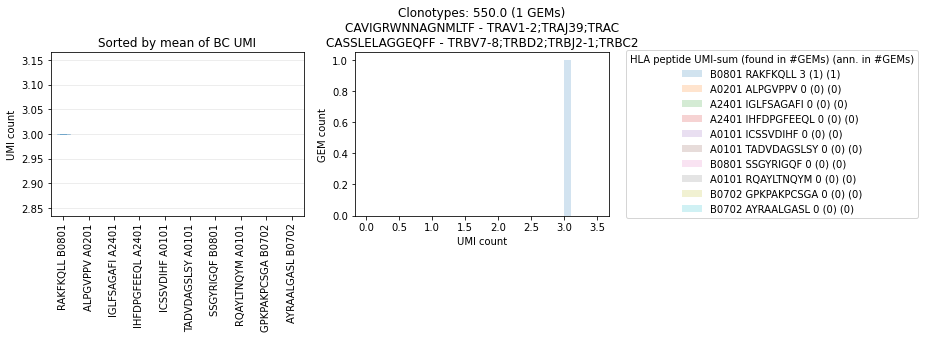

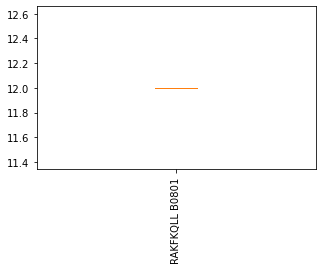

[598.]
('CASSLEYGVRPYEQYF', 'CAARAGSYQLTF') unresolved
       peptide                                        peptide_lst  \
756  VTEHDTLLY  ['YPLVKMRLS' 'FSAGAFILYK' 'TNQYMQRMASV' 'CSSVD...   

                 umi_count_lst_mhc  cdr3_lst_TRA               genes_lst_TRA  \
756  [1, 1, 1, 1, 1, 2, 3, 6, 151]  CAARAGSYQLTF  ['TRAV29/DV5;TRAJ28;TRAC']   

    umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
756                 2  CASSLEYGVRPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']   

    umi_count_lst_TRB  
756                 9  


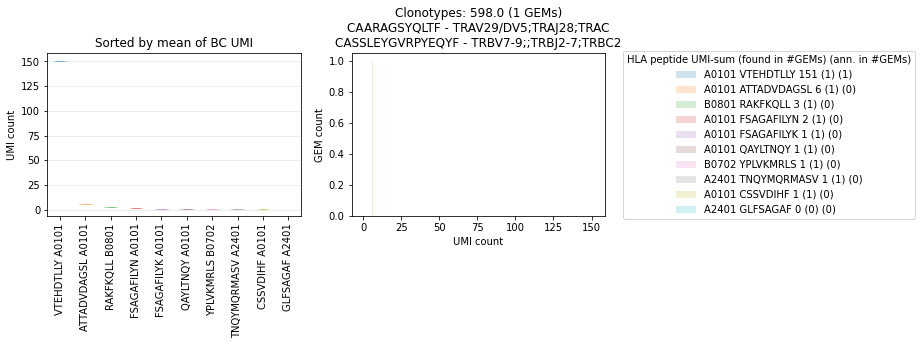

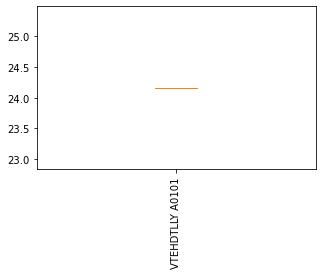

[253.]
('CASSLEYGVRPYEQYF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2384  VTEHDTLLY  ['VTEHDTLLY']              [25]                        NaN   

     umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
2384               NaN  CASSLEYGVRPYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
2384                11  


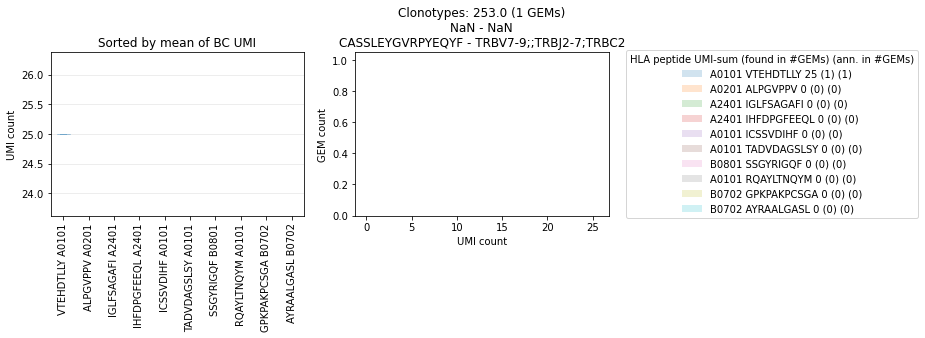

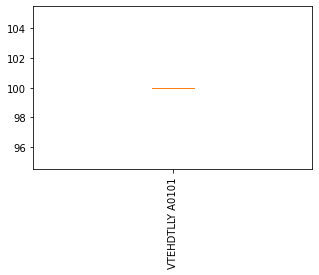

[133.]
('CASSLGATNEKLFF', 'CAAILGYQKVTF') unresolved
       peptide   peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1904  RAKFKQLL  ['RAKFKQLL']               [1]  CAAILGYQKVTF   

                   genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1904  ['TRAV29/DV5;TRAJ13;TRAC']                 7  CASSLGATNEKLFF   

                   genes_lst_TRB umi_count_lst_TRB  
1904  ['TRBV7-9;;TRBJ1-4;TRBC1']                11  


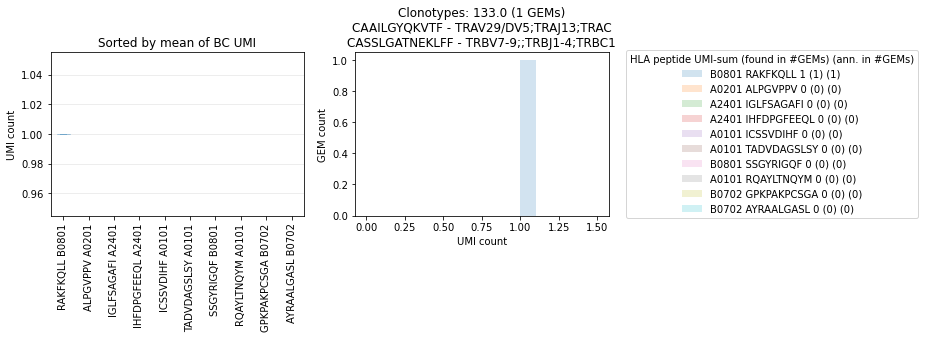

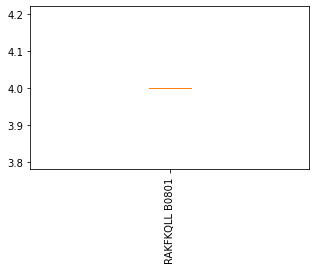

[315.]
('CASSLGGLETQYF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2286  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA   cdr3_lst_TRB               genes_lst_TRB  \
2286               NaN  CASSLGGLETQYF  ['TRBV5-1;;TRBJ2-5;TRBC2']   

     umi_count_lst_TRB  
2286                12  


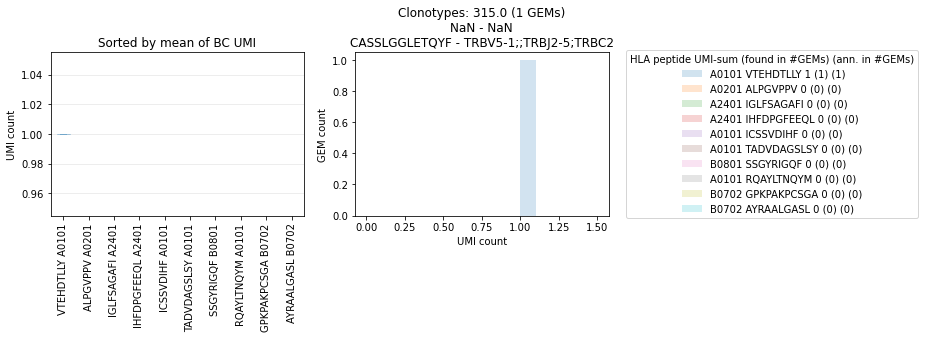

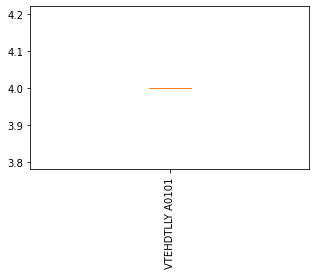

[256.]
('CASSLGGYEQYF', 'CASPHQAGTALIF') unresolved
        peptide     peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
281  TADVDAGSLS  ['TADVDAGSLS']               [1]  CASPHQAGTALIF   

               genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
281  ['TRAV8-3;TRAJ15;TRAC']                 2  CASSLGGYEQYF   

                  genes_lst_TRB umi_count_lst_TRB  
281  ['TRBV5-4;;TRBJ2-7;TRBC2']                 7  


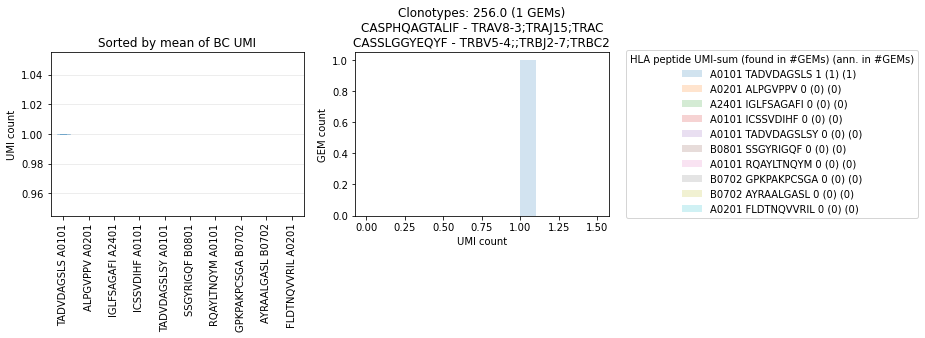

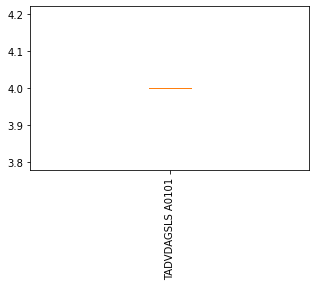

[521.]
('CASSLGPENTEAFF', 'CAVIRRQAGTALIF') unresolved
        peptide      peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
45  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAVIRRQAGTALIF   

              genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
45  ['TRAV1-2;TRAJ15;TRAC']                 1  CASSLGPENTEAFF   

                 genes_lst_TRB umi_count_lst_TRB  
45  ['TRBV7-9;;TRBJ1-1;TRBC1']                10  


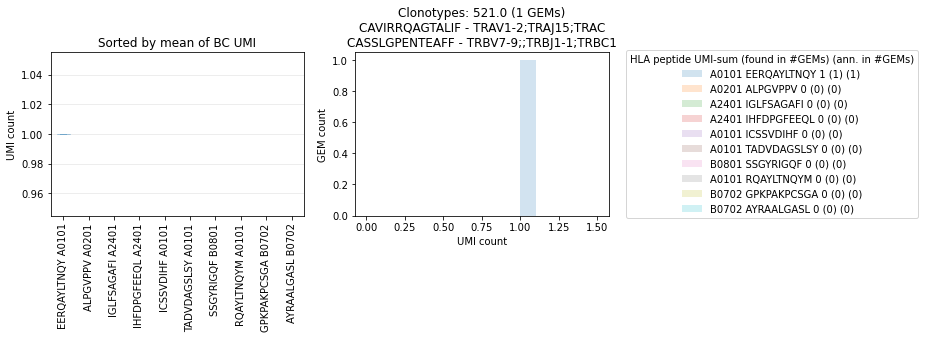

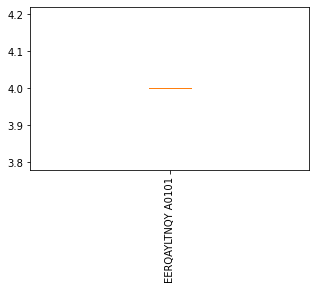

[593.]
('CASSLGPLETHGAQYF', 'CAAGYNFNKFYF') unresolved
        peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1599  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAAGYNFNKFYF   

                   genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
1599  ['TRAV29/DV5;TRAJ21;TRAC']                 2  CASSLGPLETHGAQYF   

                   genes_lst_TRB umi_count_lst_TRB  
1599  ['TRBV7-8;;TRBJ2-5;TRBC2']                10  


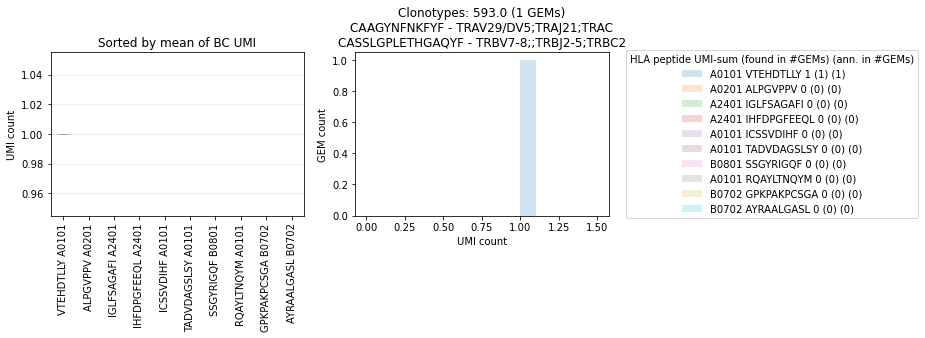

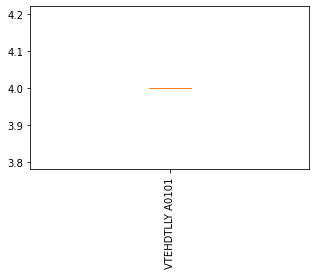

[406.]
('CASSLGQGGYEQYF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2342  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB                    genes_lst_TRB  \
2342               NaN  CASSLGQGGYEQYF  ['TRBV7-2;TRBD1;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
2342                19  


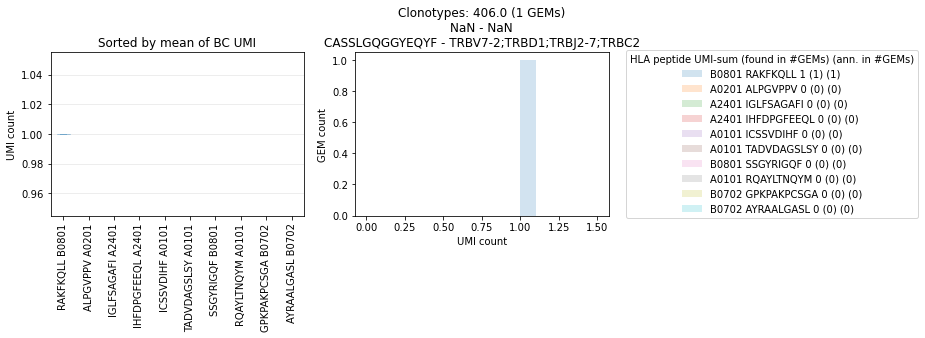

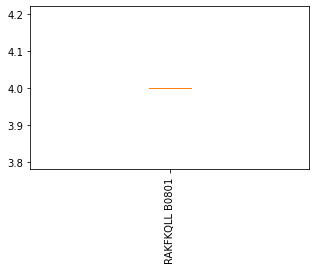

[242.]
('CASSLGQGNTEAFF', 'CLVADQTGANNLFF') unresolved
       peptide               peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1662  RAKFKQLL  ['NLVPMVATV' 'RAKFKQLL']            [1, 1]  CLVADQTGANNLFF   

              genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1662  ['TRAV4;TRAJ36;TRAC']                 2  CASSLGQGNTEAFF   

                        genes_lst_TRB umi_count_lst_TRB  
1662  ['TRBV5-6;TRBD1;TRBJ1-1;TRBC1']                 8  


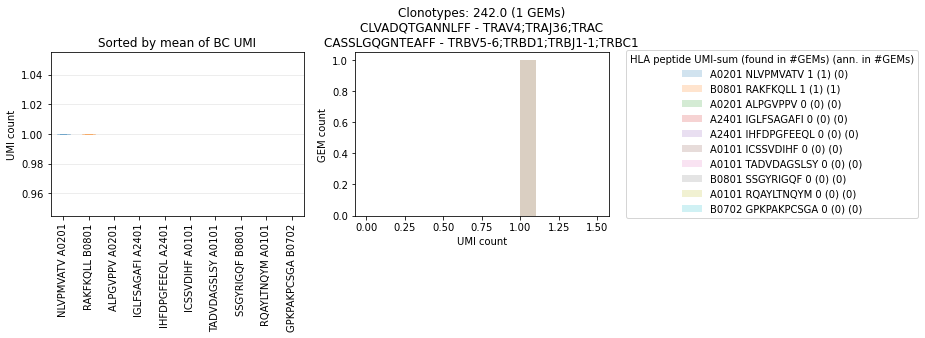

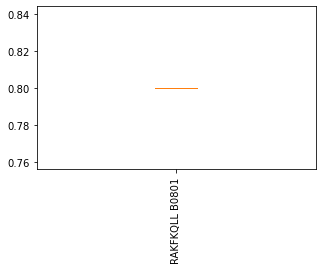

[652.]
('CASSLGRGGTYEQYF', 'CAVKHGMRF') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
1361  VTEHDTLLY  ['VTEHDTLLY']               [1]    CAVKHGMRF   

               genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
1361  ['TRAV21;TRAJ43;TRAC']                 4  CASSLGRGGTYEQYF   

                  genes_lst_TRB umi_count_lst_TRB  
1361  ['TRBV27;;TRBJ2-7;TRBC2']                 2  


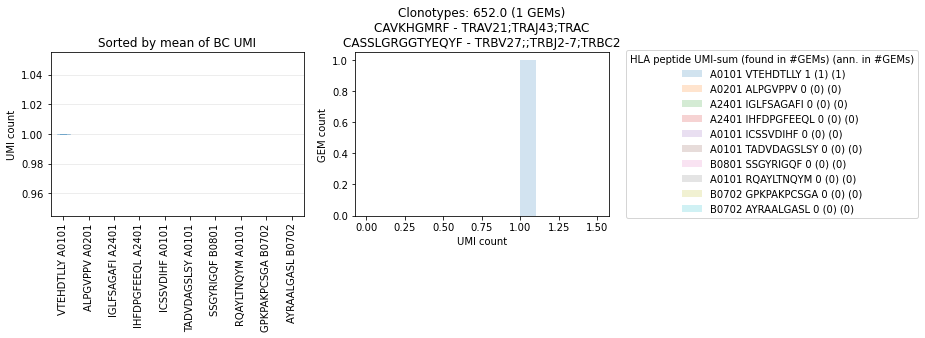

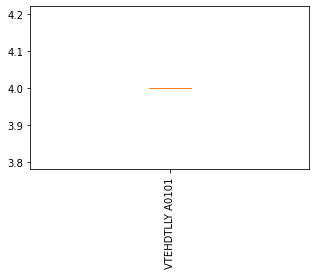

[632.]
('CASSLGSSPKTQYF', 'CAGLRFKAAGNKLTF') unresolved
        peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1556  VIRHKRQSW  ['VIRHKRQSW']               [1]  CAGLRFKAAGNKLTF   

               genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1556  ['TRAV35;TRAJ17;TRAC']                 3  CASSLGSSPKTQYF   

                  genes_lst_TRB umi_count_lst_TRB  
1556  ['TRBV27;;TRBJ2-3;TRBC2']                 7  


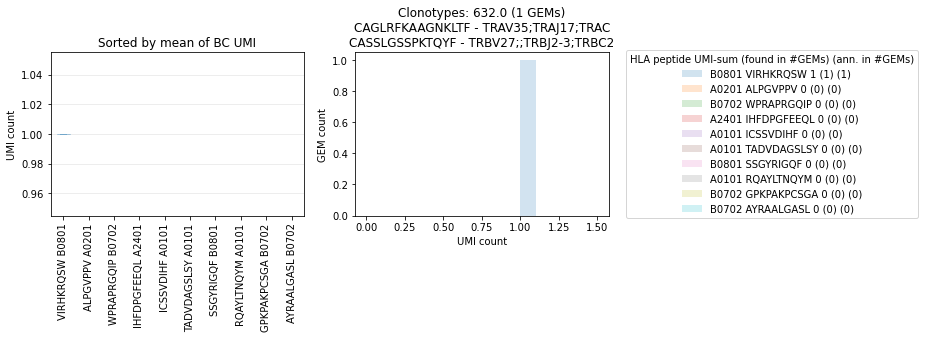

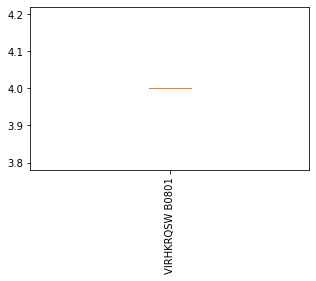

[289.]
('CASSLGSSPYEQYF', 'NaN') unresolved
        peptide                  peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2257  VTEHDTLLY  ['EERQAYLTNQY' 'VTEHDTLLY']            [1, 2]                

     genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
2257           NaN               NaN  CASSLGSSPYEQYF   

                  genes_lst_TRB umi_count_lst_TRB  
2257  ['TRBV27;;TRBJ2-7;TRBC2']                 5  


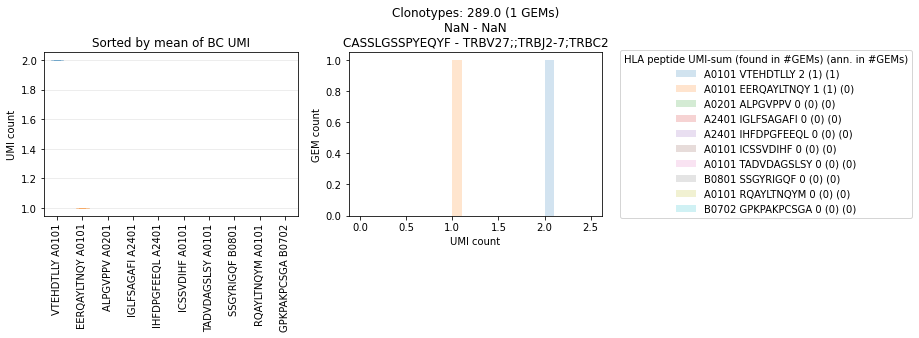

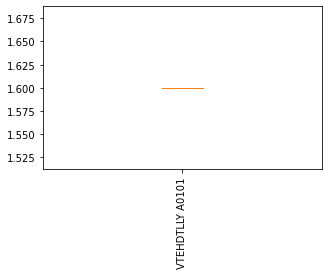

[271.]
('CASSLGTGELFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2156  VTEHDTLLY  ['VTEHDTLLY']               [2]                        NaN   

     umi_count_lst_TRA  cdr3_lst_TRB             genes_lst_TRB  \
2156               NaN  CASSLGTGELFF  ['TRBV9;;TRBJ2-2;TRBC2']   

     umi_count_lst_TRB  
2156                 2  


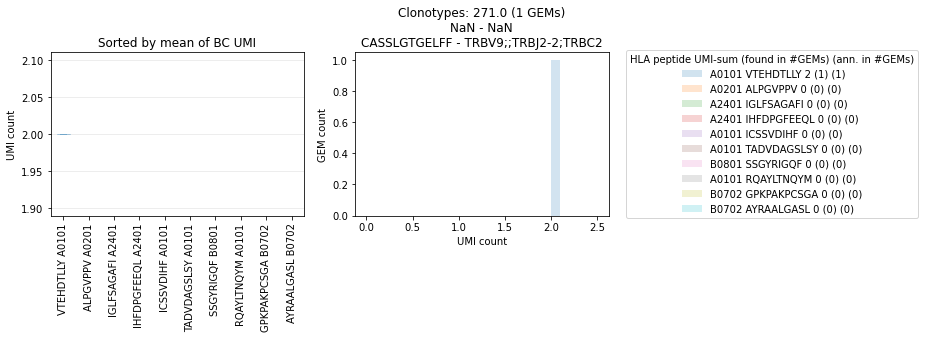

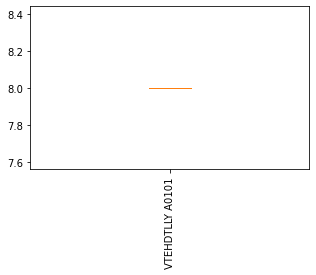

[117.]
('CASSLGTGNIYGYTF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2406  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB                   genes_lst_TRB  \
2406               NaN  CASSLGTGNIYGYTF  ['TRBV27;TRBD1;TRBJ1-2;TRBC1']   

     umi_count_lst_TRB  
2406                 5  


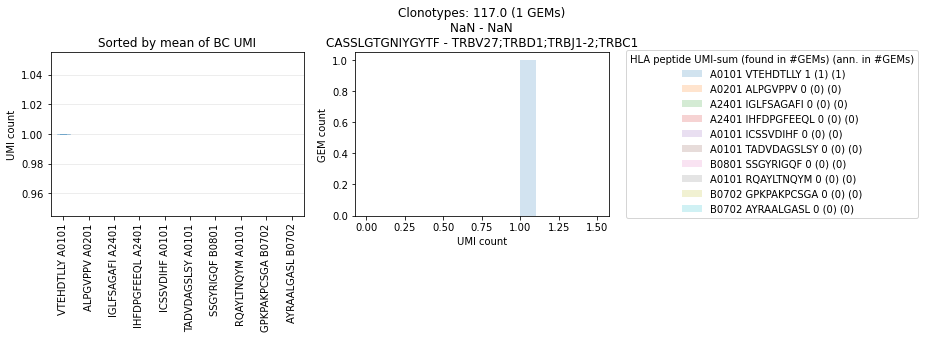

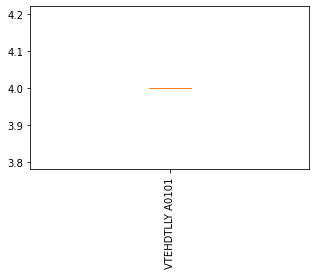

[198.]
('CASSLGTSGNTGELFF', 'CAPNNQGGKLIF') resolved by trash bin
         peptide     peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1661  IHFDPGFEEQ  ['IHFDPGFEEQ']               [1]  CAPNNQGGKLIF   

                genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
1661  ['TRAV9-2;TRAJ23;TRAC']                 2  CASSLGTSGNTGELFF   

                        genes_lst_TRB umi_count_lst_TRB  
1661  ['TRBV5-6;TRBD2;TRBJ2-2;TRBC2']                 7  


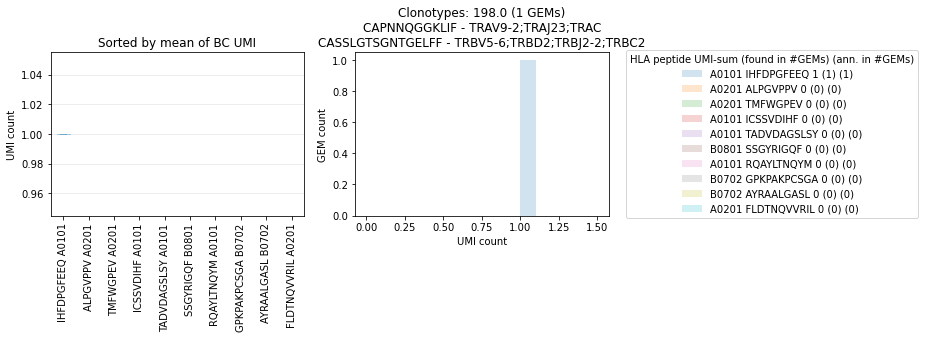

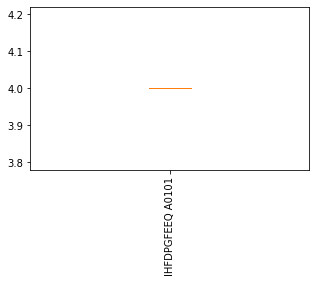

[447.]
('CASSLGTSNYGYTF', 'CAMREVGNNDMRF') unresolved
        peptide    peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
1673  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAMREVGNNDMRF   

                   genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1673  ['TRAV14/DV4;TRAJ43;TRAC']                 2  CASSLGTSNYGYTF   

                    genes_lst_TRB umi_count_lst_TRB  
1673  ['TRBV11-2;;TRBJ1-2;TRBC1']                 6  


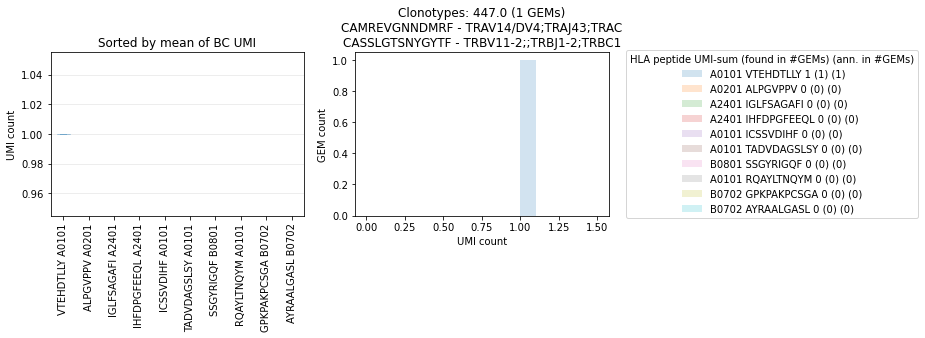

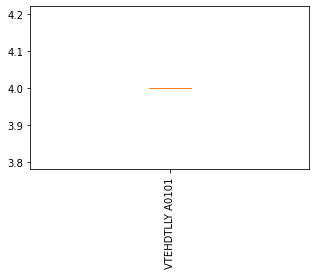

[107.]
('CASSLGVSYEQYF', 'CAVSDRSGGGADGLTF') unresolved
      peptide   peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
112  RAKFKQLL  ['RAKFKQLL']               [1]  CAVSDRSGGGADGLTF   

               genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
112  ['TRAV8-6;TRAJ45;TRAC']                 2  CASSLGVSYEQYF   

                 genes_lst_TRB umi_count_lst_TRB  
112  ['TRBV28;;TRBJ2-7;TRBC2']                 9  


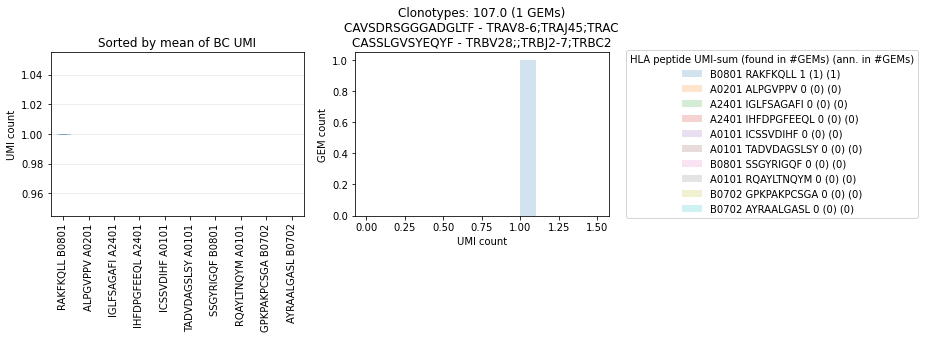

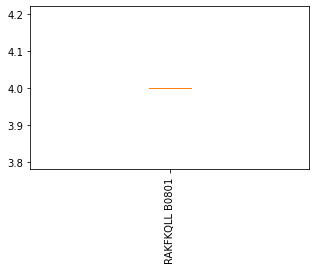

[432.]
('CASSLLAGEYNEQFF', 'CAMISNTGGFKTIF') unresolved
       peptide   peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1803  RAKFKQLL  ['RAKFKQLL']               [1]  CAMISNTGGFKTIF   

                genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
1803  ['TRAV12-3;TRAJ9;TRAC']                 4  CASSLLAGEYNEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
1803  ['TRBV4-1;;TRBJ2-1;TRBC2']                12  


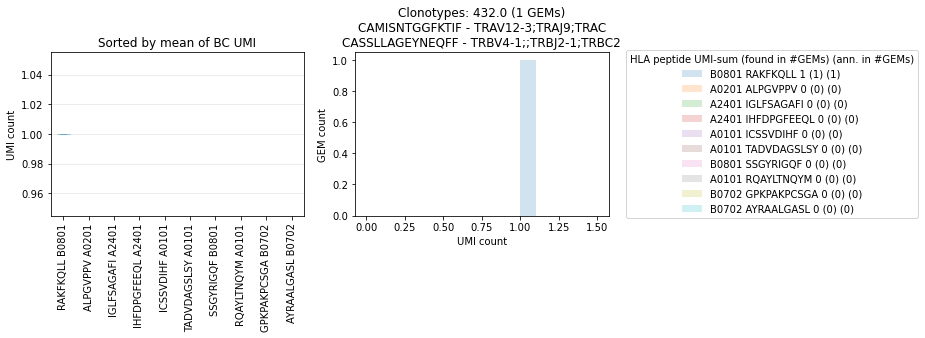

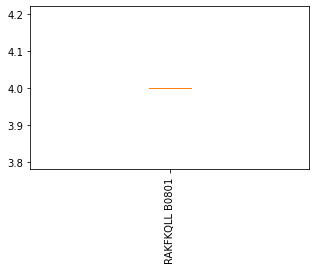

[675.]
('CASSLLVSGASYEQYF', 'CAVMTTDSWGKFQF') unresolved
         peptide     peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1648  FSAGAFILYK  ['FSAGAFILYK']               [1]  CAVMTTDSWGKFQF   

               genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
1648  ['TRAV20;TRAJ24;TRAC']                 7  CASSLLVSGASYEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
1648  ['TRBV5-5;;TRBJ2-7;TRBC2']                14  


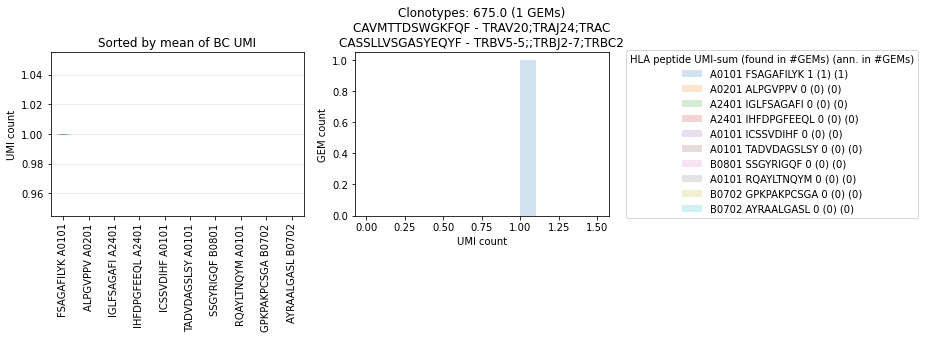

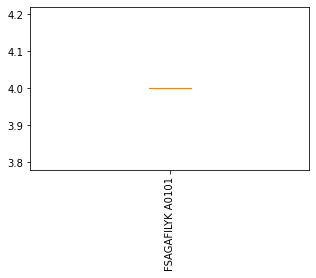

[538.]
('CASSLNEQYF', 'CAAHHDYNQGGKLIF') resolved by trash bin
       peptide   peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1635  AYLTNQYM  ['AYLTNQYM']               [1]  CAAHHDYNQGGKLIF   

                 genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB  \
1635  ['TRAV12-2;TRAJ23;TRAC']                 3   CASSLNEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
1635  ['TRBV7-9;;TRBJ2-7;TRBC2']                 9  


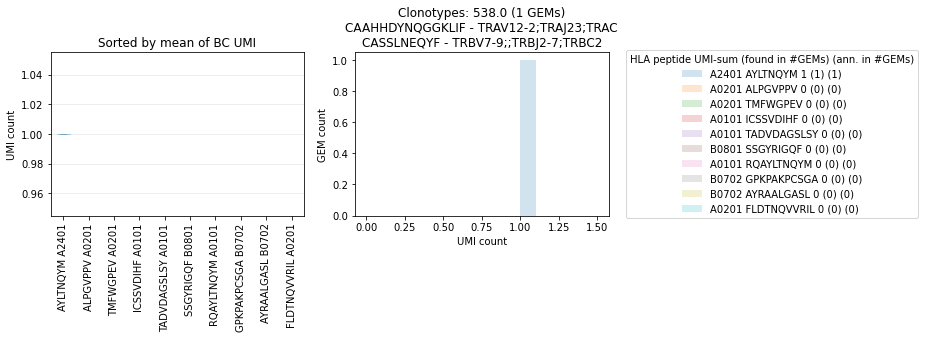

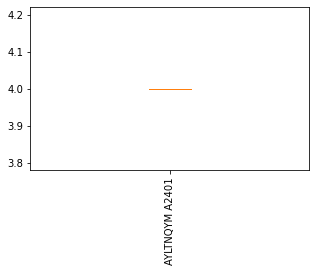

[323.]
('CASSLQAGAPYNEQFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2393  NLVPMVATV  ['NLVPMVATV']               [1]                        NaN   

     umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
2393               NaN  CASSLQAGAPYNEQFF  ['TRBV4-2;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2393                 4  


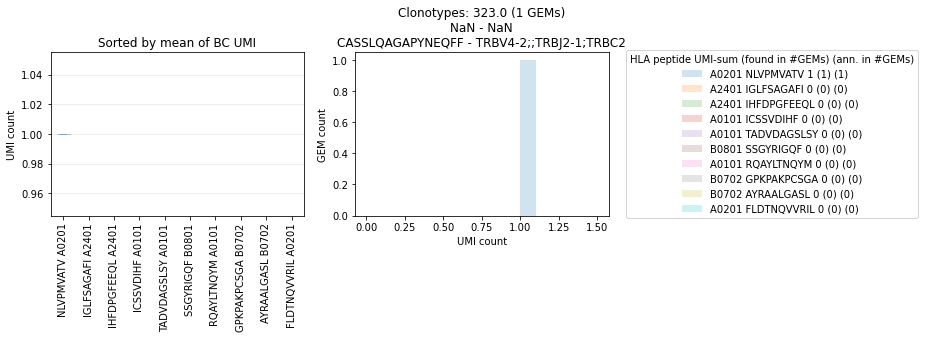

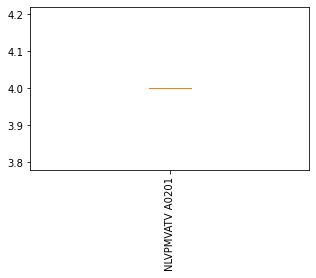

[466.]
('CASSLQGGNEQFF', 'CATVGNSGYSTLTF') unresolved
        peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1897  VTEHDTLLY  ['VTEHDTLLY']               [1]  CATVGNSGYSTLTF   

               genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1897  ['TRAV17;TRAJ11;TRAC']                 2  CASSLQGGNEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
1897  ['TRBV6-5;;TRBJ2-1;TRBC2']                 8  


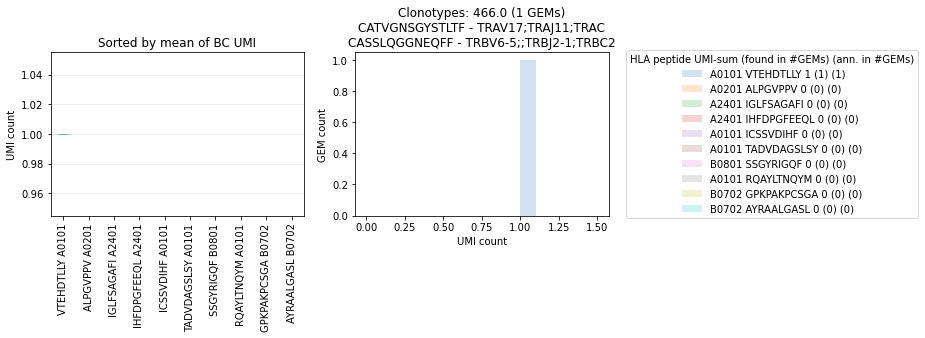

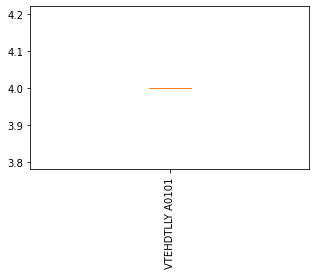

[615.]
('CASSLRDRSGQNTEAFF', 'CAQYPKYGNKLVF') unresolved
        peptide    peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
1042  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAQYPKYGNKLVF   

                     genes_lst_TRA umi_count_lst_TRA       cdr3_lst_TRB  \
1042  ['TRAV38-2/DV8;TRAJ47;TRAC']                 4  CASSLRDRSGQNTEAFF   

                   genes_lst_TRB umi_count_lst_TRB  
1042  ['TRBV7-8;;TRBJ1-1;TRBC1']                 4  


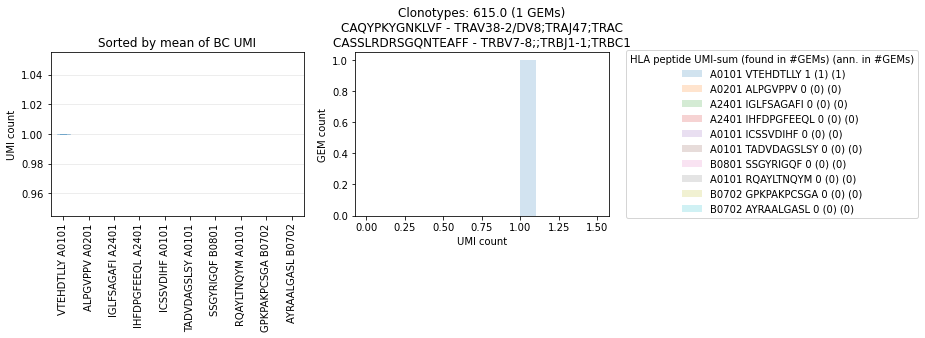

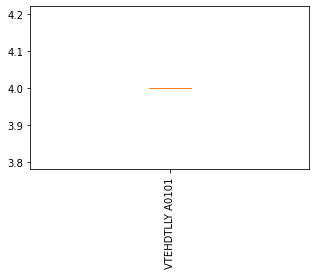

[132.]
('CASSLRGQGYYGYTF', 'CAAINEGGKLIF') unresolved
       peptide                                        peptide_lst  \
197  VTEHDTLLY  ['SPFTETWNF' 'SVDIHFDPG' 'TPRVTGGGAM' 'FSAGAFI...   

                          umi_count_lst_mhc  cdr3_lst_TRA  \
197  [1, 1, 1, 1, 2, 2, 2, 2, 3, 7, 8, 194]  CAAINEGGKLIF   

                  genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
197  ['TRAV29/DV5;TRAJ23;TRAC']                 2  CASSLRGQGYYGYTF   

                       genes_lst_TRB umi_count_lst_TRB  
197  ['TRBV5-4;TRBD1;TRBJ1-2;TRBC1']                 4  


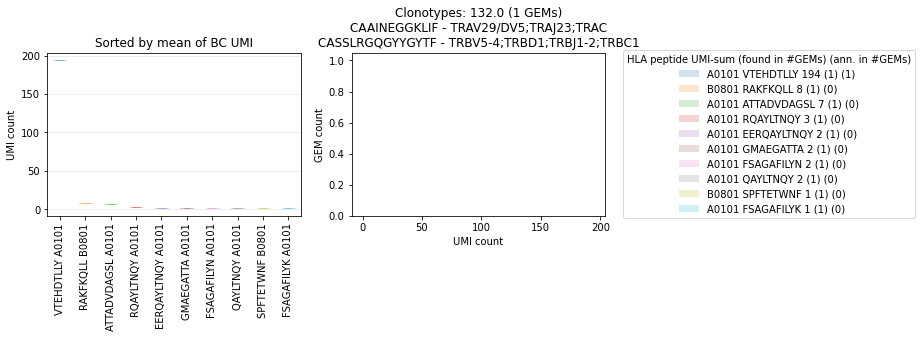

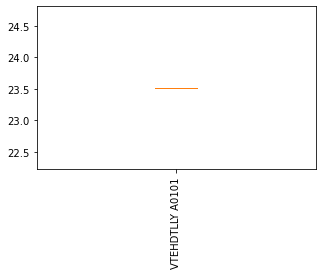

[185.]
('CASSLRGQGYYGYTF', 'NaN') unresolved
        peptide                                peptide_lst umi_count_lst_mhc  \
2088  VTEHDTLLY  ['TNQYMQRMASV' 'ATTADVDAGSL' 'VTEHDTLLY']        [1, 6, 42]   

     cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2088                        NaN               NaN  CASSLRGQGYYGYTF   

                        genes_lst_TRB umi_count_lst_TRB  
2088  ['TRBV5-4;TRBD1;TRBJ1-2;TRBC1']                 9  


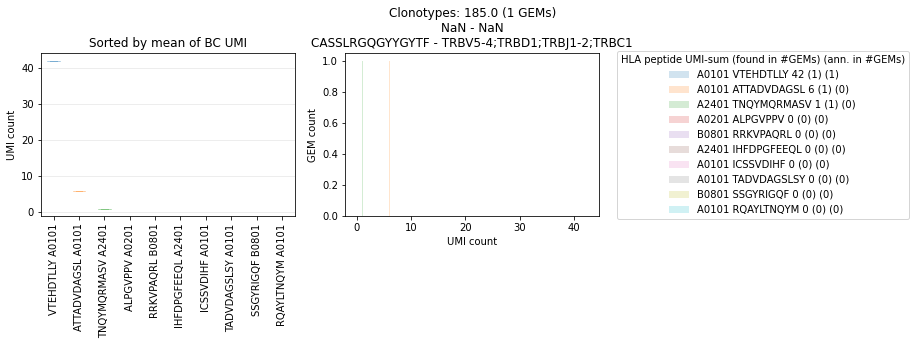

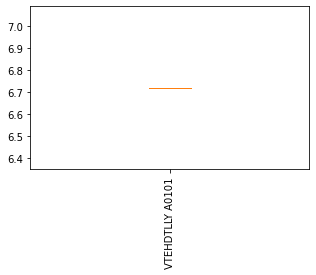

[672.]
('CASSLRQGANTGELFF', 'CAVDRRMDSSYKLIF') unresolved
         peptide                                        peptide_lst  \
1072  TPRVTGGGAM  ['NLVPMVATV' 'TADVDAGSLS' 'GPKPAKPCS' 'GPFPGNL...   

        umi_count_lst_mhc     cdr3_lst_TRA          genes_lst_TRA  \
1072  [1, 1, 1, 4, 4, 72]  CAVDRRMDSSYKLIF  ['TRAV2;TRAJ12;TRAC']   

     umi_count_lst_TRA      cdr3_lst_TRB                    genes_lst_TRB  \
1072                 2  CASSLRQGANTGELFF  ['TRBV7-9;TRBD1;TRBJ2-2;TRBC2']   

     umi_count_lst_TRB  
1072                15  


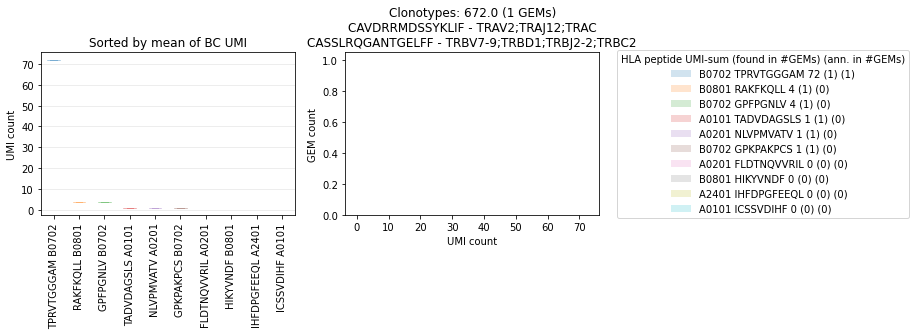

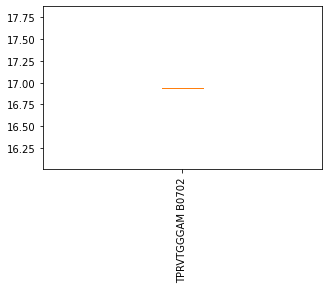

[81.]
('CASSLRQGANTGELFF', 'NaN') unresolved
         peptide                                        peptide_lst  \
2272  TPRVTGGGAM  ['VTEHDTLLY' 'TADVDAGSLS' 'YPLVKMRLSV' 'GPFPGN...   

     umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2272  [1, 1, 1, 2, 37]                        NaN               NaN   

          cdr3_lst_TRB                    genes_lst_TRB umi_count_lst_TRB  
2272  CASSLRQGANTGELFF  ['TRBV7-9;TRBD1;TRBJ2-2;TRBC2']                 7  


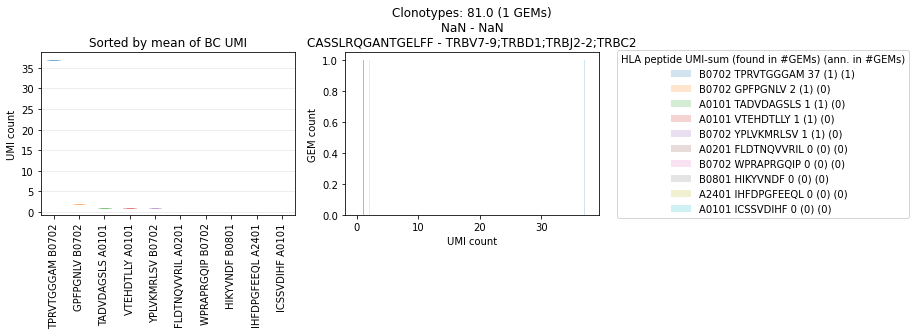

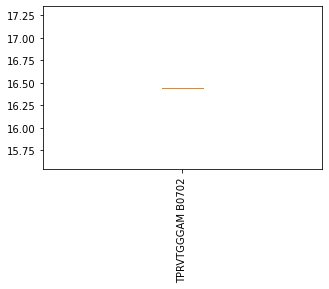

[596.]
('CASSLSGGSYNEQFF', 'CAADVTDSWGKFQF') unresolved
         peptide     peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1999  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CAADVTDSWGKFQF   

                   genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
1999  ['TRAV29/DV5;TRAJ24;TRAC']                 6  CASSLSGGSYNEQFF   

                  genes_lst_TRB umi_count_lst_TRB  
1999  ['TRBV27;;TRBJ2-1;TRBC2']                13  


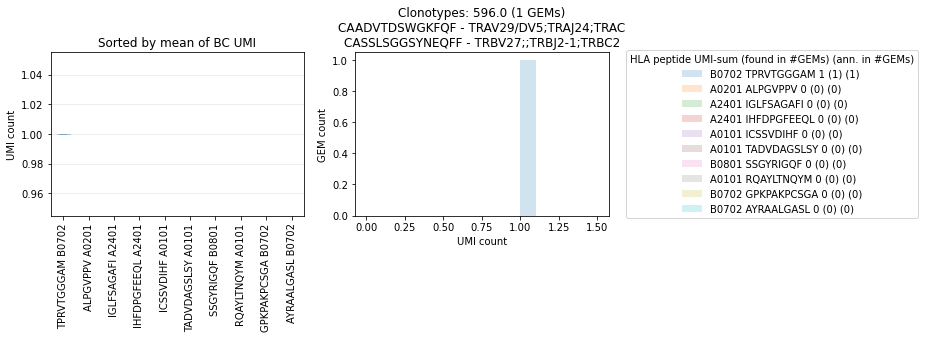

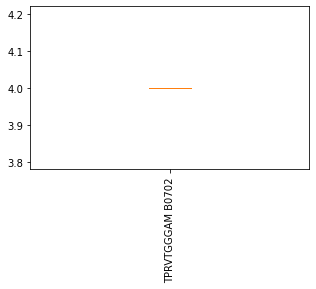

[638.]
('CASSLSGKTDTQYF', 'CGTYGGSQGNLIF') unresolved
       peptide                                        peptide_lst  \
860  VTEHDTLLY  ['RQAYLTNQY' 'ATTADVDAGSL' 'QAYLTNQY' 'EERQAYL...   

    umi_count_lst_mhc   cdr3_lst_TRA             genes_lst_TRA  \
860  [1, 1, 1, 1, 81]  CGTYGGSQGNLIF  ['TRAV38-1;TRAJ42;TRAC']   

    umi_count_lst_TRA    cdr3_lst_TRB                genes_lst_TRB  \
860                 5  CASSLSGKTDTQYF  ['TRBV12-3;;TRBJ2-3;TRBC2']   

    umi_count_lst_TRB  
860                12  


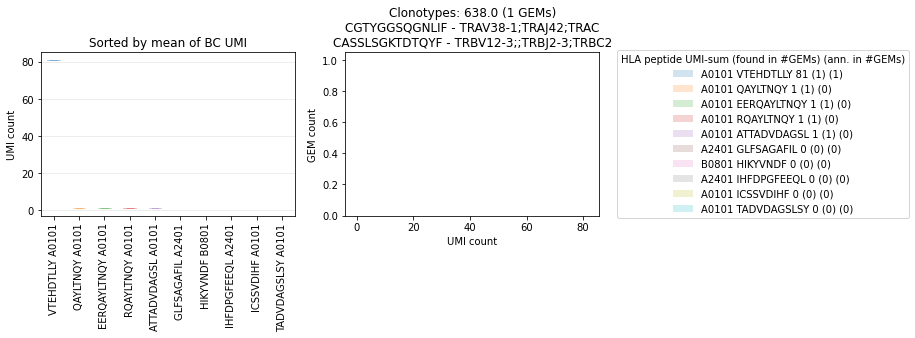

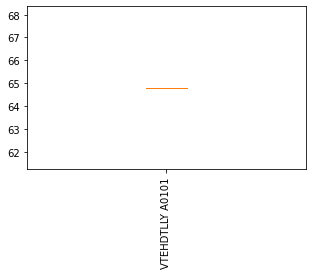

[153.]
('CASSLSGKTDTQYF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2259  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB                genes_lst_TRB  \
2259               NaN  CASSLSGKTDTQYF  ['TRBV12-3;;TRBJ2-3;TRBC2']   

     umi_count_lst_TRB  
2259                 8  


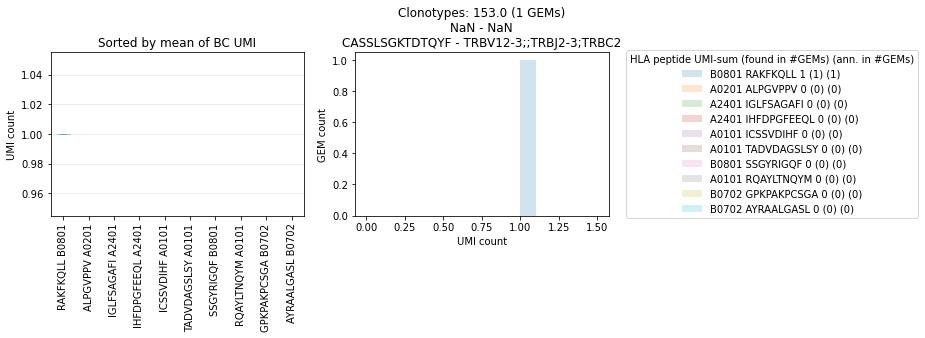

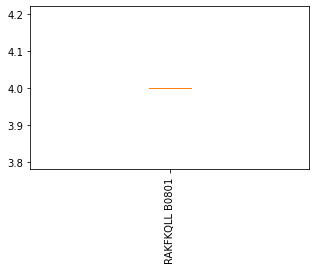

[297.]
('CASSLSIARTANEQFF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2351  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA      cdr3_lst_TRB              genes_lst_TRB  \
2351               NaN  CASSLSIARTANEQFF  ['TRBV27;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2351                 6  


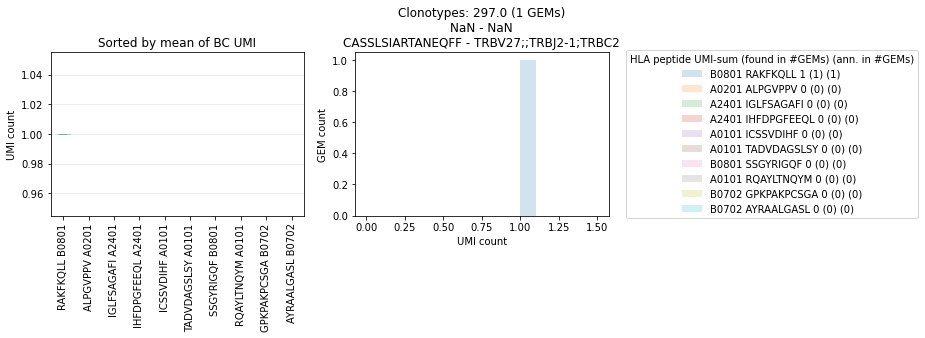

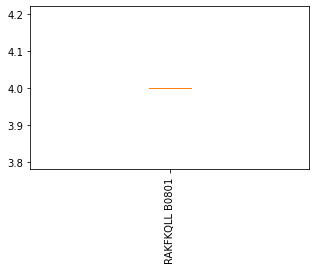

[206.]
('CASSLSLGKDTQYF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2244  VTEHDTLLY  ['VTEHDTLLY']               [2]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB               genes_lst_TRB  \
2244               NaN  CASSLSLGKDTQYF  ['TRBV7-9;;TRBJ2-3;TRBC2']   

     umi_count_lst_TRB  
2244                 6  


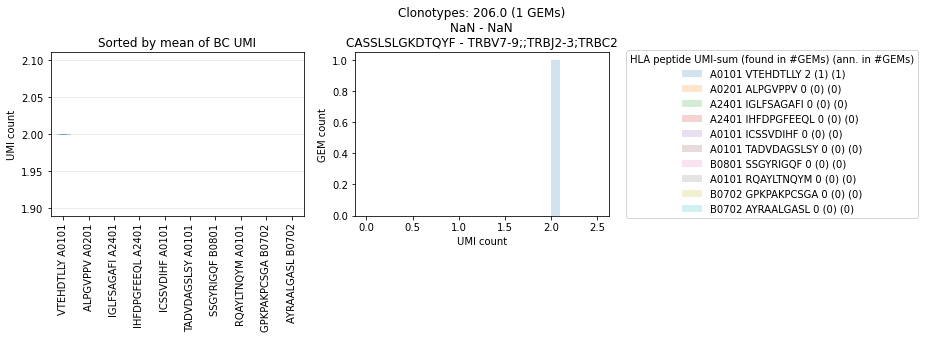

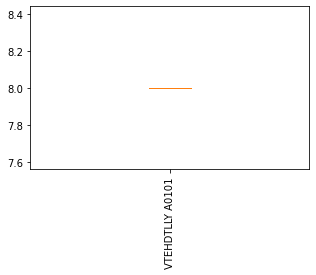

[307.]
('CASSLSRGGLNGYTF', 'NaN') unresolved
          peptide      peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2282  EERQAYLTNQY  ['EERQAYLTNQY']               [2]                

     genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2282           NaN               NaN  CASSLSRGGLNGYTF   

                  genes_lst_TRB umi_count_lst_TRB  
2282  ['TRBV27;;TRBJ1-2;TRBC1']                 2  


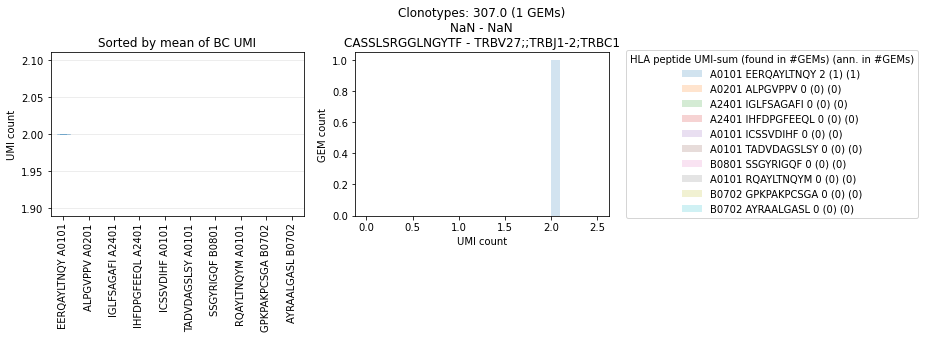

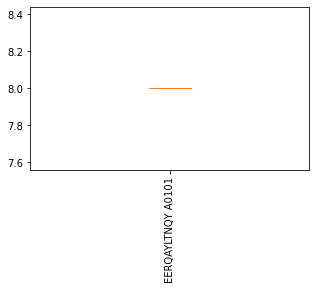

[296.]
('CASSLSRGIEQFF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2414  QAYLTNQY  ['QAYLTNQY']               [1]                        NaN   

     umi_count_lst_TRA   cdr3_lst_TRB              genes_lst_TRB  \
2414               NaN  CASSLSRGIEQFF  ['TRBV27;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2414                 5  


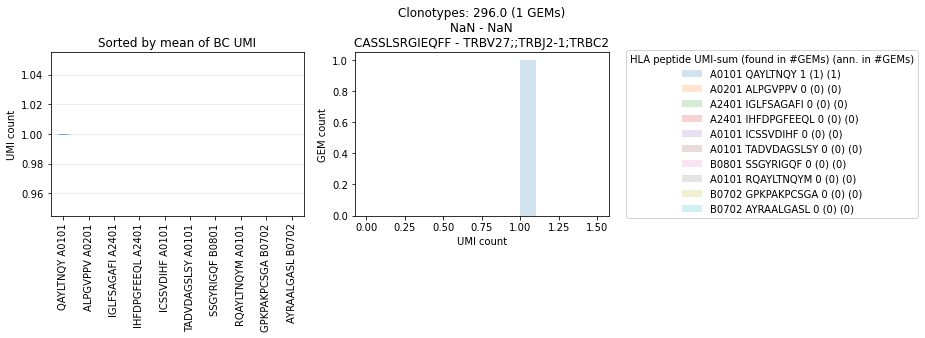

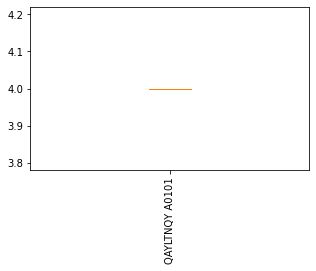

[151.]
('CASSLSWGGFYNEQFF', 'CVVSARITGGGNKLTF') unresolved
       peptide   peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
1714  RAKFKQLL  ['RAKFKQLL']               [1]  CVVSARITGGGNKLTF   

               genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
1714  ['TRAV10;TRAJ10;TRAC']                 2  CASSLSWGGFYNEQFF   

                  genes_lst_TRB umi_count_lst_TRB  
1714  ['TRBV27;;TRBJ2-1;TRBC2']                 6  


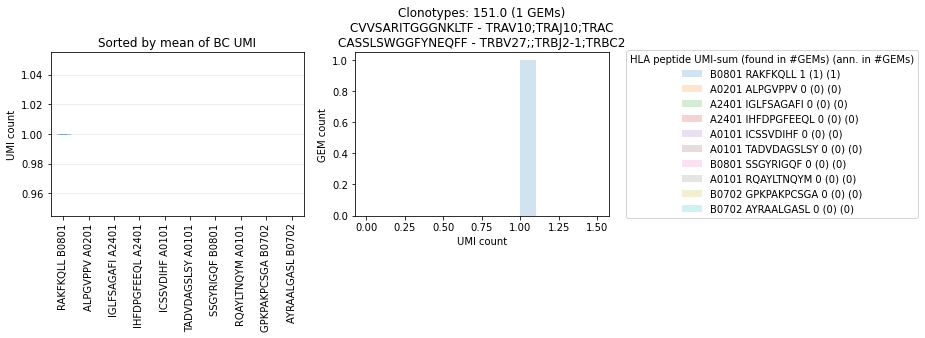

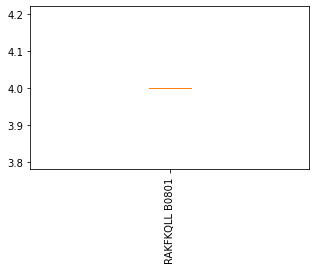

[106.]
('CASSLSWGGFYNEQFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2376  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA      cdr3_lst_TRB              genes_lst_TRB  \
2376               NaN  CASSLSWGGFYNEQFF  ['TRBV27;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2376                 3  


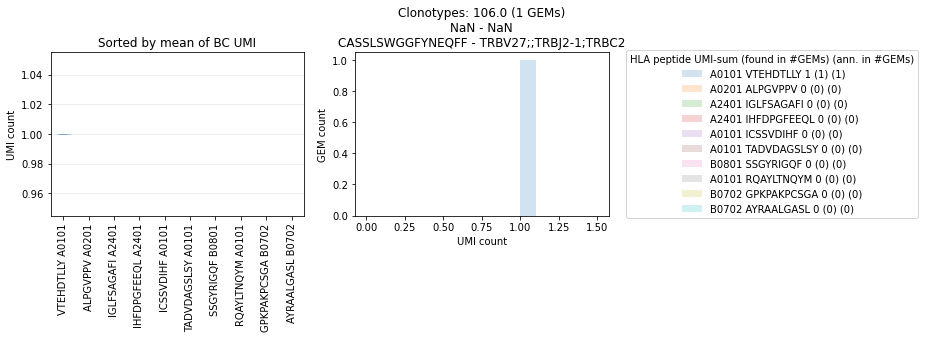

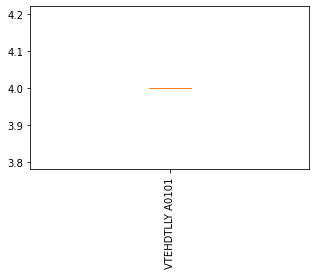

[238.]
('CASSLTGNPTYEQYF', 'CAAYTDKLIF') unresolved
       peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
321  VTEHDTLLY  ['VTEHDTLLY']              [30]   CAAYTDKLIF   

              genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
321  ['TRAV41;TRAJ34;TRAC']                 4  CASSLTGNPTYEQYF   

                  genes_lst_TRB umi_count_lst_TRB  
321  ['TRBV7-9;;TRBJ2-7;TRBC2']                12  


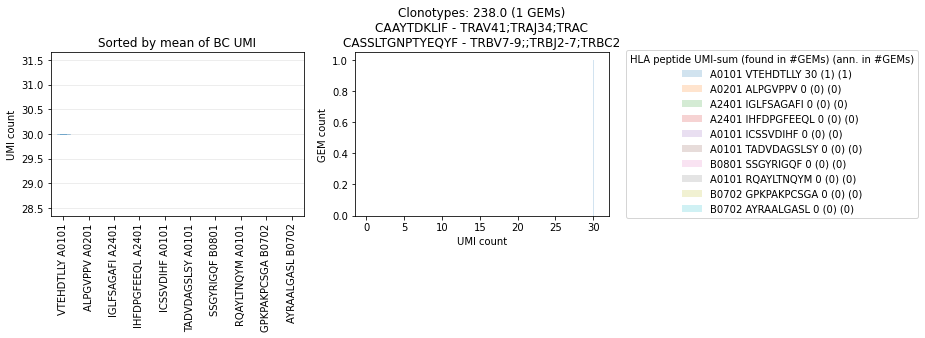

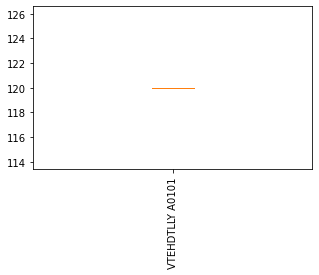

[627.]
('CASSLVAGAPSEQYF', 'CTVNYGNKLVF') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
1804  VTEHDTLLY  ['VTEHDTLLY']               [1]  CTVNYGNKLVF   

              genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
1804  ['TRAV3;TRAJ47;TRAC']                 2  CASSLVAGAPSEQYF   

                  genes_lst_TRB umi_count_lst_TRB  
1804  ['TRBV27;;TRBJ2-7;TRBC2']                 9  


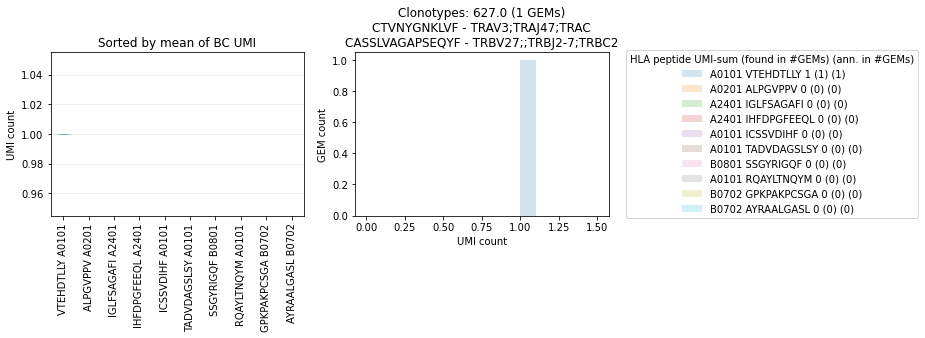

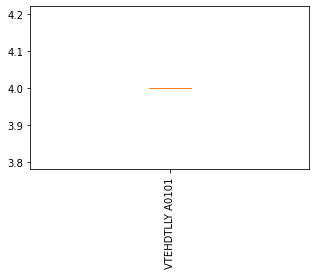

[553.]
('CASSLVAGAPSEQYF', 'CVVSARMDSSYKLIF') unresolved
      peptide                            peptide_lst umi_count_lst_mhc  \
899  RAKFKQLL  ['AALPGVPPV' 'TPRVTGGGAM' 'RAKFKQLL']         [1, 1, 1]   

        cdr3_lst_TRA           genes_lst_TRA umi_count_lst_TRA  \
899  CVVSARMDSSYKLIF  ['TRAV10;TRAJ12;TRAC']                 2   

        cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
899  CASSLVAGAPSEQYF  ['TRBV27;;TRBJ2-7;TRBC2']                 1  


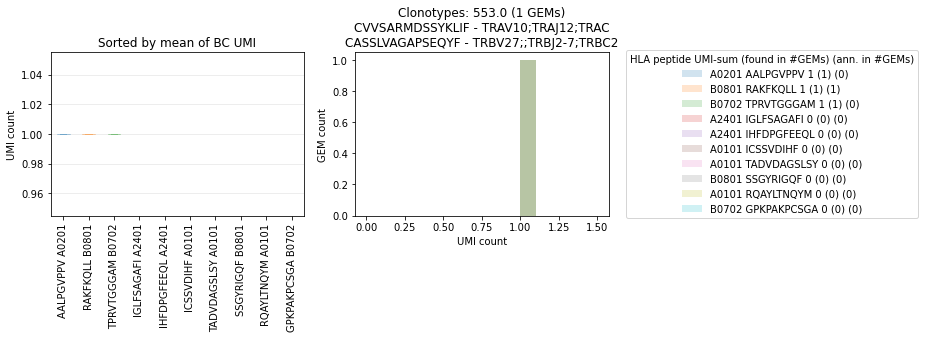

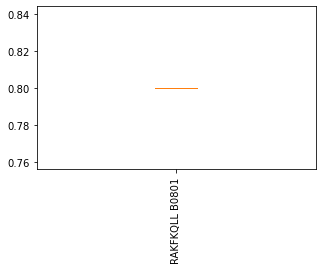

[233.]
('CASSLVGWKTSGFANTGELFF', 'CAVAIIIQGAQKLVF') unresolved
       peptide                                        peptide_lst  \
744  VTEHDTLLY  ['TNQYMQRMASV' 'ATTADVDAGSL' 'FSAGAFILYK' 'RAK...   

    umi_count_lst_mhc     cdr3_lst_TRA           genes_lst_TRA  \
744  [1, 1, 1, 3, 45]  CAVAIIIQGAQKLVF  ['TRAV41;TRAJ54;TRAC']   

    umi_count_lst_TRA           cdr3_lst_TRB                genes_lst_TRB  \
744                 4  CASSLVGWKTSGFANTGELFF  ['TRBV11-1;;TRBJ2-2;TRBC2']   

    umi_count_lst_TRB  
744                15  


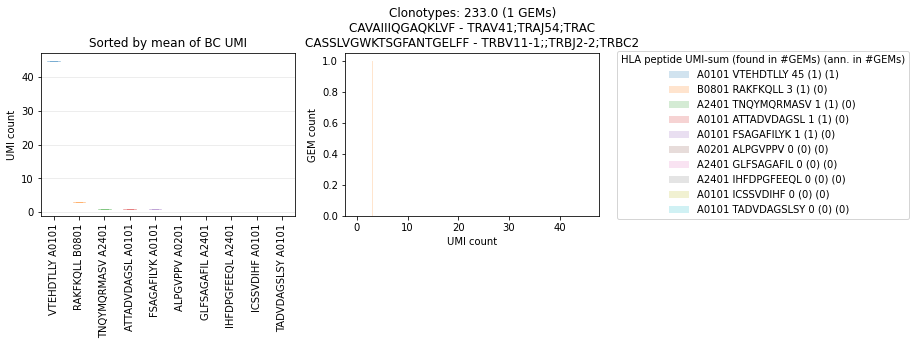

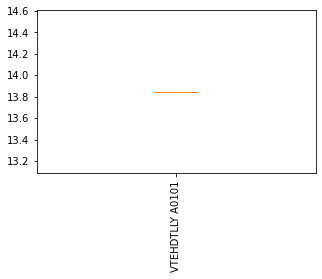

[696.]
('CASSLVLGGVSGELFF', 'CILYTGTASKLTF') unresolved
        peptide                             peptide_lst umi_count_lst_mhc  \
2015  VTEHDTLLY  ['EERQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']         [1, 1, 2]   

       cdr3_lst_TRA             genes_lst_TRA umi_count_lst_TRA  \
2015  CILYTGTASKLTF  ['TRAV26-2;TRAJ44;TRAC']                 4   

          cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
2015  CASSLVLGGVSGELFF  ['TRBV28;;TRBJ2-2;TRBC2']                 3  


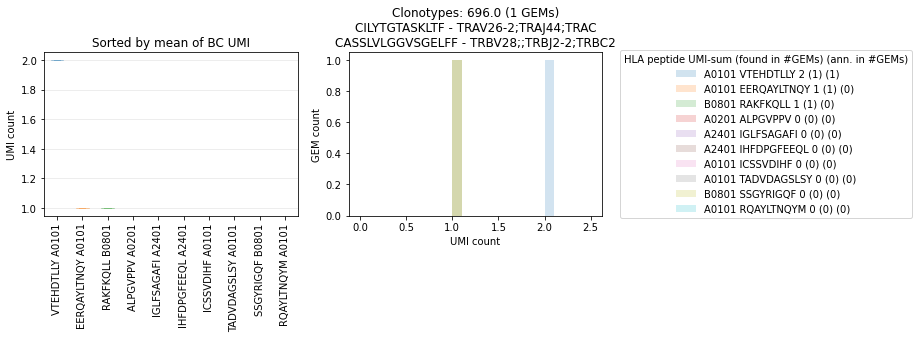

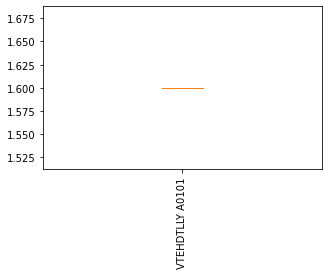

[679.]
('CASSMSGSEQYF', 'CAASQNEKLTF') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
1342  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAASQNEKLTF   

               genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
1342  ['TRAV21;TRAJ48;TRAC']                 7  CASSMSGSEQYF   

                  genes_lst_TRB umi_count_lst_TRB  
1342  ['TRBV19;;TRBJ2-7;TRBC2']                10  


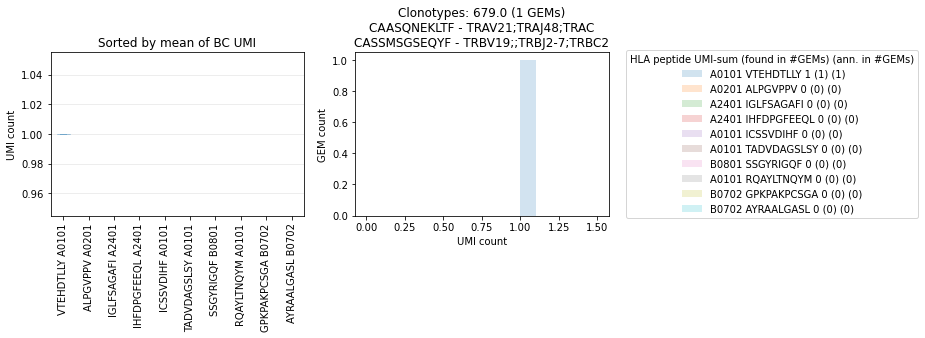

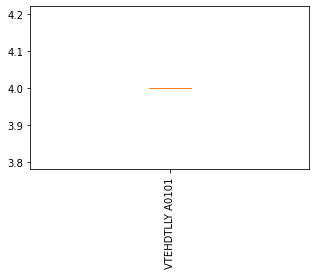

[554.]
('CASSNLDRGAGELFF', 'CVVSARMDSSYKLIF') unresolved
         peptide     peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
2022  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CVVSARMDSSYKLIF   

               genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2022  ['TRAV10;TRAJ12;TRAC']                 1  CASSNLDRGAGELFF   

                        genes_lst_TRB umi_count_lst_TRB  
2022  ['TRBV7-9;TRBD1;TRBJ2-2;TRBC2']                 9  


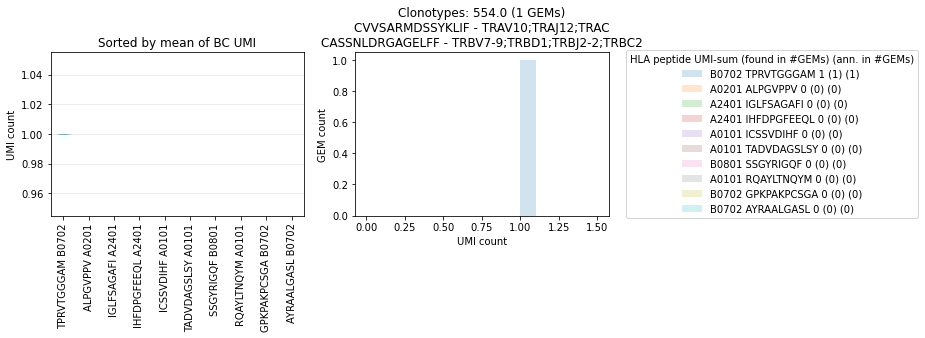

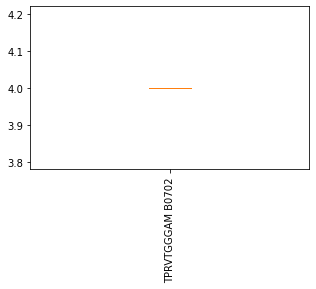

[143.]
('CASSNRGANYGYTF', 'CVVSALGVNDYKLSF') unresolved
        peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1095  RQAYLTNQY  ['RQAYLTNQY']               [1]  CVVSALGVNDYKLSF   

                genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1095  ['TRAV8-2;TRAJ20;TRAC']                 4  CASSNRGANYGYTF   

                  genes_lst_TRB umi_count_lst_TRB  
1095  ['TRBV19;;TRBJ1-2;TRBC1']                 3  


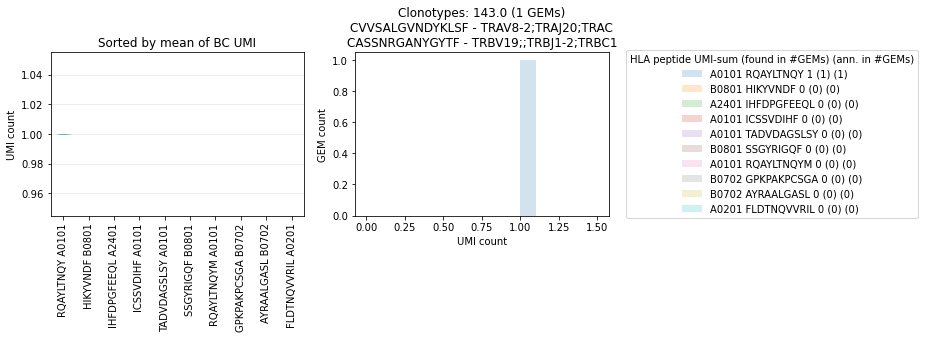

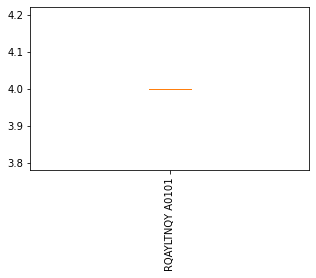

[427.]
('CASSPFQGSSYEQYF', 'CAMREVYGGSQGNLIF') unresolved
       peptide    peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
266  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAMREVYGGSQGNLIF   

                  genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
266  ['TRAV14/DV4;TRAJ42;TRAC']                 2  CASSPFQGSSYEQYF   

                  genes_lst_TRB umi_count_lst_TRB  
266  ['TRBV4-2;;TRBJ2-7;TRBC2']                 2  


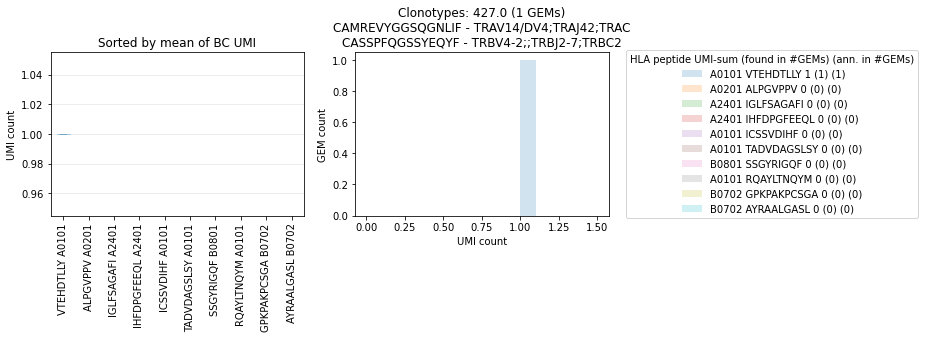

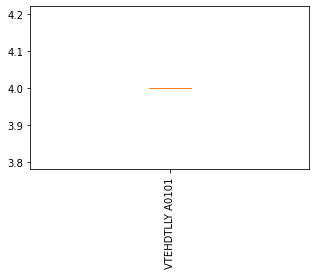

[207.]
('CASSPGIVKAMNTEAFF', 'CAVITYTGTASKLTF') unresolved
       peptide                           peptide_lst umi_count_lst_mhc  \
362  VTEHDTLLY  ['GPRSERRKW' 'WPRAPRGQ' 'VTEHDTLLY']         [1, 1, 1]   

        cdr3_lst_TRA            genes_lst_TRA umi_count_lst_TRA  \
362  CAVITYTGTASKLTF  ['TRAV8-4;TRAJ44;TRAC']                 2   

          cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
362  CASSPGIVKAMNTEAFF  ['TRBV18;;TRBJ1-1;TRBC1']                 6  


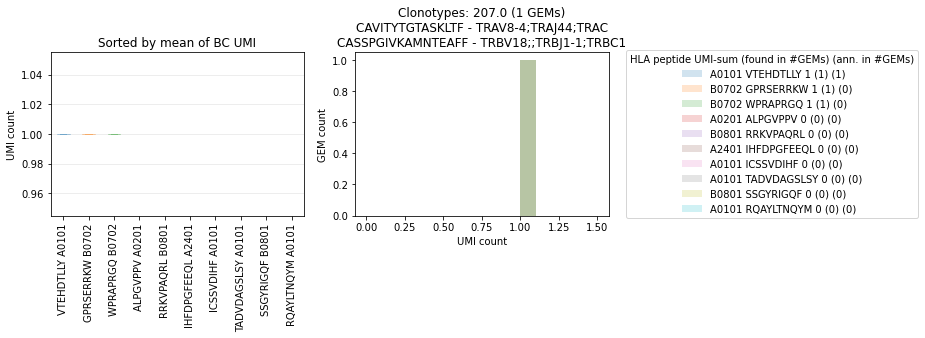

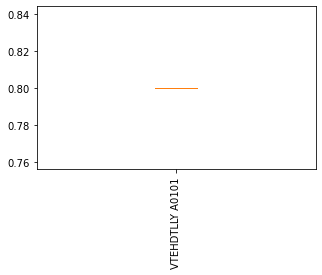

[355.]
('CASSPGLAPDTQYF', 'NaN') unresolved
          peptide      peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2111  EERQAYLTNQY  ['EERQAYLTNQY']               [1]                

     genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
2111           NaN               NaN  CASSPGLAPDTQYF   

                   genes_lst_TRB umi_count_lst_TRB  
2111  ['TRBV7-3;;TRBJ2-3;TRBC2']                15  


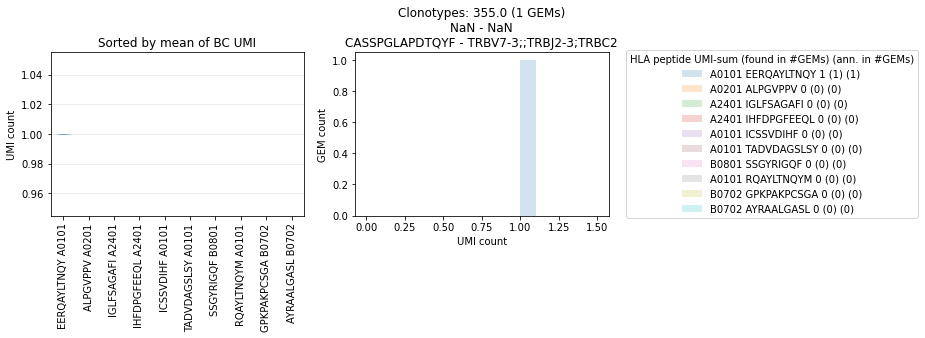

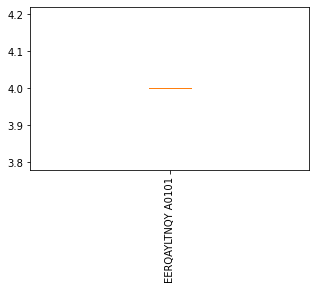

[581.]
('CASSPGQSLGELFF', 'CAVRDAINYGQNFVF') unresolved
      peptide               peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
163  WPRAPRGQ  ['GPRSERRKW' 'WPRAPRGQ']            [1, 2]  CAVRDAINYGQNFVF   

             genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
163  ['TRAV3;TRAJ26;TRAC']                 5  CASSPGQSLGELFF   

                 genes_lst_TRB umi_count_lst_TRB  
163  ['TRBV18;;TRBJ2-2;TRBC2']                 5  


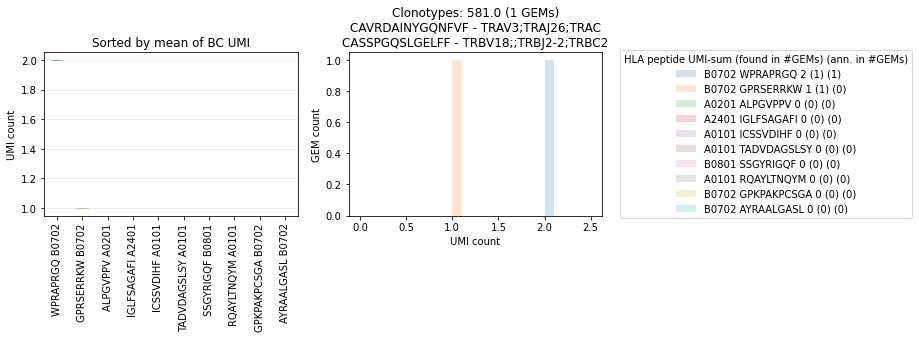

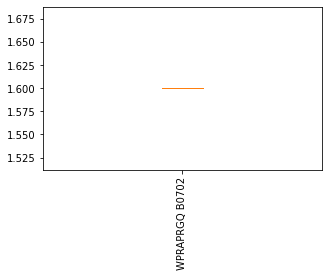

[400.]
('CASSPGRASPLHF', 'NaN') unresolved
        peptide               peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2214  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]                

     genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB             genes_lst_TRB  \
2214           NaN               NaN  CASSPGRASPLHF  ['TRBV2;;TRBJ1-6;TRBC1']   

     umi_count_lst_TRB  
2214                 5  


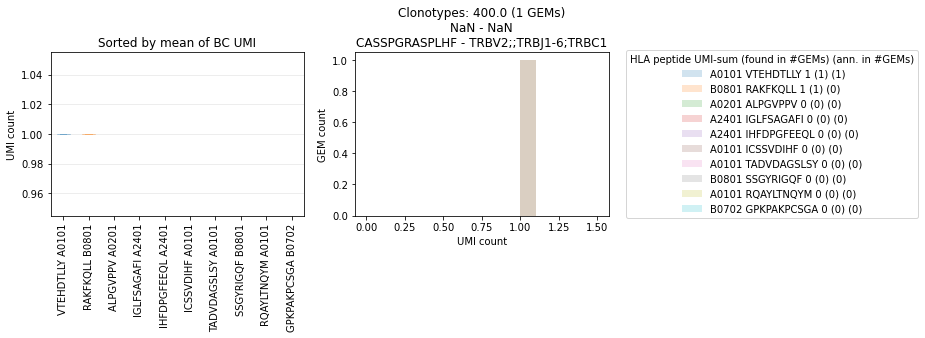

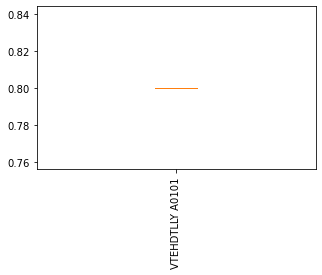

[353.]
('CASSPLGGENYGYTF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2148  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB              genes_lst_TRB  \
2148               NaN  CASSPLGGENYGYTF  ['TRBV14;;TRBJ1-2;TRBC1']   

     umi_count_lst_TRB  
2148                15  


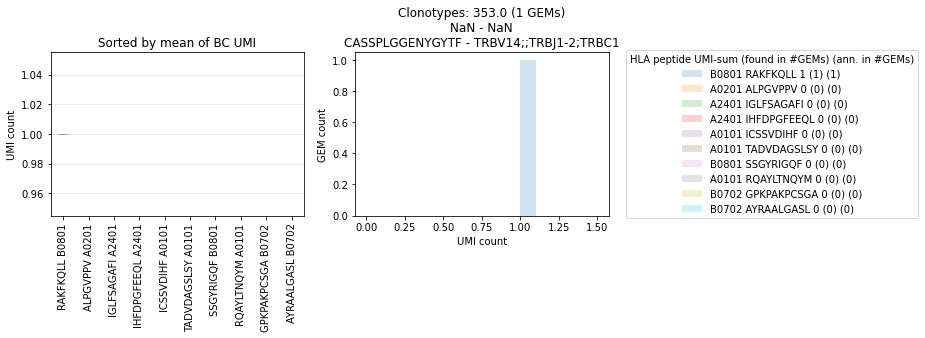

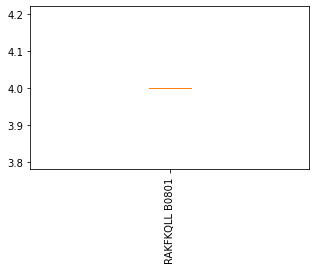

[606.]
('CASSPNGGAEGYTF', 'CAFMNPYDKVIF') unresolved
          peptide      peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1231  ATTADVDAGSL  ['ATTADVDAGSL']               [1]  CAFMNPYDKVIF   

                 genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1231  ['TRAV38-1;TRAJ50;TRAC']                 3  CASSPNGGAEGYTF   

                        genes_lst_TRB umi_count_lst_TRB  
1231  ['TRBV7-3;TRBD1;TRBJ1-2;TRBC1']                15  


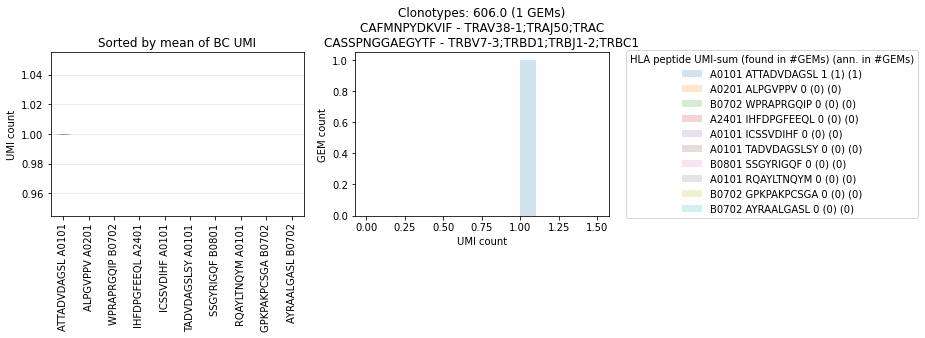

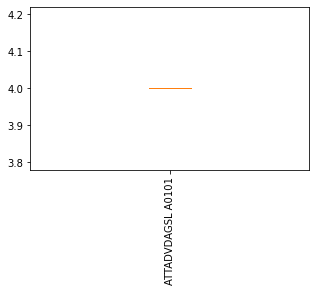

[268.]
('CASSPPAENEQFF', 'CAVNDDNNDMRF') unresolved
          peptide      peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1098  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAVNDDNNDMRF   

                genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1098  ['TRAV8-1;TRAJ43;TRAC']                 3  CASSPPAENEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
1098  ['TRBV5-6;;TRBJ2-1;TRBC2']                12  


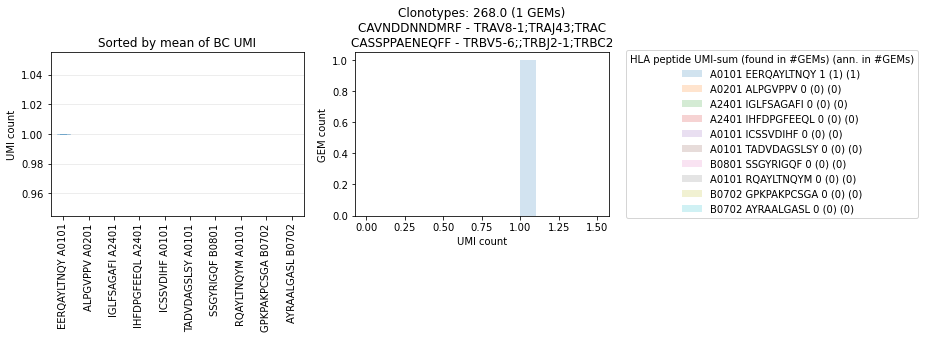

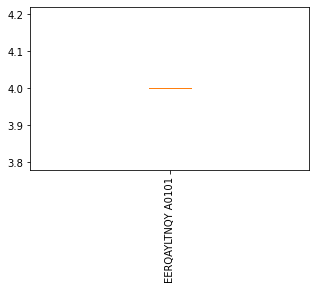

[435.]
('CASSPRADNNEQFF', 'CAASPPMIKAAGNKLTF') resolved by trash bin
         peptide     peptide_lst umi_count_lst_mhc       cdr3_lst_TRA  \
1235  GPFPGNLVDV  ['GPFPGNLVDV']               [1]  CAASPPMIKAAGNKLTF   

                 genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1235  ['TRAV13-1;TRAJ17;TRAC']                 2  CASSPRADNNEQFF   

                  genes_lst_TRB umi_count_lst_TRB  
1235  ['TRBV28;;TRBJ2-1;TRBC2']                13  


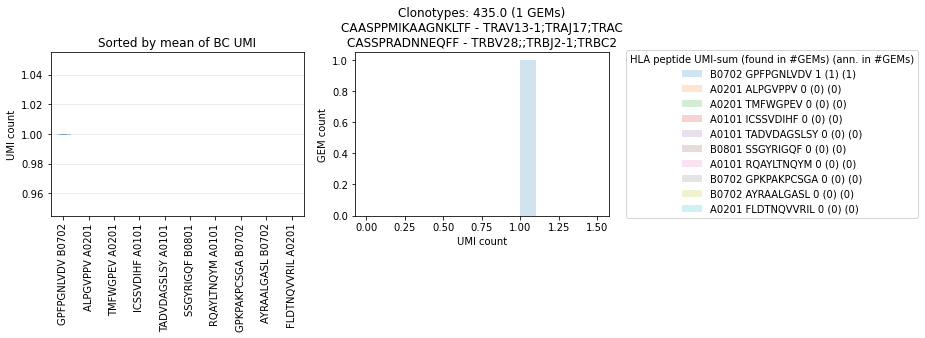

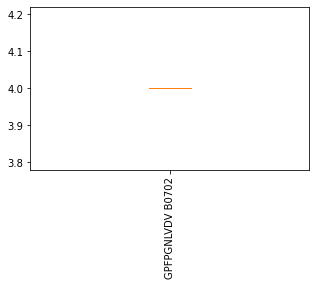

[201.]
('CASSPRGGGSTEAFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2313  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
2313               NaN  CASSPRGGGSTEAFF  ['TRBV7-9;;TRBJ1-1;TRBC1']   

     umi_count_lst_TRB  
2313                 9  


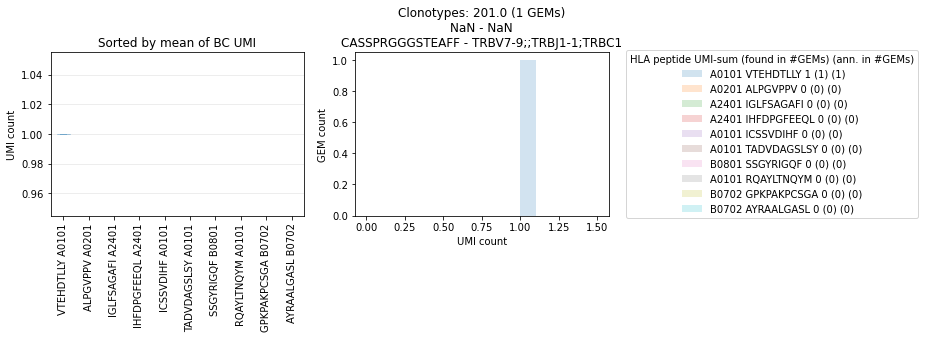

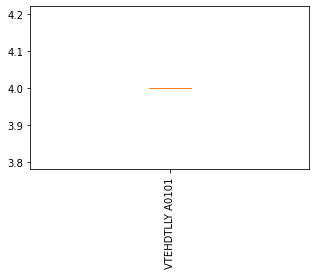

[236.]
('CASSPRGQNTDTQYF', 'CAGFFGNEKLTF') unresolved
        peptide                                        peptide_lst  \
462  SVDIHFDPGF  ['RAKFKQLL' 'VTEHDTLLY' 'EERQAYLTNQY' 'SVDIHFD...   

    umi_count_lst_mhc  cdr3_lst_TRA           genes_lst_TRA umi_count_lst_TRA  \
462      [1, 1, 2, 9]  CAGFFGNEKLTF  ['TRAV41;TRAJ48;TRAC']                 2   

        cdr3_lst_TRB              genes_lst_TRB umi_count_lst_TRB  
462  CASSPRGQNTDTQYF  ['TRBV18;;TRBJ2-3;TRBC2']                 9  


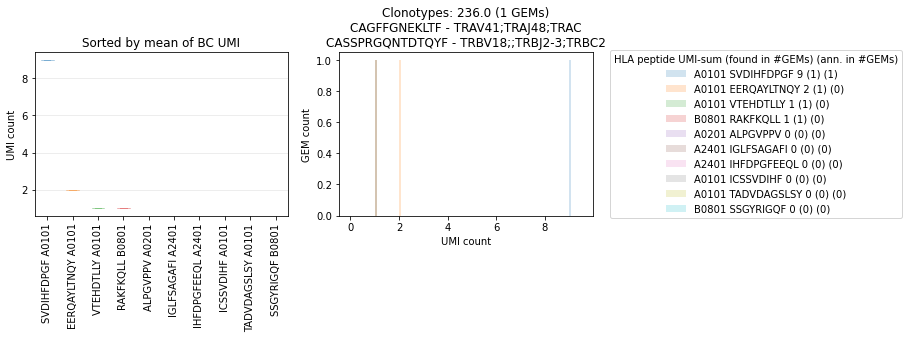

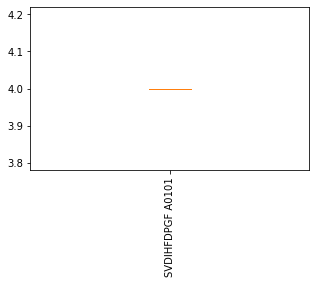

[512.]
('CASSPSPENTEAFF', 'CAVRPRRGSTLGRLYF') unresolved
      peptide   peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
286  RAKFKQLL  ['RAKFKQLL']               [1]  CAVRPRRGSTLGRLYF   

               genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
286  ['TRAV1-1;TRAJ18;TRAC']                 2  CASSPSPENTEAFF   

                  genes_lst_TRB umi_count_lst_TRB  
286  ['TRBV5-1;;TRBJ1-1;TRBC1']                11  


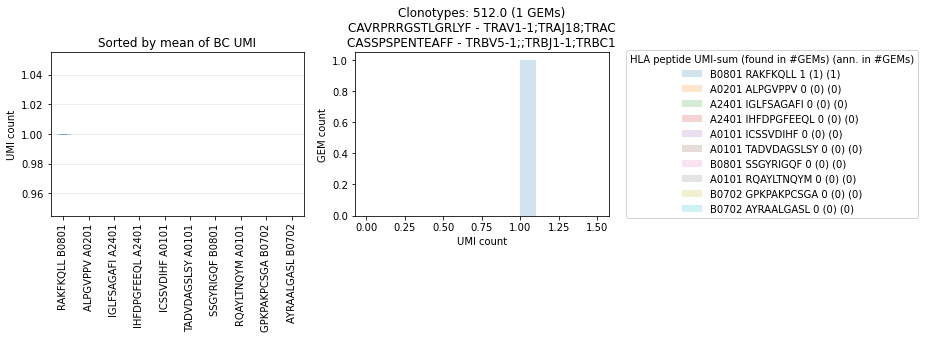

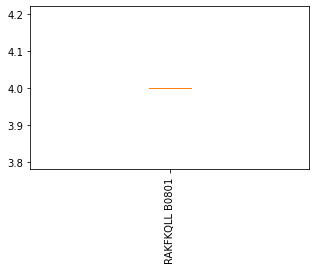

[318.]
('CASSPSPENTEAFF', 'NaN') unresolved
        peptide                          peptide_lst umi_count_lst_mhc  \
2157  SSGYRIGQF  ['RAKFKQLL' 'YPLVKMRL' 'SSGYRIGQF']         [1, 1, 3]   

     cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
2157                        NaN               NaN  CASSPSPENTEAFF   

                   genes_lst_TRB umi_count_lst_TRB  
2157  ['TRBV5-1;;TRBJ1-1;TRBC1']                 5  


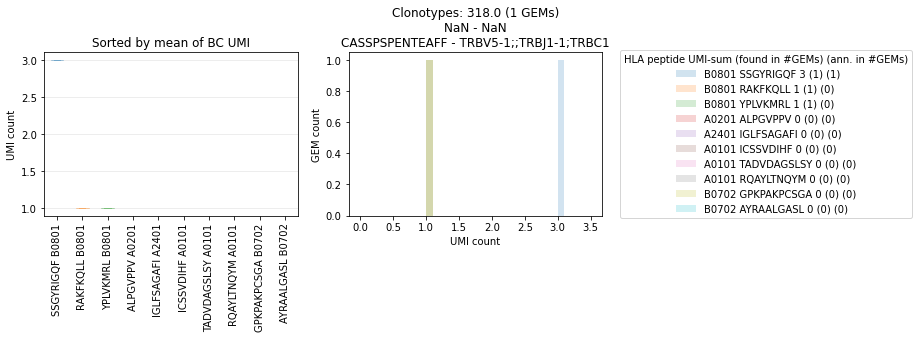

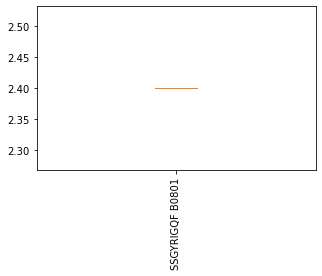

[220.]
('CASSPSREQYF', 'CAEIMYSGGGADGLTF') unresolved
        peptide    peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
1562  VTEHDTLLY  ['VTEHDTLLY']               [2]  CAEIMYSGGGADGLTF   

              genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB  \
1562  ['TRAV5;TRAJ45;TRAC']                 2  CASSPSREQYF   

                   genes_lst_TRB umi_count_lst_TRB  
1562  ['TRBV7-9;;TRBJ2-7;TRBC2']                13  


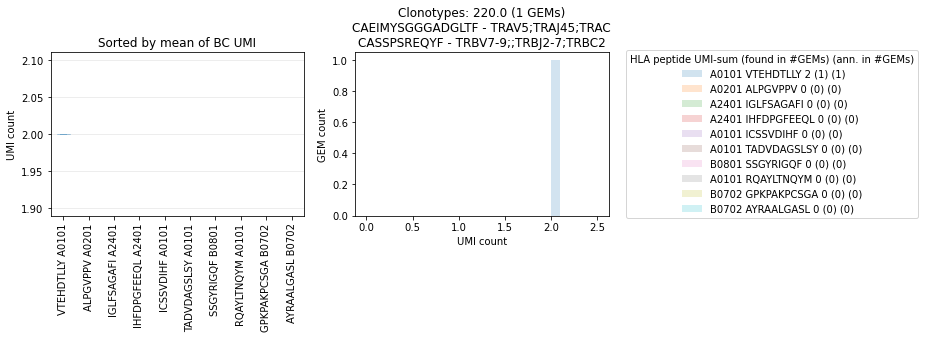

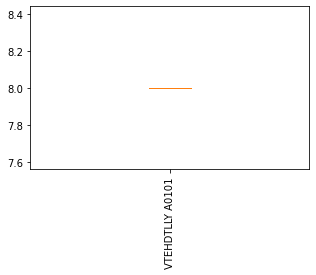

[574.]
('CASSQADRGRFDQPQHF', 'CILRDGSGGSNYKLTF') unresolved
         peptide                   peptide_lst umi_count_lst_mhc  \
887  EERQAYLTNQY  ['TADVDAGSLS' 'EERQAYLTNQY']            [1, 1]   

         cdr3_lst_TRA             genes_lst_TRA umi_count_lst_TRA  \
887  CILRDGSGGSNYKLTF  ['TRAV26-2;TRAJ53;TRAC']                 1   

          cdr3_lst_TRB                    genes_lst_TRB umi_count_lst_TRB  
887  CASSQADRGRFDQPQHF  ['TRBV4-1;TRBD1;TRBJ1-5;TRBC1']                 8  


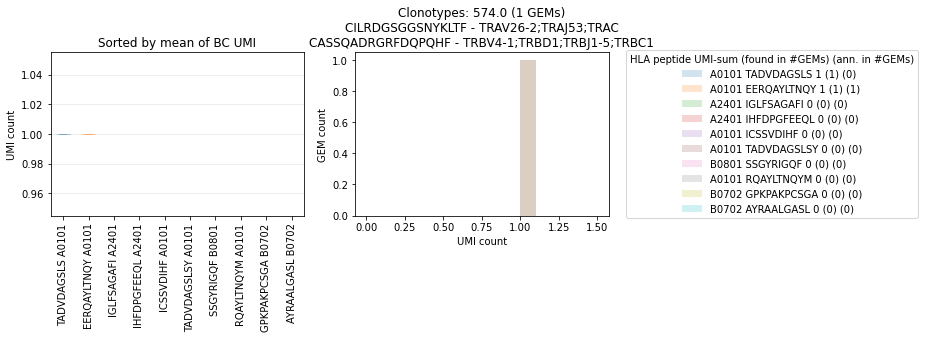

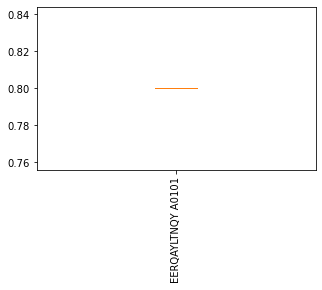

[665.]
HELP!
      peptide                peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
405  IRHKRQSW  ['IHFDPGFEEQ' 'IRHKRQSW']            [1, 1]  CALSLLFSGGYNKLIF   

             genes_lst_TRA umi_count_lst_TRA        cdr3_lst_TRB  \
405  ['TRAV19;TRAJ4;TRAC']                 3  CASSQDLSGGRATDTQYF   

                  genes_lst_TRB umi_count_lst_TRB  
405  ['TRBV4-2;;TRBJ2-3;TRBC2']                 3  


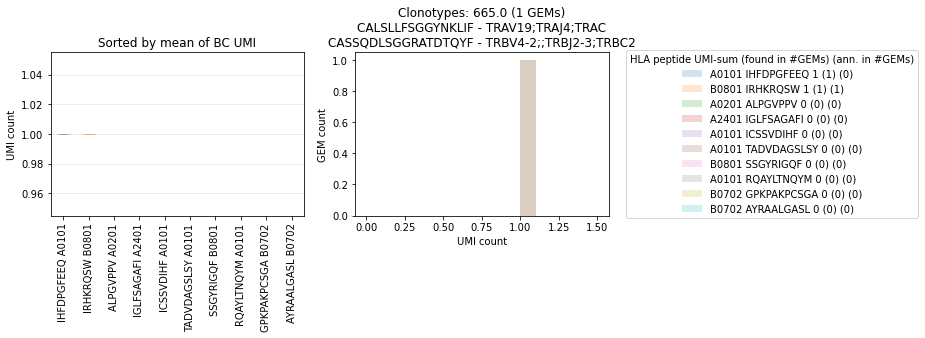

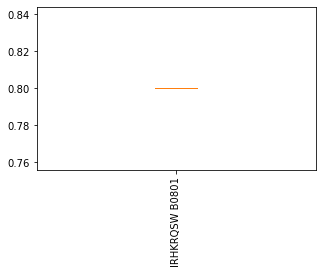

[222.]
('CASSQDVPGDYTEAFF', 'CAEIHSGGGADGLTF') unresolved
       peptide                                        peptide_lst  \
491  NLVPMVATV  ['FSAGAFILYK' 'TPRVTGGGAM' 'FISPQLQRI' 'AYLTNQ...   

             umi_count_lst_mhc     cdr3_lst_TRA          genes_lst_TRA  \
491  [1, 1, 1, 1, 2, 4, 5, 60]  CAEIHSGGGADGLTF  ['TRAV5;TRAJ45;TRAC']   

    umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
491                 3  CASSQDVPGDYTEAFF  ['TRBV4-3;;TRBJ1-1;TRBC1']   

    umi_count_lst_TRB  
491                 9  


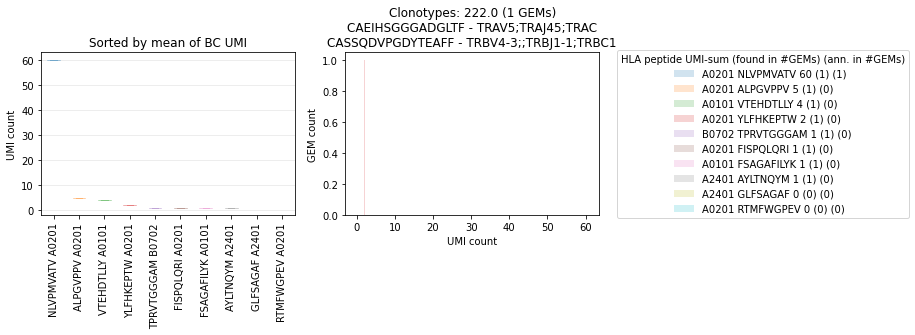

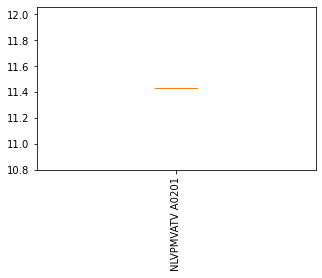

[324.]
('CASSQEGPNTEAFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2290  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB               genes_lst_TRB  \
2290               NaN  CASSQEGPNTEAFF  ['TRBV4-2;;TRBJ1-1;TRBC1']   

     umi_count_lst_TRB  
2290                10  


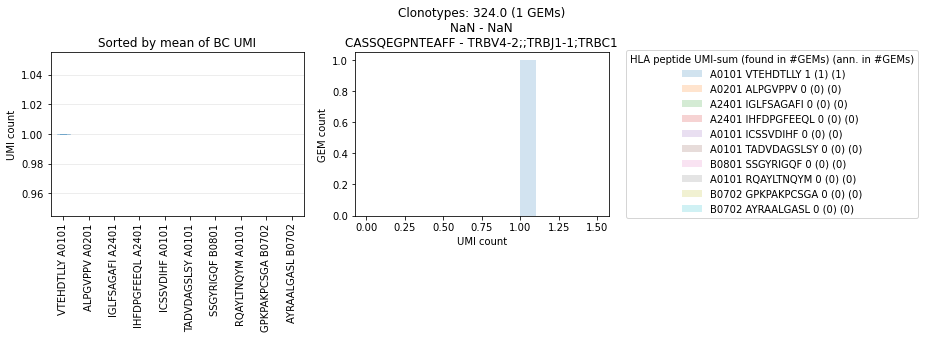

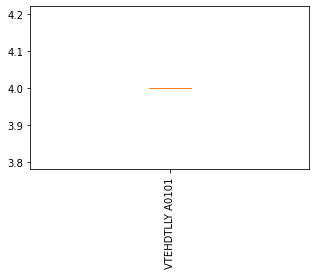

[562.]
('CASSQEMDSGHYEQYF', 'CALSETMGAGSYQLTF') unresolved
       peptide   peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
1639  RAKFKQLL  ['RAKFKQLL']               [1]  CALSETMGAGSYQLTF   

               genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
1639  ['TRAV19;TRAJ28;TRAC']                 6  CASSQEMDSGHYEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
1639  ['TRBV4-1;;TRBJ2-7;TRBC2']                28  


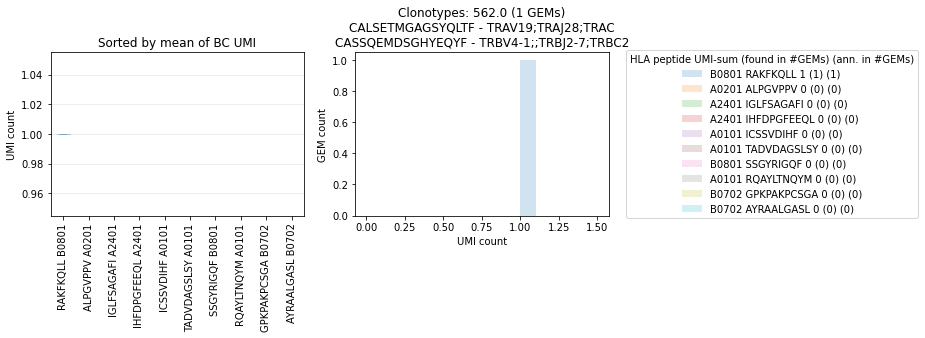

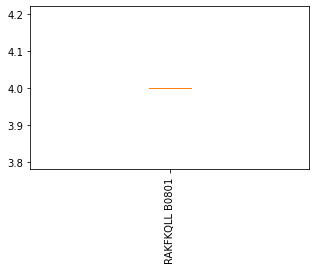

[559.]
('CASSQESLPSYEQYF', 'CVVKDYGQNFVF') unresolved
        peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1351  VTEHDTLLY  ['VTEHDTLLY']               [1]  CVVKDYGQNFVF   

                 genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
1351  ['TRAV12-1;TRAJ26;TRAC']                 3  CASSQESLPSYEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
1351  ['TRBV4-1;;TRBJ2-7;TRBC2']                 7  


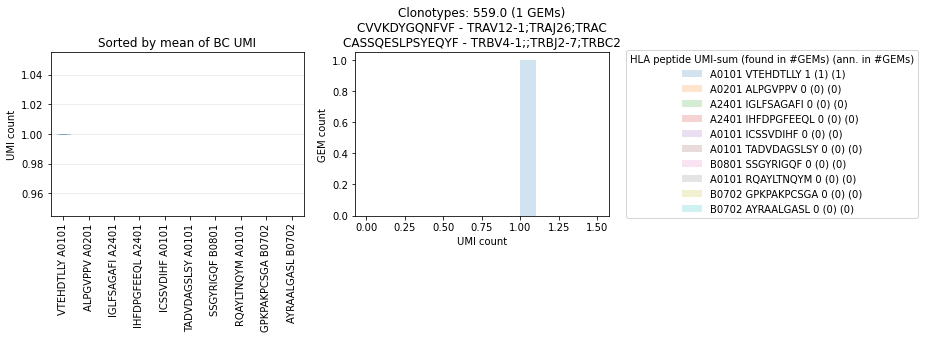

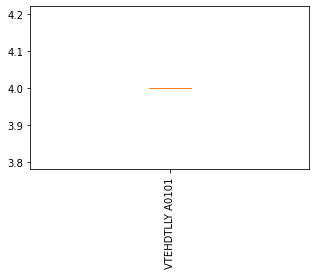

[513.]
('CASSQGDEQFF', 'CAVFSGSARQLTF') unresolved
         peptide                  peptide_lst umi_count_lst_mhc  \
898  EERQAYLTNQY  ['VTEHDTLLY' 'EERQAYLTNQY']            [1, 1]   

      cdr3_lst_TRA            genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB  \
898  CAVFSGSARQLTF  ['TRAV1-1;TRAJ22;TRAC']                 3  CASSQGDEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
898  ['TRBV12-4;;TRBJ2-1;TRBC2']                14  


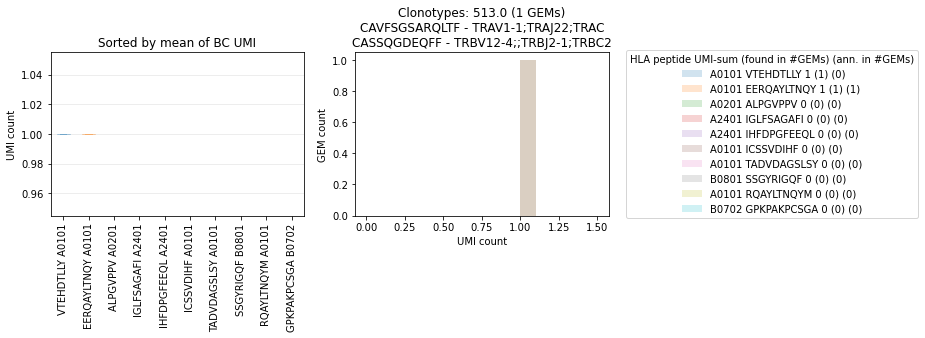

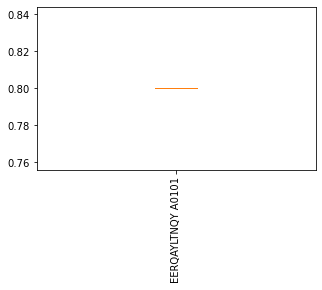

[357.]
('CASSQGKTQYF', 'NaN') unresolved
       peptide               peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2277  RAKFKQLL  ['VTEHDTLLY' 'RAKFKQLL']            [1, 1]                

     genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB  \
2277           NaN               NaN  CASSQGKTQYF   

                    genes_lst_TRB umi_count_lst_TRB  
2277  ['TRBV12-4;;TRBJ2-5;TRBC2']                 8  


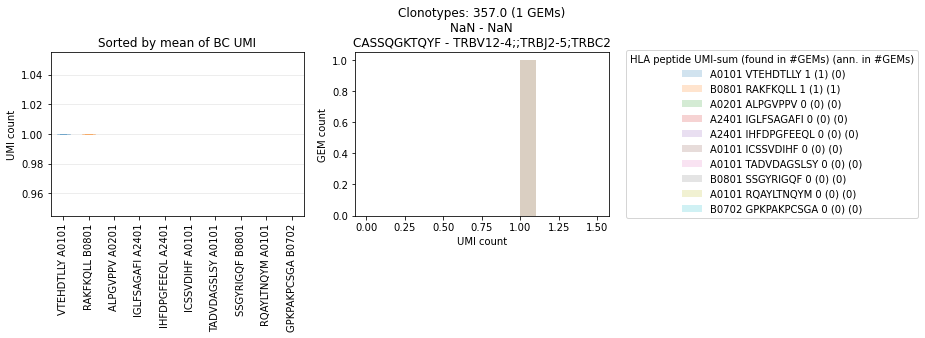

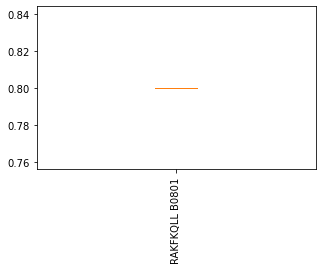

[239.]
('CASSQGQPSNQPQHF', 'CLADSGNTGKLIF') unresolved
        peptide                           peptide_lst umi_count_lst_mhc  \
2069  VTEHDTLLY  ['RAKFKQLL' 'WPRAPRGQI' 'VTEHDTLLY']         [1, 1, 1]   

       cdr3_lst_TRA          genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2069  CLADSGNTGKLIF  ['TRAV4;TRAJ37;TRAC']                 2  CASSQGQPSNQPQHF   

                   genes_lst_TRB umi_count_lst_TRB  
2069  ['TRBV4-1;;TRBJ1-5;TRBC1']                 8  


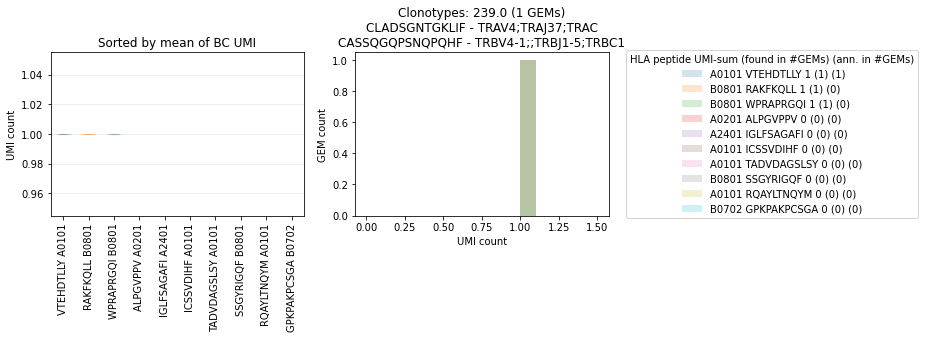

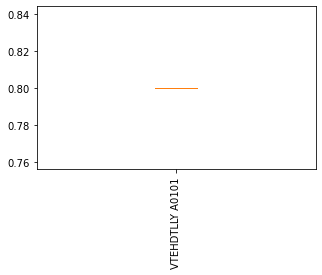

[670.]
('CASSQGQVLGYNEQFF', 'CALSEVGNQFYF') unresolved
       peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
319  VTEHDTLLY  ['VTEHDTLLY']               [1]  CALSEVGNQFYF   

              genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
319  ['TRAV19;TRAJ49;TRAC']                 2  CASSQGQVLGYNEQFF   

                  genes_lst_TRB umi_count_lst_TRB  
319  ['TRBV4-3;;TRBJ2-1;TRBC2']                13  


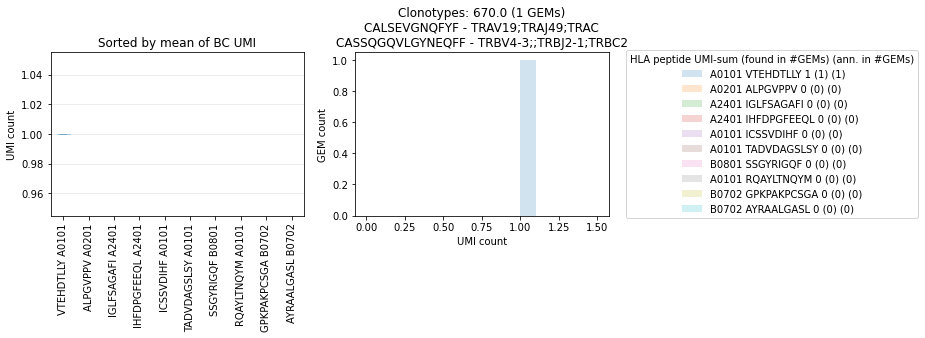

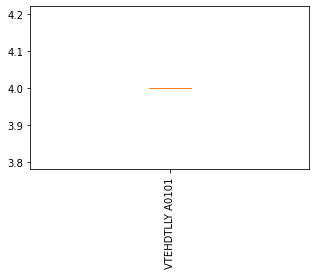

[687.]
('CASSQLTGELFF', 'CIVRVGGDSWGKLQF') unresolved
        peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1587  VTEHDTLLY  ['VTEHDTLLY']               [1]  CIVRVGGDSWGKLQF   

                 genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
1587  ['TRAV26-1;TRAJ24;TRAC']                 3  CASSQLTGELFF   

                  genes_lst_TRB umi_count_lst_TRB  
1587  ['TRBV27;;TRBJ2-2;TRBC2']                 3  


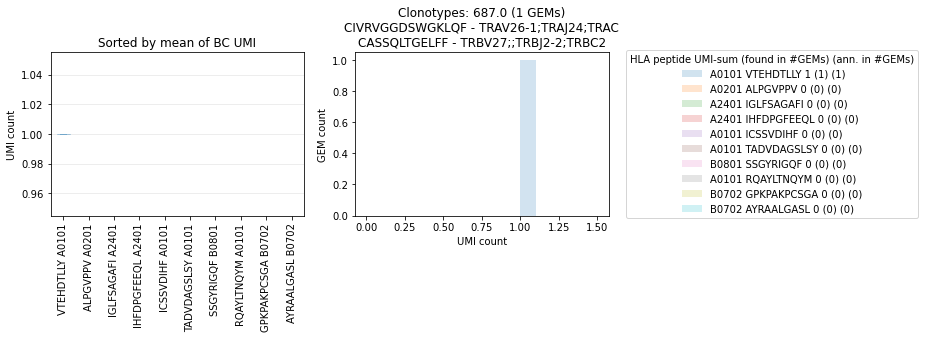

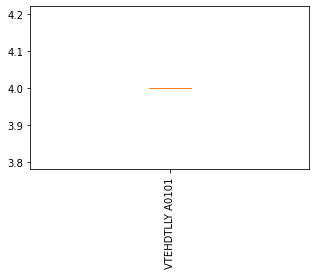

[350.]
('CASSQNTPLNEKLFF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2359  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB              genes_lst_TRB  \
2359               NaN  CASSQNTPLNEKLFF  ['TRBV16;;TRBJ1-4;TRBC1']   

     umi_count_lst_TRB  
2359                 4  


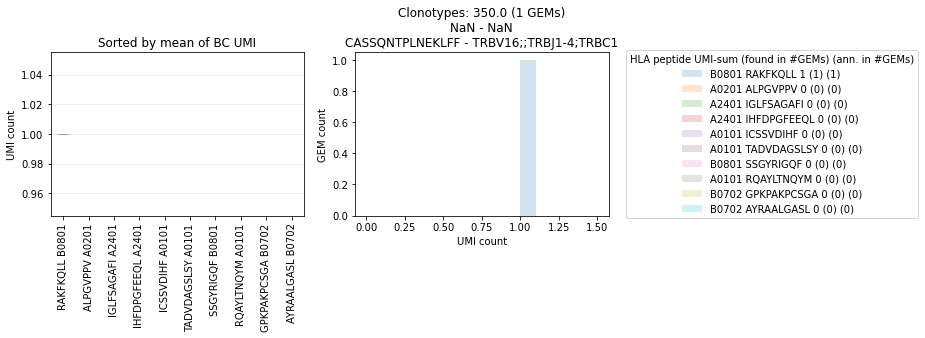

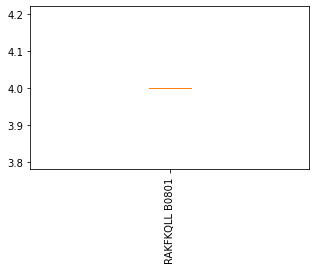

[166.]
('CASSQTYPNTGELFF', 'NaN') unresolved
       peptide                                        peptide_lst  \
2344  RAKFKQLL  ['FSAGAFILYN' 'TADVDAGSLSY' 'GPFPGNLV' 'VIRHKR...   

                              umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2344  [1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 5, 5, 294]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
2344               NaN  CASSQTYPNTGELFF  ['TRBV3-1;;TRBJ2-2;TRBC2']   

     umi_count_lst_TRB  
2344                12  


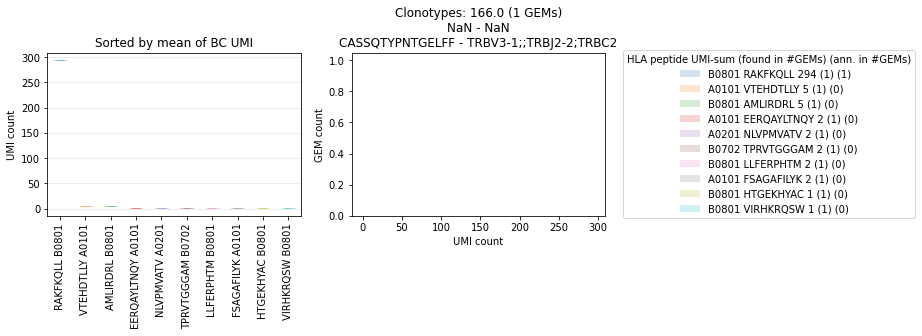

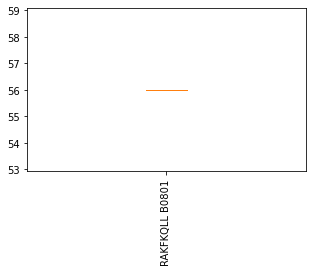

[660.]
('CASSQVGGSYGYTF', 'CAVQPSSGPMNYGGSQGNLIF') unresolved
        peptide    peptide_lst umi_count_lst_mhc           cdr3_lst_TRA  \
1104  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVQPSSGPMNYGGSQGNLIF   

               genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1104  ['TRAV20;TRAJ42;TRAC']                 4  CASSQVGGSYGYTF   

                   genes_lst_TRB umi_count_lst_TRB  
1104  ['TRBV4-1;;TRBJ1-2;TRBC1']                 8  


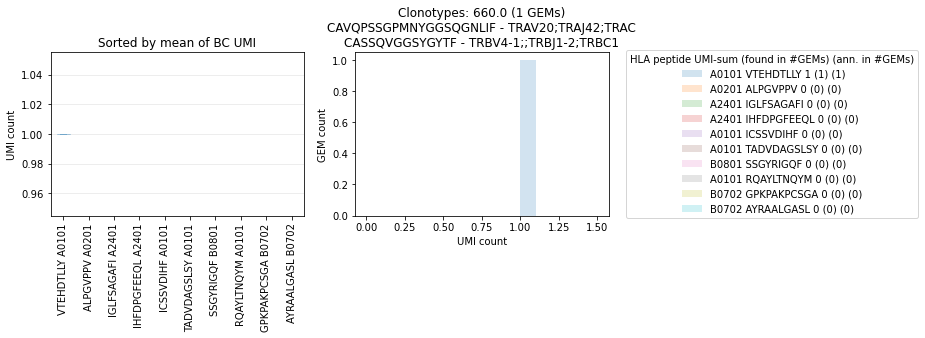

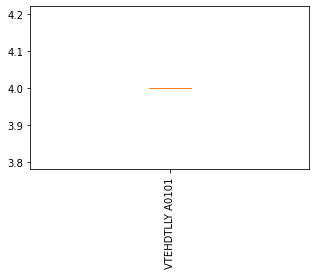

[321.]
('CASSQVLGGLSETQYF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2160  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
2160               NaN  CASSQVLGGLSETQYF  ['TRBV4-2;;TRBJ2-5;TRBC2']   

     umi_count_lst_TRB  
2160                12  


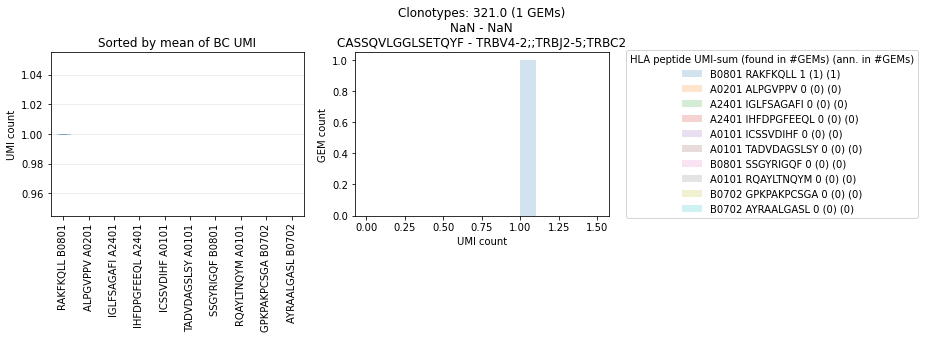

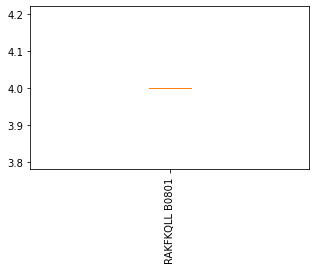

[325.]
('CASSQVSGDPYEQYF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2222  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
2222               NaN  CASSQVSGDPYEQYF  ['TRBV4-1;;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
2222                 9  


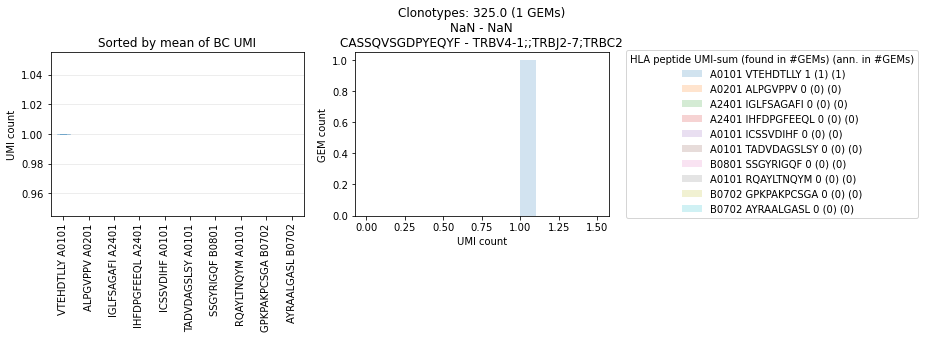

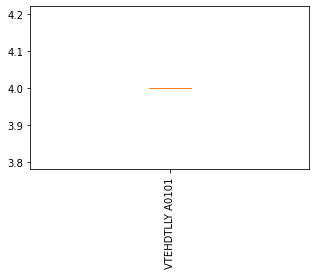

[698.]
('CASSQVWGEQYF', 'CAGDNYGQNFVF') unresolved
        peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1530  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAGDNYGQNFVF   

               genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
1530  ['TRAV25;TRAJ26;TRAC']                 3  CASSQVWGEQYF   

                  genes_lst_TRB umi_count_lst_TRB  
1530  ['TRBV14;;TRBJ2-7;TRBC2']                23  


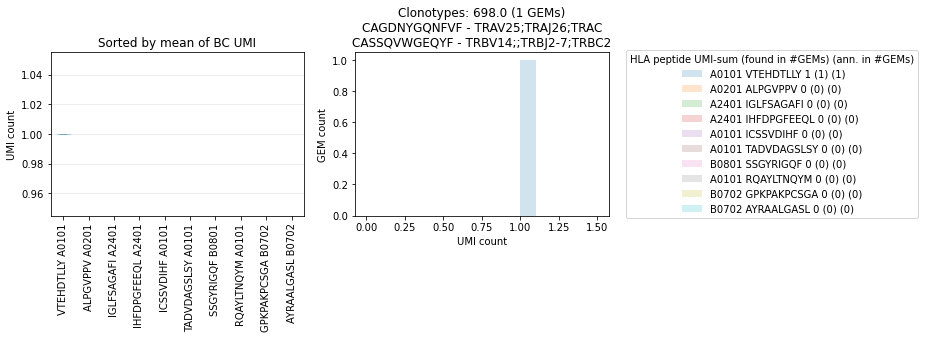

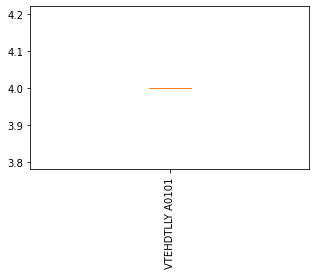

[572.]
('CASSRGTHNEKLFF', 'CAASWGWAGGTSYGKLTF') unresolved
        peptide    peptide_lst umi_count_lst_mhc        cdr3_lst_TRA  \
1863  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAASWGWAGGTSYGKLTF   

                   genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1863  ['TRAV29/DV5;TRAJ52;TRAC']                 3  CASSRGTHNEKLFF   

                   genes_lst_TRB umi_count_lst_TRB  
1863  ['TRBV5-5;;TRBJ1-4;TRBC1']                 8  


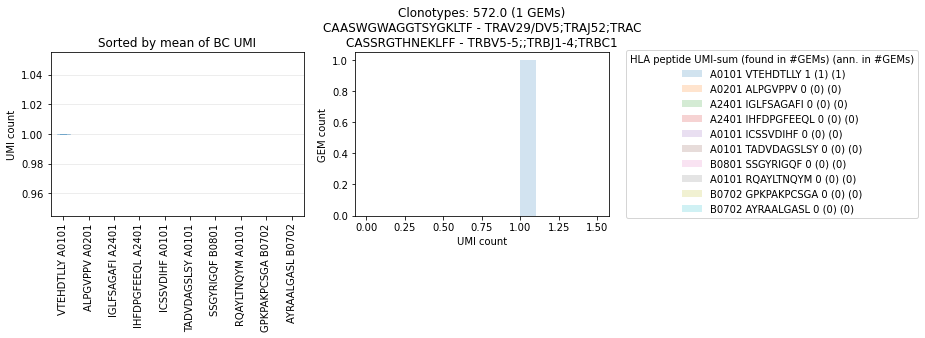

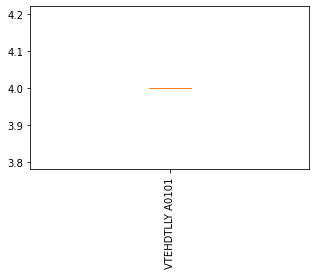

[361.]
('CASSRQPGQGTTDTQYF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2158  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA       cdr3_lst_TRB                     genes_lst_TRB  \
2158               NaN  CASSRQPGQGTTDTQYF  ['TRBV12-3;TRBD1;TRBJ2-3;TRBC2']   

     umi_count_lst_TRB  
2158                13  


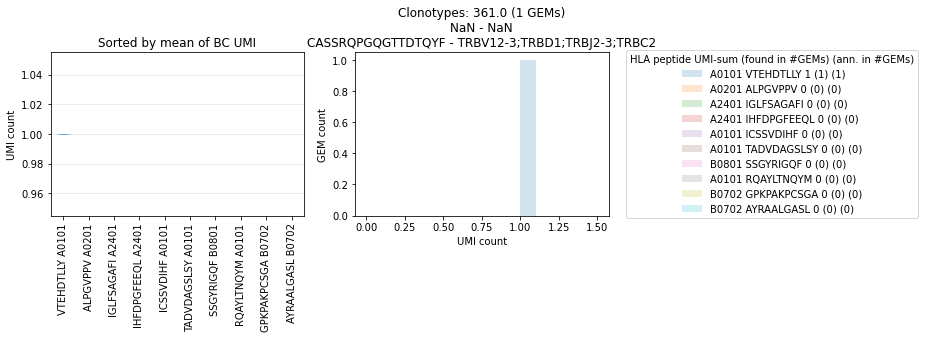

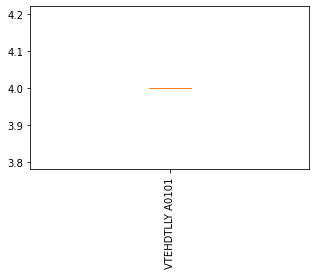

[430.]
('CASSSGGPGDQPQHF', 'CAALETSYDKVIF') unresolved
        peptide                  peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
811  TPRVTGGGAM  ['SVDIHFDPGF' 'TPRVTGGGAM']            [1, 1]  CAALETSYDKVIF   

                genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
811  ['TRAV13-1;TRAJ50;TRAC']                 2  CASSSGGPGDQPQHF   

                  genes_lst_TRB umi_count_lst_TRB  
811  ['TRBV7-8;;TRBJ1-5;TRBC1']                 6  


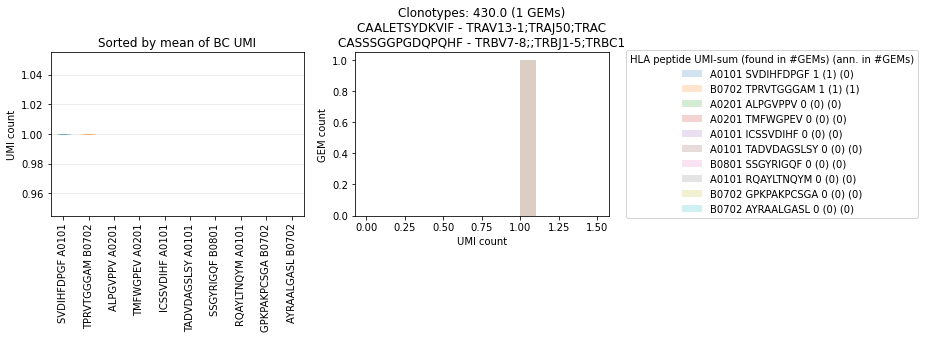

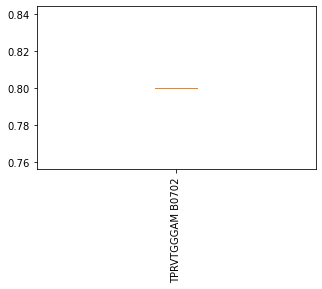

[528.]
('CASSSGLAVDTQYF', 'CVVTLPTGFQKLVF') unresolved
        peptide     peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
586  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CVVTLPTGFQKLVF   

               genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
586  ['TRAV12-1;TRAJ8;TRAC']                 2  CASSSGLAVDTQYF   

                  genes_lst_TRB umi_count_lst_TRB  
586  ['TRBV5-1;;TRBJ2-3;TRBC2']                17  


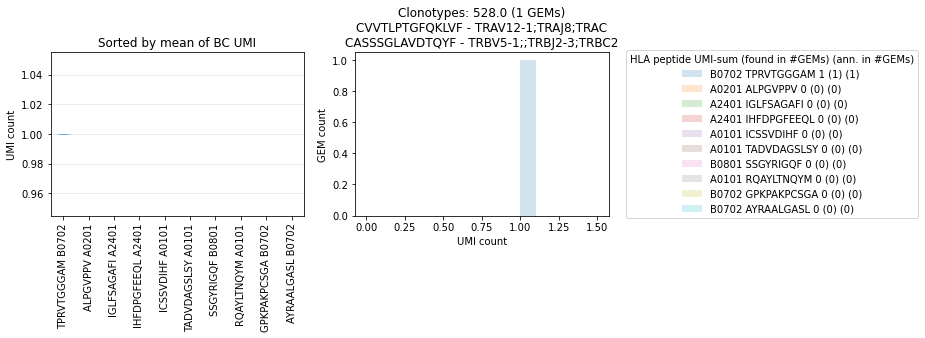

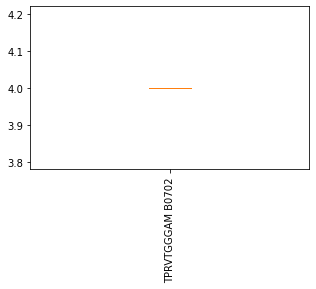

[645.]
('CASSSGQGVTYEQYF', 'CAVRSGGYQKVTF') unresolved
       peptide                 peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
504  RRKVPAQRL  ['TPRVTGGGAM' 'RRKVPAQRL']            [1, 1]  CAVRSGGYQKVTF   

              genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
504  ['TRAV21;TRAJ13;TRAC']                 2  CASSSGQGVTYEQYF   

                     genes_lst_TRB umi_count_lst_TRB  
504  ['TRBV9;TRBD1;TRBJ2-7;TRBC2']                 4  


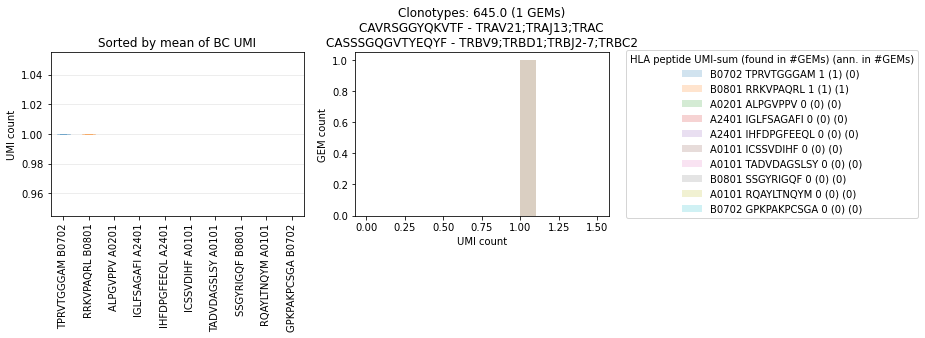

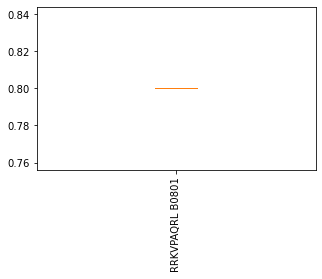

[533.]
('CASSSGTGGEKLFF', 'CAVNSKGYKLSF') unresolved
     peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
4  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVNSKGYKLSF   

              genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
4  ['TRAV12-2;TRAJ20;TRAC']                 1  CASSSGTGGEKLFF   

                     genes_lst_TRB umi_count_lst_TRB  
4  ['TRBV5-8;TRBD1;TRBJ1-4;TRBC1']                 4  


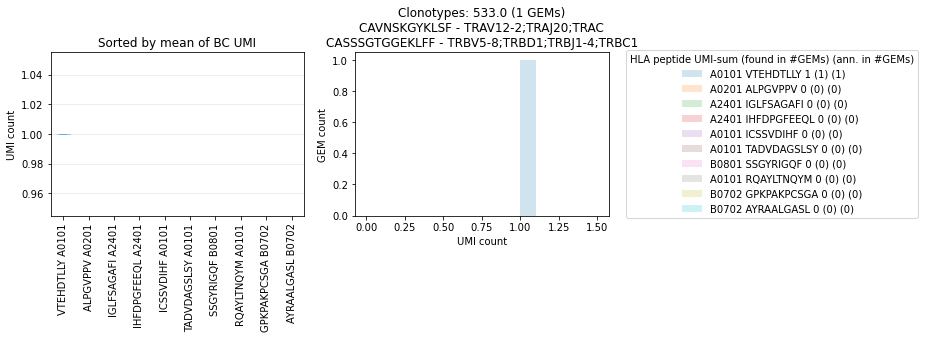

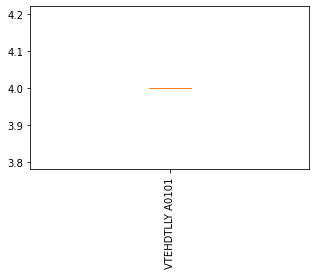

[82.]
('CASSSHDNRGSRTEAFF', 'CAMREGRDSSYKLIF') unresolved
         peptide                                        peptide_lst  \
1181  TPRVTGGGAM  ['FSAGAFILYK' 'VPEGPFPGNLV' 'YPLVKMRLSV' 'RAKF...   

              umi_count_lst_mhc     cdr3_lst_TRA               genes_lst_TRA  \
1181  [1, 1, 1, 2, 2, 3, 3, 63]  CAMREGRDSSYKLIF  ['TRAV14/DV4;TRAJ12;TRAC']   

     umi_count_lst_TRA       cdr3_lst_TRB               genes_lst_TRB  \
1181                 2  CASSSHDNRGSRTEAFF  ['TRBV7-9;;TRBJ1-1;TRBC1']   

     umi_count_lst_TRB  
1181                17  


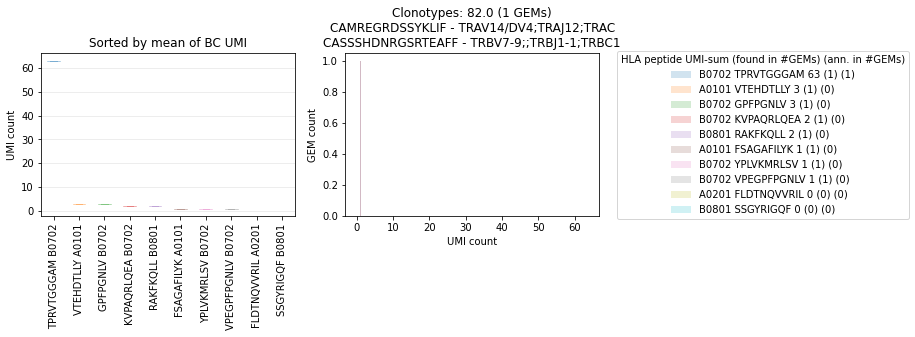

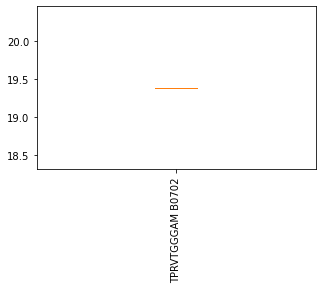

[202.]
('CASSSHDNRGSRTEAFF', 'NaN') unresolved
         peptide                                        peptide_lst  \
2094  LHPSTPLKPL  ['VTEHDTLLY' 'RAKFKQLL' 'GPFPGNLVD' 'SVDIHFDPG...   

          umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2094  [1, 1, 1, 1, 1, 1, 1]                        NaN               NaN   

           cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
2094  CASSSHDNRGSRTEAFF  ['TRBV7-9;;TRBJ1-1;TRBC1']                 9  


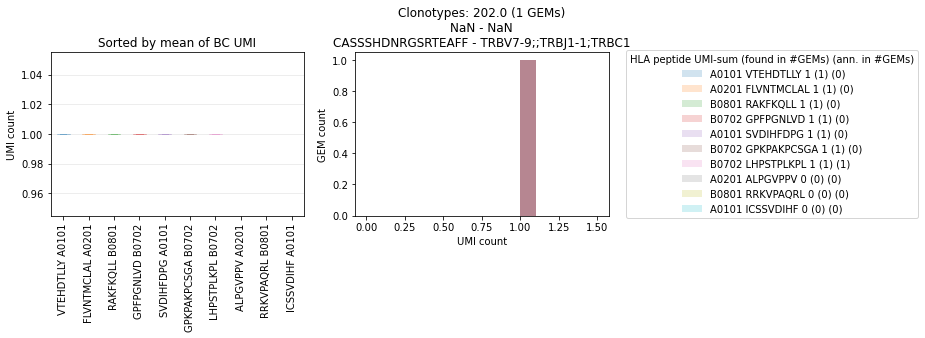

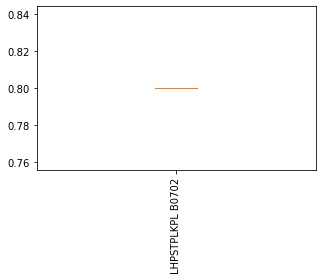

[178.]
('CASSSHEGTGVNSPLHF', 'NaN') unresolved
       peptide              peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2194  RAKFKQLL  ['YPLVKMRL' 'RAKFKQLL']            [1, 2]                

     genes_lst_TRA umi_count_lst_TRA       cdr3_lst_TRB  \
2194           NaN               NaN  CASSSHEGTGVNSPLHF   

                        genes_lst_TRB umi_count_lst_TRB  
2194  ['TRBV7-9;TRBD1;TRBJ1-6;TRBC1']                11  


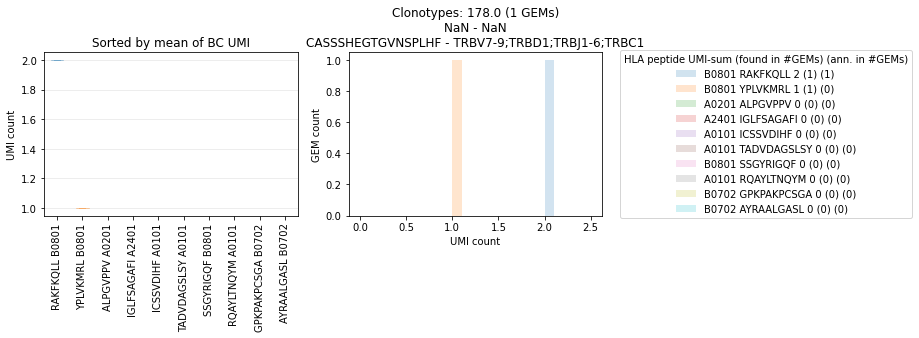

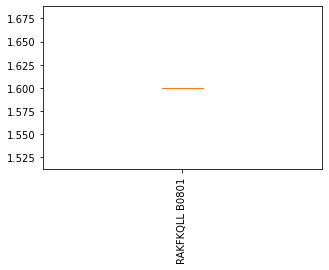

[159.]
('CASSSLNSPLHF', 'CIVRVGGDSWGKLQF') unresolved
      peptide   peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
867  RAKFKQLL  ['RAKFKQLL']               [2]  CIVRVGGDSWGKLQF   

                genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
867  ['TRAV26-1;TRAJ24;TRAC']                 4  CASSSLNSPLHF   

                 genes_lst_TRB umi_count_lst_TRB  
867  ['TRBV27;;TRBJ1-6;TRBC1']                 2  


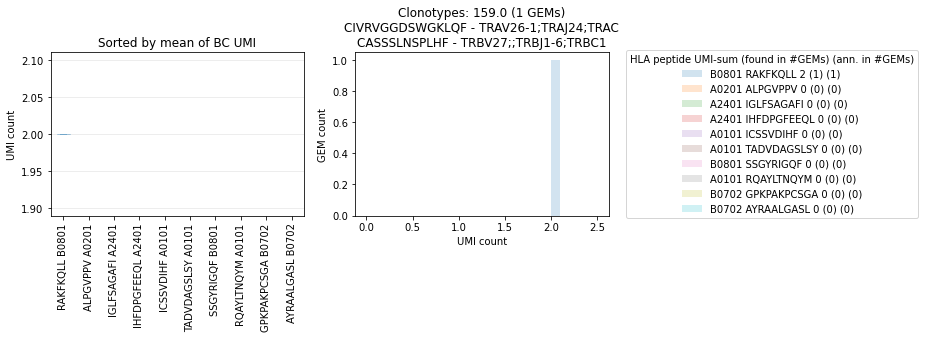

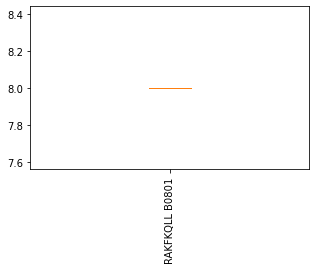

[64.]
('CASSSLNTEAFF', 'NaN') unresolved
       peptide                peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2175  RAKFKQLL  ['GLFSAGAFIL' 'RAKFKQLL']            [1, 1]                

     genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB              genes_lst_TRB  \
2175           NaN               NaN  CASSSLNTEAFF  ['TRBV27;;TRBJ1-1;TRBC1']   

     umi_count_lst_TRB  
2175                 9  


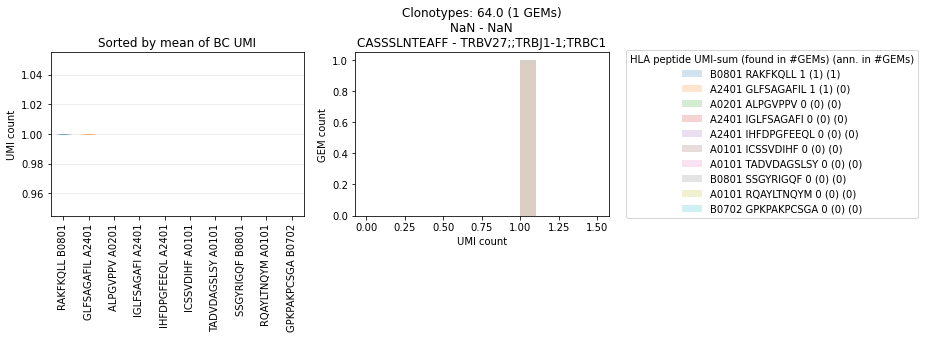

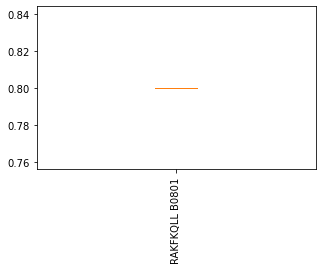

[563.]
('CASSSPRGYSYEQYF', 'CALSEANYGGATNKLIF') unresolved
        peptide               peptide_lst umi_count_lst_mhc  \
1318  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]   

           cdr3_lst_TRA           genes_lst_TRA umi_count_lst_TRA  \
1318  CALSEANYGGATNKLIF  ['TRAV19;TRAJ32;TRAC']                 4   

         cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
1318  CASSSPRGYSYEQYF  ['TRBV7-9;;TRBJ2-7;TRBC2']                 8  


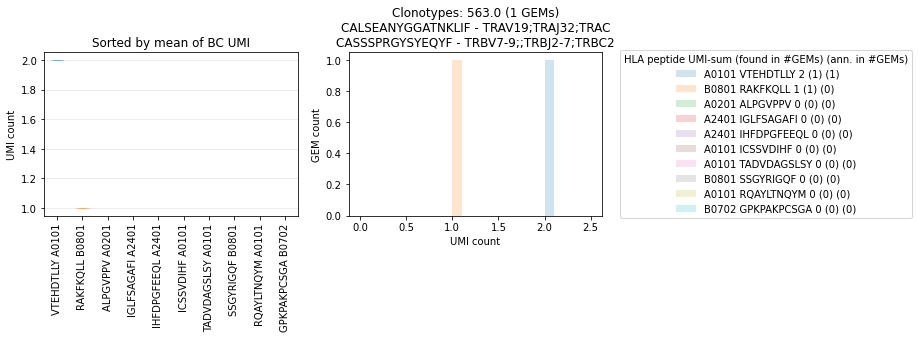

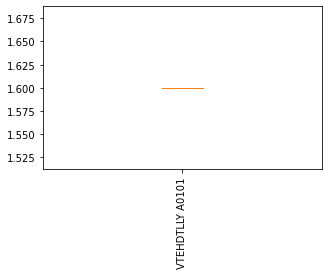

[254.]
('CASSSRLTSGSFDEQFF', 'CAVDGSARQLTF') unresolved
       peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
682  VTEHDTLLY  ['VTEHDTLLY']               [2]  CAVDGSARQLTF   

               genes_lst_TRA umi_count_lst_TRA       cdr3_lst_TRB  \
682  ['TRAV8-3;TRAJ22;TRAC']                 2  CASSSRLTSGSFDEQFF   

                  genes_lst_TRB umi_count_lst_TRB  
682  ['TRBV7-9;;TRBJ2-1;TRBC2']                 9  


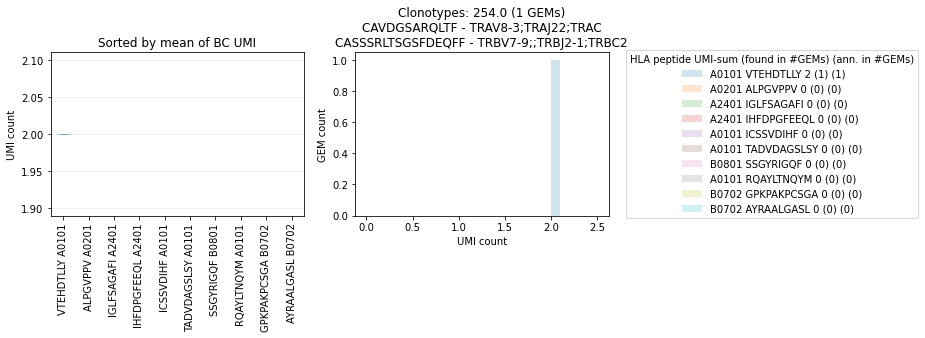

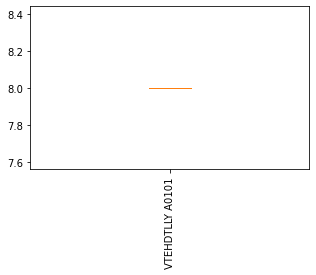

[277.]
('CASSSRQGPSYEQYF', 'CALDGGFKTIF') unresolved
       peptide               peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
179  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 2]  CALDGGFKTIF   

              genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
179  ['TRAV9-2;TRAJ9;TRAC']                 1  CASSSRQGPSYEQYF   

                  genes_lst_TRB umi_count_lst_TRB  
179  ['TRBV7-8;;TRBJ2-7;TRBC2']                22  


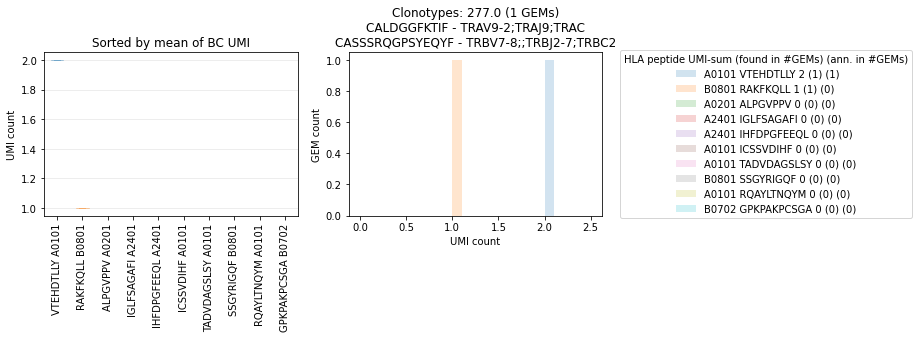

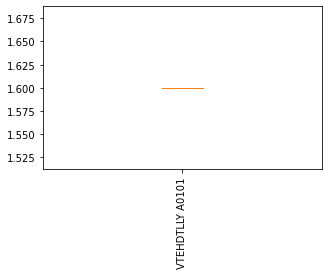

[281.]
('CASSSRSGWQPQHF', 'NaN') unresolved
         peptide     peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2281  FSAGAFILYK  ['FSAGAFILYK']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB              genes_lst_TRB  \
2281               NaN  CASSSRSGWQPQHF  ['TRBV28;;TRBJ1-5;TRBC1']   

     umi_count_lst_TRB  
2281                12  


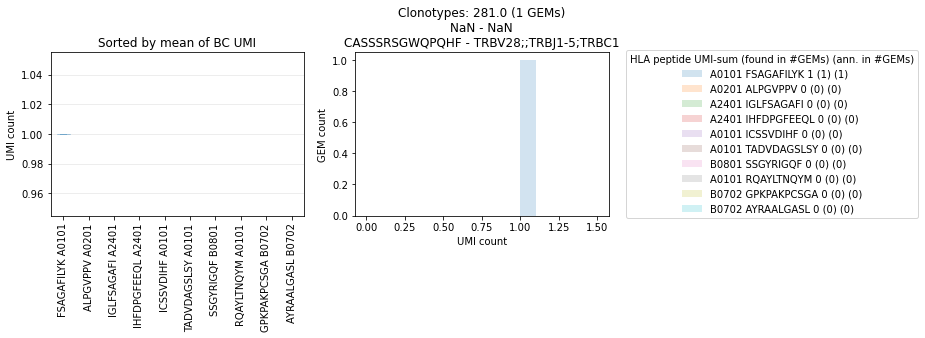

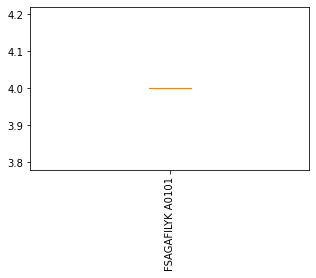

[176.]
('CASSSSGQGFTEQFF', 'NaN') unresolved
        peptide                  peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2319  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 57]                

     genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2319           NaN               NaN  CASSSSGQGFTEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
2319  ['TRBV7-9;;TRBJ2-1;TRBC2']                16  


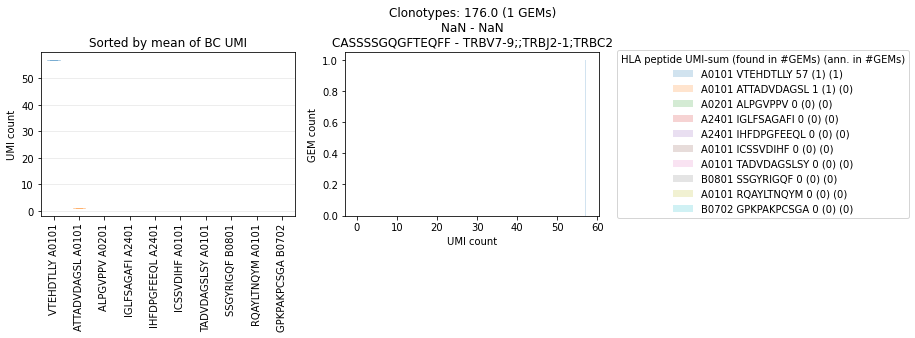

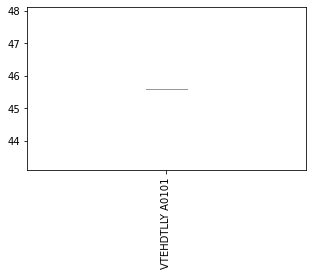

[214.]
('CASSTGLAGNTGELFF', 'CAEIPPGATNKLIF') unresolved
       peptide                                        peptide_lst  \
1002  RAKFKQLL  ['WPRAPRGQ' 'KSPFTETWNF' 'RQSWVNATL' 'LFSAGAFI...   

          umi_count_lst_mhc    cdr3_lst_TRA          genes_lst_TRA  \
1002  [1, 1, 1, 1, 2, 2, 5]  CAEIPPGATNKLIF  ['TRAV5;TRAJ32;TRAC']   

     umi_count_lst_TRA      cdr3_lst_TRB               genes_lst_TRB  \
1002                 1  CASSTGLAGNTGELFF  ['TRBV5-1;;TRBJ2-2;TRBC2']   

     umi_count_lst_TRB  
1002                 7  


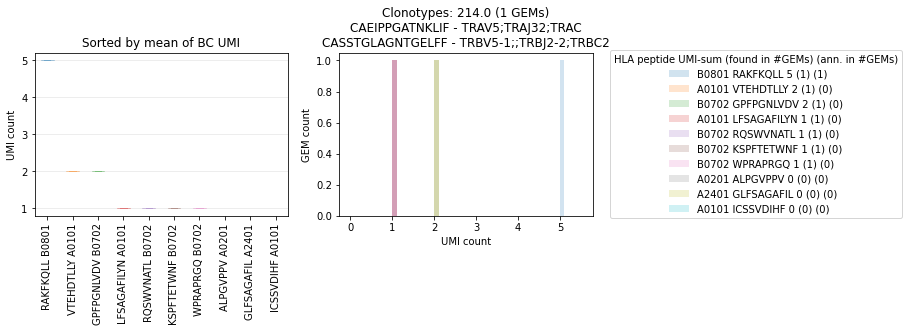

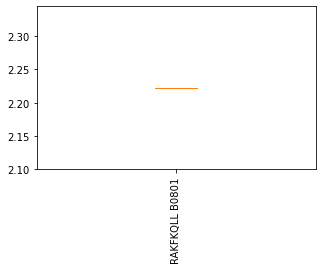

[237.]
('CASSTGLYYEQYF', 'CAVKNYGGSQGNLIF') unresolved
       peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
278  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVKNYGGSQGNLIF   

              genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
278  ['TRAV41;TRAJ42;TRAC']                 3  CASSTGLYYEQYF   

                 genes_lst_TRB umi_count_lst_TRB  
278  ['TRBV19;;TRBJ2-7;TRBC2']                 5  


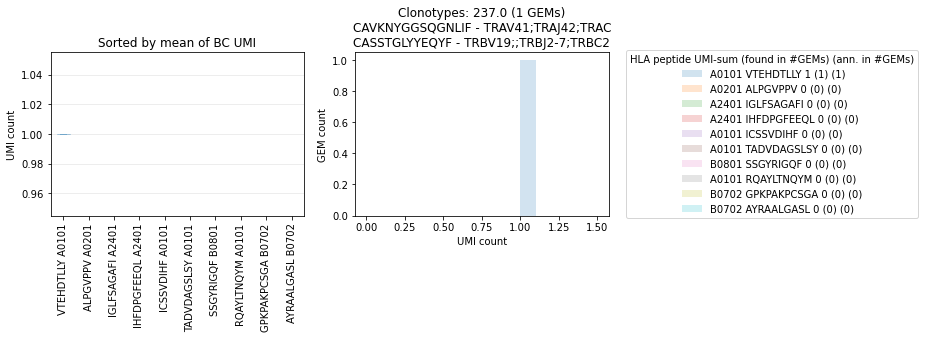

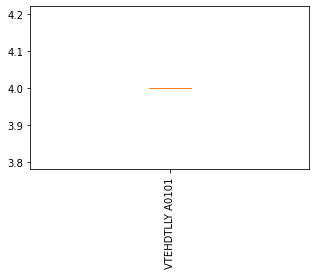

[241.]
('CASSVAAGPSYEQYF', 'NaN') unresolved
        peptide                               peptide_lst umi_count_lst_mhc  \
2110  VTEHDTLLY  ['TPRVTGGGAM' 'ATTADVDAGSL' 'VTEHDTLLY']        [1, 1, 40]   

     cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2110                        NaN               NaN  CASSVAAGPSYEQYF   

                 genes_lst_TRB umi_count_lst_TRB  
2110  ['TRBV9;;TRBJ2-7;TRBC2']                 7  


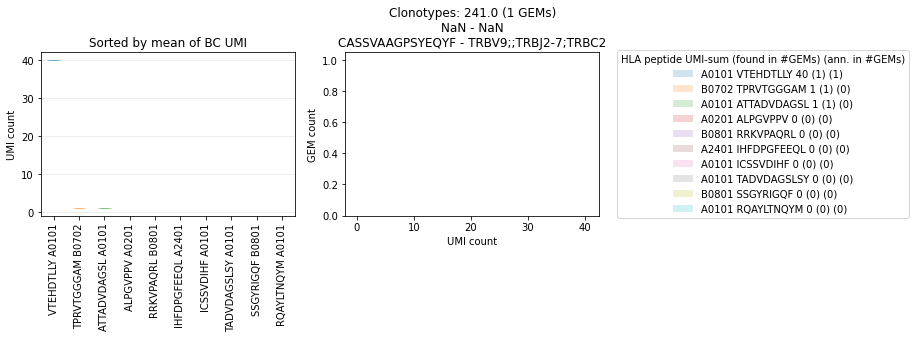

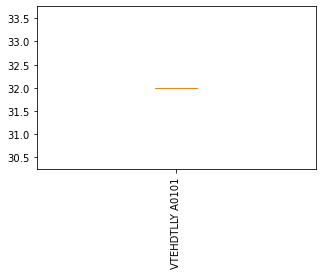

[215.]
('CASSVAGGRPTDTQYF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2242  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA      cdr3_lst_TRB             genes_lst_TRB  \
2242               NaN  CASSVAGGRPTDTQYF  ['TRBV9;;TRBJ2-3;TRBC2']   

     umi_count_lst_TRB  
2242                 2  


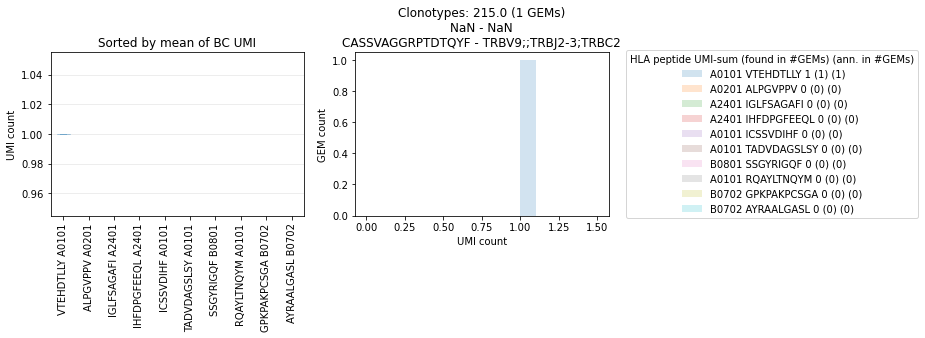

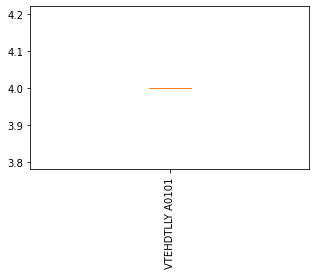

[650.]
('CASSVARQGGDTIYF', 'CAPGPGTYKYIF') unresolved
        peptide                                        peptide_lst  \
1323  VTEHDTLLY  ['DEYVHNTTA' 'QAYLTNQY' 'FSAGAFILYN' 'RQAYLTNQ...   

            umi_count_lst_mhc  cdr3_lst_TRA           genes_lst_TRA  \
1323  [1, 1, 1, 2, 2, 3, 112]  CAPGPGTYKYIF  ['TRAV21;TRAJ40;TRAC']   

     umi_count_lst_TRA     cdr3_lst_TRB             genes_lst_TRB  \
1323                 5  CASSVARQGGDTIYF  ['TRBV9;;TRBJ1-3;TRBC1']   

     umi_count_lst_TRB  
1323                11  


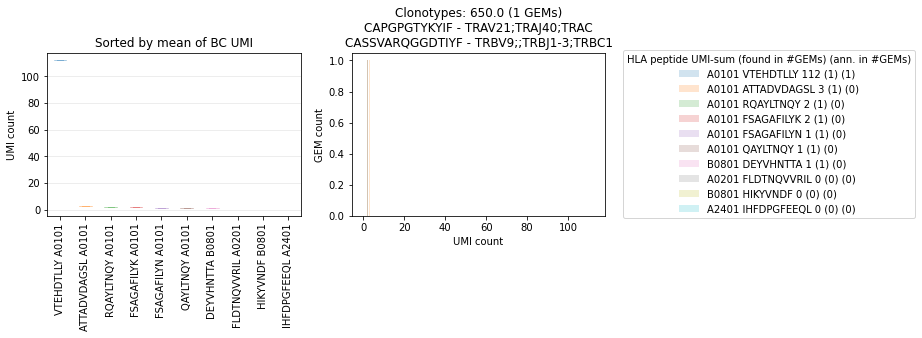

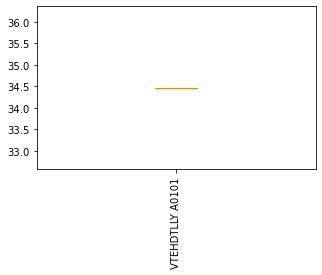

[423.]
('CASSVASAGRYGYTF', 'CAMREGNSGNTPLVF') unresolved
         peptide                              peptide_lst umi_count_lst_mhc  \
399  TNQYMQRMASV  ['RQAYLTNQY' 'VTEHDTLLY' 'TNQYMQRMASV']        [1, 8, 12]   

        cdr3_lst_TRA               genes_lst_TRA umi_count_lst_TRA  \
399  CAMREGNSGNTPLVF  ['TRAV14/DV4;TRAJ29;TRAC']                 3   

        cdr3_lst_TRB             genes_lst_TRB umi_count_lst_TRB  
399  CASSVASAGRYGYTF  ['TRBV9;;TRBJ1-2;TRBC1']                 4  


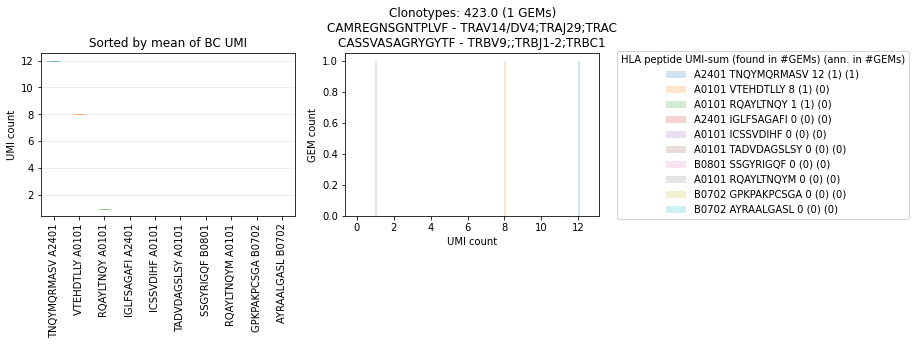

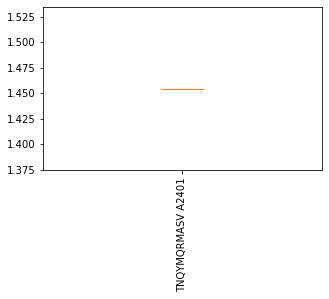

[264.]
('CASSVDAGGRNYGYTF', 'NaN') unresolved
         peptide     peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2122  TADVDAGSLS  ['TADVDAGSLS']               [1]                        NaN   

     umi_count_lst_TRA      cdr3_lst_TRB             genes_lst_TRB  \
2122               NaN  CASSVDAGGRNYGYTF  ['TRBV9;;TRBJ1-2;TRBC1']   

     umi_count_lst_TRB  
2122                 3  


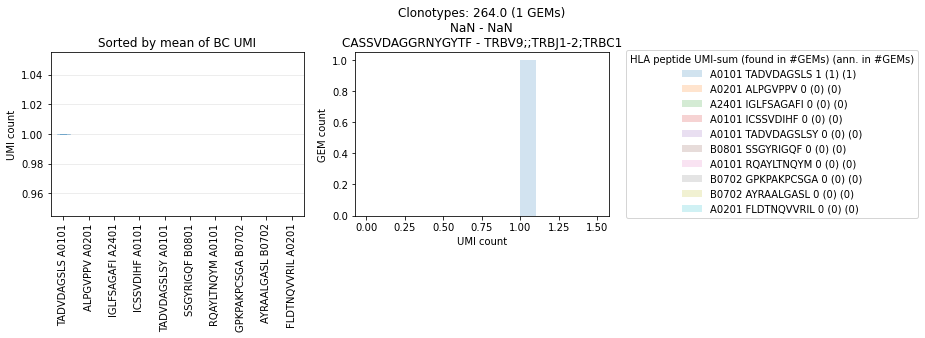

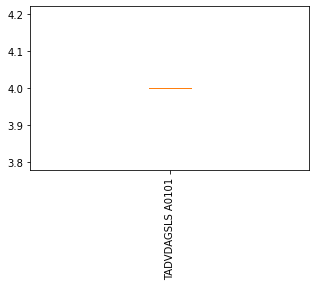

[587.]
('CASSVDAGYSTDTQYF', 'CAGARAGNNRKLIW') unresolved
       peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
858  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAGARAGNNRKLIW   

              genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
858  ['TRAV27;TRAJ38;TRAC']                 2  CASSVDAGYSTDTQYF   

                genes_lst_TRB umi_count_lst_TRB  
858  ['TRBV9;;TRBJ2-3;TRBC2']                 7  


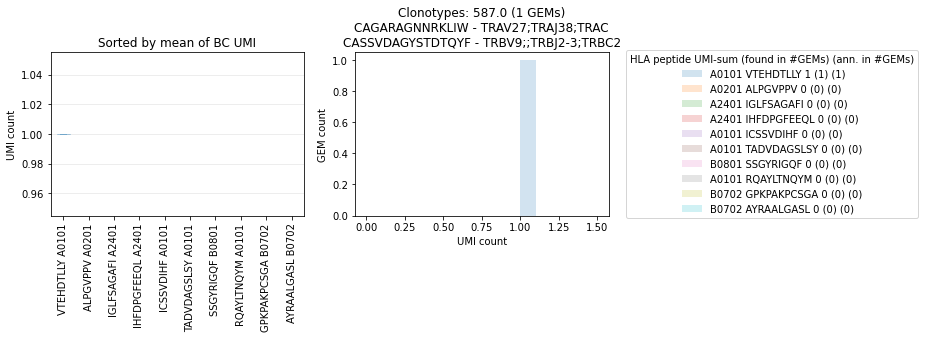

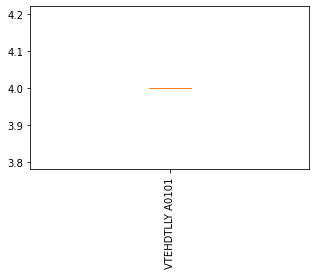

[682.]
('CASSVEGSRLTSEAFF', 'CAPATSGTYKYIF') unresolved
       peptide    peptide_lst umi_count_lst_mhc   cdr3_lst_TRA  \
625  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAPATSGTYKYIF   

              genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
625  ['TRAV25;TRAJ40;TRAC']                 4  CASSVEGSRLTSEAFF   

                genes_lst_TRB umi_count_lst_TRB  
625  ['TRBV9;;TRBJ1-1;TRBC1']                 4  


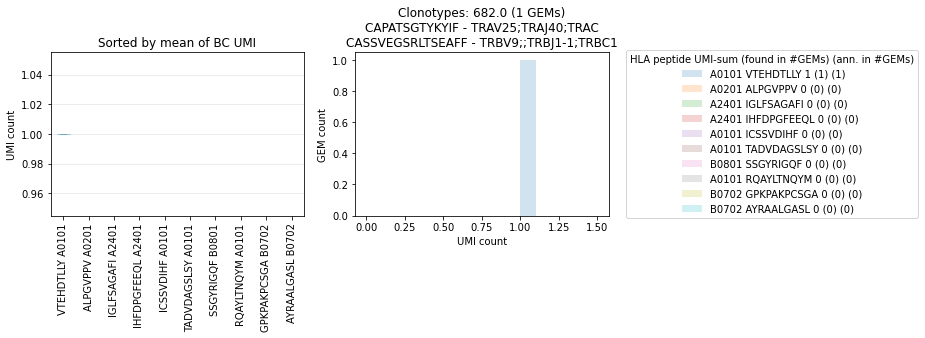

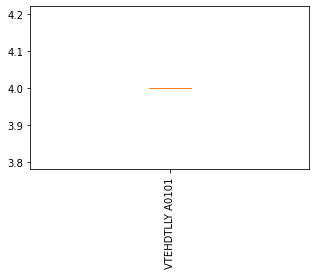

[600.]
('CASSVFAGGPPGELFF', 'CAALTHRGNTPLVF') unresolved
       peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
275  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAALTHRGNTPLVF   

                  genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
275  ['TRAV29/DV5;TRAJ29;TRAC']                 3  CASSVFAGGPPGELFF   

                   genes_lst_TRB umi_count_lst_TRB  
275  ['TRBV10-2;;TRBJ2-2;TRBC2']                 9  


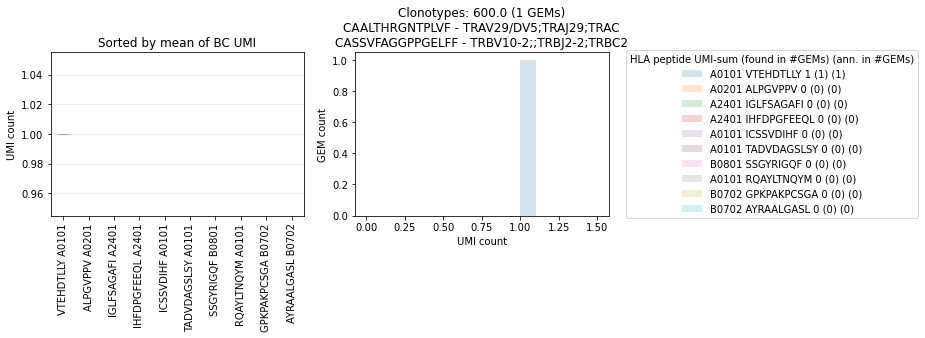

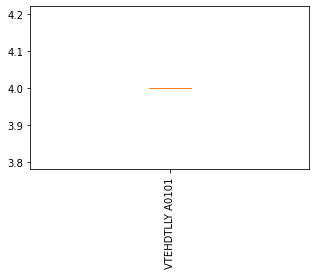

[156.]
('CASSVGGPAYEQYF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2195  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB             genes_lst_TRB  \
2195               NaN  CASSVGGPAYEQYF  ['TRBV9;;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
2195                14  


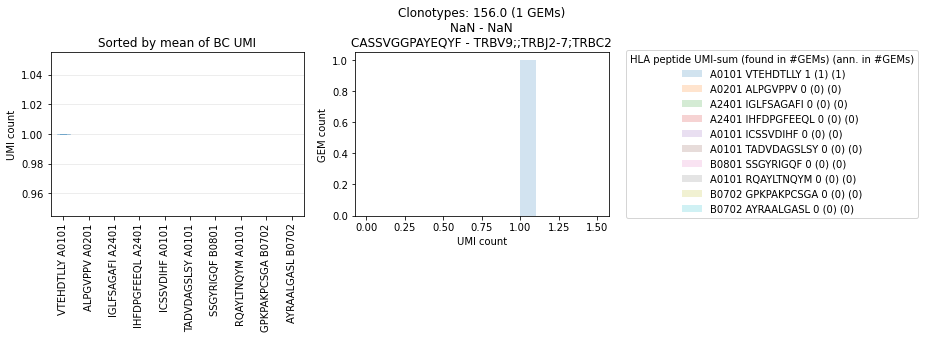

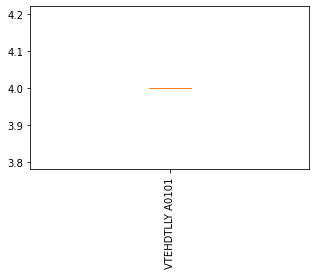

[487.]
('CASSVGLAASYEQYF', 'CALSEADNARLMF') unresolved
         peptide                   peptide_lst umi_count_lst_mhc  \
1277  TPRVTGGGAM  ['EERQAYLTNQY' 'TPRVTGGGAM']            [1, 1]   

       cdr3_lst_TRA           genes_lst_TRA umi_count_lst_TRA  \
1277  CALSEADNARLMF  ['TRAV19;TRAJ31;TRAC']                 1   

         cdr3_lst_TRB             genes_lst_TRB umi_count_lst_TRB  
1277  CASSVGLAASYEQYF  ['TRBV9;;TRBJ2-7;TRBC2']                 4  


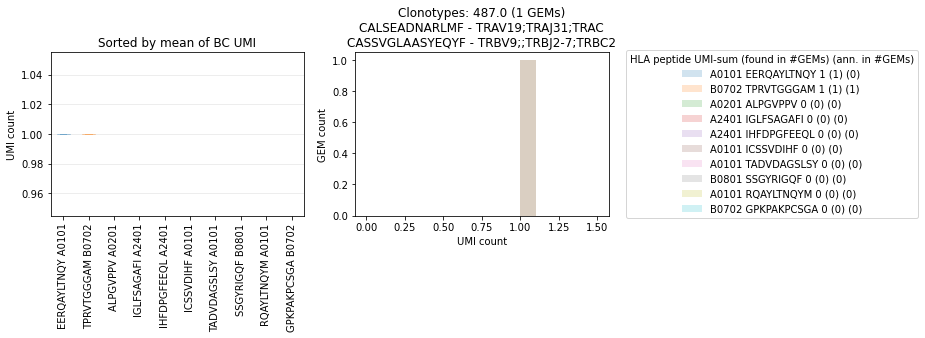

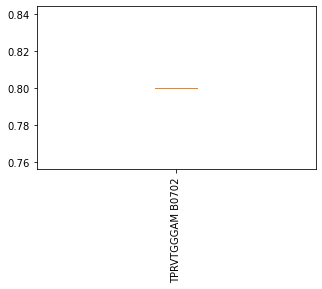

[391.]
('CASSVGPGGNQPQHF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2321  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB                    genes_lst_TRB  \
2321               NaN  CASSVGPGGNQPQHF  ['TRBV6-6;TRBD1;TRBJ1-5;TRBC1']   

     umi_count_lst_TRB  
2321                13  


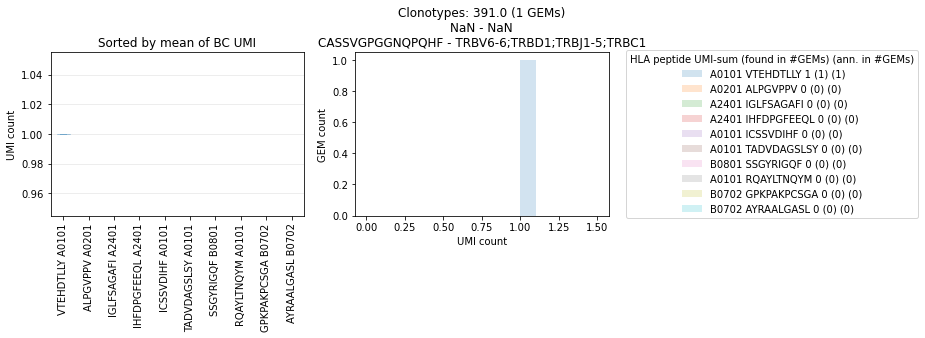

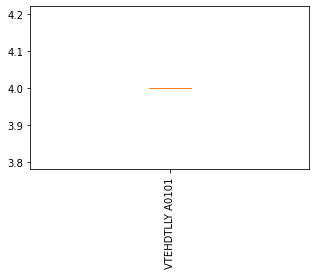

[684.]
('CASSVGQGRSYEQYF', 'CASLLIIQGAQKLVF') unresolved
        peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1901  NLVPMVATV  ['NLVPMVATV']               [2]  CASLLIIQGAQKLVF   

               genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
1901  ['TRAV25;TRAJ54;TRAC']                 1  CASSVGQGRSYEQYF   

                 genes_lst_TRB umi_count_lst_TRB  
1901  ['TRBV9;;TRBJ2-7;TRBC2']                 2  


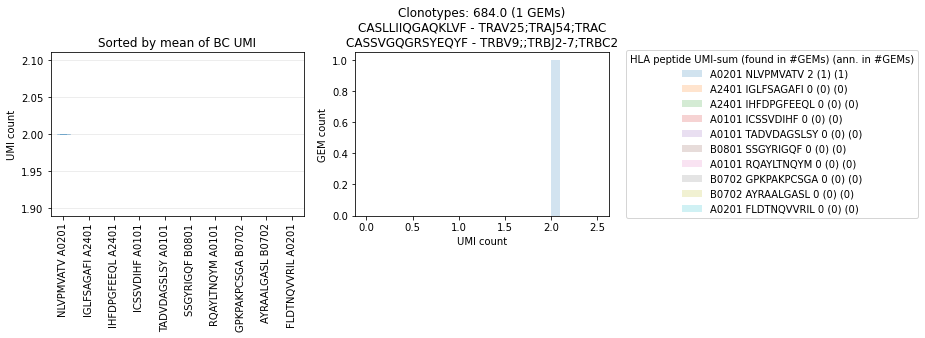

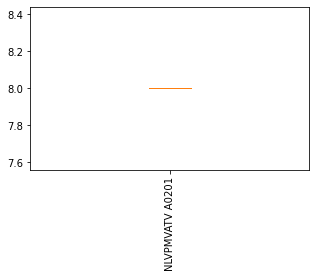

[161.]
('CASSVGQGSSYEQYF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2144  VTEHDTLLY  ['NLVPMVATV' 'SIKDGLPPV' 'DEYVHNTTA' 'TPRVTGGG...   

                                    umi_count_lst_mhc cdr3_lst_TRA  \
2144  [1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 3, 4, 6, 264]                

     genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
2144           NaN               NaN  CASSVGQGSSYEQYF   

                      genes_lst_TRB umi_count_lst_TRB  
2144  ['TRBV9;TRBD1;TRBJ2-7;TRBC2']                 3  


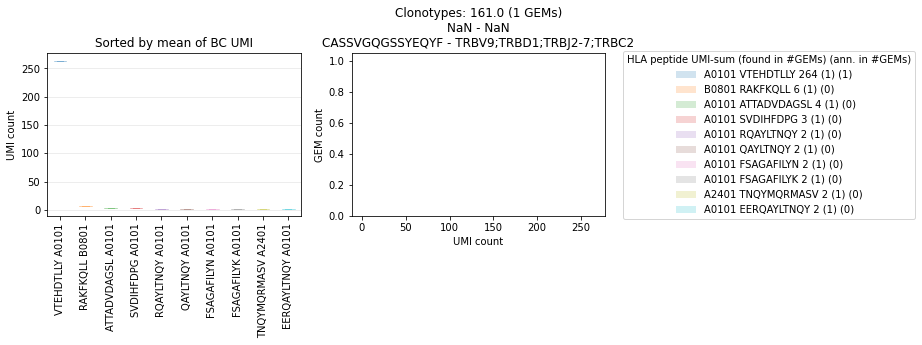

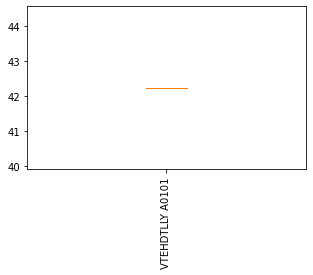

[644.]
('CASSVGQGVTYEQYF', 'CALRSGGYQKVTF') unresolved
        peptide                                        peptide_lst  \
1561  VTEHDTLLY  ['SVDIHFDPG' 'CSSVDIHF' 'GPKPAKPCSGA' 'ATTADVD...   

               umi_count_lst_mhc   cdr3_lst_TRA           genes_lst_TRA  \
1561  [1, 1, 1, 2, 2, 3, 3, 112]  CALRSGGYQKVTF  ['TRAV21;TRAJ13;TRAC']   

     umi_count_lst_TRA     cdr3_lst_TRB                  genes_lst_TRB  \
1561                 4  CASSVGQGVTYEQYF  ['TRBV9;TRBD1;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
1561                 5  


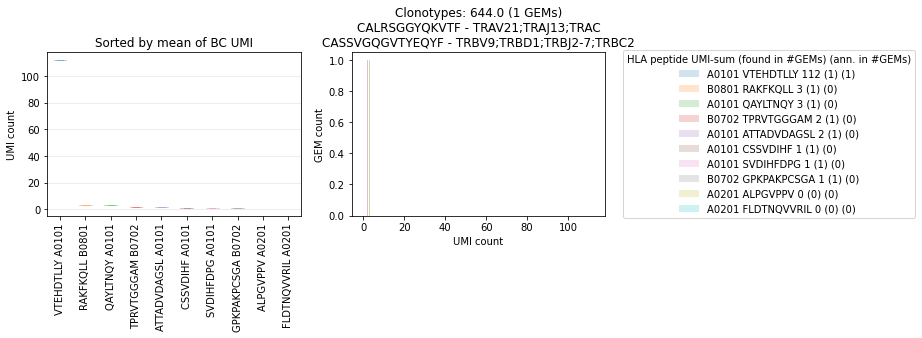

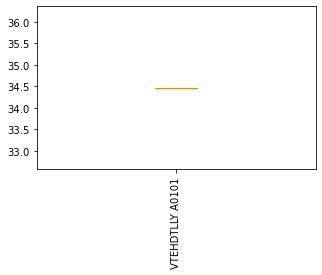

[646.]
('CASSVGQGVTYEQYF', 'CAVRSGGYQKVTF') unresolved
       peptide                                        peptide_lst  \
190  VTEHDTLLY  ['FSAGAFILYN' 'VIRHKRQSW' 'QAYLTNQY' 'SVDIHFDP...   

           umi_count_lst_mhc   cdr3_lst_TRA           genes_lst_TRA  \
190  [1, 1, 1, 1, 1, 3, 104]  CAVRSGGYQKVTF  ['TRAV21;TRAJ13;TRAC']   

    umi_count_lst_TRA     cdr3_lst_TRB                  genes_lst_TRB  \
190                 7  CASSVGQGVTYEQYF  ['TRBV9;TRBD1;TRBJ2-7;TRBC2']   

    umi_count_lst_TRB  
190                 5  


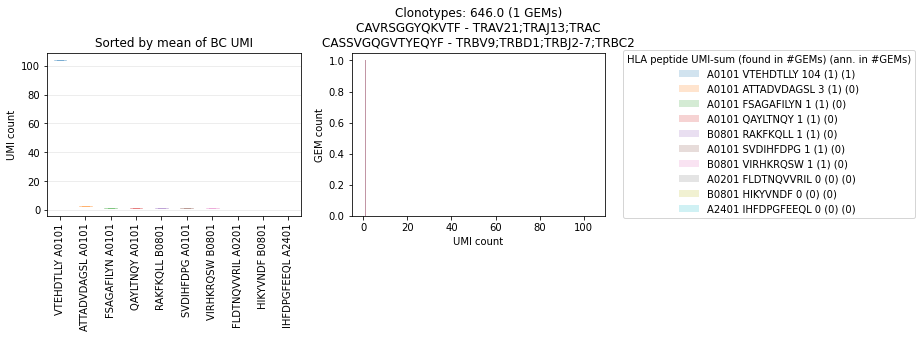

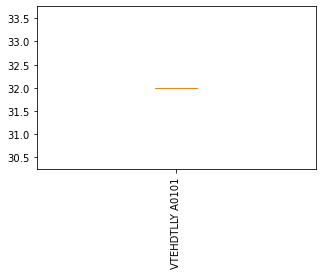

[412.]
('CASSVSASGQTYGYTF', 'CAENSPSTLTF') unresolved
       peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
894  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAENSPSTLTF   

                genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
894  ['TRAV13-2;TRAJ11;TRAC']                 2  CASSVSASGQTYGYTF   

                genes_lst_TRB umi_count_lst_TRB  
894  ['TRBV9;;TRBJ1-2;TRBC1']                 6  


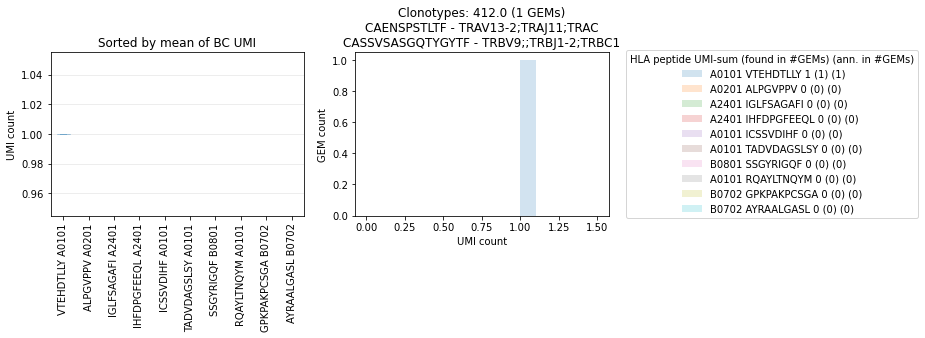

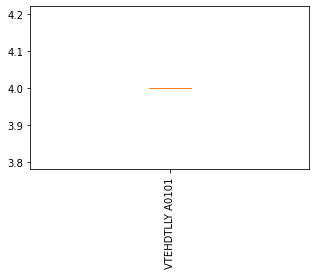

[439.]
('CASSWGGTYNEQFF', 'CAAEARDNYGQNFVF') unresolved
         peptide     peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
2054  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CAAEARDNYGQNFVF   

                 genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
2054  ['TRAV13-1;TRAJ26;TRAC']                 3  CASSWGGTYNEQFF   

                    genes_lst_TRB umi_count_lst_TRB  
2054  ['TRBV12-3;;TRBJ2-1;TRBC2']                 7  


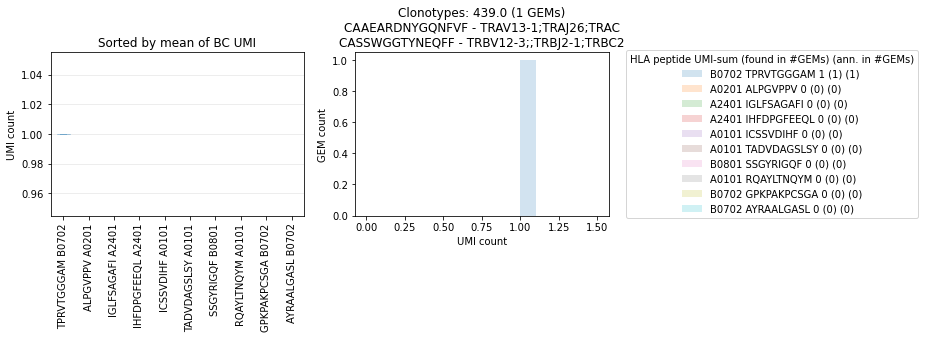

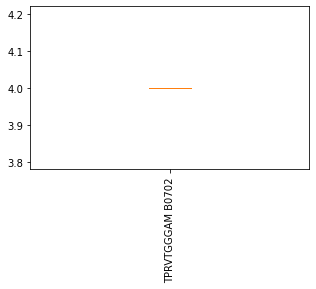

[358.]
('CASSWGTSGYNEQFF', 'NaN') unresolved
       peptide                                        peptide_lst  \
2360  RAKFKQLL  ['IRHKRQSWV' 'AMLIRDRL' 'VTEHDTLLY' 'FSAGAFILY...   

         umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2360  [1, 1, 1, 1, 20, 35]                        NaN               NaN   

         cdr3_lst_TRB                genes_lst_TRB umi_count_lst_TRB  
2360  CASSWGTSGYNEQFF  ['TRBV12-4;;TRBJ2-1;TRBC2']                 8  


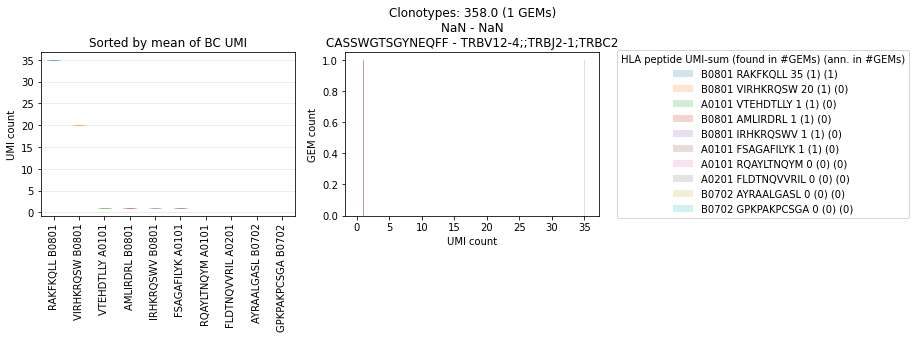

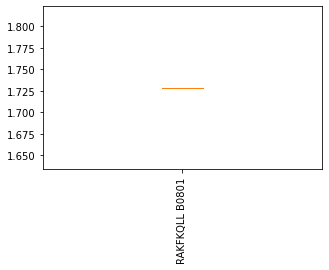

[189.]
('CASSWTSGRAYNEQFF', 'CAYFGNEKLTF') unresolved
        peptide                 peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
191  FSAGAFILYK  ['VTEHDTLLY' 'FSAGAFILYK']            [1, 1]  CAYFGNEKLTF   

               genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
191  ['TRAV9-2;TRAJ48;TRAC']                 1  CASSWTSGRAYNEQFF   

                       genes_lst_TRB umi_count_lst_TRB  
191  ['TRBV7-6;TRBD2;TRBJ2-1;TRBC2']                 7  


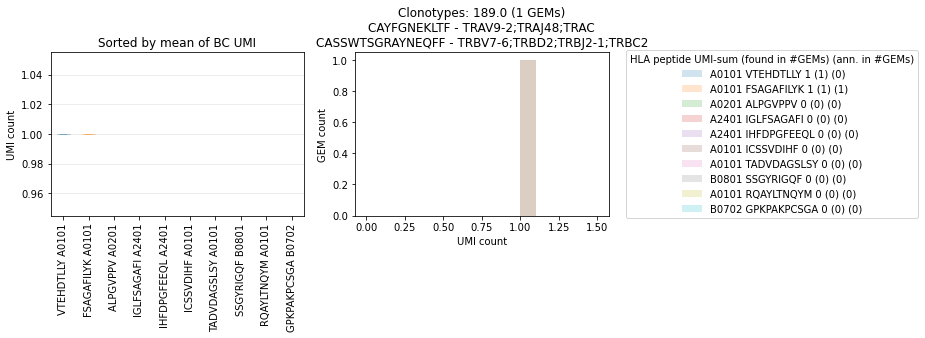

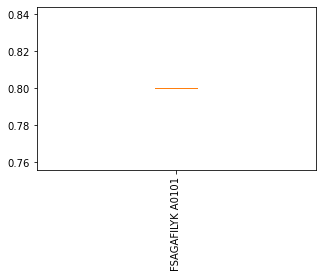

[499.]
('CASSYAQDGSYEQYF', 'CAVADSNYQLIW') unresolved
          peptide      peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1703  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAVADSNYQLIW   

                genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
1703  ['TRAV1-2;TRAJ33;TRAC']                 1  CASSYAQDGSYEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
1703  ['TRBV6-2;;TRBJ2-7;TRBC2']                 6  


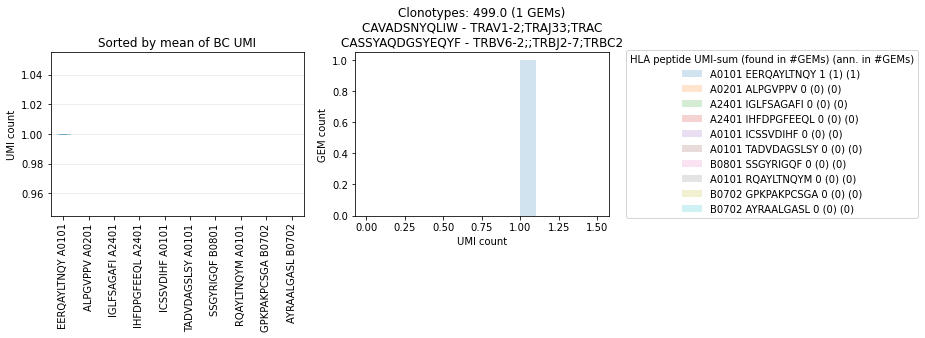

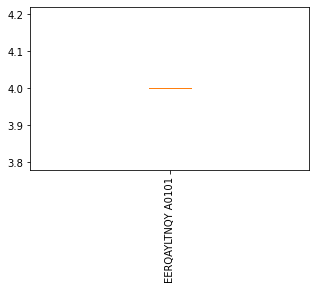

[167.]
('CASSYGWGGPYNEQFF', 'CAVARNTGTASKLTF') unresolved
      peptide   peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
708  RAKFKQLL  ['RAKFKQLL']               [1]  CAVARNTGTASKLTF   

               genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
708  ['TRAV8-3;TRAJ44;TRAC']                 3  CASSYGWGGPYNEQFF   

                  genes_lst_TRB umi_count_lst_TRB  
708  ['TRBV6-6;;TRBJ2-1;TRBC2']                 5  


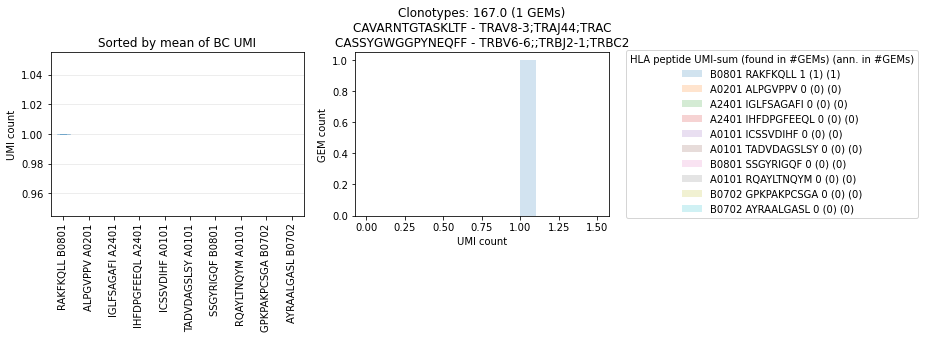

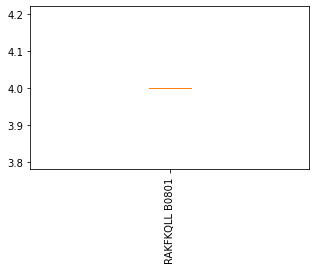

[287.]
('CASSYPAASSSYNSPLHF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2276  VTEHDTLLY  ['ATTADVDAGSL' 'RQAYLTNQY' 'RAKFKQLL' 'SVDIHFD...   

      umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2276  [1, 1, 2, 3, 159]                        NaN               NaN   

            cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
2276  CASSYPAASSSYNSPLHF  ['TRBV6-2;;TRBJ1-6;TRBC1']                 6  


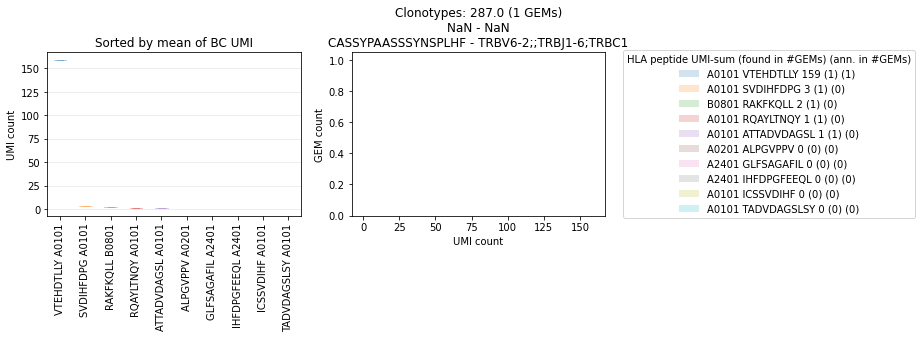

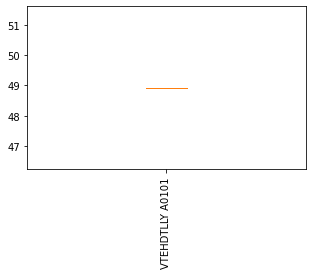

[611.]
('CASSYSGGYTEAFF', 'CAYRSDKLIF') unresolved
      peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
23  VTEHDTLLY  ['VTEHDTLLY']               [1]   CAYRSDKLIF   

                   genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
23  ['TRAV38-2/DV8;TRAJ34;TRAC']                 3  CASSYSGGYTEAFF   

                 genes_lst_TRB umi_count_lst_TRB  
23  ['TRBV6-2;;TRBJ1-1;TRBC1']                 7  


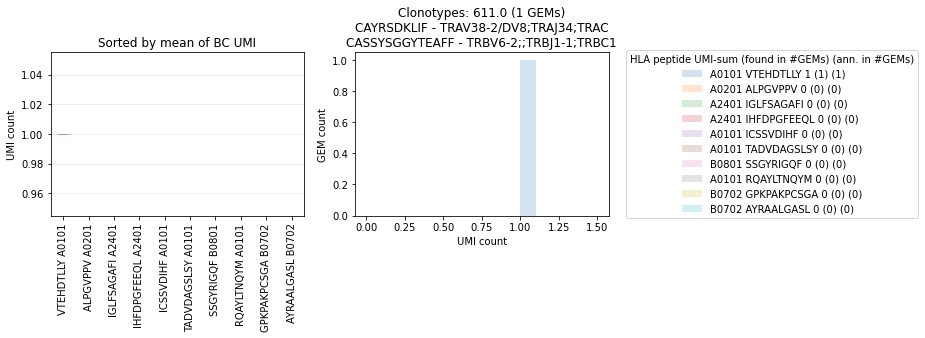

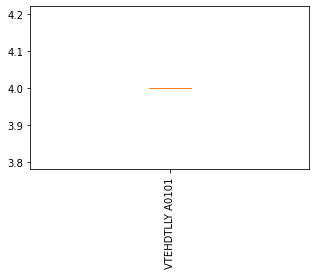

[158.]
('CASSYSPVNTEAFF', 'CAMSLPPGLTSGTYKYIF') unresolved
        peptide                peptide_lst umi_count_lst_mhc  \
930  TPRVTGGGAM  ['GPFPGNLV' 'TPRVTGGGAM']           [2, 54]   

           cdr3_lst_TRA               genes_lst_TRA umi_count_lst_TRA  \
930  CAMSLPPGLTSGTYKYIF  ['TRAV14/DV4;TRAJ40;TRAC']                 2   

       cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
930  CASSYSPVNTEAFF  ['TRBV6-2;;TRBJ1-1;TRBC1']                 5  


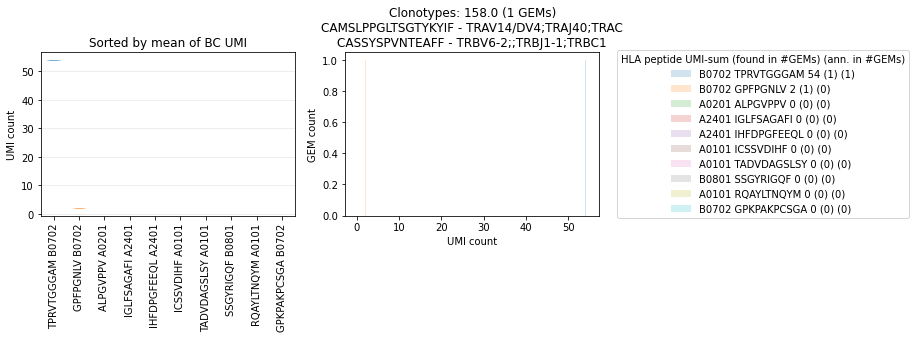

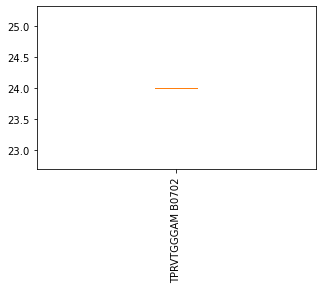

[577.]
('CASSYSSGELFF', 'CAALTSGSRLTF') unresolved
       peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
461  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAALTSGSRLTF   

                  genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
461  ['TRAV29/DV5;TRAJ58;TRAC']                 7  CASSYSSGELFF   

                  genes_lst_TRB umi_count_lst_TRB  
461  ['TRBV6-2;;TRBJ2-2;TRBC2']                12  


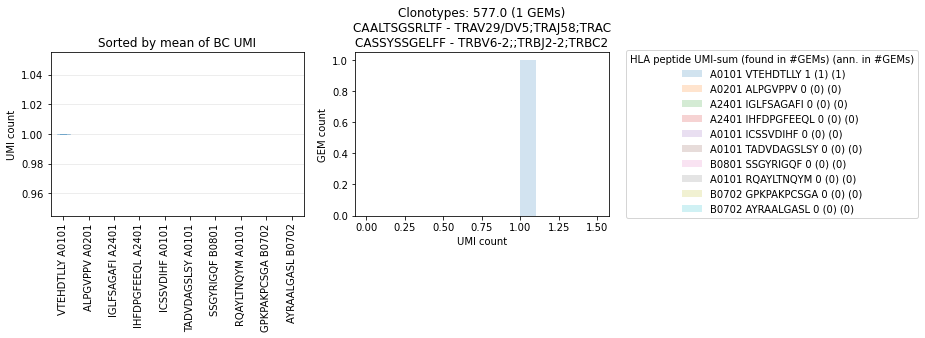

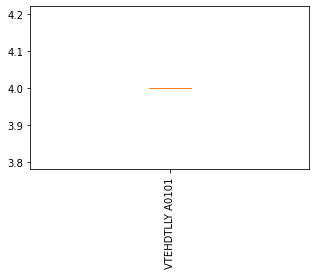

[631.]
('CASSYTLGEGVTQYF', 'CGTEIAGGTSYGKLTF') unresolved
      peptide                                        peptide_lst  \
896  RAKFKQLL  ['HTGEKHYAC' 'NLVPMVATV' 'AMLIRDRL' 'VTEHDTLLY...   

    umi_count_lst_mhc      cdr3_lst_TRA           genes_lst_TRA  \
896  [1, 1, 2, 3, 58]  CGTEIAGGTSYGKLTF  ['TRAV30;TRAJ52;TRAC']   

    umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
896                 3  CASSYTLGEGVTQYF  ['TRBV7-8;;TRBJ2-5;TRBC2']   

    umi_count_lst_TRB  
896                 9  


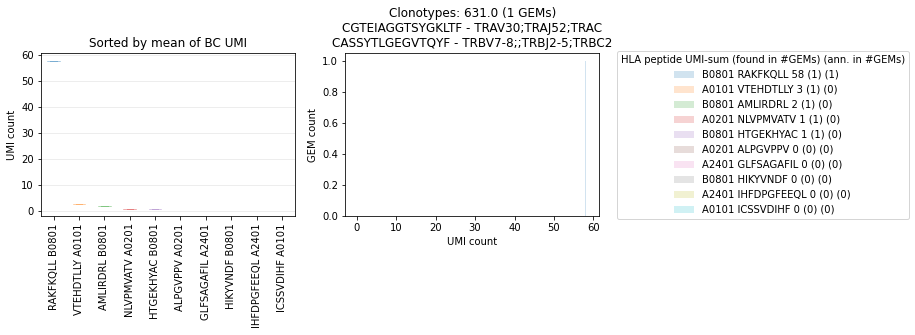

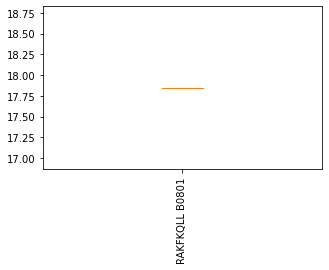

[564.]
('CASSYTPGSTYEQYF', 'CAVAAPAYSGAGSYQLTF') unresolved
      peptide                  peptide_lst umi_count_lst_mhc  \
30  VTEHDTLLY  ['ATTADVDAGSL' 'VTEHDTLLY']           [1, 74]   

          cdr3_lst_TRA           genes_lst_TRA umi_count_lst_TRA  \
30  CAVAAPAYSGAGSYQLTF  ['TRAV39;TRAJ28;TRAC']                 2   

       cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
30  CASSYTPGSTYEQYF  ['TRBV4-2;;TRBJ2-7;TRBC2']                 4  


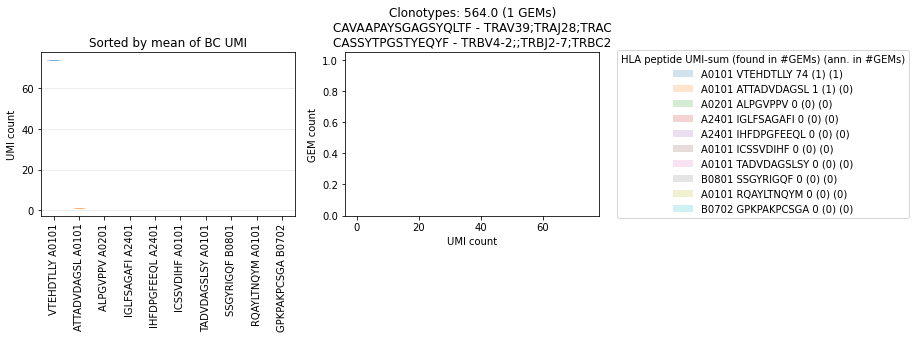

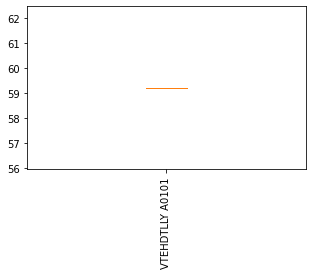

[543.]
('CASSYVAGTKSSYNEQFF', 'CVVFNAGGTSYGKLTF') unresolved
          peptide      peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
1937  EERQAYLTNQY  ['EERQAYLTNQY']               [2]  CVVFNAGGTSYGKLTF   

                 genes_lst_TRA umi_count_lst_TRA        cdr3_lst_TRB  \
1937  ['TRAV12-1;TRAJ52;TRAC']                 3  CASSYVAGTKSSYNEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
1937  ['TRBV6-6;;TRBJ2-1;TRBC2']                 8  


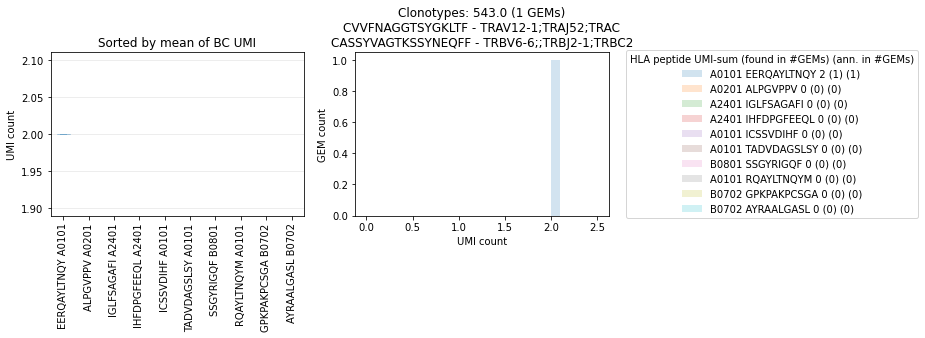

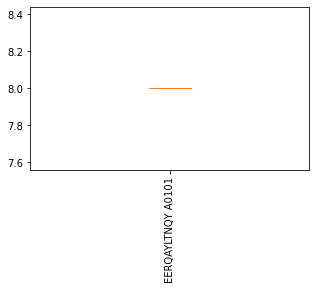

[471.]
('CASTGARRSETQYF', 'CAMNQGAQKLVF') unresolved
         peptide     peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1594  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CAMNQGAQKLVF   

                   genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
1594  ['TRAV14/DV4;TRAJ54;TRAC']                 4  CASTGARRSETQYF   

                 genes_lst_TRB umi_count_lst_TRB  
1594  ['TRBV2;;TRBJ2-5;TRBC2']                14  


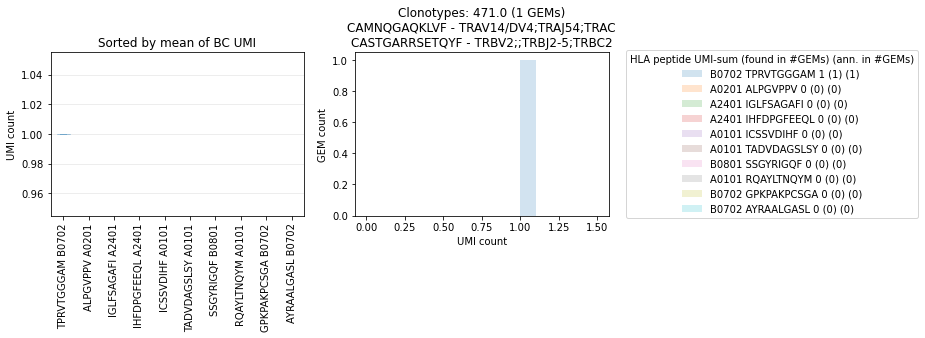

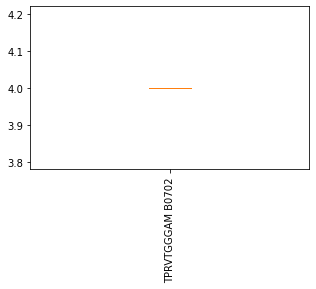

[429.]
('CASTILPSGTGGHDEQFF', 'CAASEGSYIPTF') unresolved
        peptide                             peptide_lst umi_count_lst_mhc  \
1640  VTEHDTLLY  ['RAKFKQLL' 'ATTADVDAGSL' 'VTEHDTLLY']        [1, 1, 42]   

      cdr3_lst_TRA            genes_lst_TRA umi_count_lst_TRA  \
1640  CAASEGSYIPTF  ['TRAV13-1;TRAJ6;TRAC']                 1   

            cdr3_lst_TRB                    genes_lst_TRB umi_count_lst_TRB  
1640  CASTILPSGTGGHDEQFF  ['TRBV4-1;TRBD1;TRBJ2-1;TRBC2']                14  


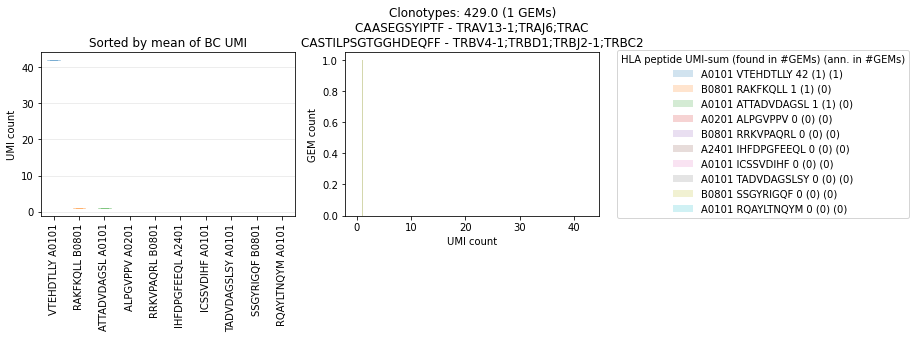

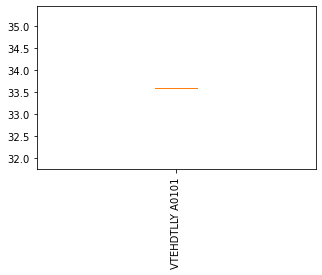

[291.]
('CASTIQGASTDTQYF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2200  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
2200               NaN  CASTIQGASTDTQYF  ['TRBV6-2;;TRBJ2-3;TRBC2']   

     umi_count_lst_TRB  
2200                 6  


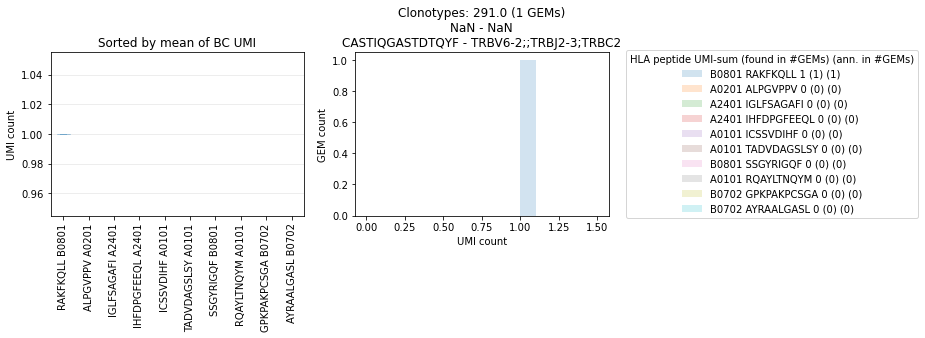

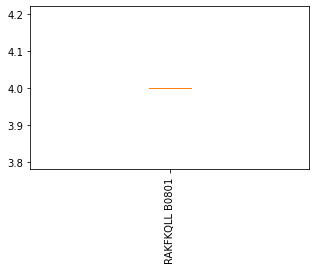

[319.]
('CASTNPGLNYEQYF', 'NaN') unresolved
        peptide                 peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2367  GPKPAKPCS  ['FSAGAFILYK' 'GPKPAKPCS']            [1, 1]                

     genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
2367           NaN               NaN  CASTNPGLNYEQYF   

                   genes_lst_TRB umi_count_lst_TRB  
2367  ['TRBV4-2;;TRBJ2-7;TRBC2']                 5  


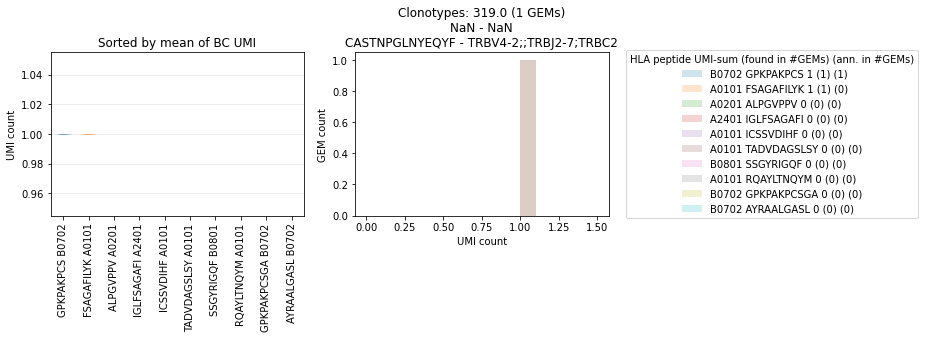

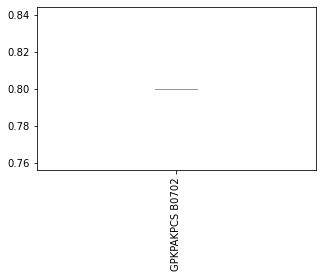

[280.]
('CASTPLAGGYNEQFF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2104  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA     cdr3_lst_TRB               genes_lst_TRB  \
2104               NaN  CASTPLAGGYNEQFF  ['TRBV6-1;;TRBJ2-1;TRBC2']   

     umi_count_lst_TRB  
2104                 4  


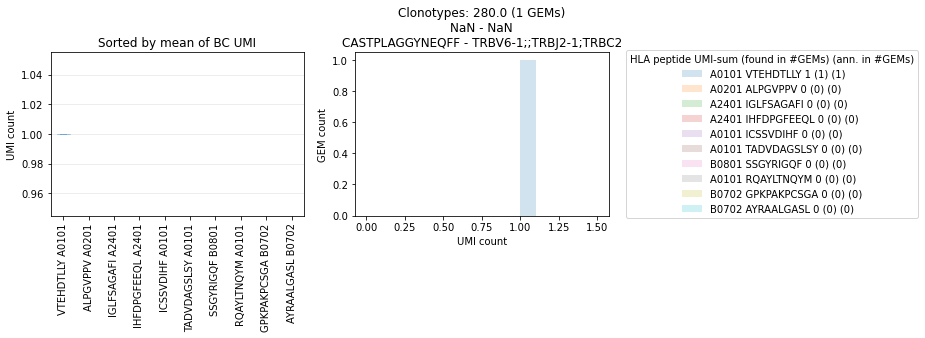

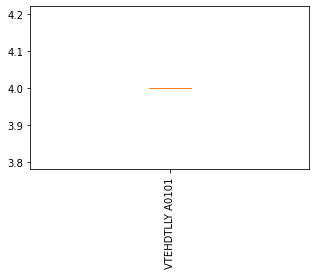

[86.]
('CASTPRDRGFQPQHF', 'CAVRDSPGRDDKIIF') unresolved
       peptide                            peptide_lst umi_count_lst_mhc  \
796  VTEHDTLLY  ['QAYLTNQY' 'TPRVTGGGAM' 'VTEHDTLLY']        [1, 2, 31]   

        cdr3_lst_TRA            genes_lst_TRA umi_count_lst_TRA  \
796  CAVRDSPGRDDKIIF  ['TRAV1-2;TRAJ30;TRAC']                 2   

        cdr3_lst_TRB                   genes_lst_TRB umi_count_lst_TRB  
796  CASTPRDRGFQPQHF  ['TRBV19;TRBD1;TRBJ1-5;TRBC1']                 7  


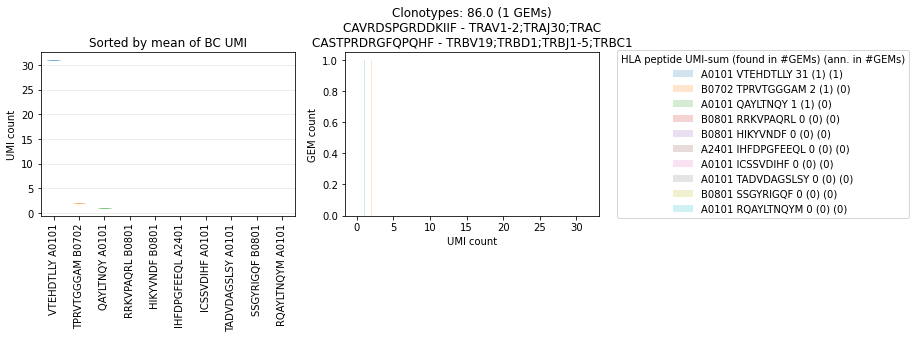

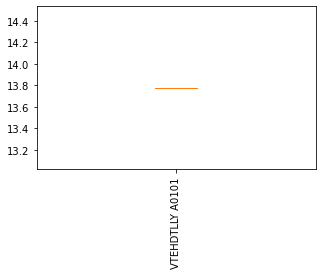

[509.]
('CASTSLTGELFF', 'CAALMDSSYKLIF') unresolved
      peptide                           peptide_lst umi_count_lst_mhc  \
528  RAKFKQLL  ['SVDIHFDPG' 'VTEHDTLLY' 'RAKFKQLL']         [1, 1, 1]   

      cdr3_lst_TRA            genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
528  CAALMDSSYKLIF  ['TRAV1-1;TRAJ12;TRAC']                 1  CASTSLTGELFF   

                   genes_lst_TRB umi_count_lst_TRB  
528  ['TRBV12-4;;TRBJ2-2;TRBC2']                11  


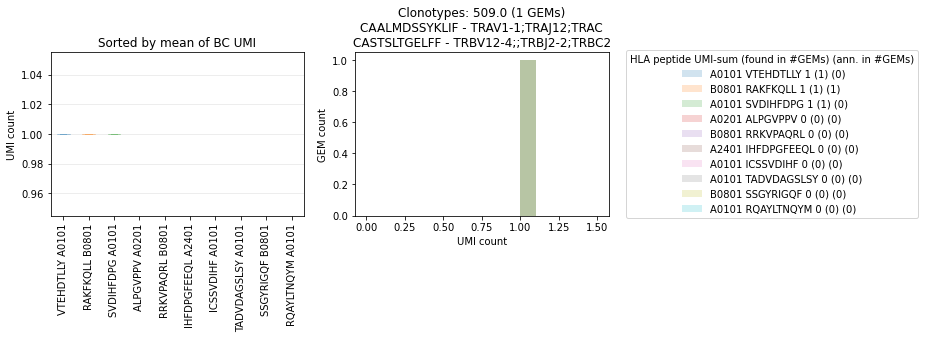

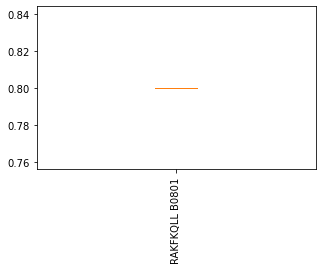

[290.]
('CASTVQTETGELFF', 'NaN') unresolved
         peptide     peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2090  TPRVTGGGAM  ['TPRVTGGGAM']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB               genes_lst_TRB  \
2090               NaN  CASTVQTETGELFF  ['TRBV6-2;;TRBJ2-2;TRBC2']   

     umi_count_lst_TRB  
2090                 4  


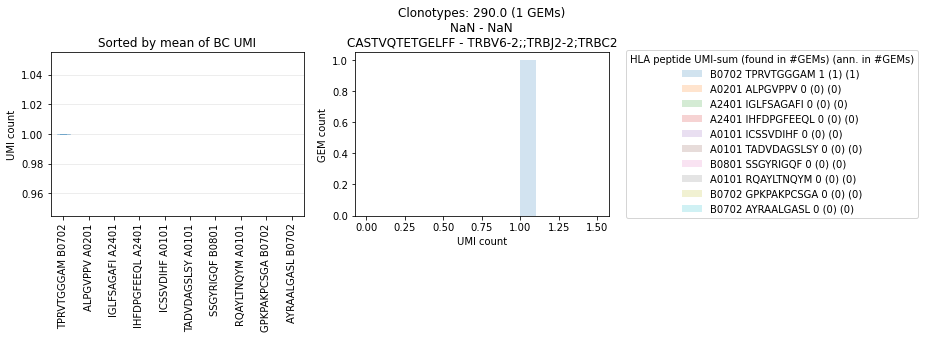

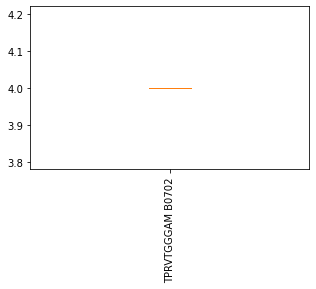

[401.]
('CASVGQGSYGYTF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2328  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA   cdr3_lst_TRB                  genes_lst_TRB  \
2328               NaN  CASVGQGSYGYTF  ['TRBV2;TRBD1;TRBJ1-2;TRBC1']   

     umi_count_lst_TRB  
2328                 3  


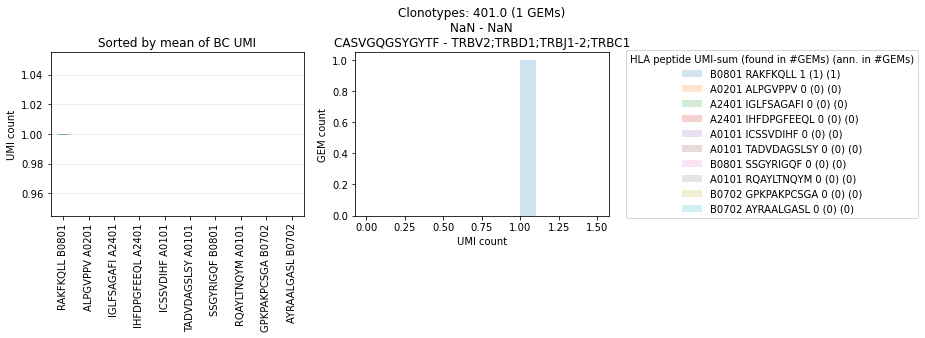

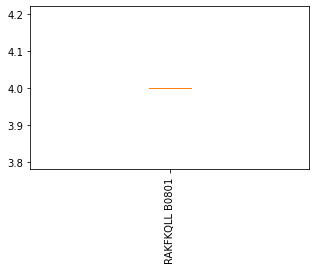

[426.]
('CATQLGQGLSGANVLTF', 'CAMREVRLHGSSNTGKLIF') unresolved
        peptide                peptide_lst umi_count_lst_mhc  \
1948  VTEHDTLLY  ['RQAYLTNQY' 'VTEHDTLLY']            [1, 1]   

             cdr3_lst_TRA               genes_lst_TRA umi_count_lst_TRA  \
1948  CAMREVRLHGSSNTGKLIF  ['TRAV14/DV4;TRAJ37;TRAC']                 1   

           cdr3_lst_TRB               genes_lst_TRB umi_count_lst_TRB  
1948  CATQLGQGLSGANVLTF  ['TRBV6-1;;TRBJ2-6;TRBC2']                 6  


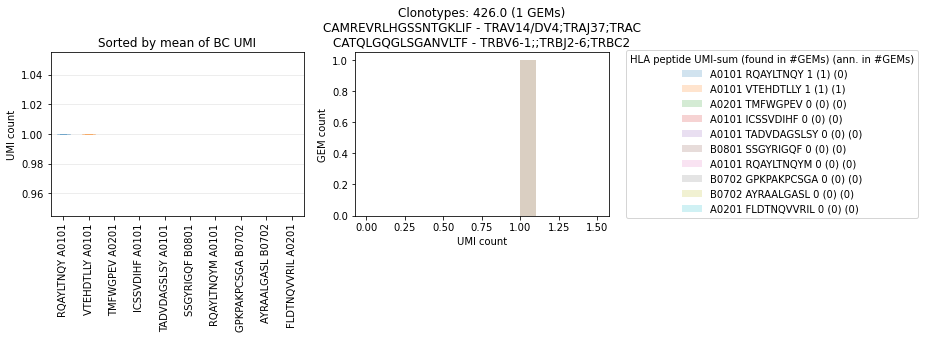

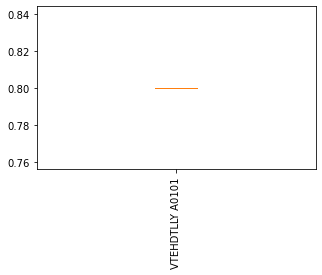

[603.]
('CATRQNTEAFF', 'CAVNYGNKLVF') unresolved
        peptide                                        peptide_lst  \
1029  VTEHDTLLY  ['RAKFKQLL' 'TPRVTGGGAM' 'QAYLTNQY' 'ATTADVDAG...   

     umi_count_lst_mhc cdr3_lst_TRA          genes_lst_TRA umi_count_lst_TRA  \
1029  [1, 1, 1, 4, 92]  CAVNYGNKLVF  ['TRAV3;TRAJ47;TRAC']                 4   

     cdr3_lst_TRB                genes_lst_TRB umi_count_lst_TRB  
1029  CATRQNTEAFF  ['TRBV10-2;;TRBJ1-1;TRBC1']                13  


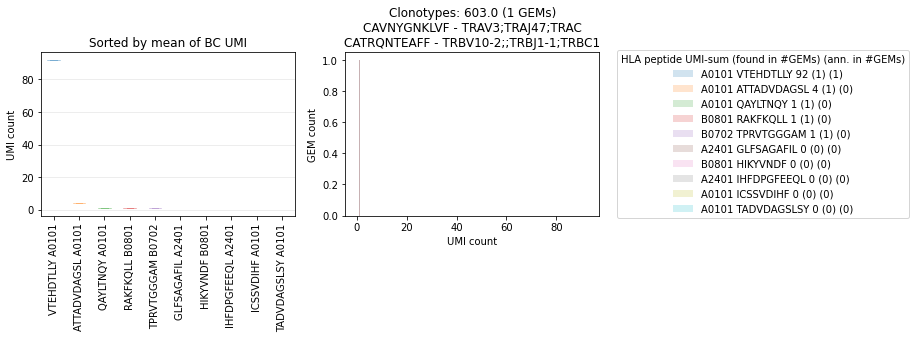

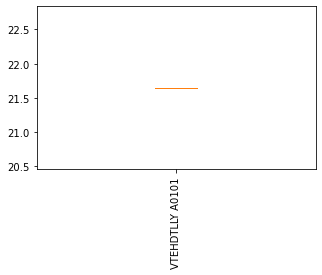

[109.]
('CATRQNTEAFF', 'NaN') unresolved
        peptide                                        peptide_lst  \
2112  VTEHDTLLY  ['EERQAYLTNQY' 'ATTADVDAGSL' 'FSAGAFILYN' 'RAK...   

     umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA umi_count_lst_TRA  \
2112  [1, 1, 1, 2, 27]                        NaN               NaN   

     cdr3_lst_TRB                genes_lst_TRB umi_count_lst_TRB  
2112  CATRQNTEAFF  ['TRBV10-2;;TRBJ1-1;TRBC1']                10  


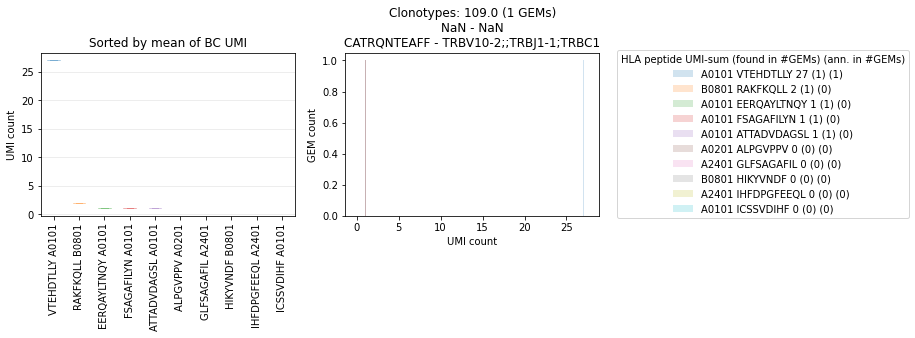

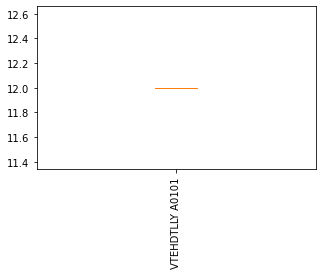

[122.]
('CATSDLYRDEQYF', 'CAVSGGGSQGNLIF') unresolved
        peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1218  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVSGGGSQGNLIF   

                genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1218  ['TRAV8-4;TRAJ42;TRAC']                 2  CATSDLYRDEQYF   

                    genes_lst_TRB umi_count_lst_TRB  
1218  ['TRBV24-1;;TRBJ2-7;TRBC2']                 4  


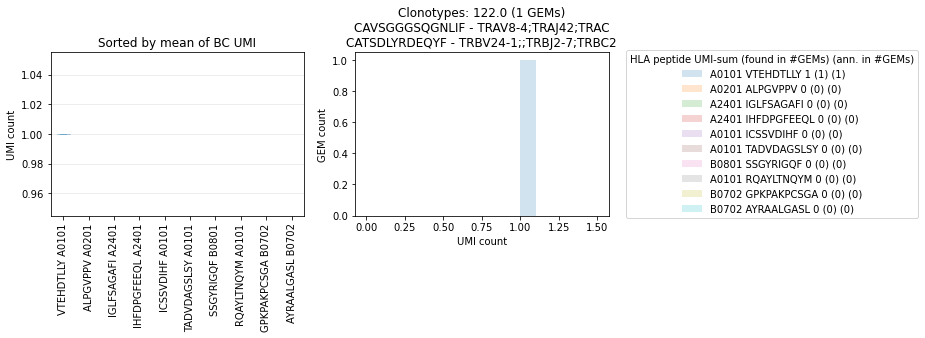

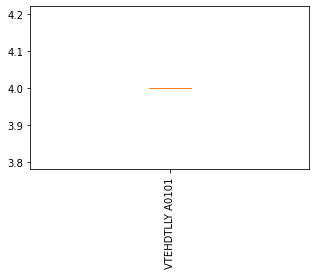

[714.]
('CATSRDLQVNQPQHF', 'CADPAGGTSYGKLTF') unresolved
       peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
783  VTEHDTLLY  ['VTEHDTLLY']               [1]  CADPAGGTSYGKLTF   

              genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
783  ['TRAV24;TRAJ52;TRAC']                 1  CATSRDLQVNQPQHF   

                 genes_lst_TRB umi_count_lst_TRB  
783  ['TRBV15;;TRBJ1-5;TRBC1']                 8  


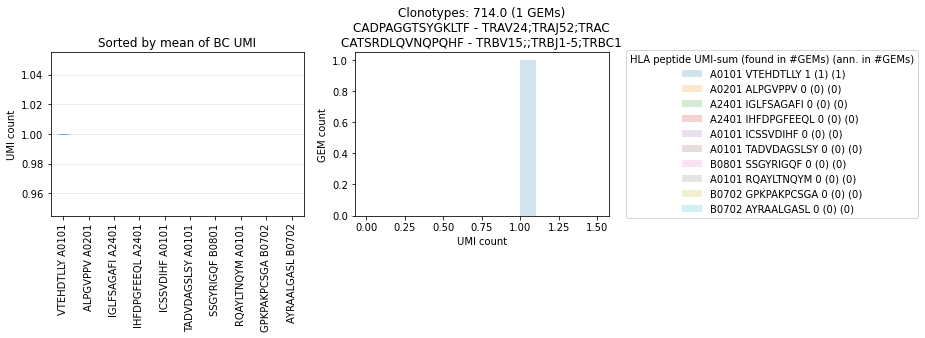

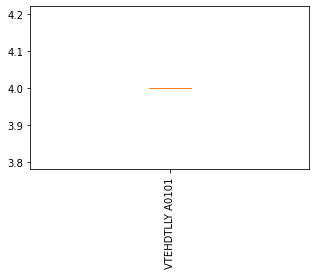

[560.]
('CSAEGLAGQGVSYEQYF', 'CVAGGTNAGKSTF') unresolved
        peptide                                        peptide_lst  \
1134  VTEHDTLLY  ['FSAGAFILYN' 'RQAYLTNQY' 'RAKFKQLL' 'VTEHDTLLY']   

     umi_count_lst_mhc   cdr3_lst_TRA             genes_lst_TRA  \
1134     [1, 1, 2, 96]  CVAGGTNAGKSTF  ['TRAV12-1;TRAJ27;TRAC']   

     umi_count_lst_TRA       cdr3_lst_TRB                genes_lst_TRB  \
1134                 5  CSAEGLAGQGVSYEQYF  ['TRBV20-1;;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
1134                11  


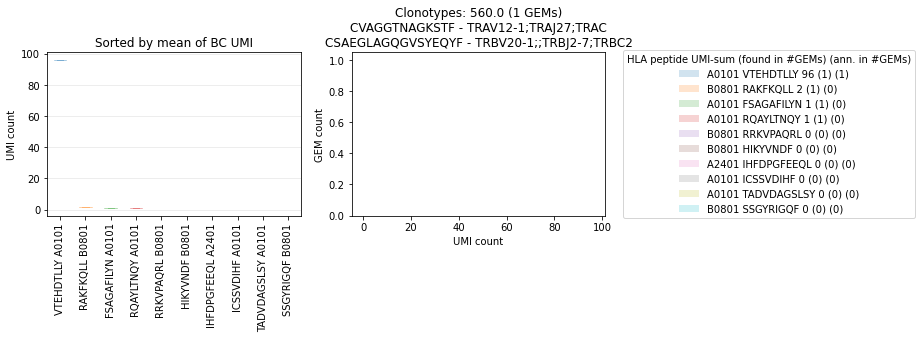

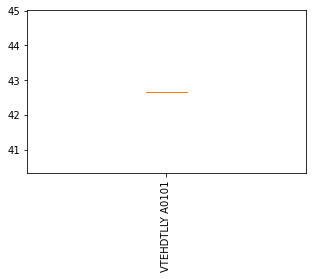

[408.]
('CSAEGLAGQGVSYEQYF', 'NaN') unresolved
        peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2366  VTEHDTLLY  ['VTEHDTLLY']               [1]                        NaN   

     umi_count_lst_TRA       cdr3_lst_TRB                genes_lst_TRB  \
2366               NaN  CSAEGLAGQGVSYEQYF  ['TRBV20-1;;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
2366                 8  


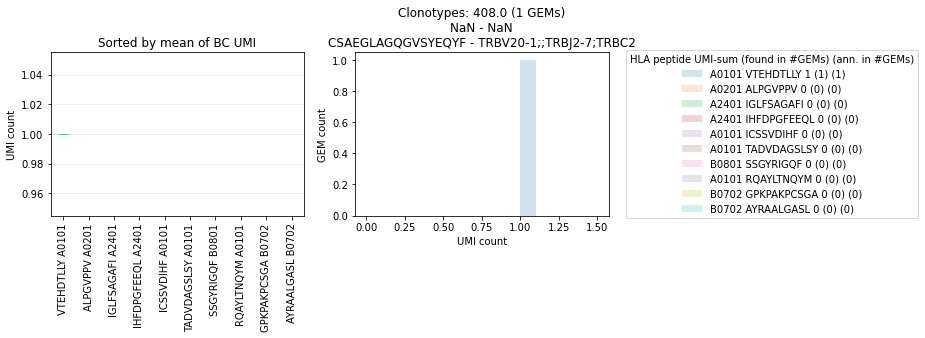

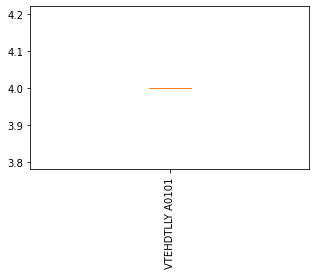

[686.]
('CSAGGGGIETQYF', 'CIVRLPDSGGYQKVTF') unresolved
         peptide     peptide_lst umi_count_lst_mhc      cdr3_lst_TRA  \
1516  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CIVRLPDSGGYQKVTF   

                 genes_lst_TRA umi_count_lst_TRA   cdr3_lst_TRB  \
1516  ['TRAV26-1;TRAJ13;TRAC']                 8  CSAGGGGIETQYF   

                    genes_lst_TRB umi_count_lst_TRB  
1516  ['TRBV10-3;;TRBJ2-5;TRBC2']                14  


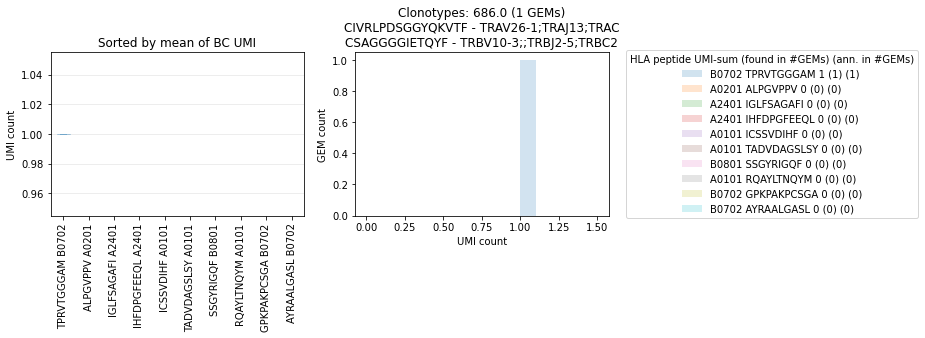

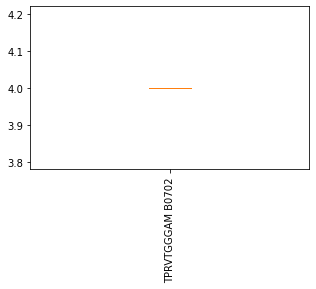

[505.]
('CSAKRLAGEADTQYF', 'CAVPNYGGATNKLIF') unresolved
       peptide    peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
517  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVPNYGGATNKLIF   

               genes_lst_TRA umi_count_lst_TRA     cdr3_lst_TRB  \
517  ['TRAV1-2;TRAJ32;TRAC']                 1  CSAKRLAGEADTQYF   

                   genes_lst_TRB umi_count_lst_TRB  
517  ['TRBV20-1;;TRBJ2-3;TRBC2']                17  


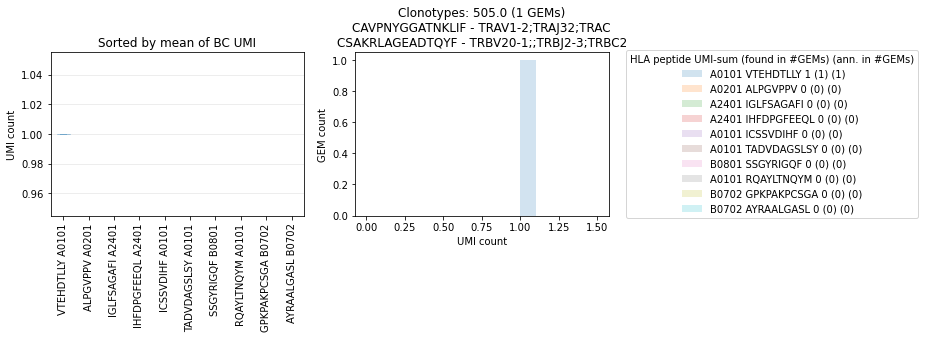

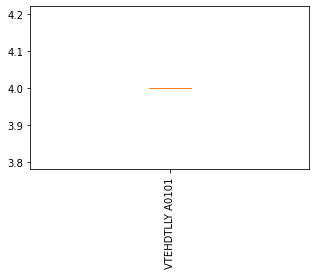

[152.]
('CSALGLADDNEQFF', 'CAMREGLEGYQKVTF') unresolved
        peptide     peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
426  TPRVTGGGAM  ['TPRVTGGGAM']               [1]  CAMREGLEGYQKVTF   

                  genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
426  ['TRAV14/DV4;TRAJ13;TRAC']                 3  CSALGLADDNEQFF   

                   genes_lst_TRB umi_count_lst_TRB  
426  ['TRBV20-1;;TRBJ2-1;TRBC2']                 5  


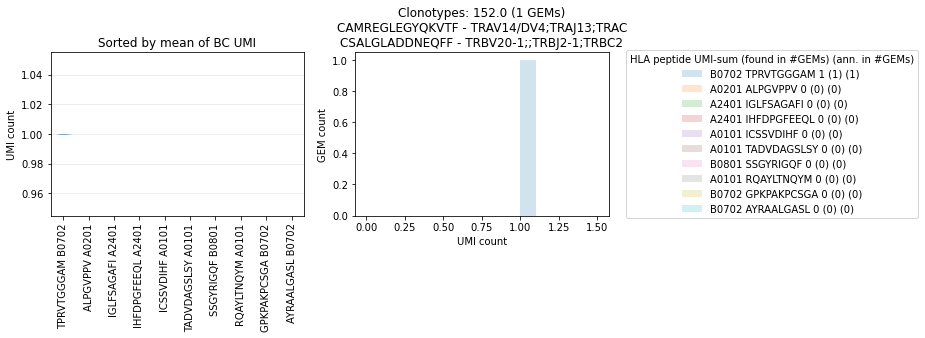

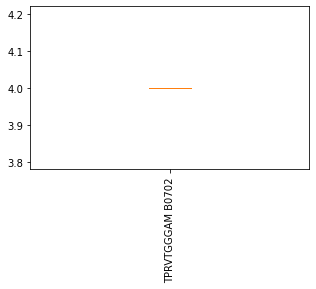

[386.]
('CSARAGTGQETQYF', 'NaN') unresolved
        peptide                 peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2107  VTEHDTLLY  ['FSAGAFILYK' 'VTEHDTLLY']            [1, 2]                

     genes_lst_TRA umi_count_lst_TRA    cdr3_lst_TRB  \
2107           NaN               NaN  CSARAGTGQETQYF   

                    genes_lst_TRB umi_count_lst_TRB  
2107  ['TRBV20-1;;TRBJ2-5;TRBC2']                12  


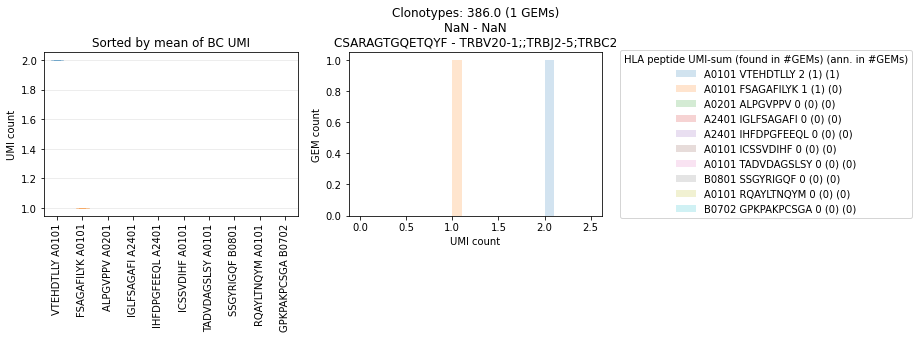

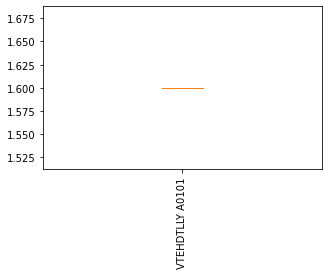

[514.]
('CSARAGTSGRTDTQYF', 'CAVRDSWGKFQF') unresolved
       peptide               peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1332  RAKFKQLL  ['YPLVKMRLS' 'RAKFKQLL']            [1, 1]  CAVRDSWGKFQF   

                genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
1332  ['TRAV1-1;TRAJ24;TRAC']                 5  CSARAGTSGRTDTQYF   

                         genes_lst_TRB umi_count_lst_TRB  
1332  ['TRBV20-1;TRBD2;TRBJ2-3;TRBC2']                 7  


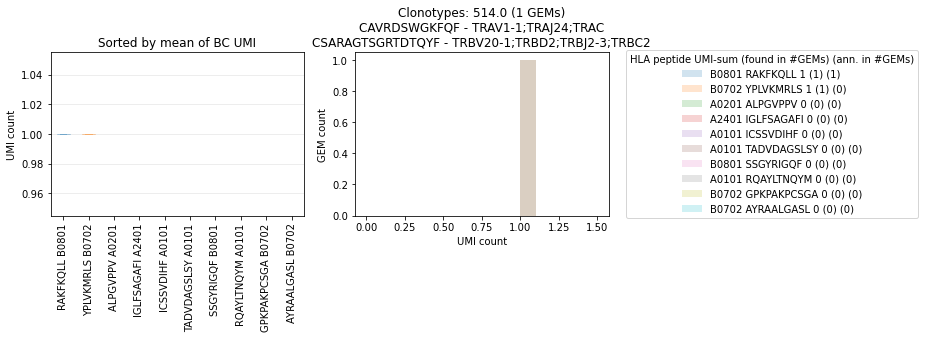

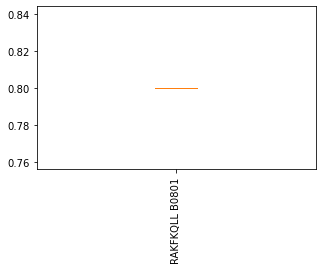

[711.]
('CSARDLTGNYGYTF', 'CAARNPPWGGGSQGNLIF') unresolved
      peptide                peptide_lst umi_count_lst_mhc  \
926  RAKFKQLL  ['TPRVTGGGAM' 'RAKFKQLL']            [1, 1]   

           cdr3_lst_TRA               genes_lst_TRA umi_count_lst_TRA  \
926  CAARNPPWGGGSQGNLIF  ['TRAV23/DV6;TRAJ42;TRAC']                 3   

       cdr3_lst_TRB                genes_lst_TRB umi_count_lst_TRB  
926  CSARDLTGNYGYTF  ['TRBV20-1;;TRBJ1-2;TRBC1']                 7  


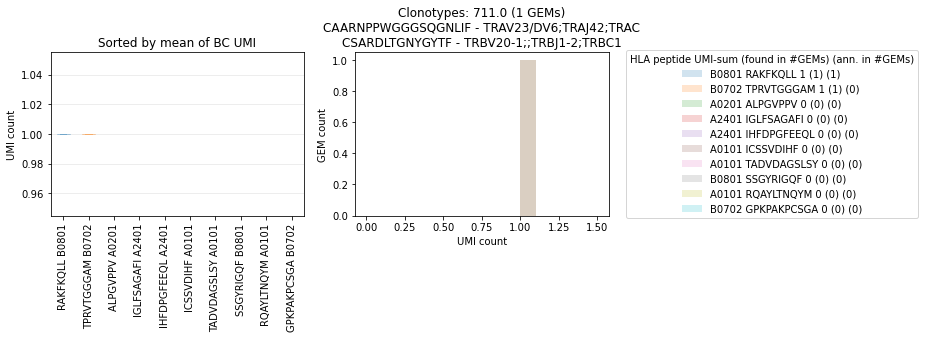

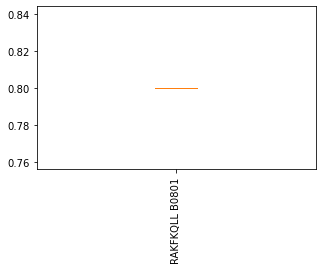

[240.]
('CSASLASHPNTGELFF', 'CLPYGSGNTGKLIF') unresolved
        peptide                 peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1229  VTEHDTLLY  ['TPRVTGGGAM' 'VTEHDTLLY']            [1, 1]  CLPYGSGNTGKLIF   

              genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
1229  ['TRAV4;TRAJ37;TRAC']                 1  CSASLASHPNTGELFF   

                    genes_lst_TRB umi_count_lst_TRB  
1229  ['TRBV20-1;;TRBJ2-2;TRBC2']                13  


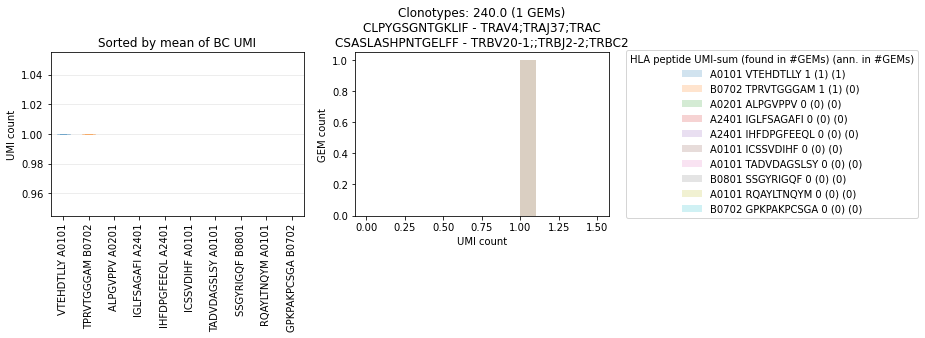

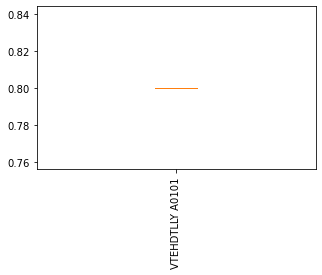

[534.]
('CSAVGSWAPNTGELFF', 'CAAQGGKLIF') unresolved
       peptide    peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
590  NLVPMVATV  ['NLVPMVATV']               [1]   CAAQGGKLIF   

                genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
590  ['TRAV12-2;TRAJ23;TRAC']                 5  CSAVGSWAPNTGELFF   

                   genes_lst_TRB umi_count_lst_TRB  
590  ['TRBV20-1;;TRBJ2-2;TRBC2']                15  


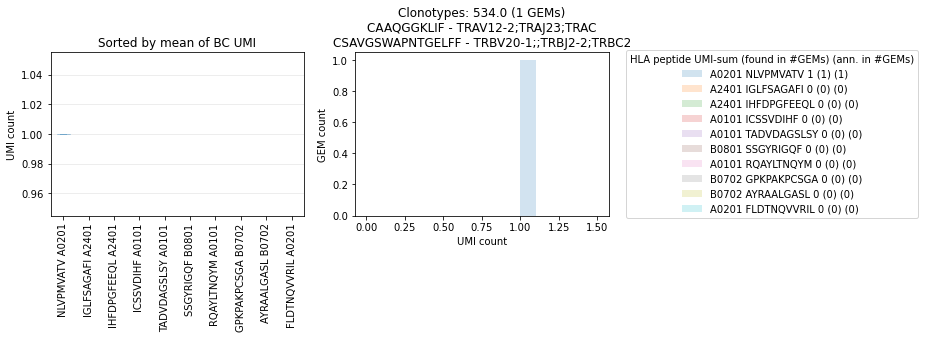

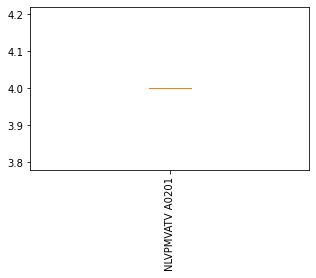

[602.]
('CSVEGRAMGYTF', 'CAVRDRDNDMRF') unresolved
       peptide                 peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
557  VTEHDTLLY  ['FSAGAFILYK' 'VTEHDTLLY']            [1, 1]  CAVRDRDNDMRF   

             genes_lst_TRA umi_count_lst_TRA  cdr3_lst_TRB  \
557  ['TRAV3;TRAJ43;TRAC']                 5  CSVEGRAMGYTF   

                   genes_lst_TRB umi_count_lst_TRB  
557  ['TRBV29-1;;TRBJ1-2;TRBC1']                 4  


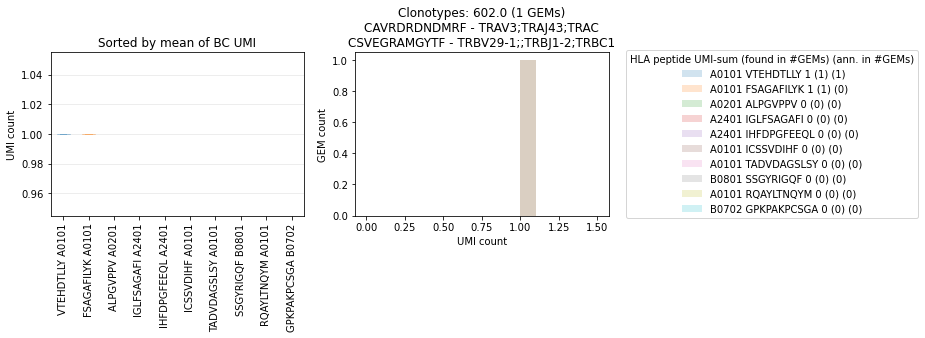

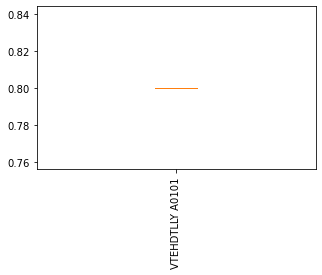

[144.]
('CSVEPPEGLTSTDTQYF', 'CAVRDTGGSNYQLIW') unresolved
       peptide   peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1958  RAKFKQLL  ['RAKFKQLL']               [1]  CAVRDTGGSNYQLIW   

              genes_lst_TRA umi_count_lst_TRA       cdr3_lst_TRB  \
1958  ['TRAV3;TRAJ33;TRAC']                 4  CSVEPPEGLTSTDTQYF   

                    genes_lst_TRB umi_count_lst_TRB  
1958  ['TRBV29-1;;TRBJ2-3;TRBC2']                11  


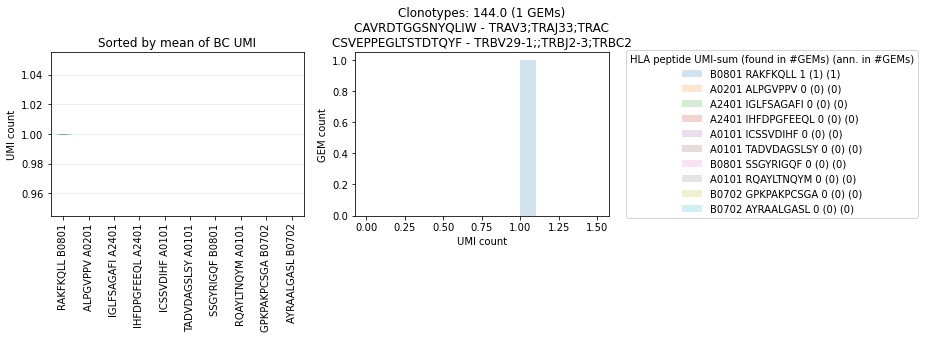

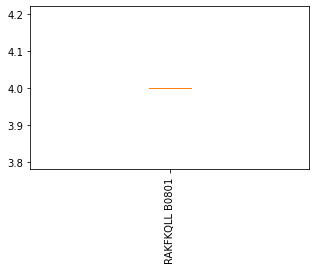

[604.]
('CSVEVGRAGEQFF', 'CAFMRGGADGLTF') unresolved
       peptide                                        peptide_lst  \
366  VTEHDTLLY  ['TADVDAGSLS' 'TPRVTGGGAM' 'ATTADVDAGSL' 'RAKF...   

     umi_count_lst_mhc   cdr3_lst_TRA             genes_lst_TRA  \
366  [1, 2, 3, 4, 112]  CAFMRGGADGLTF  ['TRAV38-1;TRAJ45;TRAC']   

    umi_count_lst_TRA   cdr3_lst_TRB                genes_lst_TRB  \
366                 1  CSVEVGRAGEQFF  ['TRBV29-1;;TRBJ2-1;TRBC2']   

    umi_count_lst_TRB  
366                12  


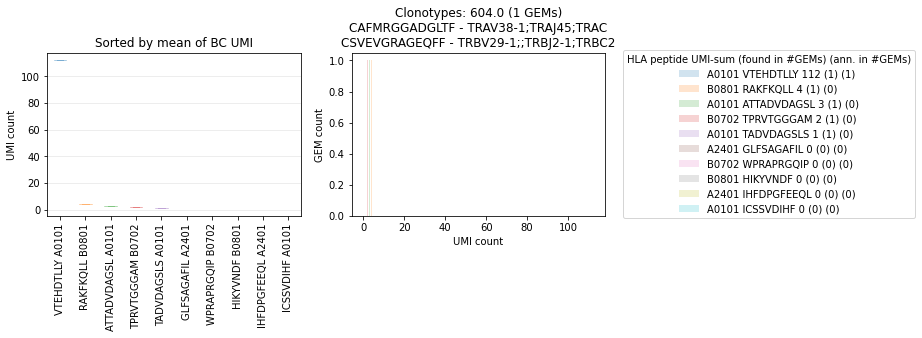

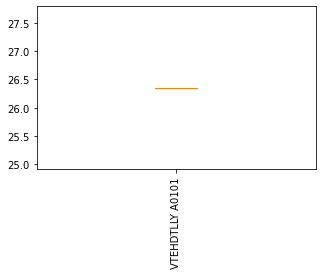

[84.]
('CSVEVPGKVFRTEAFF', 'NaN') unresolved
        peptide               peptide_lst umi_count_lst_mhc cdr3_lst_TRA  \
2182  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]                

     genes_lst_TRA umi_count_lst_TRA      cdr3_lst_TRB  \
2182           NaN               NaN  CSVEVPGKVFRTEAFF   

                    genes_lst_TRB umi_count_lst_TRB  
2182  ['TRBV29-1;;TRBJ1-1;TRBC1']                 4  


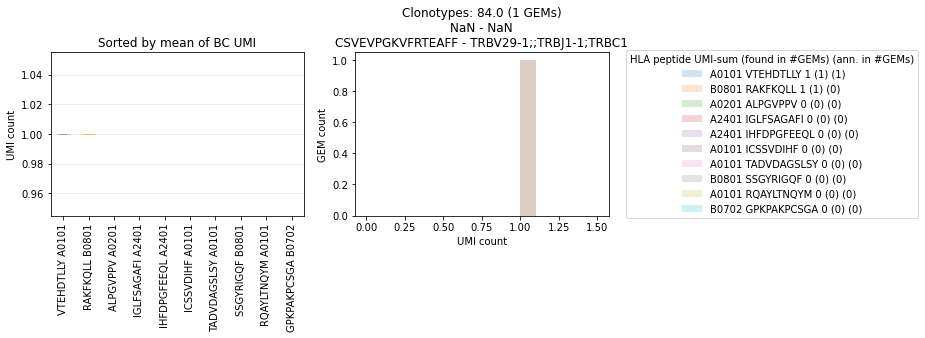

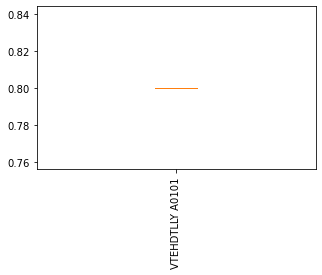

[334.]
('CSVGGDRGPYEQYF', 'NaN') unresolved
       peptide   peptide_lst umi_count_lst_mhc cdr3_lst_TRA genes_lst_TRA  \
2327  RAKFKQLL  ['RAKFKQLL']               [1]                        NaN   

     umi_count_lst_TRA    cdr3_lst_TRB                     genes_lst_TRB  \
2327               NaN  CSVGGDRGPYEQYF  ['TRBV29-1;TRBD1;TRBJ2-7;TRBC2']   

     umi_count_lst_TRB  
2327                 1  


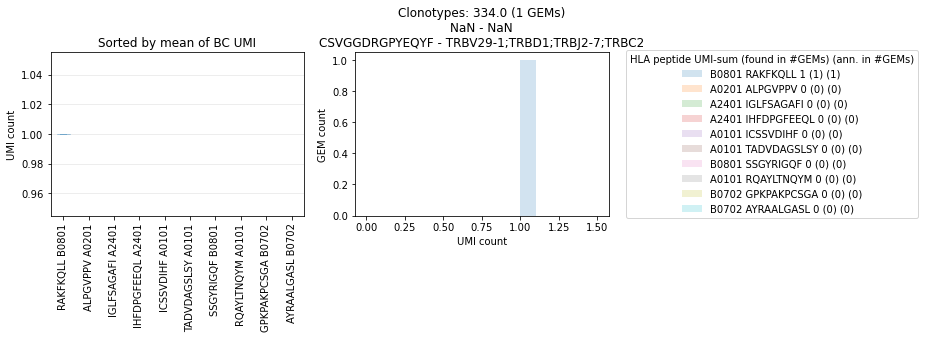

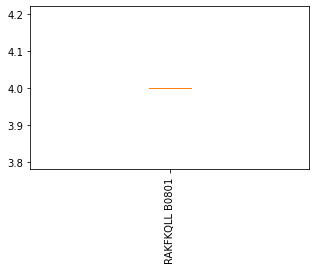

[441.]
('NaN', 'CAAPNLGFGNVLHC') unresolved
          peptide      peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
1455  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAAPNLGFGNVLHC   

                 genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB  \
1455  ['TRAV13-1;TRAJ35;TRAC']                 1                        NaN   

     umi_count_lst_TRB  
1455               NaN  


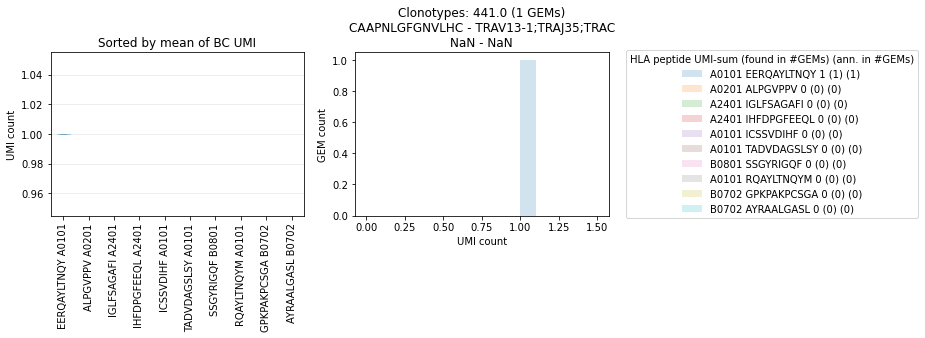

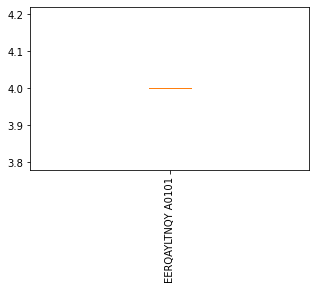

[710.]
('NaN', 'CAASRNDYKLSF') unresolved
          peptide      peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1273  EERQAYLTNQY  ['EERQAYLTNQY']               [1]  CAASRNDYKLSF   

                   genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB  \
1273  ['TRAV23/DV6;TRAJ20;TRAC']                 4                        NaN   

     umi_count_lst_TRB  
1273               NaN  


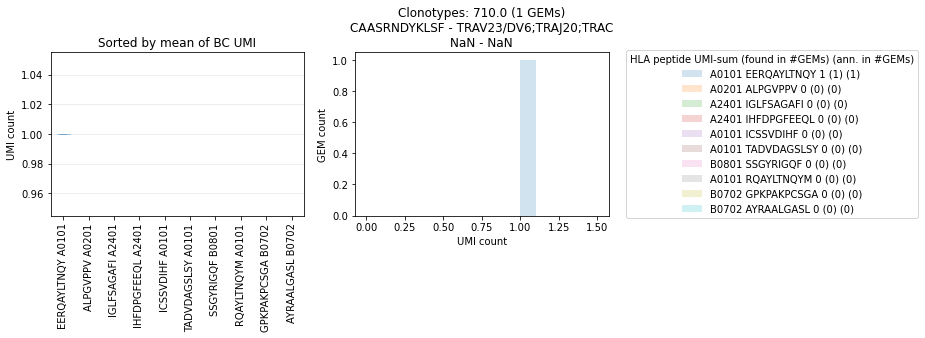

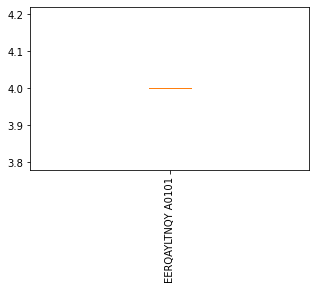

[129.]
('NaN', 'CAESETGANNLFF') unresolved
       peptide                                        peptide_lst  \
1524  RAKFKQLL  ['IRHKRQSWV' 'MDMFSDEQLKV' 'EERQAYLTNQY' 'TPRV...   

               umi_count_lst_mhc   cdr3_lst_TRA          genes_lst_TRA  \
1524  [1, 1, 1, 1, 2, 3, 8, 124]  CAESETGANNLFF  ['TRAV5;TRAJ36;TRAC']   

     umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB umi_count_lst_TRB  
1524                 2                        NaN               NaN  


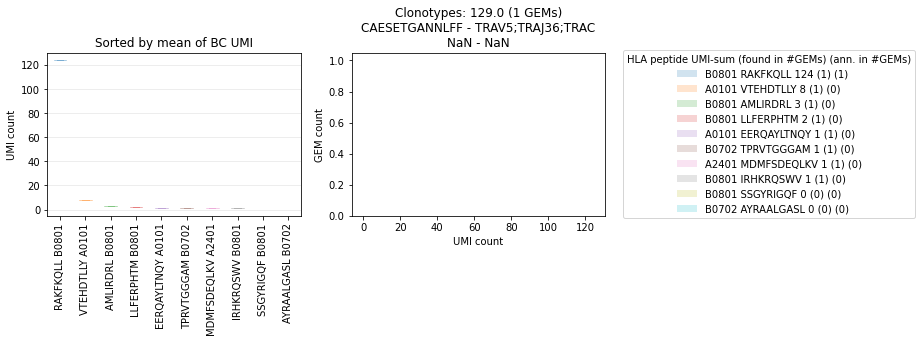

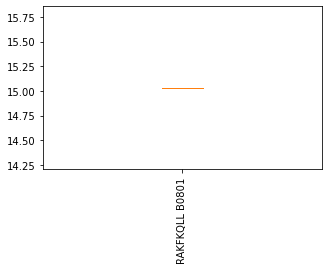

[592.]
('NaN', 'CAGGGIVVGFKTIF') unresolved
        peptide                                        peptide_lst  \
1713  VTEHDTLLY  ['RQAYLTNQY' 'SAGAFILYK' 'TNQYMQRMASV' 'ATTADV...   

     umi_count_lst_mhc    cdr3_lst_TRA          genes_lst_TRA  \
1713  [1, 1, 1, 2, 30]  CAGGGIVVGFKTIF  ['TRAV27;TRAJ9;TRAC']   

     umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB umi_count_lst_TRB  
1713                 1                        NaN               NaN  


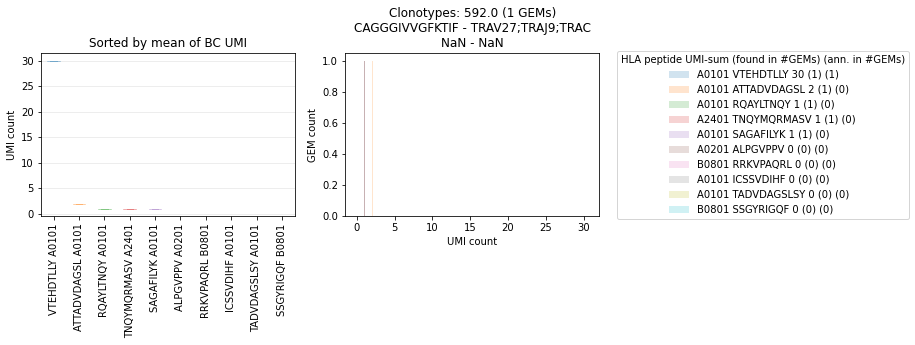

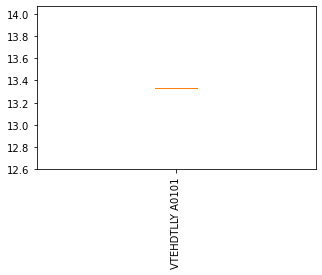

[96.]
('NaN', 'CALWEYGNKLVF') unresolved
          peptide                               peptide_lst umi_count_lst_mhc  \
2013  EERQAYLTNQY  ['SAGAFILYK' 'SVDIHFDPGF' 'EERQAYLTNQY']        [1, 2, 26]   

      cdr3_lst_TRA           genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB  \
2013  CALWEYGNKLVF  ['TRAV16;TRAJ47;TRAC']                 2                

     genes_lst_TRB umi_count_lst_TRB  
2013           NaN               NaN  


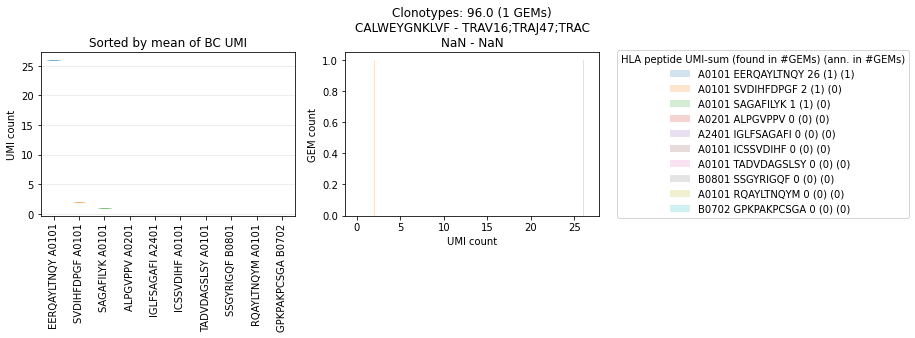

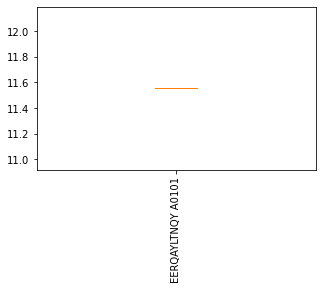

[100.]
('NaN', 'CAVEDRLDNDMRF') unresolved
         peptide                                        peptide_lst  \
1546  SVDIHFDPGF  ['RAKFKQLL' 'SAGAFILYK' 'EERQAYLTNQY' 'SVDIHFD...   

     umi_count_lst_mhc   cdr3_lst_TRA          genes_lst_TRA  \
1546     [1, 2, 5, 21]  CAVEDRLDNDMRF  ['TRAV2;TRAJ43;TRAC']   

     umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB umi_count_lst_TRB  
1546                 1                        NaN               NaN  


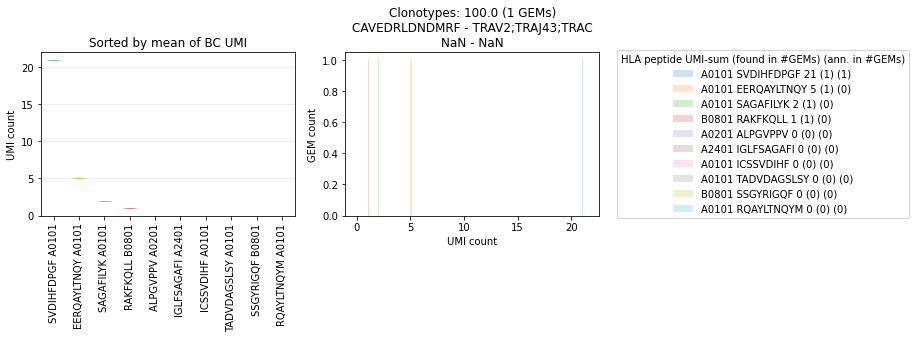

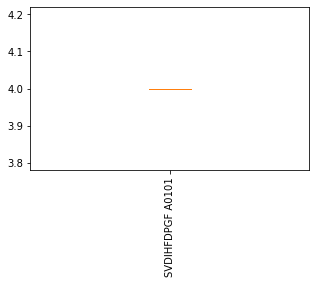

[110.]
('NaN', 'CAVETSGSRLTF') unresolved
       peptide                                      peptide_lst  \
1715  RAKFKQLL  ['AMLIRDRL' 'VTEHDTLLY' 'IRHKRQSWV' 'RAKFKQLL']   

     umi_count_lst_mhc  cdr3_lst_TRA           genes_lst_TRA  \
1715     [1, 1, 2, 60]  CAVETSGSRLTF  ['TRAV39;TRAJ58;TRAC']   

     umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB umi_count_lst_TRB  
1715                 3                        NaN               NaN  


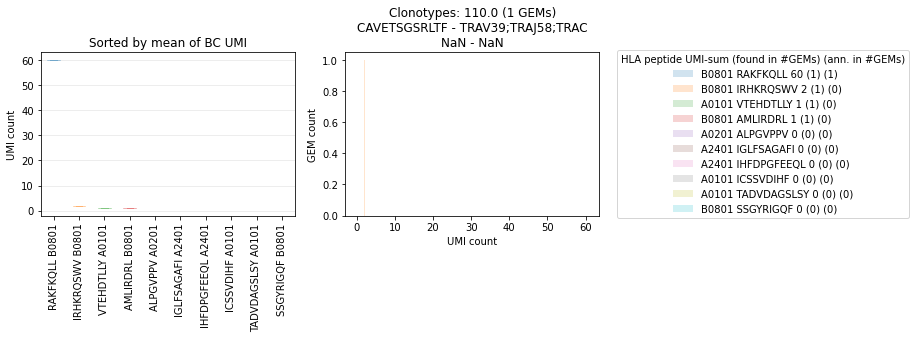

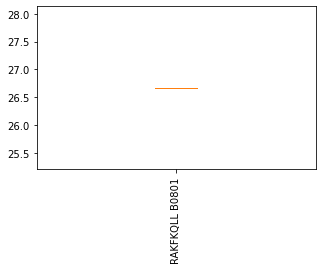

[524.]
('NaN', 'CAVKDSNYQLIW') unresolved
        peptide    peptide_lst umi_count_lst_mhc  cdr3_lst_TRA  \
1810  VTEHDTLLY  ['VTEHDTLLY']               [2]  CAVKDSNYQLIW   

                genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB  \
1810  ['TRAV1-2;TRAJ33;TRAC']                 2                        NaN   

     umi_count_lst_TRB  
1810               NaN  


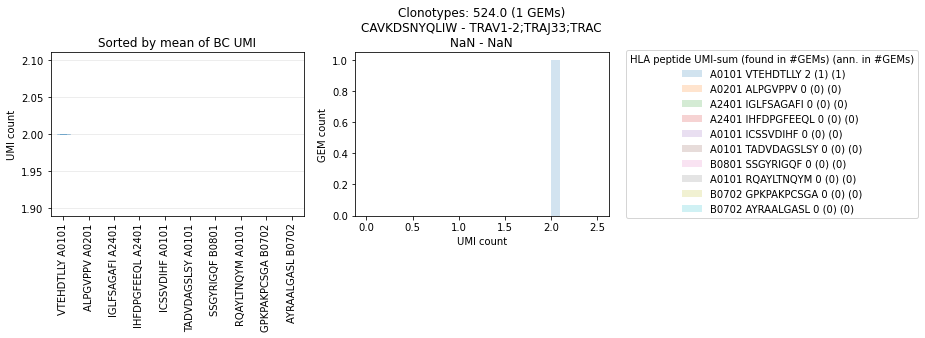

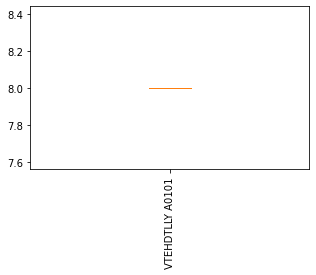

[551.]
('NaN', 'CAVLVSGGYNKLIF') unresolved
       peptide    peptide_lst umi_count_lst_mhc    cdr3_lst_TRA  \
778  VTEHDTLLY  ['VTEHDTLLY']               [1]  CAVLVSGGYNKLIF   

              genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB  \
778  ['TRAV1-2;TRAJ4;TRAC']                 2                        NaN   

    umi_count_lst_TRB  
778               NaN  


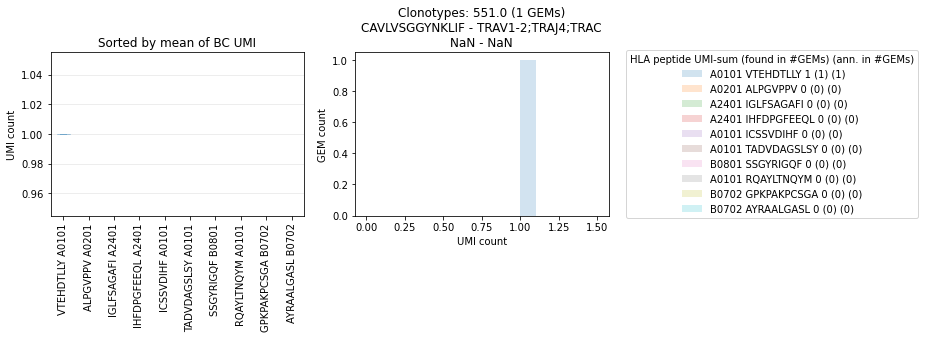

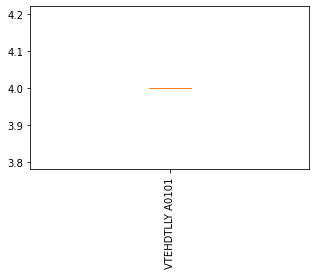

[648.]
HELP!
      peptide                                        peptide_lst  \
457  FLDTNQVV  ['RQSWVNATL' 'VTEHDTLLY' 'RAKFKQLL' 'FSAGAFILY...   

                umi_count_lst_mhc   cdr3_lst_TRA           genes_lst_TRA  \
457  [1, 1, 1, 1, 1, 2, 2, 4, 12]  CAVMDSGNTPLVF  ['TRAV21;TRAJ29;TRAC']   

    umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB umi_count_lst_TRB  
457                 1                        NaN               NaN  


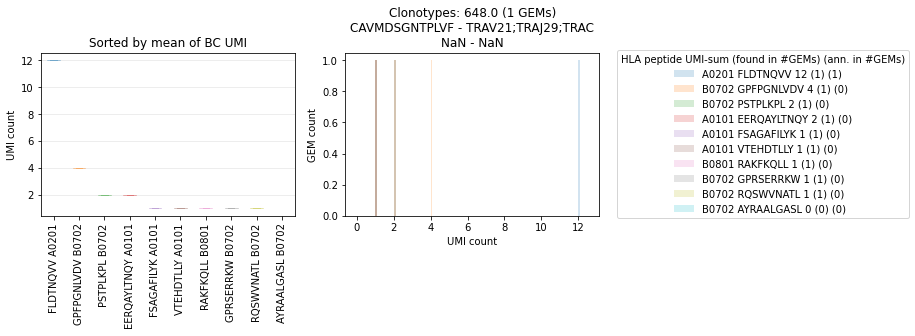

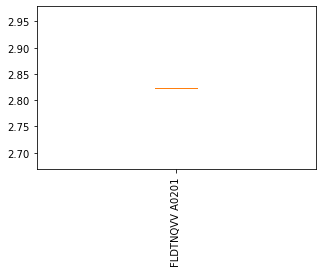

[177.]
('NaN', 'CAVSTHGGSQGNLIF') unresolved
      peptide   peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
292  RAKFKQLL  ['RAKFKQLL']               [1]  CAVSTHGGSQGNLIF   

               genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB  \
292  ['TRAV8-3;TRAJ42;TRAC']                 4                        NaN   

    umi_count_lst_TRB  
292               NaN  


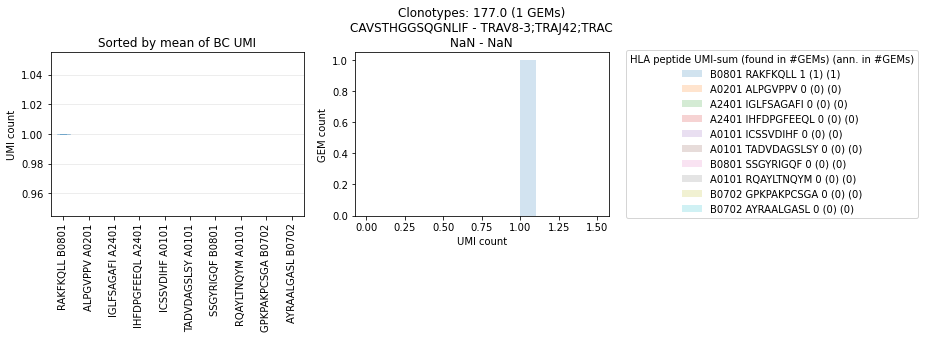

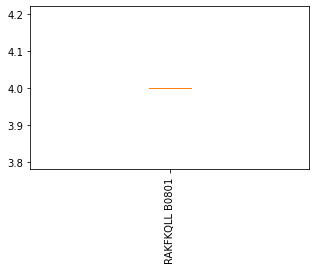

[102.]
('NaN', 'CAVTAPAYSGAGSYQLTF') unresolved
      peptide   peptide_lst umi_count_lst_mhc        cdr3_lst_TRA  \
382  RAKFKQLL  ['RAKFKQLL']               [1]  CAVTAPAYSGAGSYQLTF   

              genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB  \
382  ['TRAV39;TRAJ28;TRAC']                 1                        NaN   

    umi_count_lst_TRB  
382               NaN  


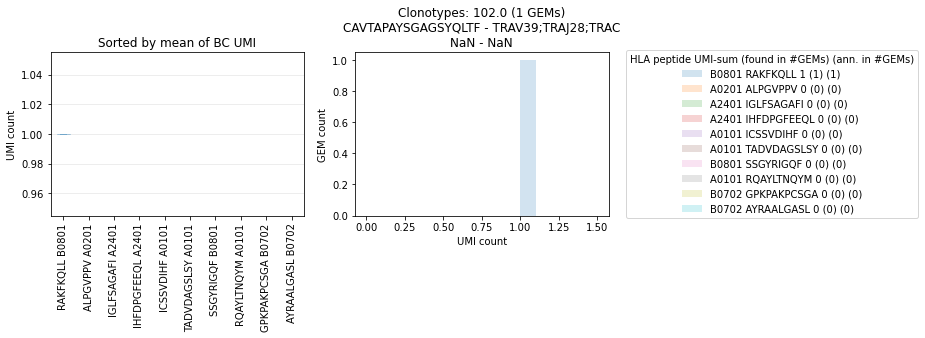

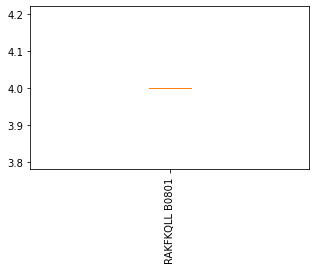

[61.]
('NaN', 'CIVRVGGDSWGKLQF') unresolved
        peptide               peptide_lst umi_count_lst_mhc     cdr3_lst_TRA  \
1933  VTEHDTLLY  ['RAKFKQLL' 'VTEHDTLLY']            [1, 1]  CIVRVGGDSWGKLQF   

                 genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB  \
1933  ['TRAV26-1;TRAJ24;TRAC']                 4                        NaN   

     umi_count_lst_TRB  
1933               NaN  


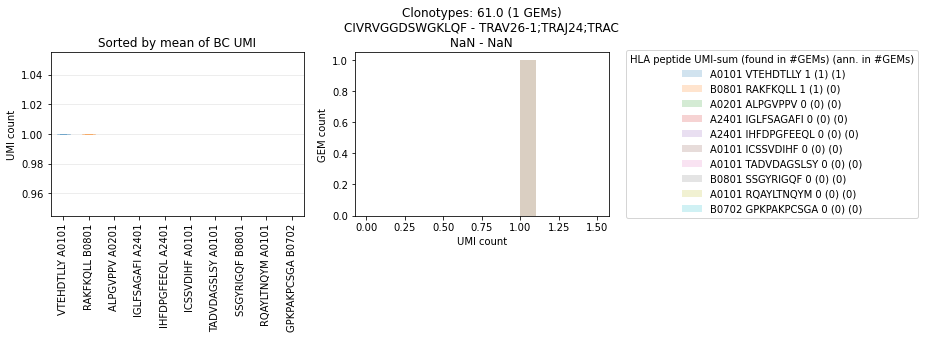

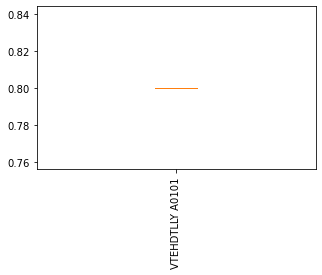

[555.]
('NaN', 'CVVSAAANSGGYQKVTF') unresolved
       peptide    peptide_lst umi_count_lst_mhc       cdr3_lst_TRA  \
158  VTEHDTLLY  ['VTEHDTLLY']               [3]  CVVSAAANSGGYQKVTF   

              genes_lst_TRA umi_count_lst_TRA cdr3_lst_TRB genes_lst_TRB  \
158  ['TRAV10;TRAJ13;TRAC']                 6                        NaN   

    umi_count_lst_TRB  
158               NaN  


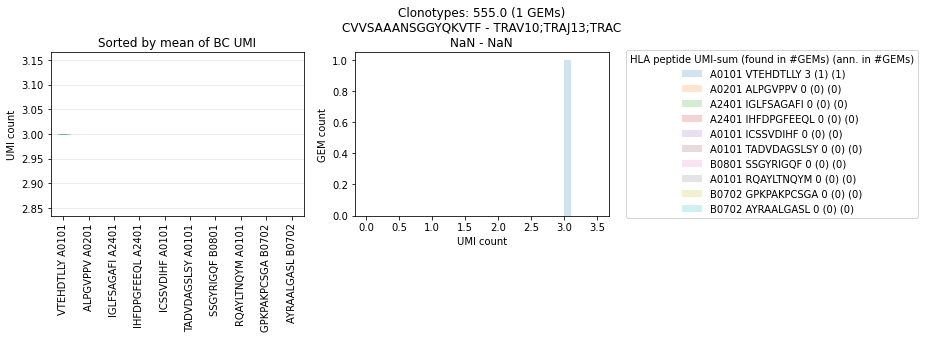

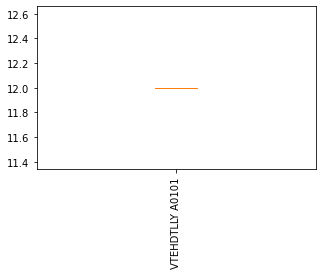

In [65]:
ndf['nct_pep'] = np.nan
trash_bin = set()
nct = ndf.fillna('NaN').groupby(['cdr3_TRB','cdr3_TRA'])
selected_clonotypes = nct.size().sort_values(ascending=False)
all_peptide_HLA = ndf.peptide_HLA_lst.explode()

for ct, sub_df in sorted(nct, key=lambda x: len(x[1]), reverse=True):
    print(sub_df.ct.unique())
    mat = pd.DataFrame(index=all_peptide_HLA.unique(), columns= ndf.gem.unique())
    sub_df.apply(lambda row: sum_umi(row), axis=1)
    
    #summaryndf
    summary_df = mat.sum(axis=1).sort_values(ascending=False).to_frame().rename(columns={0:'s'})
    summary_df['avg'] = mat.mean(axis=1)
    summary_df['col'] = 'grey'
    
    summed_umis = summary_df.s.head(10)
    summed_gems = (mat > 0).sum(axis=1)
    annotated_gems = sub_df.groupby('peptide_HLA').size()
    all_gems_hla = pd.concat([annotated_gems,
                              pd.Series(0, index=all_peptide_HLA[~all_peptide_HLA.isin(annotated_gems.index)].unique())])
    
    # test if two annotations are significantly different distributed.
    if test_dist():
        # Maybe accumulate distributions for true imputations to compare with when in doubt?
        ndf.loc[sub_df.index, 'nct_pep'] = summary_df.index[0]
        trash_bin.update(summary_df.index[1:10])
        if sub_df.ct.unique()[0] > 10:
            continue
    else:
        if summary_df.index[0] not in trash_bin:
            if summary_df.index[1] not in trash_bin:
                print('HELP!')
            else:
                ndf.loc[sub_df.index, 'nct_pep'] = summary_df.index[0]
                trash_bin.update(summary_df.index[1:10])
                print(ct, 'resolved by trash bin')
        else:
            # Check if distribution matches a previously accepted peptide distribution.
            ndf.loc[sub_df.index, 'nct_pep'] = 'unresolved'
            print(ct, 'unresolved')
            
        print(ndf.loc[sub_df.index, ['peptide', 'peptide_lst','umi_count_lst_mhc',
                                  'cdr3_lst_TRA','genes_lst_TRA','umi_count_lst_TRA',
                                  'cdr3_lst_TRB','genes_lst_TRB','umi_count_lst_TRB']])
    
    fig, (ax1, ax2) = plt.subplots(1,2,figsize=(10,3))
    # Histogram
    for peptide_HLA in summed_umis.index:
        ax2.hist(mat.T[peptide_HLA].dropna(), alpha=0.2, label='%s %s %d (%d) (%d)' %(peptide_HLA.split(' ')[1], peptide_HLA.split(' ')[0], summed_umis[peptide_HLA], summed_gems[peptide_HLA], all_gems_hla[peptide_HLA]))
    summary_df.iloc[0:10, summary_df.columns.to_list().index('col')] = plt.rcParams['axes.prop_cycle'].by_key()['color']
    # Boxplot
    boxes = list()
    meaned_umis = summary_df.sort_values(by='avg',ascending=False).head(10)
    for peptide_HLA in meaned_umis.index:
        boxes.append(mat.T[peptide_HLA].dropna().to_list())
    bp = ax1.boxplot(boxes, patch_artist=True) #, vert=False
    colors = meaned_umis.col #.to_list()
    
    # whiskers and caps have to be treated separately since there are two of each for each plot
    for item in ['whiskers', 'caps']:
        for sub_item, color in zip(zip(bp[item][::2], bp[item][1::2]), colors):
            plt.setp(sub_item, color=color, alpha=0.2)
    for item in ['fliers']:
        for sub_item, color in zip(bp[item], colors):
            plt.setp(sub_item, markeredgecolor=color, alpha=0.2)
    for item in ['boxes', 'medians']:
        for sub_item, color in zip(bp[item], colors):
            plt.setp(sub_item, color=color, alpha=0.2)
            
    ax1.set_title('Sorted by mean of BC UMI')
    ax1.set_xticklabels(meaned_umis.index, rotation=90)
    ax1.set_ylabel('UMI count')
    ax1.yaxis.grid(True, linestyle='-', which='major', color='lightgrey',alpha=0.5)
    ax1.set_axisbelow(True) # Hide these grid behind plot objects
    plt.legend(bbox_to_anchor=(1.05, 0.5), loc='center left', title='HLA peptide UMI-sum (found in #GEMs) (ann. in #GEMs)')
    ax2.set_xlabel('UMI count')
    ax2.set_ylabel('GEM count')
    ax2.set_title('Clonotypes: %s (%d GEMs)\n%s - %s\n%s - %s' %(', '.join([str(v) for v in sub_df.ct.unique()]), selected_clonotypes[ct], ct[1], sub_df.genes_TRA.unique()[0], ct[0], sub_df.genes_TRB.unique()[0]))
    #if ct == 222:
    #    plt.savefig('%s.pdf'%ct)
    #    print(summed_umis)
    #    print(summed_gems)
    #    print(all_gems_hla)
    #plt.show()
    
    plt.figure(figsize=(5,3))
    delta = sub_df[['delta_umi_mhc','peptide_HLA']].sort_values('delta_umi_mhc', ascending=False).groupby('peptide_HLA', sort=False).delta_umi_mhc.apply(list)
    plt.boxplot(delta.to_list()[:10])
    plt.xticks(np.arange(1, min(11, len(delta)+1)), delta.index[:10], rotation=90)
    plt.show()
    



In [66]:
ndf.fillna('NaN').groupby(['cdr3_TRB','cdr3_TRA','nct_pep','ct']).peptide_HLA.unique().to_frame().head(60)

peptide_HLA
cdr3_TRB           cdr3_TRA           nct_pep          ct                                                      
CAGGQGFSEAFF       CAAISGGYNKLIF      unresolved       168.0                [VTEHDTLLY A0101, TPRVTGGGAM B0702]
                   CALSRASGGSYIPTF    unresolved       130.0                                  [VTEHDTLLY A0101]
CAIKPRQLNTEAFF     CAAKYAGGTSYGKLTF   unresolved       565.0                                  [VTEHDTLLY A0101]
CAMAGTGSTDTQYF     CAESETGANNLFF      RAKFKQLL B0801   17.0   [RAKFKQLL B0801, RQAYLTNQY A0101, TPRVTGGGAM B...
                   NaN                unresolved       27.0                                    [RAKFKQLL B0801]
CASAGDGTYNEQFF     NaN                unresolved       300.0                                   [RAKFKQLL B0801]
CASKGSGTGNSPLHF    CVVYAAFYDYKLSF     unresolved       557.0                                 [TPRVTGGGAM B0702]
CASKMGGSTDTQYF     CAANFGNEKLTF       unresolved       570.0                                  [VTEHDTLLY A0101]
CASKQAGTEAFF       CAMRGDFGNEKLTF     unresolved       485.0                                  [VTEHDTLLY A0101]
CASQDSSGNTIYF      CAYRWGGSQGNLIF     unresolved       614.0                                  [VTEHDTLLY A0101]
CASRDTGTGTSYEQYF   NaN                unresolved       311.0                                  [VTEHDTLLY A0101]
CASRETGTNTGELFF    CALDDNTGKLIF       unresolved       194.0                                [EERQAYLTNQY A0101]
CASRETSGATDTQYF    NaN                unresolved       304.0                                [EERQAYLTNQY A0101]
CASRFTRGSEQETQYF   CALSESGGSGNTGKLIF  unresolved       664.0                                  [VTEHDTLLY A0101]
CASRIGAAGNSPLHF    CAASQNEKLTF        TPRVTGGGAM B0702 1.0    [VTEHDTLLY A0101, RAKFKQLL B0801, TPRVTGGGAM B...
                   CALRDMEYGNKLVF     unresolved       57.0                                  [TADVDAGSLS A0101]
                   CAVNYGNKLVF        unresolved       53.0                                    [RAKFKQLL B0801]
                   NaN                unresolved       8.0    [RAKFKQLL B0801, VTEHDTLLY A0101, RRKVPAQRL B0...
CASRMAGALSYEQYF    CAVRDIGQAGTALIF    unresolved       578.0                                   [RAKFKQLL B0801]
                   NaN                unresolved       89.0                                    [RAKFKQLL B0801]
CASRPGLAGVYNEQFF   CAAAETSYDKVIF      unresolved       73.0                  [IRHKRQSWV B0801, VTEHDTLLY A0101]
CASRPNTGTVSSYNEQFF NaN                unresolved       298.0                                   [RAKFKQLL B0801]
CASRPRYRSYNEQFF    CAVNYGNKLVF        unresolved       629.0                                  [GMAEGATTA A0101]
CASRRAGPVPFF       CAVGADASGTYKYIF    VTEHDTLLY A0101  54.0                                   [VTEHDTLLY A0101]
                   NaN                unresolved       137.0                                  [VTEHDTLLY A0101]
CASRRNLGGNQPQHF    CAVNTGDYKLSF       VPAQRLQEA B0801  272.0                                  [VPAQRLQEA B0801]
CASRSTEPNQPQHF     CAASERGGHTGANSKLTF unresolved       576.0                                   [RAKFKQLL B0801]
CASRTGGREPQHF      CAGNTDKLIF         unresolved       140.0                                  [VTEHDTLLY A0101]
CASRTGGVNEQYF      CAVYSGAGSYQLTF     unresolved       647.0                                   [RAKFKQLL B0801]
CASRVGLASSYNEQFF   CAVNGGFKTIF        unresolved       135.0                                 [TPRVTGGGAM B0702]
CASRVQFGVNTGELFF   CAASQNEKLTF        unresolved       678.0                                  [VTEHDTLLY A0101]
                   CAASRYAGNNRKLIW    unresolved       568.0                                  [VTEHDTLLY A0101]
                   CALWEYGNKLVF       VTEHDTLLY A0101  10.0   [VTEHDTLLY A0101, ILKEPVHGV A0201, CSSVDIHF A0...
                   CAVNYGNKLVF        unresolved       624.0                                  [VTEHDTLLY A0101]
                   NaN                VTEHDTLLY A0101  32.0         

In [67]:
ndf.fillna('NaN').groupby(['cdr3_TRB','cdr3_TRA','nct_pep','ct']).peptide_HLA.unique().to_frame().tail(60)

peptide_HLA
cdr3_TRB           cdr3_TRA            nct_pep          ct                                                      
CASTILPSGTGGHDEQFF CAASEGSYIPTF        unresolved       429.0                                  [VTEHDTLLY A0101]
CASTIQGASTDTQYF    NaN                 unresolved       291.0                                   [RAKFKQLL B0801]
CASTNPGLNYEQYF     NaN                 unresolved       319.0                                  [GPKPAKPCS B0702]
CASTPLAGGYNEQFF    NaN                 unresolved       280.0                                  [VTEHDTLLY A0101]
CASTPRDRGFQPQHF    CAVRDSPGRDDKIIF     unresolved       86.0                                   [VTEHDTLLY A0101]
                   NaN                 unresolved       63.0                [VTEHDTLLY A0101, EERQAYLTNQY A0101]
CASTSLTGELFF       CAALMDSSYKLIF       unresolved       509.0                                   [RAKFKQLL B0801]
CASTVQTETGELFF     NaN                 unresolved       290.0                                 [TPRVTGGGAM B0702]
CASVGQGSYGYTF      NaN                 unresolved       401.0                                   [RAKFKQLL B0801]
CATQLGQGLSGANVLTF  CAMREVRLHGSSNTGKLIF unresolved       426.0                                  [VTEHDTLLY A0101]
CATRQNTEAFF        CAVNYGNKLVF         unresolved       603.0                                  [VTEHDTLLY A0101]
                   NaN                 unresolved       109.0                                  [VTEHDTLLY A0101]
CATSDLYRDEQYF      CAVSGGGSQGNLIF      unresolved       122.0                                  [VTEHDTLLY A0101]
CATSRDLQVNQPQHF    CADPAGGTSYGKLTF     unresolved       714.0                                  [VTEHDTLLY A0101]
CATSRGAGTGGSYEQFF  CAVSSLTGANNLFF      unresolved       104.0                                  [VTEHDTLLY A0101]
CAWPRSTGELFF       CAVADSWGKFQF        unresolved       21.0   [EERQAYLTNQY A0101, RAKFKQLL B0801, VTEHDTLLY ...
CSAEGLAGQGVSYEQYF  CVAGGTNAGKSTF       unresolved       560.0                                  [VTEHDTLLY A0101]
                   NaN                 unresolved       408.0                                  [VTEHDTLLY A0101]
CSAGGGGIETQYF      CIVRLPDSGGYQKVTF    unresolved       686.0                                 [TPRVTGGGAM B0702]
CSAKRLAGEADTQYF    CAVPNYGGATNKLIF     unresolved       505.0                                  [VTEHDTLLY A0101]
CSALGLADDNEQFF     CAMREGLEGYQKVTF     unresolved       152.0                                 [TPRVTGGGAM B0702]
CSARAGTGQETQYF     NaN                 unresolved       386.0                                  [VTEHDTLLY A0101]
CSARAGTSGRTDTQYF   CAVRDSWGKFQF        unresolved       514.0                                   [RAKFKQLL B0801]
CSARDLTGNYGYTF     CAARNPPWGGGSQGNLIF  unresolved       711.0                                   [RAKFKQLL B0801]
CSARGLGQAKEYGYTF   CAAFRAYNTDKLIF      VTEHDTLLY A0101  11.0   [VTEHDTLLY A0101, FSAGAFILYK A0101, EERQAYLTNQ...
                   CALRDMEYGNKLVF      unresolved       478.0                                  [VTEHDTLLY A0101]
                   CAVEDRLDNDMRF       unresolved       14.0   [VTEHDTLLY A0101, NLVPMVATV A0201, RAKFKQLL B0...
                   CAVNYGNKLVF         unresolved       716.0                                [EERQAYLTNQY A0101]
                   NaN                 VTEHDTLLY A0101  16.0   [VTEHDTLLY A0101, RAKFKQLL B0801, EERQAYLTNQY ...
CSASLASHPNTGELFF   CLPYGSGNTGKLIF      unresolved       240.0                                  [VTEHDTLLY A0101]
CSAVGSWAPNTGELFF   CAAQGGKLIF          unresolved       534.0                                  [NLVPMVATV A0201]
CSVEGRAMGYTF       CAVRDRDNDMRF        unresolved       602.0                                  [VTEHDTLLY A0101]
CSVEPPEGLTSTDTQYF  CAVRDTGGSNYQLIW     unresolved       144.0                                   [RAKFKQLL B0801]
CSVEVGRAGEQFF      CAFMRGGADGLTF       unresolved       604.0                                  [VTEHDTLLY A0101]
CSVEVPGKVFRTEAFF   CAASEPAKIPKAAG

In [75]:
df.fillna('NaN').explode('cdr3_lst_TRB').explode('cdr3_lst_TRA').groupby(['cdr3_lst_TRA','cdr3_lst_TRB']).ct_pep.apply(list)

cdr3_lst_TRA       cdr3_lst_TRB     
                   CAMAGTGSTDTQYF        [unresolved, unresolved, unresolved, unresolved]
                   CASAGDGTYNEQFF                                            [unresolved]
                   CASRDTGTGTSYEQYF                                          [unresolved]
                   CASRETSGATDTQYF                                           [unresolved]
                   CASRIGAAGNSPLHF      [unresolved, unresolved, unresolved, unresolve...
                                                              ...                        
CVVSELGYYKGTYKYIF  CASSEGDIIYEQYF                                            [unresolved]
CVVTLHRDDKIIF      CASRIGAAGNSPLHF                                           [unresolved]
                   CASSGGQIDSGANVLTF                                         [unresolved]
CVVTLPTGFQKLVF     CASSSGLAVDTQYF                                            [unresolved]
CVVYAAFYDYKLSF     CASKGSGTGNSPLHF                             

In [18]:
df.groupby(['ct_pep','cdr3_TRB','genes_TRB','ct']).cdr3_TRA.unique().to_frame().head(60)

cdr3_TRA
ct_pep           cdr3_TRB           genes_TRB                    ct                          
AYLTNQYM A2401   CASSLNEQYF         TRBV7-9;;TRBJ2-7;TRBC2       538.0      [CAAHHDYNQGGKLIF]
FLDTNQVVRI A0201 CASSEQGDTGELFF     TRBV6-1;TRBD1;TRBJ2-2;TRBC2  494.0         [CAVRDSNYQLIW]
GPFPGNLVDV B0702 CASSLGIHYEQYF      TRBV28;;TRBJ2-7;TRBC2        50.0                   [nan]
                 CASSPRADNNEQFF     TRBV28;;TRBJ2-1;TRBC2        435.0    [CAASPPMIKAAGNKLTF]
IGLFSAGAFI A2401 CASSWDVRNTDTQYF    TRBV2;;TRBJ2-3;TRBC2         569.0        [CATQTGTASKLTF]
IHFDPGFEEQ A0101 CASSLGTSGNTGELFF   TRBV5-6;TRBD2;TRBJ2-2;TRBC2  198.0         [CAPNNQGGKLIF]
NLVPMVATV A0201  CASSLVAGAPSEQYF    TRBV27;;TRBJ2-7;TRBC2        3.0            [CAVNYGNKLVF]
RAKFKQLL B0801   CAMAGTGSTDTQYF     TRBV10-3;TRBD1;TRBJ2-3;TRBC2 17.0         [CAESETGANNLFF]
                 CASSDLNSPLHF       TRBV27;;TRBJ1-6;TRBC1        28.0       [CIVRVGGDSWGKLQF]
                 CASSLIVSGGANEQFF   TRBV7-3;;TRBJ2-1;TRBC2       2.0         [CALRDMEYGNKLVF]
                                                                 4.0                    [nan]
                 CASSYTVGEYNEQFF    TRBV7-2;;TRBJ2-1;TRBC2       49.0         [CAVNLVSGYALNF]
RTMFWGPEV A0201  CASSFVEDTIYF       TRBV28;;TRBJ1-3;TRBC1        535.0         [CAGFNQGGKLIF]
SAGAFILYK A0101  CASSLSGGGRGAEAFF   TRBV7-9;TRBD1;TRBJ1-1;TRBC1  537.0           [CAAQGGKLIF]
TPRVTGGGAM B0702 CASRIGAAGNSPLHF    TRBV27;;TRBJ1-6;             1.0            [CAASQNEKLTF]
                                    TRBV27;;TRBJ1-6;TRBC1        1.0            [CAASQNEKLTF]
                 CASSPSDALVSEQYF    TRBV7-9;;TRBJ2-7;TRBC2       20.0       [CAVRSRMDSSYKLIF]
VPAQRLQEA B0801  CASRRNLGGNQPQHF    TRBV28;;TRBJ1-5;TRBC1        272.0         [CAVNTGDYKLSF]
VTEHDTLLY A0101  CASRRAGPVPFF       TRBV19;;TRBJ1-1;TRBC1        54.0       [CAVGADASGTYKYIF]
                 CASRVQFGVNTGELFF   TRBV19;;TRBJ2-2;TRBC2        10.0          [CALWEYGNKLVF]
                                                                 32.0                   [nan]
                 CASSERGQGAYEQYF    TRBV5-4;TRBD1;TRBJ2-7;TRBC2  33.0       [CAASRYAGNNRKLIW]
                 CASSFRRGQSSYEQYF   TRBV27;;TRBJ2-7;TRBC2        48.0   [CAFMKHESALVSRPNKLIF]
                 CASSLATGRTYGYTF    TRBV7-8;;TRBJ1-2;TRBC1       25.0        [CAAADSSNDYKLSF]
                 CASSLEAGQKPYEQYF   TRBV7-9;;TRBJ2-7;TRBC2       13.0          [CAARPGAQKLVF]
                 CASSVGSGSSYEQYF    TRBV9;;TRBJ2-7;TRBC2         22.0       [CVVNNAGAGGFKTIF]
                                                                 30.0                   [nan]
                 CASSYTPGSTYEQYF    TRBV4-2;;TRBJ2-7;TRBC2       6.0     [CAVTAPAYSGAGSYQLTF]
                                                                 7.0                    [nan]
                 CSARGLGQAKEYGYTF   TRBV20-1;;TRBJ1-2;           16.0                   [nan]
                                    TRBV20-1;;TRBJ1-2;TRBC1      11.0        [CAAFRAYNTDKLIF]
                                                                 14.0         [CAVEDRLDNDMRF]
                                                                 16.0                   [nan]
YLFHKEPTW A0201  CASSEELAGGRETQYF   TRBV6-1;;TRBJ2-5;TRBC2       495.0         [CAVLDSNYQLIW]
unresolved       CAGGQGFSEAFF       TRBV30;TRBD1;TRBJ1-1;TRBC1   130.0      [CALSRASGGSYIPTF]
                                                                 168.0        [CAAISGGYNKLIF]
                 CAIKPRQLNTEAFF     TRBV7-9;;TRBJ1-1;TRBC1       565.0     [CAAKYAGGTSYGKLTF]
                 CAMAGTGSTDTQYF     TRBV10-3;TRBD1;TRBJ2-3;TRBC2 27.0                   [nan]
                 CASAGDGTYNEQFF     TRBV27;;TRBJ2-1;TRBC2        300.0                  [nan]
                 CASKGSGTGNSPLHF    TRBV2;;TRBJ1-6;TRBC1         557.0       [CVVYAAFYDYKLSF]
                 CASKMGGSTDTQYF     TRBV18;;TRBJ2-3;TRBC2        570.0         [CAANFGNEKLTF]
                 CASKQAGTEAFF       TRBV27;

In [19]:
df['ct_tra'] = np.nan
grp = df[df.ct_pep != 'unresolved'].groupby(['ct_pep','cdr3_TRB','genes_TRB'])

for (ct_pep, cdr3_TRB, genes_TRB), sub_df in grp:
    if sub_df.ct.nunique() == 2:
        assert any(sub_df.cdr3_TRA.isna())
        df.loc[sub_df.index, 'ct_tra'] = sub_df.cdr3_TRA.dropna().unique()[0]
        print(ct_pep, cdr3_TRB, genes_TRB)
    if sub_df.ct.nunique() > 2:
        print(sub_df.ct.unique())
        if sub_df[sub_df['exclude_ambiguous_and_single-chain_TCRs']].cdr3_TRA.nunique() == 1:
            print('TRA imputation')
            # Indexes to be imputed
            i_ct = sub_df[sub_df.cdr3_TRA.isna()].index
            # Indexes to be imputed from
            idx = sub_df[sub_df['exclude_ambiguous_and_single-chain_TCRs']].index
            df.loc[np.append(i_ct, idx), 'ct_tra'] = sub_df.loc[idx, 'cdr3_TRA'].unique()[0]
        else:
            print('no TRA imputation')

RAKFKQLL B0801 CASSLIVSGGANEQFF TRBV7-3;;TRBJ2-1;TRBC2
VTEHDTLLY A0101 CASRVQFGVNTGELFF TRBV19;;TRBJ2-2;TRBC2
VTEHDTLLY A0101 CASSVGSGSSYEQYF TRBV9;;TRBJ2-7;TRBC2
VTEHDTLLY A0101 CASSYTPGSTYEQYF TRBV4-2;;TRBJ2-7;TRBC2
[14. 11. 16.]
no TRA imputation


In [20]:
df['ct_TRB'] = np.nan
grp = df[df.ct_pep != 'unresolved'].groupby(['ct_pep','cdr3_TRA','genes_TRA'])

for (ct_pep, cdr3_TRA, genes_TRA), sub_df in grp:
    if sub_df.ct.nunique() == 2:
        assert any(sub_df.cdr3_TRB.isna())
        df.loc[sub_df.index, 'ct_TRB'] = sub_df.cdr3_TRB.dropna().unique()[0]
        print(ct_pep, cdr3_TRA, genes_TRA)
    if sub_df.ct.nunique() > 2:
        print(sub_df.ct.unique())
        if sub_df[sub_df['exclude_ambiguous_and_single-chain_TCRs']].cdr3_TRB.nunique() == 1:
            print('TRB imputation')
            # Indexes to be imputed
            i_ct = sub_df[sub_df.cdr3_TRB.isna()].index
            # Indexes to be imputed from
            idx = sub_df[sub_df['exclude_ambiguous_and_single-chain_TCRs']].index
            df.loc[np.append(i_ct, idx), 'ct_TRB'] = sub_df.loc[idx, 'cdr3_TRB'].unique()[0]
        else:
            print('no TRB imputation')

TPRVTGGGAM B0702 CAASQNEKLTF TRAV21;TRAJ48;TRAC


In [22]:
df.groupby(['ct_pep','cdr3_TRA','genes_TRA','ct']).cdr3_TRB.unique().to_frame().head(60)

cdr3_TRB
ct_pep           cdr3_TRA            genes_TRA                ct                        
AYLTNQYM A2401   CAAHHDYNQGGKLIF     TRAV12-2;TRAJ23;TRAC     538.0         [CASSLNEQYF]
FLDTNQVVRI A0201 CAVRDSNYQLIW        TRAV1-2;TRAJ33;TRAC      494.0     [CASSEQGDTGELFF]
GPFPGNLVDV B0702 CAASPPMIKAAGNKLTF   TRAV13-1;TRAJ17;TRAC     435.0     [CASSPRADNNEQFF]
IGLFSAGAFI A2401 CATQTGTASKLTF       TRAV29/DV5;TRAJ44;TRAC   569.0    [CASSWDVRNTDTQYF]
IHFDPGFEEQ A0101 CAPNNQGGKLIF        TRAV9-2;TRAJ23;TRAC      198.0   [CASSLGTSGNTGELFF]
NLVPMVATV A0201  CAVNYGNKLVF         TRAV3;TRAJ47;TRAC        3.0      [CASSLVAGAPSEQYF]
RAKFKQLL B0801   CAESETGANNLFF       TRAV5;TRAJ36;TRAC        17.0      [CAMAGTGSTDTQYF]
                 CALRDMEYGNKLVF      TRAV16;TRAJ47;TRAC       2.0     [CASSLIVSGGANEQFF]
                 CAVNLVSGYALNF       TRAV12-2;TRAJ41;TRAC     49.0     [CASSYTVGEYNEQFF]
                 CAYRGDFNKFYF        TRAV38-2/DV8;TRAJ21;TRAC 164.0    [CASSQAAYGSYEQYF]
                 CIVRVGGDSWGKLQF     TRAV26-1;TRAJ24;TRAC     28.0        [CASSDLNSPLHF]
RTMFWGPEV A0201  CAGFNQGGKLIF        TRAV12-2;TRAJ23;TRAC     535.0       [CASSFVEDTIYF]
SAGAFILYK A0101  CAAQGGKLIF          TRAV12-2;TRAJ23;TRAC     537.0   [CASSLSGGGRGAEAFF]
TPRVTGGGAM B0702 CAASQNEKLTF         TRAV21;TRAJ48;TRAC       1.0      [CASRIGAAGNSPLHF]
                                                              5.0                  [nan]
                 CATVSRMDSSYKLIF     TRAV17;TRAJ12;TRAC       41.0    [CASSLIGQGLGDEQFF]
                 CAVRSRMDSSYKLIF     TRAV3;TRAJ12;TRAC        20.0     [CASSPSDALVSEQYF]
VTEHDTLLY A0101  CAAADSSNDYKLSF      TRAV29/DV5;TRAJ20;TRAC   25.0     [CASSLATGRTYGYTF]
                 CAAFRAYNTDKLIF      TRAV29/DV5;TRAJ34;TRAC   11.0    [CSARGLGQAKEYGYTF]
                 CAARPGAQKLVF        TRAV29/DV5;TRAJ54;TRAC   13.0    [CASSLEAGQKPYEQYF]
                 CAASRYAGNNRKLIW     TRAV29/DV5;TRAJ38;TRAC   33.0     [CASSERGQGAYEQYF]
                 CAFMKHESALVSRPNKLIF TRAV38-1;TRAJ32;TRAC     48.0    [CASSFRRGQSSYEQYF]
                 CALRDMEYGNKLVF      TRAV16;TRAJ47;TRAC       68.0     [CASSYTPGSTYEQYF]
                 CALWEYGNKLVF        TRAV16;TRAJ47;TRAC       10.0    [CASRVQFGVNTGELFF]
                 CAVEDRLDNDMRF       TRAV2;TRAJ43;TRAC        14.0    [CSARGLGQAKEYGYTF]
                 CAVGADASGTYKYIF     TRAV8-3;TRAJ40;TRAC      54.0        [CASRRAGPVPFF]
                 CAVSSLTGANNLFF      TRAV21;TRAJ36;TRAC       104.0  [CATSRGAGTGGSYEQFF]
                 CAVTAPAYSGAGSYQLTF  TRAV39;TRAJ28;TRAC       6.0      [CASSYTPGSTYEQYF]
                 CVVNNAGAGGFKTIF     TRAV12-1;TRAJ9;TRAC      22.0     [CASSVGSGSSYEQYF]
YLFHKEPTW A0201  CAVLDSNYQLIW        TRAV1-2;TRAJ33;TRAC      495.0   [CASSEELAGGRETQYF]
unresolved       CAAADSSNDYKLSF      TRAV29/DV5;TRAJ20;TRAC   108.0                [nan]
                 CAAAETSYDKVIF       TRAV13-1;TRAJ50;TRAC     73.0    [CASRPGLAGVYNEQFF]
                 CAADVTDSWGKFQF      TRAV29/DV5;TRAJ24;TRAC   596.0    [CASSLSGGSYNEQFF]
                 CAAEARDNYGQNFVF     TRAV13-1;TRAJ26;TRAC     439.0     [CASSWGGTYNEQFF]
                 CAAENQGGKLIF        TRAV29/DV5;TRAJ23;TRAC   24.0     [CASSERGQGAYEQYF]
                                                              65.0                 [nan]
                 CAAFRAYNTDKLIF      TRAV29/DV5;TRAJ34;TRAC   566.0    [CASSYRTVSSYEQYF]
                                                              582.0   [CASSLIVSGGANEQFF]
                                                              583.0    [CASSYTPGSTYEQYF]
                 CAAGYNFNKFYF        TRAV29/DV5;TRAJ21;TRAC   593.0   [CASSLGPLETHGAQYF]
                 CAAIDSNYQLIW        TRAV1-2;TRAJ33;TRAC      498.0      [CASSAGSYNEQFF]
                 CAAIETSYDKVIF       TRAV13-1;TRAJ50;TRAC     98.0     [CASSSTGPGNQPQHF]
                 CAAILGYQKVTF        TRAV29/DV5;TRAJ13;TRAC   133.0     [CASSLGATNEKLFF]
                 CAAINEGGKLIF        TRAV29/DV5;TRAJ23;TRAC   132.0    [CAS

In [169]:
df.loc[df.ct==9, ['clonotype','ct','cdr3_TRA','cdr3_lst_TRA','genes_TRA','genes_lst_TRA','umi_count_lst_TRA','cdr3_TRB','umi_count_lst_TRB','cdr3_lst_TRB','genes_TRB','genes_lst_TRB','imputed_TRB','peptide_HLA','peptide_lst']]

,clonotype,ct,cdr3_TRA,cdr3_lst_TRA,genes_TRA,genes_lst_TRA,umi_count_lst_TRA,cdr3_TRB,umi_count_lst_TRB,cdr3_lst_TRB,genes_TRB,genes_lst_TRB,imputed_TRB,peptide_HLA,peptide_lst
60,clonotype1,9,CAASQNEKLTF,[CAASQNEKLTF],TRAV21;TRAJ48;TRAC,['TRAV21;TRAJ48;TRAC'],[7],NaN,NaN,[''],NaN,NaN,NaN,TPRVTGGGAM B0702,['AMLIRDRL' 'VTEHDTLLY' 'TNQYMQRMASV' 'YPLVKMR...
128,clonotype1,9,CAASQNEKLTF,[CAASQNEKLTF],TRAV21;TRAJ48;TRAC,['TRAV21;TRAJ48;TRAC'],[7],CASSMSGSEQYF,NaN,[''],NaN,NaN,CASSMSGSEQYF,VTEHDTLLY A0101,['VTEHDTLLY']
132,clonotype1,9,CAASQNEKLTF,[CAASQNEKLTF],TRAV21;TRAJ48;TRAC,['TRAV21;TRAJ48;TRAC'],[5],NaN,NaN,[''],NaN,NaN,NaN,TPRVTGGGAM B0702,['GPFPGNLV' 'EERQAYLTNQY' 'GPKPAKPCS' 'AALPGVP...
140,clonotype1,9,CAASQNEKLTF,[CAASQNEKLTF],TRAV21;TRAJ48;TRAC,['TRAV21;TRAJ48;TRAC'],[7],NaN,NaN,[''],NaN,NaN,NaN,VTEHDTLLY A0101,['CSSVDIHF' 'VTEHDTLLY']
160,clonotype1,9,CAASQNEKLTF,[CAASQNEKLTF],TRAV21;TRAJ48;TRAC,['TRAV21;TRAJ48;TRAC'],[5],CASSLIVSGGANEQFF,NaN,[''],NaN,NaN,CASSLIVSGGANEQFF,RAKFKQLL B0801,['RAKFKQLL']
300,clonotype1,9,CAASQNEKLTF,[CAASQNEKLTF],TRAV21;TRAJ48;TRAC,['TRAV21;TRAJ48;TRAC'],[6],NaN,NaN,[''],NaN,NaN,NaN,RAKFKQLL B0801,['NLVPMVATV' 'RAKFKQLL']
310,clonotype1,9,CAASQNEKLTF,[CAASQNEKLTF],TRAV21;TRAJ48;TRAC,['TRAV21;TRAJ48;TRAC'],[5],CASSLIVSGGANEQFF,NaN,[''],NaN,NaN,CASSLIVSGGANEQFF,RAKFKQLL B0801,['RAKFKQLL']
343,clonotype1,9,CAASQNEKLTF,[CAASQNEKLTF],TRAV21;TRAJ48;TRAC,['TRAV21;TRAJ48;TRAC'],[3],CASSMSGSEQYF,NaN,[''],NaN,NaN,CASSMSGSEQYF,VTEHDTLLY A0101,['VTEHDTLLY']
353,clonotype1,9,CAASQNEKLTF,[CAASQNEKLTF],TRAV21;TRAJ48;TRAC,['TRAV21;TRAJ48;TRAC'],[6],NaN,NaN,[''],NaN,NaN,NaN,VTEHDTLLY A0101,['FSAGAFILYK' 'VTEHDTLLY']
373,clonotype1,9,CAASQNEKLTF,[CAASQNEKLTF],TRAV21;TRAJ48;TRAC,['TRAV21;TRAJ48;TRAC'],[4],NaN,NaN,[''],NaN,NaN,NaN,TPRVTGGGAM B0702,['KVPAQRLQEA' 'RAKFKQLL' 'VTEHDTLLY' 'WAGGLGLN...


In [154]:
df[df.ct.isin([11,7,13])].head(60)

,gem,clonotype,num_clonotype,ct,genes_TRA,genes_TRB,genes_lst_TRA,genes_lst_TRB,length_TRA,cdr3_TRA,...,imputed_TRA,imputed_TRB,imputed_PEP,imputed_CDX,imputed_umi_TRA,imputed_umi_TRB,imputed_umi_PEP,imputation_category,ct_pep,ct_tra
25,AAATGCCTCTTGTATC-1,clonotype5,5.0,11,TRAV2;TRAJ43;TRAC,TRBV20-1;;TRBJ1-2;TRBC1,['TRAV2;TRAJ43;TRAC'],['TRBV20-1;;TRBJ1-2;TRBC1'],446.0,CAVEDRLDNDMRF,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,VTEHDTLLY A0101,CAVEDRLDNDMRF
95,AATCGGTTCATCTGCC-1,clonotype5,5.0,7,TRAV29/DV5;TRAJ34;TRAC,TRBV20-1;;TRBJ1-2;TRBC1,['TRAV29/DV5;TRAJ34;TRAC'],['TRBV20-1;;TRBJ1-2;TRBC1'],514.0,CAAFRAYNTDKLIF,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,VTEHDTLLY A0101,CAVEDRLDNDMRF
144,ACCAGTACAATGGAAT-1,clonotype5,5.0,7,TRAV29/DV5;TRAJ34;TRAC,TRBV20-1;;TRBJ1-2;TRBC1,['TRAV29/DV5;TRAJ34;TRAC'],['TRBV20-1;;TRBJ1-2;TRBC1'],514.0,CAAFRAYNTDKLIF,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,VTEHDTLLY A0101,CAVEDRLDNDMRF
168,ACGAGCCTCTACTCAT-1,clonotype5,5.0,7,TRAV29/DV5;TRAJ34;TRAC,TRBV20-1;;TRBJ1-2;TRBC1,['TRAV29/DV5;TRAJ34;TRAC'],['TRBV20-1;;TRBJ1-2;TRBC1'],571.0,CAAFRAYNTDKLIF,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,VTEHDTLLY A0101,CAVEDRLDNDMRF
181,ACGATGTGTGGTTTCA-1,clonotype5,5.0,7,TRAV29/DV5;TRAJ34;TRAC,TRBV20-1;;TRBJ1-2;TRBC1,['TRAV29/DV5;TRAJ34;TRAC'],['TRBV20-1;;TRBJ1-2;TRBC1'],571.0,CAAFRAYNTDKLIF,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,VTEHDTLLY A0101,CAVEDRLDNDMRF
198,ACGGAGACACAAGCCC-1,NaN,0.0,11,TRAV2;TRAJ43;TRAC,TRBV20-1;;TRBJ1-2;TRBC1,['TRAV2;TRAJ43;TRAC'],['TRBV20-1;;TRBJ1-2;TRBC1'],450.0,CAVEDRLDNDMRF,...,NaN,NaN,VTEHDTLLY A0101,NaN,NaN,NaN,1.0,PEP,VTEHDTLLY A0101,CAVEDRLDNDMRF
211,ACGGGCTGTGTCGCTG-1,clonotype5,5.0,11,TRAV2;TRAJ43;TRAC,TRBV20-1;;TRBJ1-2;TRBC1,['TRAV2;TRAJ43;TRAC'],['TRBV20-1;;TRBJ1-2;TRBC1'],449.0,CAVEDRLDNDMRF,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,unique,VTEHDTLLY A0101,CAVEDRLDNDMRF
223,ACGTCAATCCAAAGTC-1,clonotype5,5.0,7,TRAV29/DV5;TRAJ34;TRAC,TRBV20-1;;TRBJ1-2;TRBC1,['TRAV29/DV5;TRAJ34;TRAC'],['TRBV20-1;;TRBJ1-2;TRBC1'],514.0,CAAFRAYNTDKLIF,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,VTEHDTLLY A0101,CAVEDRLDNDMRF
245,ACTGCTCAGACCCACC-1,clonotype5,5.0,11,TRAV2;TRAJ43;TRAC,TRBV20-1;;TRBJ1-2;TRBC1,['TRAV2;TRAJ43;TRAC'],['TRBV20-1;;TRBJ1-2;TRBC1'],451.0,CAVEDRLDNDMRF,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,VTEHDTLLY A0101,CAVEDRLDNDMRF
262,ACTTTCAAGCTCTCGG-1,clonotype5,5.0,7,TRAV29/DV5;TRAJ34;TRAC,TRBV20-1;;TRBJ1-2;TRBC1,['TRAV2;TRAJ43;TRAC' 'TRAV29/DV5;TRAJ34;TRAC'],['TRBV20-1;;TRBJ1-2;TRBC1'],571.0,CAAFRAYNTDKLIF,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,VTEHDTLLY A0101,NaN


In [24]:
df.loc[df.ct == 50, ['clonotype','ct','cdr3_TRA','cdr3_lst_TRA','genes_TRA','genes_lst_TRA','umi_count_lst_TRA','cdr3_TRB','umi_count_lst_TRB','cdr3_lst_TRB','genes_TRB','genes_lst_TRB','peptide_HLA','peptide_lst','ct_pep']]

,clonotype,ct,cdr3_TRA,cdr3_lst_TRA,genes_TRA,genes_lst_TRA,umi_count_lst_TRA,cdr3_TRB,umi_count_lst_TRB,cdr3_lst_TRB,genes_TRB,genes_lst_TRB,peptide_HLA,peptide_lst,ct_pep
2169,clonotype21,50.0,NaN,[],NaN,NaN,NaN,CASSLGIHYEQYF,[7],['CASSLGIHYEQYF'],TRBV28;;TRBJ2-7;TRBC2,['TRBV28;;TRBJ2-7;TRBC2'],VTEHDTLLY A0101,['VTEHDTLLY'],GPFPGNLVDV B0702
2220,clonotype21,50.0,NaN,[],NaN,NaN,NaN,CASSLGIHYEQYF,[12],['CASSLGIHYEQYF'],TRBV28;;TRBJ2-7;TRBC2,['TRBV28;;TRBJ2-7;TRBC2'],GPFPGNLVDV B0702,['GPKPAKPCS' 'VTEHDTLLY' 'PSTPLKPL' 'WPRAPRGQ'...,GPFPGNLVDV B0702


In [25]:
df.loc[df.ct == 435, ['clonotype','ct','cdr3_TRA','cdr3_lst_TRA','genes_TRA','genes_lst_TRA','cdr3_TRB','umi_count_lst_TRB','cdr3_lst_TRB','genes_TRB','genes_lst_TRB','peptide_HLA','peptide_lst','ct_pep']]

,clonotype,ct,cdr3_TRA,cdr3_lst_TRA,genes_TRA,genes_lst_TRA,cdr3_TRB,umi_count_lst_TRB,cdr3_lst_TRB,genes_TRB,genes_lst_TRB,peptide_HLA,peptide_lst,ct_pep
1235,clonotype273,435.0,CAASPPMIKAAGNKLTF,[CAASPPMIKAAGNKLTF],TRAV13-1;TRAJ17;TRAC,['TRAV13-1;TRAJ17;TRAC'],CASSPRADNNEQFF,[13],['CASSPRADNNEQFF'],TRBV28;;TRBJ2-1;TRBC2,['TRBV28;;TRBJ2-1;TRBC2'],GPFPGNLVDV B0702,['GPFPGNLVDV'],GPFPGNLVDV B0702


In [159]:
df.loc[df.ct == 13, ['clonotype','ct','cdr3_TRA','cdr3_lst_TRA','genes_TRA','genes_lst_TRA','cdr3_TRB','umi_count_lst_TRB','cdr3_lst_TRB','genes_TRB','genes_lst_TRB','peptide_HLA','peptide_lst','ct_pep']]

,clonotype,ct,cdr3_TRA,cdr3_lst_TRA,genes_TRA,genes_lst_TRA,cdr3_TRB,umi_count_lst_TRB,cdr3_lst_TRB,genes_TRB,genes_lst_TRB,peptide_HLA,peptide_lst,ct_pep
2089,clonotype5,13,NaN,[],NaN,NaN,CSARGLGQAKEYGYTF,[5],['CSARGLGQAKEYGYTF'],TRBV20-1;;TRBJ1-2;TRBC1,['TRBV20-1;;TRBJ1-2;TRBC1'],VTEHDTLLY A0101,['GMAEGATTA' 'ATTADVDAGSL' 'TPRVTGGGAM' 'VTEHD...,VTEHDTLLY A0101
2091,NaN,13,NaN,[],NaN,NaN,CSARGLGQAKEYGYTF,[2],['CSARGLGQAKEYGYTF'],TRBV20-1;;TRBJ1-2;TRBC1,['TRBV20-1;;TRBJ1-2;TRBC1'],RAKFKQLL B0801,['SVDIHFDPG' 'SQKVLRHM' 'HTGEKHYAC' 'AMLIRDRL'...,VTEHDTLLY A0101
2093,clonotype5,13,NaN,[],NaN,NaN,CSARGLGQAKEYGYTF,[7],['CSARGLGQAKEYGYTF'],TRBV20-1;;TRBJ1-2;TRBC1,['TRBV20-1;;TRBJ1-2;TRBC1'],VTEHDTLLY A0101,['FSAGAFILYN' 'RQAYLTNQY' 'ATTADVDAGSL' 'VTEHD...,VTEHDTLLY A0101
2106,clonotype5,13,NaN,[],NaN,NaN,CSARGLGQAKEYGYTF,[2],['CSARGLGQAKEYGYTF'],TRBV20-1;;TRBJ1-2;,['TRBV20-1;;TRBJ1-2;'],VTEHDTLLY A0101,['TNQYMQRMASV' 'RAKFKQLL' 'RQAYLTNQY' 'VTEHDTL...,VTEHDTLLY A0101
2117,NaN,13,NaN,[],NaN,NaN,CSARGLGQAKEYGYTF,[1],['CSARGLGQAKEYGYTF'],TRBV20-1;;TRBJ1-2;TRBC1,['TRBV20-1;;TRBJ1-2;TRBC1'],VTEHDTLLY A0101,['FSAGAFILYN' 'FSAGAFILYK' 'TADVDAGSLS' 'TPRVT...,VTEHDTLLY A0101
2119,clonotype5,13,NaN,[],NaN,NaN,CSARGLGQAKEYGYTF,[7],['CSARGLGQAKEYGYTF'],TRBV20-1;;TRBJ1-2;TRBC1,['TRBV20-1;;TRBJ1-2;TRBC1'],EERQAYLTNQY A0101,['LFSAGAFIL' 'ATTADVDAGSL' 'FSAGAFILYK' 'EERQA...,VTEHDTLLY A0101
2142,clonotype5,13,NaN,[],NaN,NaN,CSARGLGQAKEYGYTF,[9],['CSARGLGQAKEYGYTF'],TRBV20-1;;TRBJ1-2;TRBC1,['TRBV20-1;;TRBJ1-2;TRBC1'],VTEHDTLLY A0101,['FSAGAFILYN' 'SVDIHFDPG' 'AYLTNQYM' 'QAYLTNQY...,VTEHDTLLY A0101
2143,clonotype5,13,NaN,[],NaN,NaN,CSARGLGQAKEYGYTF,[8],['CSARGLGQAKEYGYTF'],TRBV20-1;;TRBJ1-2;TRBC1,['TRBV20-1;;TRBJ1-2;TRBC1'],FSAGAFILYK A0101,['VTEHDTLLY' 'EERQAYLTNQY' 'LFSAGAFILYN' 'RAKF...,VTEHDTLLY A0101
2184,NaN,13,NaN,[],NaN,NaN,CSARGLGQAKEYGYTF,[2],['CSARGLGQAKEYGYTF'],TRBV20-1;;TRBJ1-2;TRBC1,['TRBV20-1;;TRBJ1-2;TRBC1'],VTEHDTLLY A0101,['CSSVDIHF' 'GMAEGATTA' 'SQSDQTSEL' 'FSAGAFILY...,VTEHDTLLY A0101
2187,clonotype5,13,NaN,[],NaN,NaN,CSARGLGQAKEYGYTF,[6],['CSARGLGQAKEYGYTF'],TRBV20-1;;TRBJ1-2;TRBC1,['TRBV20-1;;TRBJ1-2;TRBC1'],VTEHDTLLY A0101,['RAKFKQLL' 'TNQYMQRMASV' 'TPRVTGGGAM' 'VTEHDT...,VTEHDTLLY A0101


In [113]:
sub_df[sub_df['exclude_ambiguous_and_single-chain_TCRs']].groupby('ct').size()

ct
4    104
dtype: int64

In [108]:
sub_df.columns

Index(['gem', 'clonotype', 'num_clonotype', 'ct', 'genes_TRA', 'genes_TRB',
       'genes_lst_TRA', 'genes_lst_TRB', 'length_TRA', 'cdr3_TRA',
       'umi_count_TRA', 'umi_count_lst_TRA', 'delta_umi_TRA', 'cdr3_lst_TRA',
       'chain_count_TRA', 'single_TRA', 'length_TRB', 'cdr3_TRB',
       'umi_count_TRB', 'umi_count_lst_TRB', 'delta_umi_TRB', 'cdr3_lst_TRB',
       'chain_count_TRB', 'single_TRB', 'single_chain_only', 'umi_count_tcr',
       'cdr3_comb', 'tcr_category', 'no_filtration',
       'exclude_single-chain_TCRs', 'exclude_ambiguous_and_single-chain_TCRs',
       'template_id_mhc', 'template_lst_mhc', 'single_barcode_mhc',
       'umi_count_mhc', 'umi_count_lst_mhc', 'read_count_mhc',
       'read_count_lst_mhc', 'multiplets_mhc', 'delta_umi_mhc',
       'template_id_cd8', 'template_lst_cd8', 'single_barcode_cd8',
       'umi_count_cd8', 'umi_count_lst_cd8', 'read_count_cd8',
       'read_count_lst_cd8', 'detected_response', 'peptide_assayed',
       'sample_id', 'sample_id

In [44]:
df.loc[df.cdr3_TRA.isna() & (df.ct_pep != 'unresolved') & (df.ct == 8), ['cdr3_TRB','genes_TRB','peptide_HLA','ct_pep']]

,cdr3_TRB,genes_TRB,peptide_HLA,ct_pep
2074,CASSLIVSGGANEQFF,TRBV7-3;;TRBJ2-1;TRBC2,VTEHDTLLY A0101,RAKFKQLL B0801
2082,CASSLIVSGGANEQFF,TRBV7-3;;TRBJ2-1;TRBC2,ATTADVDAGSL A0101,RAKFKQLL B0801
2100,CASSLIVSGGANEQFF,TRBV7-3;;TRBJ2-1;TRBC2,RAKFKQLL B0801,RAKFKQLL B0801
2105,CASSLIVSGGANEQFF,TRBV7-3;;TRBJ2-1;TRBC2,FSAGAFILYK A0101,RAKFKQLL B0801
2118,CASSLIVSGGANEQFF,TRBV7-3;;TRBJ2-1;TRBC2,RAKFKQLL B0801,RAKFKQLL B0801
2127,CASSLIVSGGANEQFF,TRBV7-3;;TRBJ2-1;TRBC2,TPRVTGGGAM B0702,RAKFKQLL B0801
2132,CASSLIVSGGANEQFF,TRBV7-3;;TRBJ2-1;TRBC2,RAKFKQLL B0801,RAKFKQLL B0801
2133,CASSLIVSGGANEQFF,TRBV7-3;;TRBJ2-1;TRBC2,VTEHDTLLY A0101,RAKFKQLL B0801
2135,CASSLIVSGGANEQFF,TRBV7-3;;TRBJ2-1;TRBC2,VTEHDTLLY A0101,RAKFKQLL B0801
2139,CASSLIVSGGANEQFF,TRBV7-3;;TRBJ2-1;TRBC2,GLFSAGAFIL A2401,RAKFKQLL B0801


In [47]:
df[(df.cdr3_TRB == 'CASSLIVSGGANEQFF') & (df.genes_TRB == 'TRBV7-3;;TRBJ2-1;TRBC2') & (df.ct_pep == 'RAKFKQLL B0801') & (~df.cdr3_TRA.isna())]

,gem,clonotype,num_clonotype,ct,genes_TRA,genes_TRB,genes_lst_TRA,genes_lst_TRB,length_TRA,cdr3_TRA,...,binding_concordance,imputed_TRA,imputed_TRB,imputed_PEP,imputed_CDX,imputed_umi_TRA,imputed_umi_TRB,imputed_umi_PEP,imputation_category,ct_pep
0,AAACCTGAGAGGTAGA-1,clonotype2,2.0,1,TRAV16;TRAJ47;TRAC,TRBV7-3;;TRBJ2-1;TRBC2,['TRAV16;TRAJ47;TRAC'],['TRBV7-3;;TRBJ2-1;TRBC2'],509.0,CALRDMEYGNKLVF,...,0.684404,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RAKFKQLL B0801
6,AAACCTGTCGAATCCA-1,clonotype2,2.0,1,TRAV16;TRAJ47;TRAC,TRBV7-3;;TRBJ2-1;TRBC2,['TRAV16;TRAJ47;TRAC'],['TRBV7-3;;TRBJ2-1;TRBC2'],551.0,CALRDMEYGNKLVF,...,0.684404,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RAKFKQLL B0801
11,AAACGGGGTTAGGGTG-1,clonotype2,2.0,1,TRAV16;TRAJ47;TRAC,TRBV7-3;;TRBJ2-1;TRBC2,['TRAV16;TRAJ47;TRAC'],['TRBV7-3;;TRBJ2-1;TRBC2'],557.0,CALRDMEYGNKLVF,...,0.684404,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RAKFKQLL B0801
16,AAAGCAAGTACATGTC-1,clonotype2,2.0,1,TRAV16;TRAJ47;TRAC,TRBV7-3;;TRBJ2-1;TRBC2,['TRAV16;TRAJ47;TRAC'],['TRBV7-3;;TRBJ2-1;TRBC2'],561.0,CALRDMEYGNKLVF,...,0.684404,NaN,NaN,RAKFKQLL B0801,NaN,NaN,NaN,1.0,PEP,RAKFKQLL B0801
17,AAAGCAAGTTTACTCT-1,clonotype2,2.0,1,TRAV16;TRAJ47;TRAC,TRBV7-3;;TRBJ2-1;TRBC2,['TRAV16;TRAJ47;TRAC'],['TRBV7-3;;TRBJ2-1;TRBC2'],559.0,CALRDMEYGNKLVF,...,0.684404,NaN,NaN,NaN,NaN,NaN,NaN,NaN,unique,RAKFKQLL B0801
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2045,TTGGCAATCGTTGACA-1,clonotype2,2.0,1,TRAV16;TRAJ47;TRAC,TRBV7-3;;TRBJ2-1;TRBC2,['TRAV16;TRAJ47;TRAC'],['TRBV7-3;;TRBJ2-1;TRBC2'],553.0,CALRDMEYGNKLVF,...,0.684404,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RAKFKQLL B0801
2051,TTTACTGCAATCTGCA-1,clonotype2,2.0,1,TRAV16;TRAJ47;TRAC,TRBV7-3;;TRBJ2-1;TRBC2,['TRAV16;TRAJ47;TRAC'],['TRBV7-3;;TRBJ2-1;TRBC2'],553.0,CALRDMEYGNKLVF,...,0.684404,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RAKFKQLL B0801
2058,TTTGCGCCATCATCCC-1,clonotype2,2.0,1,TRAV16;TRAJ47;TRAC,TRBV7-3;;TRBJ2-1;TRBC2,['TRAV16;TRAJ47;TRAC'],['TRBV7-3;;TRBJ2-1;TRBC2'],515.0,CALRDMEYGNKLVF,...,0.684404,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RAKFKQLL B0801
2059,TTTGCGCGTAATCGTC-1,clonotype2,2.0,1,TRAV16;TRAJ47;TRAC,TRBV7-3;;TRBJ2-1;TRBC2,['TRAV16;TRAJ47;TRAC'],['TRBV7-3;;TRBJ2-1;TRBC2'],492.0,CALRDMEYGNKLVF,...,0.684404,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RAKFKQLL B0801


{'whiskers': [<matplotlib.lines.Line2D at 0x7fbe283ca050>,
 'caps': [<matplotlib.lines.Line2D at 0x7fbe283ca790>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fbe28aa3fd0>,
 'medians': [<matplotlib.lines.Line2D at 0x7fbe28fb2b50>,
 'fliers': [],
 'means': []}

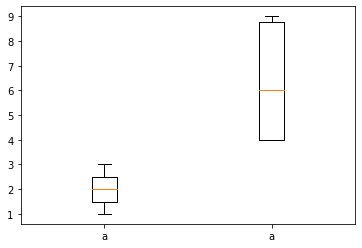

In [24]:
plt.boxplot([[1,2,3],[4,4,4,48,8,9]], labels=['a','a'], showfliers=False)

In [19]:
a = list()

In [20]:
a.append(np.random.normal(0+1, 0.04, len([2,3,3,3,4,5,6,7,8,8,8,9])))

In [21]:
a

[array([0.98390763, 0.97333664, 0.9398141 , 1.04529484, 0.92563584,
        1.00267808, 0.9525013 , 1.01493715, 1.01817504, 1.03042246,
        1.00360934, 0.95304805])]

In [23]:
np.random.normal(0+1, 0.04, len([2,3,3,3,4,5,6,7,8,8,8,9]))+2

array([3.01881604, 3.00364162, 3.07379918, 3.01841861, 2.96815464,
       2.95308593, 3.01148239, 2.97525289, 2.9916722 , 2.97227079,
       3.05174511, 2.97927369])